In [2]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory
# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

In [4]:
import warnings
warnings.filterwarnings("ignore")

In [5]:
!pip install -q super-gradients

In [6]:
from super_gradients.training import Trainer
from super_gradients.training import dataloaders
from super_gradients.training.dataloaders.dataloaders import (
    coco_detection_yolo_format_train,
    coco_detection_yolo_format_val
)
from super_gradients.training import models
from super_gradients.training.losses import PPYoloELoss
from super_gradients.training.metrics import (
    DetectionMetrics_050,
    DetectionMetrics_050_095
)
from super_gradients.training.models.detection_models.pp_yolo_e import PPYoloEPostPredictionCallback
from tqdm.auto import tqdm

import os
import requests
import zipfile
import cv2
import matplotlib.pyplot as plt
import glob
import numpy as np
import random

[2023-08-12 10:06:28] INFO - crash_tips_setup.py - Crash tips is enabled. You can set your environment variable to CRASH_HANDLER=FALSE to disable it


The console stream is logged into /root/sg_logs/console.log


[2023-08-12 10:06:44] WARNING - __init__.py - Failed to import pytorch_quantization
[2023-08-12 10:06:44] WARNING - calibrator.py - Failed to import pytorch_quantization
[2023-08-12 10:06:44] WARNING - export.py - Failed to import pytorch_quantization
[2023-08-12 10:06:44] WARNING - selective_quantization_utils.py - Failed to import pytorch_quantization
[2023-08-12 10:06:44] WARNING - env_sanity_check.py - Failed to verify installed packages: coverage required but not found
[2023-08-12 10:06:44] WARNING - env_sanity_check.py - Failed to verify installed packages: sphinx required but not found
[2023-08-12 10:06:44] WARNING - env_sanity_check.py - Failed to verify installed packages: hydra-core required but not found
[2023-08-12 10:06:44] WARNING - env_sanity_check.py - Failed to verify installed packages: omegaconf required but not found
[2023-08-12 10:06:44] WARNING - env_sanity_check.py - Failed to verify installed packages: onnxruntime required but not found
[2023-08-12 10:06:44] WAR

In [7]:
ROOT_DIR = '/kaggle/input/weed-detection/Weed Detection'
train_imgs_dir = '/kaggle/input/weed-detection/Weed Detection/images/train'
train_labels_dir = '/kaggle/input/weed-detection/Weed Detection/labels/train'
val_imgs_dir = '/kaggle/input/weed-detection/Weed Detection/images/val'
val_labels_dir = '/kaggle/input/weed-detection/Weed Detection/labels/val'
test_imgs_dir = '/kaggle/input/weed-detection/Weed Detection/images/test'
test_labels_dir = '/kaggle/input/weed-detection/Weed Detection/labels/test'
classes = ['crop','weed']

dataset_params = {
    'data_dir':ROOT_DIR,
    'train_images_dir':train_imgs_dir,
    'train_labels_dir':train_labels_dir,
    'val_images_dir':val_imgs_dir,
    'val_labels_dir':val_labels_dir,
    'test_images_dir':test_imgs_dir,
    'test_labels_dir':test_labels_dir,
    'classes':classes
}

In [8]:
# Global parameters.
EPOCHS = 100
BATCH_SIZE = 16
WORKERS = 8

In [9]:
train_data = coco_detection_yolo_format_train(
    dataset_params={
        'data_dir': dataset_params['data_dir'],
        'images_dir': dataset_params['train_images_dir'],
        'labels_dir': dataset_params['train_labels_dir'],
        'classes': dataset_params['classes']
    },
    dataloader_params={
        'batch_size':BATCH_SIZE,
        'num_workers':WORKERS
    }
)



val_data = coco_detection_yolo_format_val(
    dataset_params={
        'data_dir': dataset_params['data_dir'],
        'images_dir': dataset_params['val_images_dir'],
        'labels_dir': dataset_params['val_labels_dir'],
        'classes': dataset_params['classes']
    },
    dataloader_params={
        'batch_size':BATCH_SIZE,
        'num_workers':WORKERS
    }
)

Caching annotations: 100%|██████████| 195/195 [00:01<00:00, 149.01it/s]


In [10]:
train_data.dataset.transforms

[DetectionMosaic('additional_samples_count': 3, 'non_empty_targets': False, 'prob': 1.0, 'input_dim': (640, 640), 'enable_mosaic': True, 'border_value': 114),
 DetectionRandomAffine('additional_samples_count': 0, 'non_empty_targets': False, 'degrees': 10.0, 'translate': 0.1, 'scale': [0.1, 2], 'shear': 2.0, 'target_size': (640, 640), 'enable': True, 'filter_box_candidates': True, 'wh_thr': 2, 'ar_thr': 20, 'area_thr': 0.1, 'border_value': 114),
 DetectionMixup('additional_samples_count': 1, 'non_empty_targets': True, 'input_dim': (640, 640), 'mixup_scale': [0.5, 1.5], 'prob': 1.0, 'enable_mixup': True, 'flip_prob': 0.5, 'border_value': 114),
 DetectionHSV('additional_samples_count': 0, 'non_empty_targets': False, 'prob': 1.0, 'hgain': 5, 'sgain': 30, 'vgain': 30, 'bgr_channels': (0, 1, 2), '_additional_channels_warned': False),
 DetectionHorizontalFlip('additional_samples_count': 0, 'non_empty_targets': False, 'prob': 0.5),
 DetectionPaddedRescale('additional_samples_count': 0, 'non_em

In [11]:
train_data.dataset.transforms.pop(2)

DetectionMixup('additional_samples_count': 1, 'non_empty_targets': True, 'input_dim': (640, 640), 'mixup_scale': [0.5, 1.5], 'prob': 1.0, 'enable_mixup': True, 'flip_prob': 0.5, 'border_value': 114)

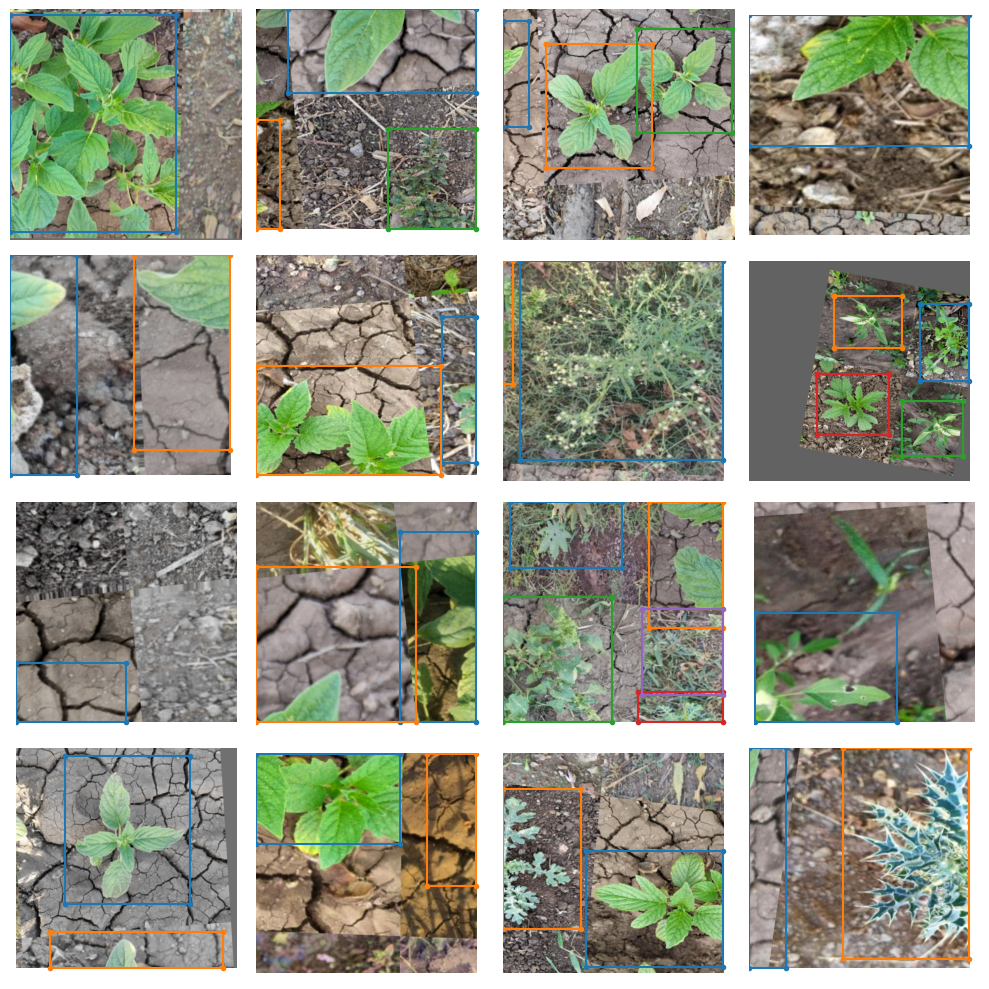

In [13]:
train_data.dataset.plot(plot_transformed_data=True)

In [14]:
train_params = {
    'silent_mode': False,
    "average_best_models":True,
    "warmup_mode": "linear_epoch_step",
    "warmup_initial_lr": 1e-6,
    "lr_warmup_epochs": 3,
    "initial_lr": 5e-4,
    "lr_mode": "cosine",
    "cosine_final_lr_ratio": 0.1,
    "optimizer": "Adam",
    "optimizer_params": {"weight_decay": 0.0001},
    "zero_weight_decay_on_bias_and_bn": True,
    "ema": True,
    "ema_params": {"decay": 0.9, "decay_type": "threshold"},
    "max_epochs": EPOCHS,
    "mixed_precision": True,
    "loss": PPYoloELoss(
        use_static_assigner=False,
        num_classes=len(dataset_params['classes']),
        reg_max=16
    ),
    "valid_metrics_list": [
        DetectionMetrics_050(
            score_thres=0.1,
            top_k_predictions=300,
            num_cls=len(dataset_params['classes']),
            normalize_targets=True,
            post_prediction_callback=PPYoloEPostPredictionCallback(
                score_threshold=0.01,
                nms_top_k=1000,
                max_predictions=300,
                nms_threshold=0.7
            )
        ),
        DetectionMetrics_050_095(
            score_thres=0.1,
            top_k_predictions=300,
            num_cls=len(dataset_params['classes']),
            normalize_targets=True,
            post_prediction_callback=PPYoloEPostPredictionCallback(
                score_threshold=0.01,
                nms_top_k=1000,
                max_predictions=300,
                nms_threshold=0.7
            )
        )
    ],
    "metric_to_watch": 'mAP@0.50:0.95'
}

In [15]:
models_to_train = [
    'yolo_nas_s',
    'yolo_nas_m',
    'yolo_nas_l'
]

CHECKPOINT_DIR = 'checkpoints'

for model_to_train in models_to_train:
    trainer = Trainer(
        experiment_name=model_to_train,
        ckpt_root_dir=CHECKPOINT_DIR
    )

    model = models.get(
        model_to_train,
        num_classes=len(dataset_params['classes']),
        pretrained_weights="coco"
    )

    trainer.train(
        model=model,
        training_params=train_params,
        train_loader=train_data,
        valid_loader=val_data
    )

[2023-08-12 10:10:31] INFO - checkpoint_utils.py - License Notification: YOLO-NAS pre-trained weights are subjected to the specific license terms and conditions detailed in 
https://github.com/Deci-AI/super-gradients/blob/master/LICENSE.YOLONAS.md
By downloading the pre-trained weight files you agree to comply with these terms.
Downloading: "https://sghub.deci.ai/models/yolo_nas_s_coco.pth" to /root/.cache/torch/hub/checkpoints/yolo_nas_s_coco.pth
100%|██████████| 73.1M/73.1M [00:00<00:00, 225MB/s] 


The console stream is now moved to checkpoints/yolo_nas_s/console_Aug12_10_10_37.txt


[2023-08-12 10:10:47] INFO - sg_trainer.py - Using EMA with params {'decay': 0.9, 'decay_type': 'threshold'}
[2023-08-12 10:10:59] INFO - sg_trainer_utils.py - TRAINING PARAMETERS:
    - Mode:                         Single GPU
    - Number of GPUs:               1          (1 available on the machine)
    - Dataset size:                 910        (len(train_set))
    - Batch size per GPU:           16         (batch_size)
    - Batch Accumulate:             1          (batch_accumulate)
    - Total batch size:             16         (num_gpus * batch_size)
    - Effective Batch size:         16         (num_gpus * batch_size * batch_accumulate)
    - Iterations per epoch:         56         (len(train_loader))
    - Gradient updates per epoch:   56         (len(train_loader) / batch_accumulate)

[2023-08-12 10:10:59] INFO - sg_trainer.py - Started training for 100 epochs (0/99)

Validating: 100%|██████████| 13/13 [00:07<00:00,  1.67it/s]
[2023-08-12 10:12:12] INFO - base_sg_logger.py

SUMMARY OF EPOCH 0
├── Train
│   ├── Ppyoloeloss/loss_cls = 2.0507
│   ├── Ppyoloeloss/loss_iou = 0.2537
│   ├── Ppyoloeloss/loss_dfl = 1.5457
│   └── Ppyoloeloss/loss = 3.4579
└── Validation
    ├── Ppyoloeloss/loss_cls = 1.9212
    ├── Ppyoloeloss/loss_iou = 0.2804
    ├── Ppyoloeloss/loss_dfl = 1.8238
    ├── Ppyoloeloss/loss = 3.5342
    ├── Precision@0.50 = 0.0
    ├── Recall@0.50 = 0.0
    ├── Map@0.50 = 0.0395
    ├── F1@0.50 = 0.0
    ├── Precision@0.50:0.95 = 0.0
    ├── Recall@0.50:0.95 = 0.0
    ├── Map@0.50:0.95 = 0.0148
    └── F1@0.50:0.95 = 0.0



Validating epoch 1: 100%|██████████| 13/13 [00:08<00:00,  1.57it/s]
[2023-08-12 10:13:19] INFO - base_sg_logger.py - Checkpoint saved in checkpoints/yolo_nas_s/ckpt_best.pth
[2023-08-12 10:13:19] INFO - sg_trainer.py - Best checkpoint overriden: validation mAP@0.50:0.95: 0.3359341025352478


SUMMARY OF EPOCH 1
├── Train
│   ├── Ppyoloeloss/loss_cls = 1.2547
│   │   ├── Epoch N-1      = 2.0507 (↘ -0.796)
│   │   └── Best until now = 2.0507 (↘ -0.796)
│   ├── Ppyoloeloss/loss_iou = 0.1883
│   │   ├── Epoch N-1      = 0.2537 (↘ -0.0654)
│   │   └── Best until now = 0.2537 (↘ -0.0654)
│   ├── Ppyoloeloss/loss_dfl = 1.2825
│   │   ├── Epoch N-1      = 1.5457 (↘ -0.2632)
│   │   └── Best until now = 1.5457 (↘ -0.2632)
│   └── Ppyoloeloss/loss = 2.3667
│       ├── Epoch N-1      = 3.4579 (↘ -1.0913)
│       └── Best until now = 3.4579 (↘ -1.0913)
└── Validation
    ├── Ppyoloeloss/loss_cls = 1.2224
    │   ├── Epoch N-1      = 1.9212 (↘ -0.6988)
    │   └── Best until now = 1.9212 (↘ -0.6988)
    ├── Ppyoloeloss/loss_iou = 0.1956
    │   ├── Epoch N-1      = 0.2804 (↘ -0.0848)
    │   └── Best until now = 0.2804 (↘ -0.0848)
    ├── Ppyoloeloss/loss_dfl = 1.4075
    │   ├── Epoch N-1      = 1.8238 (↘ -0.4163)
    │   └── Best until now = 1.8238 (↘ -0.4163)
    ├── Ppyoloeloss/loss

Validating epoch 2: 100%|██████████| 13/13 [00:08<00:00,  1.50it/s]


SUMMARY OF EPOCH 2
├── Train
│   ├── Ppyoloeloss/loss_cls = 1.1178
│   │   ├── Epoch N-1      = 1.2547 (↘ -0.1369)
│   │   └── Best until now = 1.2547 (↘ -0.1369)
│   ├── Ppyoloeloss/loss_iou = 0.1863
│   │   ├── Epoch N-1      = 0.1883 (↘ -0.002)
│   │   └── Best until now = 0.1883 (↘ -0.002)
│   ├── Ppyoloeloss/loss_dfl = 1.2603
│   │   ├── Epoch N-1      = 1.2825 (↘ -0.0222)
│   │   └── Best until now = 1.2825 (↘ -0.0222)
│   └── Ppyoloeloss/loss = 2.2137
│       ├── Epoch N-1      = 2.3667 (↘ -0.153)
│       └── Best until now = 2.3667 (↘ -0.153)
└── Validation
    ├── Ppyoloeloss/loss_cls = 1.2303
    │   ├── Epoch N-1      = 1.2224 (↗ 0.0079)
    │   └── Best until now = 1.2224 (↗ 0.0079)
    ├── Ppyoloeloss/loss_iou = 0.1998
    │   ├── Epoch N-1      = 0.1956 (↗ 0.0042)
    │   └── Best until now = 0.1956 (↗ 0.0042)
    ├── Ppyoloeloss/loss_dfl = 1.5153
    │   ├── Epoch N-1      = 1.4075 (↗ 0.1078)
    │   └── Best until now = 1.4075 (↗ 0.1078)
    ├── Ppyoloeloss/loss = 2.487

Validating epoch 3: 100%|██████████| 13/13 [00:08<00:00,  1.53it/s]


SUMMARY OF EPOCH 3
├── Train
│   ├── Ppyoloeloss/loss_cls = 1.0986
│   │   ├── Epoch N-1      = 1.1178 (↘ -0.0192)
│   │   └── Best until now = 1.1178 (↘ -0.0192)
│   ├── Ppyoloeloss/loss_iou = 0.1936
│   │   ├── Epoch N-1      = 0.1863 (↗ 0.0073)
│   │   └── Best until now = 0.1863 (↗ 0.0073)
│   ├── Ppyoloeloss/loss_dfl = 1.2813
│   │   ├── Epoch N-1      = 1.2603 (↗ 0.021)
│   │   └── Best until now = 1.2603 (↗ 0.021)
│   └── Ppyoloeloss/loss = 2.2233
│       ├── Epoch N-1      = 2.2137 (↗ 0.0096)
│       └── Best until now = 2.2137 (↗ 0.0096)
└── Validation
    ├── Ppyoloeloss/loss_cls = 1.2754
    │   ├── Epoch N-1      = 1.2303 (↗ 0.0451)
    │   └── Best until now = 1.2224 (↗ 0.053)
    ├── Ppyoloeloss/loss_iou = 0.2061
    │   ├── Epoch N-1      = 0.1998 (↗ 0.0064)
    │   └── Best until now = 0.1956 (↗ 0.0105)
    ├── Ppyoloeloss/loss_dfl = 1.5621
    │   ├── Epoch N-1      = 1.5153 (↗ 0.0469)
    │   └── Best until now = 1.4075 (↗ 0.1546)
    ├── Ppyoloeloss/loss = 2.5718
   

Validating epoch 4: 100%|██████████| 13/13 [00:09<00:00,  1.39it/s]


SUMMARY OF EPOCH 4
├── Train
│   ├── Ppyoloeloss/loss_cls = 1.0884
│   │   ├── Epoch N-1      = 1.0986 (↘ -0.0102)
│   │   └── Best until now = 1.0986 (↘ -0.0102)
│   ├── Ppyoloeloss/loss_iou = 0.1881
│   │   ├── Epoch N-1      = 0.1936 (↘ -0.0055)
│   │   └── Best until now = 0.1863 (↗ 0.0018)
│   ├── Ppyoloeloss/loss_dfl = 1.2823
│   │   ├── Epoch N-1      = 1.2813 (↗ 0.0011)
│   │   └── Best until now = 1.2603 (↗ 0.0221)
│   └── Ppyoloeloss/loss = 2.1997
│       ├── Epoch N-1      = 2.2233 (↘ -0.0235)
│       └── Best until now = 2.2137 (↘ -0.0139)
└── Validation
    ├── Ppyoloeloss/loss_cls = 1.137
    │   ├── Epoch N-1      = 1.2754 (↘ -0.1384)
    │   └── Best until now = 1.2224 (↘ -0.0854)
    ├── Ppyoloeloss/loss_iou = 0.2119
    │   ├── Epoch N-1      = 0.2061 (↗ 0.0057)
    │   └── Best until now = 0.1956 (↗ 0.0162)
    ├── Ppyoloeloss/loss_dfl = 1.5947
    │   ├── Epoch N-1      = 1.5621 (↗ 0.0326)
    │   └── Best until now = 1.4075 (↗ 0.1872)
    ├── Ppyoloeloss/loss = 2.4

Validating epoch 5: 100%|██████████| 13/13 [00:08<00:00,  1.62it/s]
[2023-08-12 10:17:48] INFO - base_sg_logger.py - Checkpoint saved in checkpoints/yolo_nas_s/ckpt_best.pth
[2023-08-12 10:17:48] INFO - sg_trainer.py - Best checkpoint overriden: validation mAP@0.50:0.95: 0.3718322515487671


SUMMARY OF EPOCH 5
├── Train
│   ├── Ppyoloeloss/loss_cls = 1.0579
│   │   ├── Epoch N-1      = 1.0884 (↘ -0.0305)
│   │   └── Best until now = 1.0884 (↘ -0.0305)
│   ├── Ppyoloeloss/loss_iou = 0.1854
│   │   ├── Epoch N-1      = 0.1881 (↘ -0.0027)
│   │   └── Best until now = 0.1863 (↘ -0.0009)
│   ├── Ppyoloeloss/loss_dfl = 1.2506
│   │   ├── Epoch N-1      = 1.2823 (↘ -0.0318)
│   │   └── Best until now = 1.2603 (↘ -0.0097)
│   └── Ppyoloeloss/loss = 2.1466
│       ├── Epoch N-1      = 2.1997 (↘ -0.0531)
│       └── Best until now = 2.1997 (↘ -0.0531)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.9947
    │   ├── Epoch N-1      = 1.137  (↘ -0.1423)
    │   └── Best until now = 1.137  (↘ -0.1423)
    ├── Ppyoloeloss/loss_iou = 0.2015
    │   ├── Epoch N-1      = 0.2119 (↘ -0.0103)
    │   └── Best until now = 0.1956 (↗ 0.0059)
    ├── Ppyoloeloss/loss_dfl = 1.4775
    │   ├── Epoch N-1      = 1.5947 (↘ -0.1172)
    │   └── Best until now = 1.4075 (↗ 0.07)
    ├── Ppyoloeloss/loss =

Validating epoch 6: 100%|██████████| 13/13 [00:07<00:00,  1.72it/s]


SUMMARY OF EPOCH 6
├── Train
│   ├── Ppyoloeloss/loss_cls = 1.0343
│   │   ├── Epoch N-1      = 1.0579 (↘ -0.0236)
│   │   └── Best until now = 1.0579 (↘ -0.0236)
│   ├── Ppyoloeloss/loss_iou = 0.1872
│   │   ├── Epoch N-1      = 0.1854 (↗ 0.0018)
│   │   └── Best until now = 0.1854 (↗ 0.0018)
│   ├── Ppyoloeloss/loss_dfl = 1.2452
│   │   ├── Epoch N-1      = 1.2506 (↘ -0.0054)
│   │   └── Best until now = 1.2506 (↘ -0.0054)
│   └── Ppyoloeloss/loss = 2.1248
│       ├── Epoch N-1      = 2.1466 (↘ -0.0218)
│       └── Best until now = 2.1466 (↘ -0.0218)
└── Validation
    ├── Ppyoloeloss/loss_cls = 1.0956
    │   ├── Epoch N-1      = 0.9947 (↗ 0.1009)
    │   └── Best until now = 0.9947 (↗ 0.1009)
    ├── Ppyoloeloss/loss_iou = 0.196
    │   ├── Epoch N-1      = 0.2015 (↘ -0.0055)
    │   └── Best until now = 0.1956 (↗ 0.0004)
    ├── Ppyoloeloss/loss_dfl = 1.4678
    │   ├── Epoch N-1      = 1.4775 (↘ -0.0096)
    │   └── Best until now = 1.4075 (↗ 0.0603)
    ├── Ppyoloeloss/loss = 2.

Validating epoch 7: 100%|██████████| 13/13 [00:07<00:00,  1.72it/s]
[2023-08-12 10:20:05] INFO - base_sg_logger.py - Checkpoint saved in checkpoints/yolo_nas_s/ckpt_best.pth
[2023-08-12 10:20:05] INFO - sg_trainer.py - Best checkpoint overriden: validation mAP@0.50:0.95: 0.4035869240760803


SUMMARY OF EPOCH 7
├── Train
│   ├── Ppyoloeloss/loss_cls = 1.0438
│   │   ├── Epoch N-1      = 1.0343 (↗ 0.0095)
│   │   └── Best until now = 1.0343 (↗ 0.0095)
│   ├── Ppyoloeloss/loss_iou = 0.1832
│   │   ├── Epoch N-1      = 0.1872 (↘ -0.004)
│   │   └── Best until now = 0.1854 (↘ -0.0022)
│   ├── Ppyoloeloss/loss_dfl = 1.2201
│   │   ├── Epoch N-1      = 1.2452 (↘ -0.025)
│   │   └── Best until now = 1.2452 (↘ -0.025)
│   └── Ppyoloeloss/loss = 2.1118
│       ├── Epoch N-1      = 2.1248 (↘ -0.013)
│       └── Best until now = 2.1248 (↘ -0.013)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.908
    │   ├── Epoch N-1      = 1.0956 (↘ -0.1876)
    │   └── Best until now = 0.9947 (↘ -0.0867)
    ├── Ppyoloeloss/loss_iou = 0.2018
    │   ├── Epoch N-1      = 0.196  (↗ 0.0058)
    │   └── Best until now = 0.1956 (↗ 0.0062)
    ├── Ppyoloeloss/loss_dfl = 1.4576
    │   ├── Epoch N-1      = 1.4678 (↘ -0.0102)
    │   └── Best until now = 1.4075 (↗ 0.0501)
    ├── Ppyoloeloss/loss = 2.1413

Validating epoch 8: 100%|██████████| 13/13 [00:08<00:00,  1.62it/s]


SUMMARY OF EPOCH 8
├── Train
│   ├── Ppyoloeloss/loss_cls = 1.0242
│   │   ├── Epoch N-1      = 1.0438 (↘ -0.0195)
│   │   └── Best until now = 1.0343 (↘ -0.0101)
│   ├── Ppyoloeloss/loss_iou = 0.183
│   │   ├── Epoch N-1      = 0.1832 (↘ -0.0002)
│   │   └── Best until now = 0.1832 (↘ -0.0002)
│   ├── Ppyoloeloss/loss_dfl = 1.2173
│   │   ├── Epoch N-1      = 1.2201 (↘ -0.0029)
│   │   └── Best until now = 1.2201 (↘ -0.0029)
│   └── Ppyoloeloss/loss = 2.0903
│       ├── Epoch N-1      = 2.1118 (↘ -0.0216)
│       └── Best until now = 2.1118 (↘ -0.0216)
└── Validation
    ├── Ppyoloeloss/loss_cls = 1.006
    │   ├── Epoch N-1      = 0.908  (↗ 0.098)
    │   └── Best until now = 0.908  (↗ 0.098)
    ├── Ppyoloeloss/loss_iou = 0.2079
    │   ├── Epoch N-1      = 0.2018 (↗ 0.0062)
    │   └── Best until now = 0.1956 (↗ 0.0123)
    ├── Ppyoloeloss/loss_dfl = 1.5195
    │   ├── Epoch N-1      = 1.4576 (↗ 0.0619)
    │   └── Best until now = 1.4075 (↗ 0.112)
    ├── Ppyoloeloss/loss = 2.2856

Validating epoch 9: 100%|██████████| 13/13 [00:07<00:00,  1.63it/s]


SUMMARY OF EPOCH 9
├── Train
│   ├── Ppyoloeloss/loss_cls = 1.014
│   │   ├── Epoch N-1      = 1.0242 (↘ -0.0102)
│   │   └── Best until now = 1.0242 (↘ -0.0102)
│   ├── Ppyoloeloss/loss_iou = 0.1807
│   │   ├── Epoch N-1      = 0.183  (↘ -0.0023)
│   │   └── Best until now = 0.183  (↘ -0.0023)
│   ├── Ppyoloeloss/loss_dfl = 1.2303
│   │   ├── Epoch N-1      = 1.2173 (↗ 0.013)
│   │   └── Best until now = 1.2173 (↗ 0.013)
│   └── Ppyoloeloss/loss = 2.081
│       ├── Epoch N-1      = 2.0903 (↘ -0.0093)
│       └── Best until now = 2.0903 (↘ -0.0093)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.9285
    │   ├── Epoch N-1      = 1.006  (↘ -0.0775)
    │   └── Best until now = 0.908  (↗ 0.0205)
    ├── Ppyoloeloss/loss_iou = 0.2197
    │   ├── Epoch N-1      = 0.2079 (↗ 0.0117)
    │   └── Best until now = 0.1956 (↗ 0.0241)
    ├── Ppyoloeloss/loss_dfl = 1.5652
    │   ├── Epoch N-1      = 1.5195 (↗ 0.0457)
    │   └── Best until now = 1.4075 (↗ 0.1577)
    ├── Ppyoloeloss/loss = 2.2603

Validating epoch 10: 100%|██████████| 13/13 [00:07<00:00,  1.73it/s]


SUMMARY OF EPOCH 10
├── Train
│   ├── Ppyoloeloss/loss_cls = 1.0057
│   │   ├── Epoch N-1      = 1.014  (↘ -0.0083)
│   │   └── Best until now = 1.014  (↘ -0.0083)
│   ├── Ppyoloeloss/loss_iou = 0.1782
│   │   ├── Epoch N-1      = 0.1807 (↘ -0.0026)
│   │   └── Best until now = 0.1807 (↘ -0.0026)
│   ├── Ppyoloeloss/loss_dfl = 1.2114
│   │   ├── Epoch N-1      = 1.2303 (↘ -0.0189)
│   │   └── Best until now = 1.2173 (↘ -0.0058)
│   └── Ppyoloeloss/loss = 2.0568
│       ├── Epoch N-1      = 2.081  (↘ -0.0241)
│       └── Best until now = 2.081  (↘ -0.0241)
└── Validation
    ├── Ppyoloeloss/loss_cls = 1.0129
    │   ├── Epoch N-1      = 0.9285 (↗ 0.0844)
    │   └── Best until now = 0.908  (↗ 0.1049)
    ├── Ppyoloeloss/loss_iou = 0.2334
    │   ├── Epoch N-1      = 0.2197 (↗ 0.0137)
    │   └── Best until now = 0.1956 (↗ 0.0378)
    ├── Ppyoloeloss/loss_dfl = 1.7153
    │   ├── Epoch N-1      = 1.5652 (↗ 0.1501)
    │   └── Best until now = 1.4075 (↗ 0.3078)
    ├── Ppyoloeloss/loss = 

Validating epoch 11: 100%|██████████| 13/13 [00:07<00:00,  1.73it/s]
[2023-08-12 10:24:48] INFO - base_sg_logger.py - Checkpoint saved in checkpoints/yolo_nas_s/ckpt_best.pth
[2023-08-12 10:24:48] INFO - sg_trainer.py - Best checkpoint overriden: validation mAP@0.50:0.95: 0.4132864475250244


SUMMARY OF EPOCH 11
├── Train
│   ├── Ppyoloeloss/loss_cls = 1.0017
│   │   ├── Epoch N-1      = 1.0057 (↘ -0.0041)
│   │   └── Best until now = 1.0057 (↘ -0.0041)
│   ├── Ppyoloeloss/loss_iou = 0.176
│   │   ├── Epoch N-1      = 0.1782 (↘ -0.0022)
│   │   └── Best until now = 0.1782 (↘ -0.0022)
│   ├── Ppyoloeloss/loss_dfl = 1.1913
│   │   ├── Epoch N-1      = 1.2114 (↘ -0.0201)
│   │   └── Best until now = 1.2114 (↘ -0.0201)
│   └── Ppyoloeloss/loss = 2.0373
│       ├── Epoch N-1      = 2.0568 (↘ -0.0195)
│       └── Best until now = 2.0568 (↘ -0.0195)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.9696
    │   ├── Epoch N-1      = 1.0129 (↘ -0.0433)
    │   └── Best until now = 0.908  (↗ 0.0616)
    ├── Ppyoloeloss/loss_iou = 0.1973
    │   ├── Epoch N-1      = 0.2334 (↘ -0.0361)
    │   └── Best until now = 0.1956 (↗ 0.0017)
    ├── Ppyoloeloss/loss_dfl = 1.4632
    │   ├── Epoch N-1      = 1.7153 (↘ -0.2521)
    │   └── Best until now = 1.4075 (↗ 0.0557)
    ├── Ppyoloeloss/loss 

Validating epoch 12: 100%|██████████| 13/13 [00:07<00:00,  1.68it/s]


SUMMARY OF EPOCH 12
├── Train
│   ├── Ppyoloeloss/loss_cls = 1.0039
│   │   ├── Epoch N-1      = 1.0017 (↗ 0.0023)
│   │   └── Best until now = 1.0017 (↗ 0.0023)
│   ├── Ppyoloeloss/loss_iou = 0.1783
│   │   ├── Epoch N-1      = 0.176  (↗ 0.0023)
│   │   └── Best until now = 0.176  (↗ 0.0023)
│   ├── Ppyoloeloss/loss_dfl = 1.2066
│   │   ├── Epoch N-1      = 1.1913 (↗ 0.0153)
│   │   └── Best until now = 1.1913 (↗ 0.0153)
│   └── Ppyoloeloss/loss = 2.0529
│       ├── Epoch N-1      = 2.0373 (↗ 0.0156)
│       └── Best until now = 2.0373 (↗ 0.0156)
└── Validation
    ├── Ppyoloeloss/loss_cls = 1.0826
    │   ├── Epoch N-1      = 0.9696 (↗ 0.113)
    │   └── Best until now = 0.908  (↗ 0.1746)
    ├── Ppyoloeloss/loss_iou = 0.221
    │   ├── Epoch N-1      = 0.1973 (↗ 0.0237)
    │   └── Best until now = 0.1956 (↗ 0.0254)
    ├── Ppyoloeloss/loss_dfl = 1.6498
    │   ├── Epoch N-1      = 1.4632 (↗ 0.1866)
    │   └── Best until now = 1.4075 (↗ 0.2423)
    ├── Ppyoloeloss/loss = 2.46
    │

Validating epoch 13: 100%|██████████| 13/13 [00:08<00:00,  1.58it/s]


SUMMARY OF EPOCH 13
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9985
│   │   ├── Epoch N-1      = 1.0039 (↘ -0.0054)
│   │   └── Best until now = 1.0017 (↘ -0.0031)
│   ├── Ppyoloeloss/loss_iou = 0.1804
│   │   ├── Epoch N-1      = 0.1783 (↗ 0.0021)
│   │   └── Best until now = 0.176  (↗ 0.0044)
│   ├── Ppyoloeloss/loss_dfl = 1.1916
│   │   ├── Epoch N-1      = 1.2066 (↘ -0.0151)
│   │   └── Best until now = 1.1913 (↗ 0.0003)
│   └── Ppyoloeloss/loss = 2.0453
│       ├── Epoch N-1      = 2.0529 (↘ -0.0076)
│       └── Best until now = 2.0373 (↗ 0.008)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.9643
    │   ├── Epoch N-1      = 1.0826 (↘ -0.1183)
    │   └── Best until now = 0.908  (↗ 0.0563)
    ├── Ppyoloeloss/loss_iou = 0.2132
    │   ├── Epoch N-1      = 0.221  (↘ -0.0078)
    │   └── Best until now = 0.1956 (↗ 0.0176)
    ├── Ppyoloeloss/loss_dfl = 1.5682
    │   ├── Epoch N-1      = 1.6498 (↘ -0.0816)
    │   └── Best until now = 1.4075 (↗ 0.1607)
    ├── Ppyoloeloss/loss = 2.

Validating epoch 14: 100%|██████████| 13/13 [00:07<00:00,  1.70it/s]


SUMMARY OF EPOCH 14
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9879
│   │   ├── Epoch N-1      = 0.9985 (↘ -0.0106)
│   │   └── Best until now = 0.9985 (↘ -0.0106)
│   ├── Ppyoloeloss/loss_iou = 0.1781
│   │   ├── Epoch N-1      = 0.1804 (↘ -0.0023)
│   │   └── Best until now = 0.176  (↗ 0.0021)
│   ├── Ppyoloeloss/loss_dfl = 1.1998
│   │   ├── Epoch N-1      = 1.1916 (↗ 0.0082)
│   │   └── Best until now = 1.1913 (↗ 0.0085)
│   └── Ppyoloeloss/loss = 2.0331
│       ├── Epoch N-1      = 2.0453 (↘ -0.0122)
│       └── Best until now = 2.0373 (↘ -0.0042)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.9032
    │   ├── Epoch N-1      = 0.9643 (↘ -0.0611)
    │   └── Best until now = 0.908  (↘ -0.0048)
    ├── Ppyoloeloss/loss_iou = 0.2137
    │   ├── Epoch N-1      = 0.2132 (↗ 0.0005)
    │   └── Best until now = 0.1956 (↗ 0.0181)
    ├── Ppyoloeloss/loss_dfl = 1.579
    │   ├── Epoch N-1      = 1.5682 (↗ 0.0108)
    │   └── Best until now = 1.4075 (↗ 0.1715)
    ├── Ppyoloeloss/loss = 2.

Validating epoch 15: 100%|██████████| 13/13 [00:07<00:00,  1.70it/s]


SUMMARY OF EPOCH 15
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9703
│   │   ├── Epoch N-1      = 0.9879 (↘ -0.0176)
│   │   └── Best until now = 0.9879 (↘ -0.0176)
│   ├── Ppyoloeloss/loss_iou = 0.1793
│   │   ├── Epoch N-1      = 0.1781 (↗ 0.0012)
│   │   └── Best until now = 0.176  (↗ 0.0033)
│   ├── Ppyoloeloss/loss_dfl = 1.1986
│   │   ├── Epoch N-1      = 1.1998 (↘ -0.0012)
│   │   └── Best until now = 1.1913 (↗ 0.0073)
│   └── Ppyoloeloss/loss = 2.0179
│       ├── Epoch N-1      = 2.0331 (↘ -0.0152)
│       └── Best until now = 2.0331 (↘ -0.0152)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.9414
    │   ├── Epoch N-1      = 0.9032 (↗ 0.0382)
    │   └── Best until now = 0.9032 (↗ 0.0382)
    ├── Ppyoloeloss/loss_iou = 0.2092
    │   ├── Epoch N-1      = 0.2137 (↘ -0.0044)
    │   └── Best until now = 0.1956 (↗ 0.0136)
    ├── Ppyoloeloss/loss_dfl = 1.4758
    │   ├── Epoch N-1      = 1.579  (↘ -0.1032)
    │   └── Best until now = 1.4075 (↗ 0.0683)
    ├── Ppyoloeloss/loss = 2

Validating epoch 16: 100%|██████████| 13/13 [00:07<00:00,  1.66it/s]


SUMMARY OF EPOCH 16
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9883
│   │   ├── Epoch N-1      = 0.9703 (↗ 0.018)
│   │   └── Best until now = 0.9703 (↗ 0.018)
│   ├── Ppyoloeloss/loss_iou = 0.1769
│   │   ├── Epoch N-1      = 0.1793 (↘ -0.0025)
│   │   └── Best until now = 0.176  (↗ 0.0009)
│   ├── Ppyoloeloss/loss_dfl = 1.2021
│   │   ├── Epoch N-1      = 1.1986 (↗ 0.0034)
│   │   └── Best until now = 1.1913 (↗ 0.0107)
│   └── Ppyoloeloss/loss = 2.0315
│       ├── Epoch N-1      = 2.0179 (↗ 0.0136)
│       └── Best until now = 2.0179 (↗ 0.0136)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.9181
    │   ├── Epoch N-1      = 0.9414 (↘ -0.0233)
    │   └── Best until now = 0.9032 (↗ 0.0149)
    ├── Ppyoloeloss/loss_iou = 0.2116
    │   ├── Epoch N-1      = 0.2092 (↗ 0.0023)
    │   └── Best until now = 0.1956 (↗ 0.0159)
    ├── Ppyoloeloss/loss_dfl = 1.5412
    │   ├── Epoch N-1      = 1.4758 (↗ 0.0654)
    │   └── Best until now = 1.4075 (↗ 0.1337)
    ├── Ppyoloeloss/loss = 2.2177
 

Validating epoch 17: 100%|██████████| 13/13 [00:08<00:00,  1.62it/s]
[2023-08-12 10:31:50] INFO - base_sg_logger.py - Checkpoint saved in checkpoints/yolo_nas_s/ckpt_best.pth
[2023-08-12 10:31:50] INFO - sg_trainer.py - Best checkpoint overriden: validation mAP@0.50:0.95: 0.4382936358451843


SUMMARY OF EPOCH 17
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9916
│   │   ├── Epoch N-1      = 0.9883 (↗ 0.0033)
│   │   └── Best until now = 0.9703 (↗ 0.0213)
│   ├── Ppyoloeloss/loss_iou = 0.1727
│   │   ├── Epoch N-1      = 0.1769 (↘ -0.0042)
│   │   └── Best until now = 0.176  (↘ -0.0033)
│   ├── Ppyoloeloss/loss_dfl = 1.1804
│   │   ├── Epoch N-1      = 1.2021 (↘ -0.0216)
│   │   └── Best until now = 1.1913 (↘ -0.0109)
│   └── Ppyoloeloss/loss = 2.0135
│       ├── Epoch N-1      = 2.0315 (↘ -0.018)
│       └── Best until now = 2.0179 (↘ -0.0044)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8986
    │   ├── Epoch N-1      = 0.9181 (↘ -0.0195)
    │   └── Best until now = 0.9032 (↘ -0.0046)
    ├── Ppyoloeloss/loss_iou = 0.2017
    │   ├── Epoch N-1      = 0.2116 (↘ -0.0099)
    │   └── Best until now = 0.1956 (↗ 0.0061)
    ├── Ppyoloeloss/loss_dfl = 1.4554
    │   ├── Epoch N-1      = 1.5412 (↘ -0.0858)
    │   └── Best until now = 1.4075 (↗ 0.0479)
    ├── Ppyoloeloss/loss =

Validating epoch 18: 100%|██████████| 13/13 [00:07<00:00,  1.73it/s]


SUMMARY OF EPOCH 18
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9872
│   │   ├── Epoch N-1      = 0.9916 (↘ -0.0044)
│   │   └── Best until now = 0.9703 (↗ 0.017)
│   ├── Ppyoloeloss/loss_iou = 0.1739
│   │   ├── Epoch N-1      = 0.1727 (↗ 0.0013)
│   │   └── Best until now = 0.1727 (↗ 0.0013)
│   ├── Ppyoloeloss/loss_dfl = 1.1757
│   │   ├── Epoch N-1      = 1.1804 (↘ -0.0047)
│   │   └── Best until now = 1.1804 (↘ -0.0047)
│   └── Ppyoloeloss/loss = 2.01
│       ├── Epoch N-1      = 2.0135 (↘ -0.0035)
│       └── Best until now = 2.0135 (↘ -0.0035)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.919
    │   ├── Epoch N-1      = 0.8986 (↗ 0.0205)
    │   └── Best until now = 0.8986 (↗ 0.0205)
    ├── Ppyoloeloss/loss_iou = 0.2268
    │   ├── Epoch N-1      = 0.2017 (↗ 0.0251)
    │   └── Best until now = 0.1956 (↗ 0.0311)
    ├── Ppyoloeloss/loss_dfl = 1.6234
    │   ├── Epoch N-1      = 1.4554 (↗ 0.168)
    │   └── Best until now = 1.4075 (↗ 0.2159)
    ├── Ppyoloeloss/loss = 2.2976
 

Validating epoch 19: 100%|██████████| 13/13 [00:07<00:00,  1.64it/s]


SUMMARY OF EPOCH 19
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9616
│   │   ├── Epoch N-1      = 0.9872 (↘ -0.0256)
│   │   └── Best until now = 0.9703 (↘ -0.0087)
│   ├── Ppyoloeloss/loss_iou = 0.1757
│   │   ├── Epoch N-1      = 0.1739 (↗ 0.0017)
│   │   └── Best until now = 0.1727 (↗ 0.003)
│   ├── Ppyoloeloss/loss_dfl = 1.1729
│   │   ├── Epoch N-1      = 1.1757 (↘ -0.0028)
│   │   └── Best until now = 1.1757 (↘ -0.0028)
│   └── Ppyoloeloss/loss = 1.9872
│       ├── Epoch N-1      = 2.01   (↘ -0.0228)
│       └── Best until now = 2.01   (↘ -0.0228)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.891
    │   ├── Epoch N-1      = 0.919  (↘ -0.028)
    │   └── Best until now = 0.8986 (↘ -0.0076)
    ├── Ppyoloeloss/loss_iou = 0.2191
    │   ├── Epoch N-1      = 0.2268 (↘ -0.0076)
    │   └── Best until now = 0.1956 (↗ 0.0235)
    ├── Ppyoloeloss/loss_dfl = 1.6
    │   ├── Epoch N-1      = 1.6234 (↘ -0.0234)
    │   └── Best until now = 1.4075 (↗ 0.1925)
    ├── Ppyoloeloss/loss = 2.23

Validating epoch 20: 100%|██████████| 13/13 [00:07<00:00,  1.70it/s]


SUMMARY OF EPOCH 20
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9537
│   │   ├── Epoch N-1      = 0.9616 (↘ -0.0078)
│   │   └── Best until now = 0.9616 (↘ -0.0078)
│   ├── Ppyoloeloss/loss_iou = 0.1718
│   │   ├── Epoch N-1      = 0.1757 (↘ -0.0039)
│   │   └── Best until now = 0.1727 (↘ -0.0009)
│   ├── Ppyoloeloss/loss_dfl = 1.1644
│   │   ├── Epoch N-1      = 1.1729 (↘ -0.0084)
│   │   └── Best until now = 1.1729 (↘ -0.0084)
│   └── Ppyoloeloss/loss = 1.9654
│       ├── Epoch N-1      = 1.9872 (↘ -0.0218)
│       └── Best until now = 1.9872 (↘ -0.0218)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.9236
    │   ├── Epoch N-1      = 0.891  (↗ 0.0326)
    │   └── Best until now = 0.891  (↗ 0.0326)
    ├── Ppyoloeloss/loss_iou = 0.2219
    │   ├── Epoch N-1      = 0.2191 (↗ 0.0028)
    │   └── Best until now = 0.1956 (↗ 0.0263)
    ├── Ppyoloeloss/loss_dfl = 1.5666
    │   ├── Epoch N-1      = 1.6    (↘ -0.0334)
    │   └── Best until now = 1.4075 (↗ 0.1591)
    ├── Ppyoloeloss/loss =

Validating epoch 21: 100%|██████████| 13/13 [00:07<00:00,  1.65it/s]


SUMMARY OF EPOCH 21
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9527
│   │   ├── Epoch N-1      = 0.9537 (↘ -0.001)
│   │   └── Best until now = 0.9537 (↘ -0.001)
│   ├── Ppyoloeloss/loss_iou = 0.1718
│   │   ├── Epoch N-1      = 0.1718 (↗ 1e-04)
│   │   └── Best until now = 0.1718 (↗ 1e-04)
│   ├── Ppyoloeloss/loss_dfl = 1.1669
│   │   ├── Epoch N-1      = 1.1644 (↗ 0.0024)
│   │   └── Best until now = 1.1644 (↗ 0.0024)
│   └── Ppyoloeloss/loss = 1.9657
│       ├── Epoch N-1      = 1.9654 (↗ 0.0003)
│       └── Best until now = 1.9654 (↗ 0.0003)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.9507
    │   ├── Epoch N-1      = 0.9236 (↗ 0.0271)
    │   └── Best until now = 0.891  (↗ 0.0597)
    ├── Ppyoloeloss/loss_iou = 0.2499
    │   ├── Epoch N-1      = 0.2219 (↗ 0.028)
    │   └── Best until now = 0.1956 (↗ 0.0543)
    ├── Ppyoloeloss/loss_dfl = 1.7847
    │   ├── Epoch N-1      = 1.5666 (↗ 0.2181)
    │   └── Best until now = 1.4075 (↗ 0.3772)
    ├── Ppyoloeloss/loss = 2.4678
    

Validating epoch 22: 100%|██████████| 13/13 [00:07<00:00,  1.65it/s]


SUMMARY OF EPOCH 22
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9631
│   │   ├── Epoch N-1      = 0.9527 (↗ 0.0104)
│   │   └── Best until now = 0.9527 (↗ 0.0104)
│   ├── Ppyoloeloss/loss_iou = 0.1742
│   │   ├── Epoch N-1      = 0.1718 (↗ 0.0024)
│   │   └── Best until now = 0.1718 (↗ 0.0025)
│   ├── Ppyoloeloss/loss_dfl = 1.174
│   │   ├── Epoch N-1      = 1.1669 (↗ 0.0071)
│   │   └── Best until now = 1.1644 (↗ 0.0095)
│   └── Ppyoloeloss/loss = 1.9857
│       ├── Epoch N-1      = 1.9657 (↗ 0.02)
│       └── Best until now = 1.9654 (↗ 0.0203)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8978
    │   ├── Epoch N-1      = 0.9507 (↘ -0.0529)
    │   └── Best until now = 0.891  (↗ 0.0068)
    ├── Ppyoloeloss/loss_iou = 0.2221
    │   ├── Epoch N-1      = 0.2499 (↘ -0.0278)
    │   └── Best until now = 0.1956 (↗ 0.0265)
    ├── Ppyoloeloss/loss_dfl = 1.6234
    │   ├── Epoch N-1      = 1.7847 (↘ -0.1614)
    │   └── Best until now = 1.4075 (↗ 0.2159)
    ├── Ppyoloeloss/loss = 2.2647
 

Validating epoch 23: 100%|██████████| 13/13 [00:07<00:00,  1.68it/s]


SUMMARY OF EPOCH 23
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9515
│   │   ├── Epoch N-1      = 0.9631 (↘ -0.0116)
│   │   └── Best until now = 0.9527 (↘ -0.0013)
│   ├── Ppyoloeloss/loss_iou = 0.1747
│   │   ├── Epoch N-1      = 0.1742 (↗ 0.0005)
│   │   └── Best until now = 0.1718 (↗ 0.003)
│   ├── Ppyoloeloss/loss_dfl = 1.1838
│   │   ├── Epoch N-1      = 1.174  (↗ 0.0098)
│   │   └── Best until now = 1.1644 (↗ 0.0194)
│   └── Ppyoloeloss/loss = 1.9801
│       ├── Epoch N-1      = 1.9857 (↘ -0.0055)
│       └── Best until now = 1.9654 (↗ 0.0148)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.9299
    │   ├── Epoch N-1      = 0.8978 (↗ 0.0321)
    │   └── Best until now = 0.891  (↗ 0.0389)
    ├── Ppyoloeloss/loss_iou = 0.2154
    │   ├── Epoch N-1      = 0.2221 (↘ -0.0067)
    │   └── Best until now = 0.1956 (↗ 0.0198)
    ├── Ppyoloeloss/loss_dfl = 1.5596
    │   ├── Epoch N-1      = 1.6234 (↘ -0.0638)
    │   └── Best until now = 1.4075 (↗ 0.1521)
    ├── Ppyoloeloss/loss = 2.24

Validating epoch 24: 100%|██████████| 13/13 [00:08<00:00,  1.62it/s]


SUMMARY OF EPOCH 24
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9559
│   │   ├── Epoch N-1      = 0.9515 (↗ 0.0045)
│   │   └── Best until now = 0.9515 (↗ 0.0045)
│   ├── Ppyoloeloss/loss_iou = 0.172
│   │   ├── Epoch N-1      = 0.1747 (↘ -0.0027)
│   │   └── Best until now = 0.1718 (↗ 0.0002)
│   ├── Ppyoloeloss/loss_dfl = 1.1511
│   │   ├── Epoch N-1      = 1.1838 (↘ -0.0327)
│   │   └── Best until now = 1.1644 (↘ -0.0133)
│   └── Ppyoloeloss/loss = 1.9614
│       ├── Epoch N-1      = 1.9801 (↘ -0.0187)
│       └── Best until now = 1.9654 (↘ -0.0039)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.835
    │   ├── Epoch N-1      = 0.9299 (↘ -0.0949)
    │   └── Best until now = 0.891  (↘ -0.056)
    ├── Ppyoloeloss/loss_iou = 0.2046
    │   ├── Epoch N-1      = 0.2154 (↘ -0.0109)
    │   └── Best until now = 0.1956 (↗ 0.0089)
    ├── Ppyoloeloss/loss_dfl = 1.4602
    │   ├── Epoch N-1      = 1.5596 (↘ -0.0994)
    │   └── Best until now = 1.4075 (↗ 0.0528)
    ├── Ppyoloeloss/loss = 2.

Validating epoch 25: 100%|██████████| 13/13 [00:08<00:00,  1.57it/s]


SUMMARY OF EPOCH 25
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9605
│   │   ├── Epoch N-1      = 0.9559 (↗ 0.0046)
│   │   └── Best until now = 0.9515 (↗ 0.0091)
│   ├── Ppyoloeloss/loss_iou = 0.1727
│   │   ├── Epoch N-1      = 0.172  (↗ 0.0007)
│   │   └── Best until now = 0.1718 (↗ 0.001)
│   ├── Ppyoloeloss/loss_dfl = 1.1723
│   │   ├── Epoch N-1      = 1.1511 (↗ 0.0212)
│   │   └── Best until now = 1.1511 (↗ 0.0212)
│   └── Ppyoloeloss/loss = 1.9785
│       ├── Epoch N-1      = 1.9614 (↗ 0.0171)
│       └── Best until now = 1.9614 (↗ 0.0171)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.833
    │   ├── Epoch N-1      = 0.835  (↘ -0.002)
    │   └── Best until now = 0.835  (↘ -0.002)
    ├── Ppyoloeloss/loss_iou = 0.2072
    │   ├── Epoch N-1      = 0.2046 (↗ 0.0026)
    │   └── Best until now = 0.1956 (↗ 0.0115)
    ├── Ppyoloeloss/loss_dfl = 1.4801
    │   ├── Epoch N-1      = 1.4602 (↗ 0.0199)
    │   └── Best until now = 1.4075 (↗ 0.0726)
    ├── Ppyoloeloss/loss = 2.0909
   

Validating epoch 26: 100%|██████████| 13/13 [00:08<00:00,  1.55it/s]


SUMMARY OF EPOCH 26
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9349
│   │   ├── Epoch N-1      = 0.9605 (↘ -0.0256)
│   │   └── Best until now = 0.9515 (↘ -0.0165)
│   ├── Ppyoloeloss/loss_iou = 0.1691
│   │   ├── Epoch N-1      = 0.1727 (↘ -0.0037)
│   │   └── Best until now = 0.1718 (↘ -0.0027)
│   ├── Ppyoloeloss/loss_dfl = 1.157
│   │   ├── Epoch N-1      = 1.1723 (↘ -0.0153)
│   │   └── Best until now = 1.1511 (↗ 0.0059)
│   └── Ppyoloeloss/loss = 1.936
│       ├── Epoch N-1      = 1.9785 (↘ -0.0424)
│       └── Best until now = 1.9614 (↘ -0.0254)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8745
    │   ├── Epoch N-1      = 0.833  (↗ 0.0415)
    │   └── Best until now = 0.833  (↗ 0.0415)
    ├── Ppyoloeloss/loss_iou = 0.2139
    │   ├── Epoch N-1      = 0.2072 (↗ 0.0067)
    │   └── Best until now = 0.1956 (↗ 0.0182)
    ├── Ppyoloeloss/loss_dfl = 1.518
    │   ├── Epoch N-1      = 1.4801 (↗ 0.0379)
    │   └── Best until now = 1.4075 (↗ 0.1105)
    ├── Ppyoloeloss/loss = 2.16

Validating epoch 27: 100%|██████████| 13/13 [00:07<00:00,  1.70it/s]


SUMMARY OF EPOCH 27
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9185
│   │   ├── Epoch N-1      = 0.9349 (↘ -0.0164)
│   │   └── Best until now = 0.9349 (↘ -0.0164)
│   ├── Ppyoloeloss/loss_iou = 0.172
│   │   ├── Epoch N-1      = 0.1691 (↗ 0.0029)
│   │   └── Best until now = 0.1691 (↗ 0.0029)
│   ├── Ppyoloeloss/loss_dfl = 1.1338
│   │   ├── Epoch N-1      = 1.157  (↘ -0.0232)
│   │   └── Best until now = 1.1511 (↘ -0.0173)
│   └── Ppyoloeloss/loss = 1.9153
│       ├── Epoch N-1      = 1.936  (↘ -0.0208)
│       └── Best until now = 1.936  (↘ -0.0208)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.9188
    │   ├── Epoch N-1      = 0.8745 (↗ 0.0443)
    │   └── Best until now = 0.833  (↗ 0.0858)
    ├── Ppyoloeloss/loss_iou = 0.2165
    │   ├── Epoch N-1      = 0.2139 (↗ 0.0026)
    │   └── Best until now = 0.1956 (↗ 0.0209)
    ├── Ppyoloeloss/loss_dfl = 1.5666
    │   ├── Epoch N-1      = 1.518  (↗ 0.0486)
    │   └── Best until now = 1.4075 (↗ 0.1591)
    ├── Ppyoloeloss/loss = 2.2

Validating epoch 28: 100%|██████████| 13/13 [00:07<00:00,  1.65it/s]


SUMMARY OF EPOCH 28
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9474
│   │   ├── Epoch N-1      = 0.9185 (↗ 0.0289)
│   │   └── Best until now = 0.9185 (↗ 0.0289)
│   ├── Ppyoloeloss/loss_iou = 0.171
│   │   ├── Epoch N-1      = 0.172  (↘ -0.0009)
│   │   └── Best until now = 0.1691 (↗ 0.002)
│   ├── Ppyoloeloss/loss_dfl = 1.1359
│   │   ├── Epoch N-1      = 1.1338 (↗ 0.0022)
│   │   └── Best until now = 1.1338 (↗ 0.0022)
│   └── Ppyoloeloss/loss = 1.9429
│       ├── Epoch N-1      = 1.9153 (↗ 0.0277)
│       └── Best until now = 1.9153 (↗ 0.0277)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.904
    │   ├── Epoch N-1      = 0.9188 (↘ -0.0147)
    │   └── Best until now = 0.833  (↗ 0.0711)
    ├── Ppyoloeloss/loss_iou = 0.2212
    │   ├── Epoch N-1      = 0.2165 (↗ 0.0047)
    │   └── Best until now = 0.1956 (↗ 0.0256)
    ├── Ppyoloeloss/loss_dfl = 1.577
    │   ├── Epoch N-1      = 1.5666 (↗ 0.0104)
    │   └── Best until now = 1.4075 (↗ 0.1695)
    ├── Ppyoloeloss/loss = 2.2456
   

Validating epoch 29: 100%|██████████| 13/13 [00:07<00:00,  1.66it/s]


SUMMARY OF EPOCH 29
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.92
│   │   ├── Epoch N-1      = 0.9474 (↘ -0.0274)
│   │   └── Best until now = 0.9185 (↗ 0.0015)
│   ├── Ppyoloeloss/loss_iou = 0.1672
│   │   ├── Epoch N-1      = 0.171  (↘ -0.0038)
│   │   └── Best until now = 0.1691 (↘ -0.0018)
│   ├── Ppyoloeloss/loss_dfl = 1.1341
│   │   ├── Epoch N-1      = 1.1359 (↘ -0.0019)
│   │   └── Best until now = 1.1338 (↗ 0.0003)
│   └── Ppyoloeloss/loss = 1.9051
│       ├── Epoch N-1      = 1.9429 (↘ -0.0379)
│       └── Best until now = 1.9153 (↘ -0.0102)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8875
    │   ├── Epoch N-1      = 0.904  (↘ -0.0166)
    │   └── Best until now = 0.833  (↗ 0.0545)
    ├── Ppyoloeloss/loss_iou = 0.2232
    │   ├── Epoch N-1      = 0.2212 (↗ 0.002)
    │   └── Best until now = 0.1956 (↗ 0.0276)
    ├── Ppyoloeloss/loss_dfl = 1.5819
    │   ├── Epoch N-1      = 1.577  (↗ 0.0049)
    │   └── Best until now = 1.4075 (↗ 0.1744)
    ├── Ppyoloeloss/loss = 2.23

Validating epoch 30: 100%|██████████| 13/13 [00:08<00:00,  1.56it/s]


SUMMARY OF EPOCH 30
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9295
│   │   ├── Epoch N-1      = 0.92   (↗ 0.0095)
│   │   └── Best until now = 0.9185 (↗ 0.011)
│   ├── Ppyoloeloss/loss_iou = 0.1714
│   │   ├── Epoch N-1      = 0.1672 (↗ 0.0042)
│   │   └── Best until now = 0.1672 (↗ 0.0042)
│   ├── Ppyoloeloss/loss_dfl = 1.1595
│   │   ├── Epoch N-1      = 1.1341 (↗ 0.0254)
│   │   └── Best until now = 1.1338 (↗ 0.0257)
│   └── Ppyoloeloss/loss = 1.9378
│       ├── Epoch N-1      = 1.9051 (↗ 0.0327)
│       └── Best until now = 1.9051 (↗ 0.0327)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8778
    │   ├── Epoch N-1      = 0.8875 (↘ -0.0096)
    │   └── Best until now = 0.833  (↗ 0.0449)
    ├── Ppyoloeloss/loss_iou = 0.2122
    │   ├── Epoch N-1      = 0.2232 (↘ -0.011)
    │   └── Best until now = 0.1956 (↗ 0.0166)
    ├── Ppyoloeloss/loss_dfl = 1.5224
    │   ├── Epoch N-1      = 1.5819 (↘ -0.0595)
    │   └── Best until now = 1.4075 (↗ 0.1149)
    ├── Ppyoloeloss/loss = 2.1697


Validating epoch 31: 100%|██████████| 13/13 [00:07<00:00,  1.69it/s]


SUMMARY OF EPOCH 31
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.924
│   │   ├── Epoch N-1      = 0.9295 (↘ -0.0055)
│   │   └── Best until now = 0.9185 (↗ 0.0055)
│   ├── Ppyoloeloss/loss_iou = 0.1728
│   │   ├── Epoch N-1      = 0.1714 (↗ 0.0014)
│   │   └── Best until now = 0.1672 (↗ 0.0056)
│   ├── Ppyoloeloss/loss_dfl = 1.1473
│   │   ├── Epoch N-1      = 1.1595 (↘ -0.0122)
│   │   └── Best until now = 1.1338 (↗ 0.0135)
│   └── Ppyoloeloss/loss = 1.9297
│       ├── Epoch N-1      = 1.9378 (↘ -0.0081)
│       └── Best until now = 1.9051 (↗ 0.0246)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.9256
    │   ├── Epoch N-1      = 0.8778 (↗ 0.0478)
    │   └── Best until now = 0.833  (↗ 0.0927)
    ├── Ppyoloeloss/loss_iou = 0.2043
    │   ├── Epoch N-1      = 0.2122 (↘ -0.0079)
    │   └── Best until now = 0.1956 (↗ 0.0087)
    ├── Ppyoloeloss/loss_dfl = 1.4582
    │   ├── Epoch N-1      = 1.5224 (↘ -0.0642)
    │   └── Best until now = 1.4075 (↗ 0.0507)
    ├── Ppyoloeloss/loss = 2.16

Validating epoch 32: 100%|██████████| 13/13 [00:07<00:00,  1.65it/s]


SUMMARY OF EPOCH 32
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9221
│   │   ├── Epoch N-1      = 0.924  (↘ -0.0019)
│   │   └── Best until now = 0.9185 (↗ 0.0036)
│   ├── Ppyoloeloss/loss_iou = 0.1676
│   │   ├── Epoch N-1      = 0.1728 (↘ -0.0052)
│   │   └── Best until now = 0.1672 (↗ 0.0004)
│   ├── Ppyoloeloss/loss_dfl = 1.1466
│   │   ├── Epoch N-1      = 1.1473 (↘ -0.0007)
│   │   └── Best until now = 1.1338 (↗ 0.0129)
│   └── Ppyoloeloss/loss = 1.9145
│       ├── Epoch N-1      = 1.9297 (↘ -0.0152)
│       └── Best until now = 1.9051 (↗ 0.0094)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8651
    │   ├── Epoch N-1      = 0.9256 (↘ -0.0606)
    │   └── Best until now = 0.833  (↗ 0.0321)
    ├── Ppyoloeloss/loss_iou = 0.2158
    │   ├── Epoch N-1      = 0.2043 (↗ 0.0115)
    │   └── Best until now = 0.1956 (↗ 0.0202)
    ├── Ppyoloeloss/loss_dfl = 1.5351
    │   ├── Epoch N-1      = 1.4582 (↗ 0.0769)
    │   └── Best until now = 1.4075 (↗ 0.1276)
    ├── Ppyoloeloss/loss = 2.1

Validating epoch 33: 100%|██████████| 13/13 [00:07<00:00,  1.66it/s]


SUMMARY OF EPOCH 33
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9195
│   │   ├── Epoch N-1      = 0.9221 (↘ -0.0026)
│   │   └── Best until now = 0.9185 (↗ 0.001)
│   ├── Ppyoloeloss/loss_iou = 0.1709
│   │   ├── Epoch N-1      = 0.1676 (↗ 0.0033)
│   │   └── Best until now = 0.1672 (↗ 0.0037)
│   ├── Ppyoloeloss/loss_dfl = 1.1571
│   │   ├── Epoch N-1      = 1.1466 (↗ 0.0105)
│   │   └── Best until now = 1.1338 (↗ 0.0234)
│   └── Ppyoloeloss/loss = 1.9253
│       ├── Epoch N-1      = 1.9145 (↗ 0.0108)
│       └── Best until now = 1.9051 (↗ 0.0202)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8433
    │   ├── Epoch N-1      = 0.8651 (↘ -0.0217)
    │   └── Best until now = 0.833  (↗ 0.0104)
    ├── Ppyoloeloss/loss_iou = 0.23
    │   ├── Epoch N-1      = 0.2158 (↗ 0.0142)
    │   └── Best until now = 0.1956 (↗ 0.0344)
    ├── Ppyoloeloss/loss_dfl = 1.579
    │   ├── Epoch N-1      = 1.5351 (↗ 0.0439)
    │   └── Best until now = 1.4075 (↗ 0.1715)
    ├── Ppyoloeloss/loss = 2.2078
   

Validating epoch 34: 100%|██████████| 13/13 [00:07<00:00,  1.63it/s]


SUMMARY OF EPOCH 34
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9471
│   │   ├── Epoch N-1      = 0.9195 (↗ 0.0275)
│   │   └── Best until now = 0.9185 (↗ 0.0286)
│   ├── Ppyoloeloss/loss_iou = 0.1668
│   │   ├── Epoch N-1      = 0.1709 (↘ -0.004)
│   │   └── Best until now = 0.1672 (↘ -0.0004)
│   ├── Ppyoloeloss/loss_dfl = 1.1499
│   │   ├── Epoch N-1      = 1.1571 (↘ -0.0072)
│   │   └── Best until now = 1.1338 (↗ 0.0161)
│   └── Ppyoloeloss/loss = 1.9391
│       ├── Epoch N-1      = 1.9253 (↗ 0.0138)
│       └── Best until now = 1.9051 (↗ 0.034)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.9274
    │   ├── Epoch N-1      = 0.8433 (↗ 0.0841)
    │   └── Best until now = 0.833  (↗ 0.0945)
    ├── Ppyoloeloss/loss_iou = 0.2154
    │   ├── Epoch N-1      = 0.23   (↘ -0.0146)
    │   └── Best until now = 0.1956 (↗ 0.0197)
    ├── Ppyoloeloss/loss_dfl = 1.5152
    │   ├── Epoch N-1      = 1.579  (↘ -0.0638)
    │   └── Best until now = 1.4075 (↗ 0.1077)
    ├── Ppyoloeloss/loss = 2.223

Validating epoch 35: 100%|██████████| 13/13 [00:07<00:00,  1.70it/s]


SUMMARY OF EPOCH 35
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9241
│   │   ├── Epoch N-1      = 0.9471 (↘ -0.023)
│   │   └── Best until now = 0.9185 (↗ 0.0056)
│   ├── Ppyoloeloss/loss_iou = 0.1683
│   │   ├── Epoch N-1      = 0.1668 (↗ 0.0014)
│   │   └── Best until now = 0.1668 (↗ 0.0014)
│   ├── Ppyoloeloss/loss_dfl = 1.1472
│   │   ├── Epoch N-1      = 1.1499 (↘ -0.0027)
│   │   └── Best until now = 1.1338 (↗ 0.0134)
│   └── Ppyoloeloss/loss = 1.9183
│       ├── Epoch N-1      = 1.9391 (↘ -0.0208)
│       └── Best until now = 1.9051 (↗ 0.0132)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8575
    │   ├── Epoch N-1      = 0.9274 (↘ -0.0699)
    │   └── Best until now = 0.833  (↗ 0.0245)
    ├── Ppyoloeloss/loss_iou = 0.2162
    │   ├── Epoch N-1      = 0.2154 (↗ 0.0008)
    │   └── Best until now = 0.1956 (↗ 0.0206)
    ├── Ppyoloeloss/loss_dfl = 1.5124
    │   ├── Epoch N-1      = 1.5152 (↘ -0.0028)
    │   └── Best until now = 1.4075 (↗ 0.1049)
    ├── Ppyoloeloss/loss = 2.15

Validating epoch 36: 100%|██████████| 13/13 [00:07<00:00,  1.64it/s]


SUMMARY OF EPOCH 36
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9083
│   │   ├── Epoch N-1      = 0.9241 (↘ -0.0158)
│   │   └── Best until now = 0.9185 (↘ -0.0102)
│   ├── Ppyoloeloss/loss_iou = 0.1665
│   │   ├── Epoch N-1      = 0.1683 (↘ -0.0017)
│   │   └── Best until now = 0.1668 (↘ -0.0003)
│   ├── Ppyoloeloss/loss_dfl = 1.1293
│   │   ├── Epoch N-1      = 1.1472 (↘ -0.0179)
│   │   └── Best until now = 1.1338 (↘ -0.0045)
│   └── Ppyoloeloss/loss = 1.8892
│       ├── Epoch N-1      = 1.9183 (↘ -0.0291)
│       └── Best until now = 1.9051 (↘ -0.0159)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8941
    │   ├── Epoch N-1      = 0.8575 (↗ 0.0366)
    │   └── Best until now = 0.833  (↗ 0.0611)
    ├── Ppyoloeloss/loss_iou = 0.2502
    │   ├── Epoch N-1      = 0.2162 (↗ 0.034)
    │   └── Best until now = 0.1956 (↗ 0.0546)
    ├── Ppyoloeloss/loss_dfl = 1.8963
    │   ├── Epoch N-1      = 1.5124 (↗ 0.384)
    │   └── Best until now = 1.4075 (↗ 0.4888)
    ├── Ppyoloeloss/loss = 2.

Validating epoch 37: 100%|██████████| 13/13 [00:07<00:00,  1.64it/s]


SUMMARY OF EPOCH 37
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8928
│   │   ├── Epoch N-1      = 0.9083 (↘ -0.0154)
│   │   └── Best until now = 0.9083 (↘ -0.0154)
│   ├── Ppyoloeloss/loss_iou = 0.1646
│   │   ├── Epoch N-1      = 0.1665 (↘ -0.0019)
│   │   └── Best until now = 0.1665 (↘ -0.0019)
│   ├── Ppyoloeloss/loss_dfl = 1.1236
│   │   ├── Epoch N-1      = 1.1293 (↘ -0.0058)
│   │   └── Best until now = 1.1293 (↘ -0.0058)
│   └── Ppyoloeloss/loss = 1.8661
│       ├── Epoch N-1      = 1.8892 (↘ -0.0231)
│       └── Best until now = 1.8892 (↘ -0.0231)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.9223
    │   ├── Epoch N-1      = 0.8941 (↗ 0.0282)
    │   └── Best until now = 0.833  (↗ 0.0893)
    ├── Ppyoloeloss/loss_iou = 0.2269
    │   ├── Epoch N-1      = 0.2502 (↘ -0.0234)
    │   └── Best until now = 0.1956 (↗ 0.0312)
    ├── Ppyoloeloss/loss_dfl = 1.5722
    │   ├── Epoch N-1      = 1.8963 (↘ -0.3241)
    │   └── Best until now = 1.4075 (↗ 0.1647)
    ├── Ppyoloeloss/loss 

Validating epoch 38: 100%|██████████| 13/13 [00:08<00:00,  1.60it/s]


SUMMARY OF EPOCH 38
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9104
│   │   ├── Epoch N-1      = 0.8928 (↗ 0.0176)
│   │   └── Best until now = 0.8928 (↗ 0.0176)
│   ├── Ppyoloeloss/loss_iou = 0.1715
│   │   ├── Epoch N-1      = 0.1646 (↗ 0.0069)
│   │   └── Best until now = 0.1646 (↗ 0.0069)
│   ├── Ppyoloeloss/loss_dfl = 1.1292
│   │   ├── Epoch N-1      = 1.1236 (↗ 0.0057)
│   │   └── Best until now = 1.1236 (↗ 0.0057)
│   └── Ppyoloeloss/loss = 1.9038
│       ├── Epoch N-1      = 1.8661 (↗ 0.0377)
│       └── Best until now = 1.8661 (↗ 0.0377)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8524
    │   ├── Epoch N-1      = 0.9223 (↘ -0.0699)
    │   └── Best until now = 0.833  (↗ 0.0194)
    ├── Ppyoloeloss/loss_iou = 0.2137
    │   ├── Epoch N-1      = 0.2269 (↘ -0.0131)
    │   └── Best until now = 0.1956 (↗ 0.0181)
    ├── Ppyoloeloss/loss_dfl = 1.501
    │   ├── Epoch N-1      = 1.5722 (↘ -0.0712)
    │   └── Best until now = 1.4075 (↗ 0.0935)
    ├── Ppyoloeloss/loss = 2.1372

Validating epoch 39: 100%|██████████| 13/13 [00:08<00:00,  1.61it/s]


SUMMARY OF EPOCH 39
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9109
│   │   ├── Epoch N-1      = 0.9104 (↗ 0.0005)
│   │   └── Best until now = 0.8928 (↗ 0.0181)
│   ├── Ppyoloeloss/loss_iou = 0.1679
│   │   ├── Epoch N-1      = 0.1715 (↘ -0.0036)
│   │   └── Best until now = 0.1646 (↗ 0.0033)
│   ├── Ppyoloeloss/loss_dfl = 1.127
│   │   ├── Epoch N-1      = 1.1292 (↘ -0.0022)
│   │   └── Best until now = 1.1236 (↗ 0.0035)
│   └── Ppyoloeloss/loss = 1.8943
│       ├── Epoch N-1      = 1.9038 (↘ -0.0095)
│       └── Best until now = 1.8661 (↗ 0.0282)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.9077
    │   ├── Epoch N-1      = 0.8524 (↗ 0.0553)
    │   └── Best until now = 0.833  (↗ 0.0748)
    ├── Ppyoloeloss/loss_iou = 0.2262
    │   ├── Epoch N-1      = 0.2137 (↗ 0.0125)
    │   └── Best until now = 0.1956 (↗ 0.0306)
    ├── Ppyoloeloss/loss_dfl = 1.5529
    │   ├── Epoch N-1      = 1.501  (↗ 0.0519)
    │   └── Best until now = 1.4075 (↗ 0.1454)
    ├── Ppyoloeloss/loss = 2.2496

Validating epoch 40: 100%|██████████| 13/13 [00:07<00:00,  1.65it/s]


SUMMARY OF EPOCH 40
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9166
│   │   ├── Epoch N-1      = 0.9109 (↗ 0.0057)
│   │   └── Best until now = 0.8928 (↗ 0.0238)
│   ├── Ppyoloeloss/loss_iou = 0.1666
│   │   ├── Epoch N-1      = 0.1679 (↘ -0.0014)
│   │   └── Best until now = 0.1646 (↗ 0.0019)
│   ├── Ppyoloeloss/loss_dfl = 1.1194
│   │   ├── Epoch N-1      = 1.127  (↘ -0.0076)
│   │   └── Best until now = 1.1236 (↘ -0.0042)
│   └── Ppyoloeloss/loss = 1.8927
│       ├── Epoch N-1      = 1.8943 (↘ -0.0016)
│       └── Best until now = 1.8661 (↗ 0.0266)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8776
    │   ├── Epoch N-1      = 0.9077 (↘ -0.0301)
    │   └── Best until now = 0.833  (↗ 0.0447)
    ├── Ppyoloeloss/loss_iou = 0.2175
    │   ├── Epoch N-1      = 0.2262 (↘ -0.0087)
    │   └── Best until now = 0.1956 (↗ 0.0218)
    ├── Ppyoloeloss/loss_dfl = 1.5232
    │   ├── Epoch N-1      = 1.5529 (↘ -0.0296)
    │   └── Best until now = 1.4075 (↗ 0.1157)
    ├── Ppyoloeloss/loss = 2

Validating epoch 41: 100%|██████████| 13/13 [00:07<00:00,  1.67it/s]


SUMMARY OF EPOCH 41
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9198
│   │   ├── Epoch N-1      = 0.9166 (↗ 0.0032)
│   │   └── Best until now = 0.8928 (↗ 0.027)
│   ├── Ppyoloeloss/loss_iou = 0.1684
│   │   ├── Epoch N-1      = 0.1666 (↗ 0.0019)
│   │   └── Best until now = 0.1646 (↗ 0.0038)
│   ├── Ppyoloeloss/loss_dfl = 1.1327
│   │   ├── Epoch N-1      = 1.1194 (↗ 0.0133)
│   │   └── Best until now = 1.1194 (↗ 0.0133)
│   └── Ppyoloeloss/loss = 1.9072
│       ├── Epoch N-1      = 1.8927 (↗ 0.0145)
│       └── Best until now = 1.8661 (↗ 0.0411)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8479
    │   ├── Epoch N-1      = 0.8776 (↘ -0.0297)
    │   └── Best until now = 0.833  (↗ 0.0149)
    ├── Ppyoloeloss/loss_iou = 0.2194
    │   ├── Epoch N-1      = 0.2175 (↗ 0.002)
    │   └── Best until now = 0.1956 (↗ 0.0238)
    ├── Ppyoloeloss/loss_dfl = 1.5465
    │   ├── Epoch N-1      = 1.5232 (↗ 0.0233)
    │   └── Best until now = 1.4075 (↗ 0.139)
    ├── Ppyoloeloss/loss = 2.1697
   

Validating epoch 42: 100%|██████████| 13/13 [00:07<00:00,  1.65it/s]


SUMMARY OF EPOCH 42
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9065
│   │   ├── Epoch N-1      = 0.9198 (↘ -0.0133)
│   │   └── Best until now = 0.8928 (↗ 0.0137)
│   ├── Ppyoloeloss/loss_iou = 0.163
│   │   ├── Epoch N-1      = 0.1684 (↘ -0.0054)
│   │   └── Best until now = 0.1646 (↘ -0.0016)
│   ├── Ppyoloeloss/loss_dfl = 1.1122
│   │   ├── Epoch N-1      = 1.1327 (↘ -0.0205)
│   │   └── Best until now = 1.1194 (↘ -0.0072)
│   └── Ppyoloeloss/loss = 1.8702
│       ├── Epoch N-1      = 1.9072 (↘ -0.0371)
│       └── Best until now = 1.8661 (↗ 0.004)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8749
    │   ├── Epoch N-1      = 0.8479 (↗ 0.0271)
    │   └── Best until now = 0.833  (↗ 0.042)
    ├── Ppyoloeloss/loss_iou = 0.2179
    │   ├── Epoch N-1      = 0.2194 (↘ -0.0015)
    │   └── Best until now = 0.1956 (↗ 0.0223)
    ├── Ppyoloeloss/loss_dfl = 1.5227
    │   ├── Epoch N-1      = 1.5465 (↘ -0.0238)
    │   └── Best until now = 1.4075 (↗ 0.1152)
    ├── Ppyoloeloss/loss = 2.1

Validating epoch 43: 100%|██████████| 13/13 [00:07<00:00,  1.68it/s]


SUMMARY OF EPOCH 43
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8801
│   │   ├── Epoch N-1      = 0.9065 (↘ -0.0264)
│   │   └── Best until now = 0.8928 (↘ -0.0127)
│   ├── Ppyoloeloss/loss_iou = 0.1627
│   │   ├── Epoch N-1      = 0.163  (↘ -0.0003)
│   │   └── Best until now = 0.163  (↘ -0.0003)
│   ├── Ppyoloeloss/loss_dfl = 1.1116
│   │   ├── Epoch N-1      = 1.1122 (↘ -0.0006)
│   │   └── Best until now = 1.1122 (↘ -0.0006)
│   └── Ppyoloeloss/loss = 1.8426
│       ├── Epoch N-1      = 1.8702 (↘ -0.0275)
│       └── Best until now = 1.8661 (↘ -0.0235)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.844
    │   ├── Epoch N-1      = 0.8749 (↘ -0.0309)
    │   └── Best until now = 0.833  (↗ 0.0111)
    ├── Ppyoloeloss/loss_iou = 0.2135
    │   ├── Epoch N-1      = 0.2179 (↘ -0.0044)
    │   └── Best until now = 0.1956 (↗ 0.0179)
    ├── Ppyoloeloss/loss_dfl = 1.5117
    │   ├── Epoch N-1      = 1.5227 (↘ -0.011)
    │   └── Best until now = 1.4075 (↗ 0.1042)
    ├── Ppyoloeloss/loss =

Validating epoch 44: 100%|██████████| 13/13 [00:07<00:00,  1.72it/s]


SUMMARY OF EPOCH 44
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8945
│   │   ├── Epoch N-1      = 0.8801 (↗ 0.0144)
│   │   └── Best until now = 0.8801 (↗ 0.0144)
│   ├── Ppyoloeloss/loss_iou = 0.167
│   │   ├── Epoch N-1      = 0.1627 (↗ 0.0043)
│   │   └── Best until now = 0.1627 (↗ 0.0043)
│   ├── Ppyoloeloss/loss_dfl = 1.1207
│   │   ├── Epoch N-1      = 1.1116 (↗ 0.0091)
│   │   └── Best until now = 1.1116 (↗ 0.0091)
│   └── Ppyoloeloss/loss = 1.8723
│       ├── Epoch N-1      = 1.8426 (↗ 0.0297)
│       └── Best until now = 1.8426 (↗ 0.0297)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8657
    │   ├── Epoch N-1      = 0.844  (↗ 0.0217)
    │   └── Best until now = 0.833  (↗ 0.0327)
    ├── Ppyoloeloss/loss_iou = 0.227
    │   ├── Epoch N-1      = 0.2135 (↗ 0.0135)
    │   └── Best until now = 0.1956 (↗ 0.0314)
    ├── Ppyoloeloss/loss_dfl = 1.5754
    │   ├── Epoch N-1      = 1.5117 (↗ 0.0638)
    │   └── Best until now = 1.4075 (↗ 0.1679)
    ├── Ppyoloeloss/loss = 2.221
    

Validating epoch 45: 100%|██████████| 13/13 [00:08<00:00,  1.53it/s]


SUMMARY OF EPOCH 45
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9109
│   │   ├── Epoch N-1      = 0.8945 (↗ 0.0163)
│   │   └── Best until now = 0.8801 (↗ 0.0307)
│   ├── Ppyoloeloss/loss_iou = 0.1628
│   │   ├── Epoch N-1      = 0.167  (↘ -0.0042)
│   │   └── Best until now = 0.1627 (↗ 1e-04)
│   ├── Ppyoloeloss/loss_dfl = 1.1189
│   │   ├── Epoch N-1      = 1.1207 (↘ -0.0018)
│   │   └── Best until now = 1.1116 (↗ 0.0073)
│   └── Ppyoloeloss/loss = 1.8773
│       ├── Epoch N-1      = 1.8723 (↗ 0.005)
│       └── Best until now = 1.8426 (↗ 0.0347)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8991
    │   ├── Epoch N-1      = 0.8657 (↗ 0.0334)
    │   └── Best until now = 0.833  (↗ 0.0661)
    ├── Ppyoloeloss/loss_iou = 0.2188
    │   ├── Epoch N-1      = 0.227  (↘ -0.0083)
    │   └── Best until now = 0.1956 (↗ 0.0231)
    ├── Ppyoloeloss/loss_dfl = 1.5366
    │   ├── Epoch N-1      = 1.5754 (↘ -0.0388)
    │   └── Best until now = 1.4075 (↗ 0.1291)
    ├── Ppyoloeloss/loss = 2.2143

Validating epoch 46: 100%|██████████| 13/13 [00:07<00:00,  1.69it/s]


SUMMARY OF EPOCH 46
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8941
│   │   ├── Epoch N-1      = 0.9109 (↘ -0.0168)
│   │   └── Best until now = 0.8801 (↗ 0.0139)
│   ├── Ppyoloeloss/loss_iou = 0.1614
│   │   ├── Epoch N-1      = 0.1628 (↘ -0.0014)
│   │   └── Best until now = 0.1627 (↘ -0.0013)
│   ├── Ppyoloeloss/loss_dfl = 1.0858
│   │   ├── Epoch N-1      = 1.1189 (↘ -0.0331)
│   │   └── Best until now = 1.1116 (↘ -0.0258)
│   └── Ppyoloeloss/loss = 1.8405
│       ├── Epoch N-1      = 1.8773 (↘ -0.0368)
│       └── Best until now = 1.8426 (↘ -0.0022)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8642
    │   ├── Epoch N-1      = 0.8991 (↘ -0.0349)
    │   └── Best until now = 0.833  (↗ 0.0312)
    ├── Ppyoloeloss/loss_iou = 0.2207
    │   ├── Epoch N-1      = 0.2188 (↗ 0.0019)
    │   └── Best until now = 0.1956 (↗ 0.025)
    ├── Ppyoloeloss/loss_dfl = 1.5594
    │   ├── Epoch N-1      = 1.5366 (↗ 0.0228)
    │   └── Best until now = 1.4075 (↗ 0.1519)
    ├── Ppyoloeloss/loss = 2

Validating epoch 47: 100%|██████████| 13/13 [00:07<00:00,  1.72it/s]


SUMMARY OF EPOCH 47
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8792
│   │   ├── Epoch N-1      = 0.8941 (↘ -0.0149)
│   │   └── Best until now = 0.8801 (↘ -0.001)
│   ├── Ppyoloeloss/loss_iou = 0.161
│   │   ├── Epoch N-1      = 0.1614 (↘ -0.0004)
│   │   └── Best until now = 0.1614 (↘ -0.0004)
│   ├── Ppyoloeloss/loss_dfl = 1.0898
│   │   ├── Epoch N-1      = 1.0858 (↗ 0.0039)
│   │   └── Best until now = 1.0858 (↗ 0.0039)
│   └── Ppyoloeloss/loss = 1.8265
│       ├── Epoch N-1      = 1.8405 (↘ -0.014)
│       └── Best until now = 1.8405 (↘ -0.014)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8621
    │   ├── Epoch N-1      = 0.8642 (↘ -0.002)
    │   └── Best until now = 0.833  (↗ 0.0292)
    ├── Ppyoloeloss/loss_iou = 0.2301
    │   ├── Epoch N-1      = 0.2207 (↗ 0.0094)
    │   └── Best until now = 0.1956 (↗ 0.0344)
    ├── Ppyoloeloss/loss_dfl = 1.6638
    │   ├── Epoch N-1      = 1.5594 (↗ 0.1044)
    │   └── Best until now = 1.4075 (↗ 0.2563)
    ├── Ppyoloeloss/loss = 2.2692

Validating epoch 48: 100%|██████████| 13/13 [00:07<00:00,  1.73it/s]


SUMMARY OF EPOCH 48
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9002
│   │   ├── Epoch N-1      = 0.8792 (↗ 0.0211)
│   │   └── Best until now = 0.8792 (↗ 0.0211)
│   ├── Ppyoloeloss/loss_iou = 0.1653
│   │   ├── Epoch N-1      = 0.161  (↗ 0.0043)
│   │   └── Best until now = 0.161  (↗ 0.0043)
│   ├── Ppyoloeloss/loss_dfl = 1.1145
│   │   ├── Epoch N-1      = 1.0898 (↗ 0.0247)
│   │   └── Best until now = 1.0858 (↗ 0.0286)
│   └── Ppyoloeloss/loss = 1.8706
│       ├── Epoch N-1      = 1.8265 (↗ 0.0441)
│       └── Best until now = 1.8265 (↗ 0.0441)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8338
    │   ├── Epoch N-1      = 0.8621 (↘ -0.0284)
    │   └── Best until now = 0.833  (↗ 0.0008)
    ├── Ppyoloeloss/loss_iou = 0.2135
    │   ├── Epoch N-1      = 0.2301 (↘ -0.0166)
    │   └── Best until now = 0.1956 (↗ 0.0179)
    ├── Ppyoloeloss/loss_dfl = 1.544
    │   ├── Epoch N-1      = 1.6638 (↘ -0.1198)
    │   └── Best until now = 1.4075 (↗ 0.1365)
    ├── Ppyoloeloss/loss = 2.1395

Validating epoch 49: 100%|██████████| 13/13 [00:08<00:00,  1.55it/s]


SUMMARY OF EPOCH 49
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8856
│   │   ├── Epoch N-1      = 0.9002 (↘ -0.0146)
│   │   └── Best until now = 0.8792 (↗ 0.0064)
│   ├── Ppyoloeloss/loss_iou = 0.1625
│   │   ├── Epoch N-1      = 0.1653 (↘ -0.0028)
│   │   └── Best until now = 0.161  (↗ 0.0015)
│   ├── Ppyoloeloss/loss_dfl = 1.0871
│   │   ├── Epoch N-1      = 1.1145 (↘ -0.0273)
│   │   └── Best until now = 1.0858 (↗ 0.0013)
│   └── Ppyoloeloss/loss = 1.8354
│       ├── Epoch N-1      = 1.8706 (↘ -0.0352)
│       └── Best until now = 1.8265 (↗ 0.0089)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8649
    │   ├── Epoch N-1      = 0.8338 (↗ 0.0312)
    │   └── Best until now = 0.833  (↗ 0.032)
    ├── Ppyoloeloss/loss_iou = 0.213
    │   ├── Epoch N-1      = 0.2135 (↘ -0.0005)
    │   └── Best until now = 0.1956 (↗ 0.0174)
    ├── Ppyoloeloss/loss_dfl = 1.5149
    │   ├── Epoch N-1      = 1.544  (↘ -0.0291)
    │   └── Best until now = 1.4075 (↗ 0.1074)
    ├── Ppyoloeloss/loss = 2.15

Validating epoch 50: 100%|██████████| 13/13 [00:07<00:00,  1.64it/s]


SUMMARY OF EPOCH 50
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.882
│   │   ├── Epoch N-1      = 0.8856 (↘ -0.0036)
│   │   └── Best until now = 0.8792 (↗ 0.0028)
│   ├── Ppyoloeloss/loss_iou = 0.1609
│   │   ├── Epoch N-1      = 0.1625 (↘ -0.0016)
│   │   └── Best until now = 0.161  (↘ -1e-04)
│   ├── Ppyoloeloss/loss_dfl = 1.0988
│   │   ├── Epoch N-1      = 1.0871 (↗ 0.0117)
│   │   └── Best until now = 1.0858 (↗ 0.013)
│   └── Ppyoloeloss/loss = 1.8336
│       ├── Epoch N-1      = 1.8354 (↘ -0.0018)
│       └── Best until now = 1.8265 (↗ 0.0071)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8592
    │   ├── Epoch N-1      = 0.8649 (↘ -0.0057)
    │   └── Best until now = 0.833  (↗ 0.0262)
    ├── Ppyoloeloss/loss_iou = 0.2113
    │   ├── Epoch N-1      = 0.213  (↘ -0.0017)
    │   └── Best until now = 0.1956 (↗ 0.0156)
    ├── Ppyoloeloss/loss_dfl = 1.4935
    │   ├── Epoch N-1      = 1.5149 (↘ -0.0214)
    │   └── Best until now = 1.4075 (↗ 0.086)
    ├── Ppyoloeloss/loss = 2.134

Validating epoch 51: 100%|██████████| 13/13 [00:07<00:00,  1.71it/s]
[2023-08-12 11:12:26] INFO - base_sg_logger.py - Checkpoint saved in checkpoints/yolo_nas_s/ckpt_best.pth
[2023-08-12 11:12:26] INFO - sg_trainer.py - Best checkpoint overriden: validation mAP@0.50:0.95: 0.45405787229537964


SUMMARY OF EPOCH 51
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8726
│   │   ├── Epoch N-1      = 0.882  (↘ -0.0094)
│   │   └── Best until now = 0.8792 (↘ -0.0066)
│   ├── Ppyoloeloss/loss_iou = 0.1598
│   │   ├── Epoch N-1      = 0.1609 (↘ -0.0011)
│   │   └── Best until now = 0.1609 (↘ -0.0011)
│   ├── Ppyoloeloss/loss_dfl = 1.1076
│   │   ├── Epoch N-1      = 1.0988 (↗ 0.0087)
│   │   └── Best until now = 1.0858 (↗ 0.0217)
│   └── Ppyoloeloss/loss = 1.8258
│       ├── Epoch N-1      = 1.8336 (↘ -0.0078)
│       └── Best until now = 1.8265 (↘ -0.0007)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8228
    │   ├── Epoch N-1      = 0.8592 (↘ -0.0363)
    │   └── Best until now = 0.833  (↘ -0.0101)
    ├── Ppyoloeloss/loss_iou = 0.1996
    │   ├── Epoch N-1      = 0.2113 (↘ -0.0117)
    │   └── Best until now = 0.1956 (↗ 0.0039)
    ├── Ppyoloeloss/loss_dfl = 1.4174
    │   ├── Epoch N-1      = 1.4935 (↘ -0.0761)
    │   └── Best until now = 1.4075 (↗ 0.01)
    ├── Ppyoloeloss/loss = 

Validating epoch 52: 100%|██████████| 13/13 [00:07<00:00,  1.70it/s]


SUMMARY OF EPOCH 52
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8797
│   │   ├── Epoch N-1      = 0.8726 (↗ 0.0072)
│   │   └── Best until now = 0.8726 (↗ 0.0072)
│   ├── Ppyoloeloss/loss_iou = 0.1579
│   │   ├── Epoch N-1      = 0.1598 (↘ -0.0019)
│   │   └── Best until now = 0.1598 (↘ -0.0019)
│   ├── Ppyoloeloss/loss_dfl = 1.0795
│   │   ├── Epoch N-1      = 1.1076 (↘ -0.0281)
│   │   └── Best until now = 1.0858 (↘ -0.0063)
│   └── Ppyoloeloss/loss = 1.8142
│       ├── Epoch N-1      = 1.8258 (↘ -0.0116)
│       └── Best until now = 1.8258 (↘ -0.0116)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8883
    │   ├── Epoch N-1      = 0.8228 (↗ 0.0654)
    │   └── Best until now = 0.8228 (↗ 0.0654)
    ├── Ppyoloeloss/loss_iou = 0.2216
    │   ├── Epoch N-1      = 0.1996 (↗ 0.022)
    │   └── Best until now = 0.1956 (↗ 0.0259)
    ├── Ppyoloeloss/loss_dfl = 1.5511
    │   ├── Epoch N-1      = 1.4174 (↗ 0.1337)
    │   └── Best until now = 1.4075 (↗ 0.1436)
    ├── Ppyoloeloss/loss = 2.2

Validating epoch 53: 100%|██████████| 13/13 [00:07<00:00,  1.67it/s]


SUMMARY OF EPOCH 53
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8806
│   │   ├── Epoch N-1      = 0.8797 (↗ 0.0009)
│   │   └── Best until now = 0.8726 (↗ 0.0081)
│   ├── Ppyoloeloss/loss_iou = 0.1577
│   │   ├── Epoch N-1      = 0.1579 (↘ -0.0002)
│   │   └── Best until now = 0.1579 (↘ -0.0002)
│   ├── Ppyoloeloss/loss_dfl = 1.0813
│   │   ├── Epoch N-1      = 1.0795 (↗ 0.0018)
│   │   └── Best until now = 1.0795 (↗ 0.0018)
│   └── Ppyoloeloss/loss = 1.8157
│       ├── Epoch N-1      = 1.8142 (↗ 0.0014)
│       └── Best until now = 1.8142 (↗ 0.0014)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8862
    │   ├── Epoch N-1      = 0.8883 (↘ -0.002)
    │   └── Best until now = 0.8228 (↗ 0.0634)
    ├── Ppyoloeloss/loss_iou = 0.2315
    │   ├── Epoch N-1      = 0.2216 (↗ 0.0099)
    │   └── Best until now = 0.1956 (↗ 0.0359)
    ├── Ppyoloeloss/loss_dfl = 1.6422
    │   ├── Epoch N-1      = 1.5511 (↗ 0.091)
    │   └── Best until now = 1.4075 (↗ 0.2347)
    ├── Ppyoloeloss/loss = 2.286
 

Validating epoch 54: 100%|██████████| 13/13 [00:07<00:00,  1.73it/s]


SUMMARY OF EPOCH 54
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8796
│   │   ├── Epoch N-1      = 0.8806 (↘ -0.0011)
│   │   └── Best until now = 0.8726 (↗ 0.007)
│   ├── Ppyoloeloss/loss_iou = 0.1576
│   │   ├── Epoch N-1      = 0.1577 (↘ -1e-04)
│   │   └── Best until now = 0.1577 (↘ -1e-04)
│   ├── Ppyoloeloss/loss_dfl = 1.0928
│   │   ├── Epoch N-1      = 1.0813 (↗ 0.0115)
│   │   └── Best until now = 1.0795 (↗ 0.0133)
│   └── Ppyoloeloss/loss = 1.82
│       ├── Epoch N-1      = 1.8157 (↗ 0.0044)
│       └── Best until now = 1.8142 (↗ 0.0058)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.865
    │   ├── Epoch N-1      = 0.8862 (↘ -0.0212)
    │   └── Best until now = 0.8228 (↗ 0.0422)
    ├── Ppyoloeloss/loss_iou = 0.217
    │   ├── Epoch N-1      = 0.2315 (↘ -0.0145)
    │   └── Best until now = 0.1956 (↗ 0.0213)
    ├── Ppyoloeloss/loss_dfl = 1.5035
    │   ├── Epoch N-1      = 1.6422 (↘ -0.1387)
    │   └── Best until now = 1.4075 (↗ 0.096)
    ├── Ppyoloeloss/loss = 2.1592
   

Validating epoch 55: 100%|██████████| 13/13 [00:07<00:00,  1.72it/s]


SUMMARY OF EPOCH 55
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8766
│   │   ├── Epoch N-1      = 0.8796 (↘ -0.0029)
│   │   └── Best until now = 0.8726 (↗ 0.0041)
│   ├── Ppyoloeloss/loss_iou = 0.1615
│   │   ├── Epoch N-1      = 0.1576 (↗ 0.0039)
│   │   └── Best until now = 0.1576 (↗ 0.0039)
│   ├── Ppyoloeloss/loss_dfl = 1.0886
│   │   ├── Epoch N-1      = 1.0928 (↘ -0.0043)
│   │   └── Best until now = 1.0795 (↗ 0.0091)
│   └── Ppyoloeloss/loss = 1.8247
│       ├── Epoch N-1      = 1.82   (↗ 0.0047)
│       └── Best until now = 1.8142 (↗ 0.0105)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8808
    │   ├── Epoch N-1      = 0.865  (↗ 0.0157)
    │   └── Best until now = 0.8228 (↗ 0.0579)
    ├── Ppyoloeloss/loss_iou = 0.2079
    │   ├── Epoch N-1      = 0.217  (↘ -0.009)
    │   └── Best until now = 0.1956 (↗ 0.0123)
    ├── Ppyoloeloss/loss_dfl = 1.4415
    │   ├── Epoch N-1      = 1.5035 (↘ -0.062)
    │   └── Best until now = 1.4075 (↗ 0.034)
    ├── Ppyoloeloss/loss = 2.1214


Validating epoch 56: 100%|██████████| 13/13 [00:07<00:00,  1.74it/s]


SUMMARY OF EPOCH 56
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8834
│   │   ├── Epoch N-1      = 0.8766 (↗ 0.0067)
│   │   └── Best until now = 0.8726 (↗ 0.0108)
│   ├── Ppyoloeloss/loss_iou = 0.1602
│   │   ├── Epoch N-1      = 0.1615 (↘ -0.0013)
│   │   └── Best until now = 0.1576 (↗ 0.0026)
│   ├── Ppyoloeloss/loss_dfl = 1.1035
│   │   ├── Epoch N-1      = 1.0886 (↗ 0.0149)
│   │   └── Best until now = 1.0795 (↗ 0.024)
│   └── Ppyoloeloss/loss = 1.8357
│       ├── Epoch N-1      = 1.8247 (↗ 0.011)
│       └── Best until now = 1.8142 (↗ 0.0215)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8468
    │   ├── Epoch N-1      = 0.8808 (↘ -0.034)
    │   └── Best until now = 0.8228 (↗ 0.0239)
    ├── Ppyoloeloss/loss_iou = 0.2217
    │   ├── Epoch N-1      = 0.2079 (↗ 0.0137)
    │   └── Best until now = 0.1956 (↗ 0.0261)
    ├── Ppyoloeloss/loss_dfl = 1.5233
    │   ├── Epoch N-1      = 1.4415 (↗ 0.0818)
    │   └── Best until now = 1.4075 (↗ 0.1159)
    ├── Ppyoloeloss/loss = 2.1627
  

Validating epoch 57: 100%|██████████| 13/13 [00:08<00:00,  1.55it/s]
[2023-08-12 11:19:34] INFO - base_sg_logger.py - Checkpoint saved in checkpoints/yolo_nas_s/ckpt_best.pth
[2023-08-12 11:19:34] INFO - sg_trainer.py - Best checkpoint overriden: validation mAP@0.50:0.95: 0.4590412676334381


SUMMARY OF EPOCH 57
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8692
│   │   ├── Epoch N-1      = 0.8834 (↘ -0.0142)
│   │   └── Best until now = 0.8726 (↘ -0.0033)
│   ├── Ppyoloeloss/loss_iou = 0.1585
│   │   ├── Epoch N-1      = 0.1602 (↘ -0.0017)
│   │   └── Best until now = 0.1576 (↗ 0.0009)
│   ├── Ppyoloeloss/loss_dfl = 1.0934
│   │   ├── Epoch N-1      = 1.1035 (↘ -0.0101)
│   │   └── Best until now = 1.0795 (↗ 0.0139)
│   └── Ppyoloeloss/loss = 1.8123
│       ├── Epoch N-1      = 1.8357 (↘ -0.0235)
│       └── Best until now = 1.8142 (↘ -0.002)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8307
    │   ├── Epoch N-1      = 0.8468 (↘ -0.0161)
    │   └── Best until now = 0.8228 (↗ 0.0078)
    ├── Ppyoloeloss/loss_iou = 0.2031
    │   ├── Epoch N-1      = 0.2217 (↘ -0.0186)
    │   └── Best until now = 0.1956 (↗ 0.0074)
    ├── Ppyoloeloss/loss_dfl = 1.439
    │   ├── Epoch N-1      = 1.5233 (↘ -0.0843)
    │   └── Best until now = 1.4075 (↗ 0.0315)
    ├── Ppyoloeloss/loss = 2

Validating epoch 58: 100%|██████████| 13/13 [00:07<00:00,  1.63it/s]


SUMMARY OF EPOCH 58
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8702
│   │   ├── Epoch N-1      = 0.8692 (↗ 0.001)
│   │   └── Best until now = 0.8692 (↗ 0.001)
│   ├── Ppyoloeloss/loss_iou = 0.1598
│   │   ├── Epoch N-1      = 0.1585 (↗ 0.0012)
│   │   └── Best until now = 0.1576 (↗ 0.0021)
│   ├── Ppyoloeloss/loss_dfl = 1.0858
│   │   ├── Epoch N-1      = 1.0934 (↘ -0.0075)
│   │   └── Best until now = 1.0795 (↗ 0.0063)
│   └── Ppyoloeloss/loss = 1.8126
│       ├── Epoch N-1      = 1.8123 (↗ 0.0003)
│       └── Best until now = 1.8123 (↗ 0.0003)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8899
    │   ├── Epoch N-1      = 0.8307 (↗ 0.0592)
    │   └── Best until now = 0.8228 (↗ 0.067)
    ├── Ppyoloeloss/loss_iou = 0.2257
    │   ├── Epoch N-1      = 0.2031 (↗ 0.0226)
    │   └── Best until now = 0.1956 (↗ 0.0301)
    ├── Ppyoloeloss/loss_dfl = 1.5902
    │   ├── Epoch N-1      = 1.439  (↗ 0.1512)
    │   └── Best until now = 1.4075 (↗ 0.1827)
    ├── Ppyoloeloss/loss = 2.2492
   

Validating epoch 59: 100%|██████████| 13/13 [00:07<00:00,  1.73it/s]


SUMMARY OF EPOCH 59
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8478
│   │   ├── Epoch N-1      = 0.8702 (↘ -0.0224)
│   │   └── Best until now = 0.8692 (↘ -0.0214)
│   ├── Ppyoloeloss/loss_iou = 0.1554
│   │   ├── Epoch N-1      = 0.1598 (↘ -0.0043)
│   │   └── Best until now = 0.1576 (↘ -0.0022)
│   ├── Ppyoloeloss/loss_dfl = 1.0716
│   │   ├── Epoch N-1      = 1.0858 (↘ -0.0143)
│   │   └── Best until now = 1.0795 (↘ -0.0079)
│   └── Ppyoloeloss/loss = 1.7722
│       ├── Epoch N-1      = 1.8126 (↘ -0.0403)
│       └── Best until now = 1.8123 (↘ -0.04)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8343
    │   ├── Epoch N-1      = 0.8899 (↘ -0.0556)
    │   └── Best until now = 0.8228 (↗ 0.0114)
    ├── Ppyoloeloss/loss_iou = 0.2054
    │   ├── Epoch N-1      = 0.2257 (↘ -0.0203)
    │   └── Best until now = 0.1956 (↗ 0.0098)
    ├── Ppyoloeloss/loss_dfl = 1.4407
    │   ├── Epoch N-1      = 1.5902 (↘ -0.1495)
    │   └── Best until now = 1.4075 (↗ 0.0332)
    ├── Ppyoloeloss/loss =

Validating epoch 60: 100%|██████████| 13/13 [00:07<00:00,  1.71it/s]


SUMMARY OF EPOCH 60
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8699
│   │   ├── Epoch N-1      = 0.8478 (↗ 0.0221)
│   │   └── Best until now = 0.8478 (↗ 0.0221)
│   ├── Ppyoloeloss/loss_iou = 0.1556
│   │   ├── Epoch N-1      = 0.1554 (↗ 1e-04)
│   │   └── Best until now = 0.1554 (↗ 1e-04)
│   ├── Ppyoloeloss/loss_dfl = 1.0722
│   │   ├── Epoch N-1      = 1.0716 (↗ 0.0006)
│   │   └── Best until now = 1.0716 (↗ 0.0006)
│   └── Ppyoloeloss/loss = 1.795
│       ├── Epoch N-1      = 1.7722 (↗ 0.0228)
│       └── Best until now = 1.7722 (↗ 0.0228)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8396
    │   ├── Epoch N-1      = 0.8343 (↗ 0.0053)
    │   └── Best until now = 0.8228 (↗ 0.0168)
    ├── Ppyoloeloss/loss_iou = 0.2156
    │   ├── Epoch N-1      = 0.2054 (↗ 0.0102)
    │   └── Best until now = 0.1956 (↗ 0.02)
    ├── Ppyoloeloss/loss_dfl = 1.5108
    │   ├── Epoch N-1      = 1.4407 (↗ 0.0701)
    │   └── Best until now = 1.4075 (↗ 0.1033)
    ├── Ppyoloeloss/loss = 2.1339
    │ 

Validating epoch 61: 100%|██████████| 13/13 [00:07<00:00,  1.74it/s]


SUMMARY OF EPOCH 61
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8652
│   │   ├── Epoch N-1      = 0.8699 (↘ -0.0047)
│   │   └── Best until now = 0.8478 (↗ 0.0174)
│   ├── Ppyoloeloss/loss_iou = 0.1537
│   │   ├── Epoch N-1      = 0.1556 (↘ -0.0019)
│   │   └── Best until now = 0.1554 (↘ -0.0017)
│   ├── Ppyoloeloss/loss_dfl = 1.078
│   │   ├── Epoch N-1      = 1.0722 (↗ 0.0058)
│   │   └── Best until now = 1.0716 (↗ 0.0064)
│   └── Ppyoloeloss/loss = 1.7885
│       ├── Epoch N-1      = 1.795  (↘ -0.0064)
│       └── Best until now = 1.7722 (↗ 0.0163)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8187
    │   ├── Epoch N-1      = 0.8396 (↘ -0.0209)
    │   └── Best until now = 0.8228 (↘ -0.0041)
    ├── Ppyoloeloss/loss_iou = 0.2085
    │   ├── Epoch N-1      = 0.2156 (↘ -0.007)
    │   └── Best until now = 0.1956 (↗ 0.0129)
    ├── Ppyoloeloss/loss_dfl = 1.4958
    │   ├── Epoch N-1      = 1.5108 (↘ -0.015)
    │   └── Best until now = 1.4075 (↗ 0.0883)
    ├── Ppyoloeloss/loss = 2.0

Validating epoch 62: 100%|██████████| 13/13 [00:07<00:00,  1.65it/s]


SUMMARY OF EPOCH 62
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8622
│   │   ├── Epoch N-1      = 0.8652 (↘ -0.003)
│   │   └── Best until now = 0.8478 (↗ 0.0144)
│   ├── Ppyoloeloss/loss_iou = 0.1533
│   │   ├── Epoch N-1      = 0.1537 (↘ -0.0004)
│   │   └── Best until now = 0.1537 (↘ -0.0004)
│   ├── Ppyoloeloss/loss_dfl = 1.0702
│   │   ├── Epoch N-1      = 1.078  (↘ -0.0078)
│   │   └── Best until now = 1.0716 (↘ -0.0013)
│   └── Ppyoloeloss/loss = 1.7805
│       ├── Epoch N-1      = 1.7885 (↘ -0.008)
│       └── Best until now = 1.7722 (↗ 0.0083)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8745
    │   ├── Epoch N-1      = 0.8187 (↗ 0.0557)
    │   └── Best until now = 0.8187 (↗ 0.0557)
    ├── Ppyoloeloss/loss_iou = 0.2283
    │   ├── Epoch N-1      = 0.2085 (↗ 0.0198)
    │   └── Best until now = 0.1956 (↗ 0.0327)
    ├── Ppyoloeloss/loss_dfl = 1.6136
    │   ├── Epoch N-1      = 1.4958 (↗ 0.1179)
    │   └── Best until now = 1.4075 (↗ 0.2062)
    ├── Ppyoloeloss/loss = 2.25

Validating epoch 63: 100%|██████████| 13/13 [00:08<00:00,  1.58it/s]


SUMMARY OF EPOCH 63
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8583
│   │   ├── Epoch N-1      = 0.8622 (↘ -0.0039)
│   │   └── Best until now = 0.8478 (↗ 0.0105)
│   ├── Ppyoloeloss/loss_iou = 0.1563
│   │   ├── Epoch N-1      = 0.1533 (↗ 0.003)
│   │   └── Best until now = 0.1533 (↗ 0.003)
│   ├── Ppyoloeloss/loss_dfl = 1.0687
│   │   ├── Epoch N-1      = 1.0702 (↘ -0.0015)
│   │   └── Best until now = 1.0702 (↘ -0.0015)
│   └── Ppyoloeloss/loss = 1.7834
│       ├── Epoch N-1      = 1.7805 (↗ 0.0029)
│       └── Best until now = 1.7722 (↗ 0.0112)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8805
    │   ├── Epoch N-1      = 0.8745 (↗ 0.006)
    │   └── Best until now = 0.8187 (↗ 0.0618)
    ├── Ppyoloeloss/loss_iou = 0.2202
    │   ├── Epoch N-1      = 0.2283 (↘ -0.0082)
    │   └── Best until now = 0.1956 (↗ 0.0245)
    ├── Ppyoloeloss/loss_dfl = 1.5407
    │   ├── Epoch N-1      = 1.6136 (↘ -0.0729)
    │   └── Best until now = 1.4075 (↗ 0.1332)
    ├── Ppyoloeloss/loss = 2.2012

Validating epoch 64: 100%|██████████| 13/13 [00:09<00:00,  1.38it/s]


SUMMARY OF EPOCH 64
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8519
│   │   ├── Epoch N-1      = 0.8583 (↘ -0.0064)
│   │   └── Best until now = 0.8478 (↗ 0.0041)
│   ├── Ppyoloeloss/loss_iou = 0.1529
│   │   ├── Epoch N-1      = 0.1563 (↘ -0.0034)
│   │   └── Best until now = 0.1533 (↘ -0.0004)
│   ├── Ppyoloeloss/loss_dfl = 1.0793
│   │   ├── Epoch N-1      = 1.0687 (↗ 0.0105)
│   │   └── Best until now = 1.0687 (↗ 0.0105)
│   └── Ppyoloeloss/loss = 1.7738
│       ├── Epoch N-1      = 1.7834 (↘ -0.0096)
│       └── Best until now = 1.7722 (↗ 0.0016)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.843
    │   ├── Epoch N-1      = 0.8805 (↘ -0.0375)
    │   └── Best until now = 0.8187 (↗ 0.0243)
    ├── Ppyoloeloss/loss_iou = 0.2152
    │   ├── Epoch N-1      = 0.2202 (↘ -0.005)
    │   └── Best until now = 0.1956 (↗ 0.0196)
    ├── Ppyoloeloss/loss_dfl = 1.5212
    │   ├── Epoch N-1      = 1.5407 (↘ -0.0195)
    │   └── Best until now = 1.4075 (↗ 0.1137)
    ├── Ppyoloeloss/loss = 2.1

Validating epoch 65: 100%|██████████| 13/13 [00:08<00:00,  1.57it/s]


SUMMARY OF EPOCH 65
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8597
│   │   ├── Epoch N-1      = 0.8519 (↗ 0.0079)
│   │   └── Best until now = 0.8478 (↗ 0.0119)
│   ├── Ppyoloeloss/loss_iou = 0.1552
│   │   ├── Epoch N-1      = 0.1529 (↗ 0.0023)
│   │   └── Best until now = 0.1529 (↗ 0.0023)
│   ├── Ppyoloeloss/loss_dfl = 1.0682
│   │   ├── Epoch N-1      = 1.0793 (↘ -0.0111)
│   │   └── Best until now = 1.0687 (↘ -0.0006)
│   └── Ppyoloeloss/loss = 1.7818
│       ├── Epoch N-1      = 1.7738 (↗ 0.008)
│       └── Best until now = 1.7722 (↗ 0.0095)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8425
    │   ├── Epoch N-1      = 0.843  (↘ -0.0005)
    │   └── Best until now = 0.8187 (↗ 0.0238)
    ├── Ppyoloeloss/loss_iou = 0.2257
    │   ├── Epoch N-1      = 0.2152 (↗ 0.0106)
    │   └── Best until now = 0.1956 (↗ 0.0301)
    ├── Ppyoloeloss/loss_dfl = 1.5842
    │   ├── Epoch N-1      = 1.5212 (↗ 0.0631)
    │   └── Best until now = 1.4075 (↗ 0.1768)
    ├── Ppyoloeloss/loss = 2.199


Validating epoch 66: 100%|██████████| 13/13 [00:07<00:00,  1.72it/s]


SUMMARY OF EPOCH 66
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.852
│   │   ├── Epoch N-1      = 0.8597 (↘ -0.0077)
│   │   └── Best until now = 0.8478 (↗ 0.0042)
│   ├── Ppyoloeloss/loss_iou = 0.1569
│   │   ├── Epoch N-1      = 0.1552 (↗ 0.0017)
│   │   └── Best until now = 0.1529 (↗ 0.004)
│   ├── Ppyoloeloss/loss_dfl = 1.0593
│   │   ├── Epoch N-1      = 1.0682 (↘ -0.0089)
│   │   └── Best until now = 1.0682 (↘ -0.0089)
│   └── Ppyoloeloss/loss = 1.7739
│       ├── Epoch N-1      = 1.7818 (↘ -0.0079)
│       └── Best until now = 1.7722 (↗ 0.0016)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8212
    │   ├── Epoch N-1      = 0.8425 (↘ -0.0213)
    │   └── Best until now = 0.8187 (↗ 0.0025)
    ├── Ppyoloeloss/loss_iou = 0.2095
    │   ├── Epoch N-1      = 0.2257 (↘ -0.0163)
    │   └── Best until now = 0.1956 (↗ 0.0138)
    ├── Ppyoloeloss/loss_dfl = 1.4497
    │   ├── Epoch N-1      = 1.5842 (↘ -0.1345)
    │   └── Best until now = 1.4075 (↗ 0.0422)
    ├── Ppyoloeloss/loss = 2.0

Validating epoch 67: 100%|██████████| 13/13 [00:07<00:00,  1.68it/s]


SUMMARY OF EPOCH 67
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8435
│   │   ├── Epoch N-1      = 0.852  (↘ -0.0085)
│   │   └── Best until now = 0.8478 (↘ -0.0043)
│   ├── Ppyoloeloss/loss_iou = 0.1534
│   │   ├── Epoch N-1      = 0.1569 (↘ -0.0035)
│   │   └── Best until now = 0.1529 (↗ 0.0005)
│   ├── Ppyoloeloss/loss_dfl = 1.0566
│   │   ├── Epoch N-1      = 1.0593 (↘ -0.0027)
│   │   └── Best until now = 1.0593 (↘ -0.0027)
│   └── Ppyoloeloss/loss = 1.7553
│       ├── Epoch N-1      = 1.7739 (↘ -0.0186)
│       └── Best until now = 1.7722 (↘ -0.0169)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8358
    │   ├── Epoch N-1      = 0.8212 (↗ 0.0146)
    │   └── Best until now = 0.8187 (↗ 0.017)
    ├── Ppyoloeloss/loss_iou = 0.2266
    │   ├── Epoch N-1      = 0.2095 (↗ 0.0172)
    │   └── Best until now = 0.1956 (↗ 0.031)
    ├── Ppyoloeloss/loss_dfl = 1.5959
    │   ├── Epoch N-1      = 1.4497 (↗ 0.1463)
    │   └── Best until now = 1.4075 (↗ 0.1885)
    ├── Ppyoloeloss/loss = 2.2

Validating epoch 68: 100%|██████████| 13/13 [00:08<00:00,  1.62it/s]


SUMMARY OF EPOCH 68
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8475
│   │   ├── Epoch N-1      = 0.8435 (↗ 0.004)
│   │   └── Best until now = 0.8435 (↗ 0.004)
│   ├── Ppyoloeloss/loss_iou = 0.1517
│   │   ├── Epoch N-1      = 0.1534 (↘ -0.0017)
│   │   └── Best until now = 0.1529 (↘ -0.0012)
│   ├── Ppyoloeloss/loss_dfl = 1.0582
│   │   ├── Epoch N-1      = 1.0566 (↗ 0.0015)
│   │   └── Best until now = 1.0566 (↗ 0.0015)
│   └── Ppyoloeloss/loss = 1.7558
│       ├── Epoch N-1      = 1.7553 (↗ 0.0006)
│       └── Best until now = 1.7553 (↗ 0.0006)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8196
    │   ├── Epoch N-1      = 0.8358 (↘ -0.0162)
    │   └── Best until now = 0.8187 (↗ 0.0009)
    ├── Ppyoloeloss/loss_iou = 0.2172
    │   ├── Epoch N-1      = 0.2266 (↘ -0.0094)
    │   └── Best until now = 0.1956 (↗ 0.0216)
    ├── Ppyoloeloss/loss_dfl = 1.5278
    │   ├── Epoch N-1      = 1.5959 (↘ -0.0682)
    │   └── Best until now = 1.4075 (↗ 0.1203)
    ├── Ppyoloeloss/loss = 2.126

Validating epoch 69: 100%|██████████| 13/13 [00:07<00:00,  1.64it/s]


SUMMARY OF EPOCH 69
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8476
│   │   ├── Epoch N-1      = 0.8475 (↗ 1e-04)
│   │   └── Best until now = 0.8435 (↗ 0.0041)
│   ├── Ppyoloeloss/loss_iou = 0.154
│   │   ├── Epoch N-1      = 0.1517 (↗ 0.0023)
│   │   └── Best until now = 0.1517 (↗ 0.0023)
│   ├── Ppyoloeloss/loss_dfl = 1.0578
│   │   ├── Epoch N-1      = 1.0582 (↘ -0.0004)
│   │   └── Best until now = 1.0566 (↗ 0.0011)
│   └── Ppyoloeloss/loss = 1.7615
│       ├── Epoch N-1      = 1.7558 (↗ 0.0057)
│       └── Best until now = 1.7553 (↗ 0.0062)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8659
    │   ├── Epoch N-1      = 0.8196 (↗ 0.0463)
    │   └── Best until now = 0.8187 (↗ 0.0472)
    ├── Ppyoloeloss/loss_iou = 0.223
    │   ├── Epoch N-1      = 0.2172 (↗ 0.0058)
    │   └── Best until now = 0.1956 (↗ 0.0273)
    ├── Ppyoloeloss/loss_dfl = 1.6183
    │   ├── Epoch N-1      = 1.5278 (↗ 0.0905)
    │   └── Best until now = 1.4075 (↗ 0.2108)
    ├── Ppyoloeloss/loss = 2.2325
   

Validating epoch 70: 100%|██████████| 13/13 [00:07<00:00,  1.69it/s]


SUMMARY OF EPOCH 70
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8408
│   │   ├── Epoch N-1      = 0.8476 (↘ -0.0068)
│   │   └── Best until now = 0.8435 (↘ -0.0027)
│   ├── Ppyoloeloss/loss_iou = 0.1509
│   │   ├── Epoch N-1      = 0.154  (↘ -0.0031)
│   │   └── Best until now = 0.1517 (↘ -0.0008)
│   ├── Ppyoloeloss/loss_dfl = 1.0558
│   │   ├── Epoch N-1      = 1.0578 (↘ -0.002)
│   │   └── Best until now = 1.0566 (↘ -0.0009)
│   └── Ppyoloeloss/loss = 1.746
│       ├── Epoch N-1      = 1.7615 (↘ -0.0155)
│       └── Best until now = 1.7553 (↘ -0.0093)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8291
    │   ├── Epoch N-1      = 0.8659 (↘ -0.0368)
    │   └── Best until now = 0.8187 (↗ 0.0104)
    ├── Ppyoloeloss/loss_iou = 0.2062
    │   ├── Epoch N-1      = 0.223  (↘ -0.0168)
    │   └── Best until now = 0.1956 (↗ 0.0105)
    ├── Ppyoloeloss/loss_dfl = 1.444
    │   ├── Epoch N-1      = 1.6183 (↘ -0.1743)
    │   └── Best until now = 1.4075 (↗ 0.0365)
    ├── Ppyoloeloss/loss = 

Validating epoch 71: 100%|██████████| 13/13 [00:08<00:00,  1.60it/s]


SUMMARY OF EPOCH 71
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8438
│   │   ├── Epoch N-1      = 0.8408 (↗ 0.003)
│   │   └── Best until now = 0.8408 (↗ 0.003)
│   ├── Ppyoloeloss/loss_iou = 0.1511
│   │   ├── Epoch N-1      = 0.1509 (↗ 0.0002)
│   │   └── Best until now = 0.1509 (↗ 0.0002)
│   ├── Ppyoloeloss/loss_dfl = 1.052
│   │   ├── Epoch N-1      = 1.0558 (↘ -0.0037)
│   │   └── Best until now = 1.0558 (↘ -0.0037)
│   └── Ppyoloeloss/loss = 1.7475
│       ├── Epoch N-1      = 1.746  (↗ 0.0016)
│       └── Best until now = 1.746  (↗ 0.0016)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.823
    │   ├── Epoch N-1      = 0.8291 (↘ -0.0061)
    │   └── Best until now = 0.8187 (↗ 0.0043)
    ├── Ppyoloeloss/loss_iou = 0.2177
    │   ├── Epoch N-1      = 0.2062 (↗ 0.0115)
    │   └── Best until now = 0.1956 (↗ 0.0221)
    ├── Ppyoloeloss/loss_dfl = 1.5315
    │   ├── Epoch N-1      = 1.444  (↗ 0.0876)
    │   └── Best until now = 1.4075 (↗ 0.1241)
    ├── Ppyoloeloss/loss = 2.133
   

Validating epoch 72: 100%|██████████| 13/13 [00:09<00:00,  1.43it/s]


SUMMARY OF EPOCH 72
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8472
│   │   ├── Epoch N-1      = 0.8438 (↗ 0.0033)
│   │   └── Best until now = 0.8408 (↗ 0.0064)
│   ├── Ppyoloeloss/loss_iou = 0.1521
│   │   ├── Epoch N-1      = 0.1511 (↗ 0.001)
│   │   └── Best until now = 0.1509 (↗ 0.0012)
│   ├── Ppyoloeloss/loss_dfl = 1.0541
│   │   ├── Epoch N-1      = 1.052  (↗ 0.002)
│   │   └── Best until now = 1.052  (↗ 0.002)
│   └── Ppyoloeloss/loss = 1.7544
│       ├── Epoch N-1      = 1.7475 (↗ 0.0068)
│       └── Best until now = 1.746  (↗ 0.0084)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.862
    │   ├── Epoch N-1      = 0.823  (↗ 0.039)
    │   └── Best until now = 0.8187 (↗ 0.0433)
    ├── Ppyoloeloss/loss_iou = 0.2097
    │   ├── Epoch N-1      = 0.2177 (↘ -0.008)
    │   └── Best until now = 0.1956 (↗ 0.0141)
    ├── Ppyoloeloss/loss_dfl = 1.4687
    │   ├── Epoch N-1      = 1.5315 (↘ -0.0629)
    │   └── Best until now = 1.4075 (↗ 0.0612)
    ├── Ppyoloeloss/loss = 2.1206
    │

Validating epoch 73: 100%|██████████| 13/13 [00:09<00:00,  1.32it/s]


SUMMARY OF EPOCH 73
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8341
│   │   ├── Epoch N-1      = 0.8472 (↘ -0.0131)
│   │   └── Best until now = 0.8408 (↘ -0.0067)
│   ├── Ppyoloeloss/loss_iou = 0.1477
│   │   ├── Epoch N-1      = 0.1521 (↘ -0.0044)
│   │   └── Best until now = 0.1509 (↘ -0.0032)
│   ├── Ppyoloeloss/loss_dfl = 1.0331
│   │   ├── Epoch N-1      = 1.0541 (↘ -0.021)
│   │   └── Best until now = 1.052  (↘ -0.0189)
│   └── Ppyoloeloss/loss = 1.7198
│       ├── Epoch N-1      = 1.7544 (↘ -0.0346)
│       └── Best until now = 1.746  (↘ -0.0262)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8278
    │   ├── Epoch N-1      = 0.862  (↘ -0.0342)
    │   └── Best until now = 0.8187 (↗ 0.009)
    ├── Ppyoloeloss/loss_iou = 0.2229
    │   ├── Epoch N-1      = 0.2097 (↗ 0.0132)
    │   └── Best until now = 0.1956 (↗ 0.0272)
    ├── Ppyoloeloss/loss_dfl = 1.5642
    │   ├── Epoch N-1      = 1.4687 (↗ 0.0955)
    │   └── Best until now = 1.4075 (↗ 0.1567)
    ├── Ppyoloeloss/loss = 2

Validating epoch 74: 100%|██████████| 13/13 [00:07<00:00,  1.69it/s]


SUMMARY OF EPOCH 74
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8207
│   │   ├── Epoch N-1      = 0.8341 (↘ -0.0134)
│   │   └── Best until now = 0.8341 (↘ -0.0134)
│   ├── Ppyoloeloss/loss_iou = 0.15
│   │   ├── Epoch N-1      = 0.1477 (↗ 0.0023)
│   │   └── Best until now = 0.1477 (↗ 0.0023)
│   ├── Ppyoloeloss/loss_dfl = 1.0411
│   │   ├── Epoch N-1      = 1.0331 (↗ 0.008)
│   │   └── Best until now = 1.0331 (↗ 0.008)
│   └── Ppyoloeloss/loss = 1.7162
│       ├── Epoch N-1      = 1.7198 (↘ -0.0036)
│       └── Best until now = 1.7198 (↘ -0.0036)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.843
    │   ├── Epoch N-1      = 0.8278 (↗ 0.0152)
    │   └── Best until now = 0.8187 (↗ 0.0242)
    ├── Ppyoloeloss/loss_iou = 0.2229
    │   ├── Epoch N-1      = 0.2229 (↗ 1e-04)
    │   └── Best until now = 0.1956 (↗ 0.0273)
    ├── Ppyoloeloss/loss_dfl = 1.5606
    │   ├── Epoch N-1      = 1.5642 (↘ -0.0036)
    │   └── Best until now = 1.4075 (↗ 0.1531)
    ├── Ppyoloeloss/loss = 2.1805
  

Validating epoch 75: 100%|██████████| 13/13 [00:07<00:00,  1.73it/s]


SUMMARY OF EPOCH 75
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8216
│   │   ├── Epoch N-1      = 0.8207 (↗ 0.001)
│   │   └── Best until now = 0.8207 (↗ 0.001)
│   ├── Ppyoloeloss/loss_iou = 0.1475
│   │   ├── Epoch N-1      = 0.15   (↘ -0.0025)
│   │   └── Best until now = 0.1477 (↘ -0.0002)
│   ├── Ppyoloeloss/loss_dfl = 1.0425
│   │   ├── Epoch N-1      = 1.0411 (↗ 0.0014)
│   │   └── Best until now = 1.0331 (↗ 0.0094)
│   └── Ppyoloeloss/loss = 1.7116
│       ├── Epoch N-1      = 1.7162 (↘ -0.0046)
│       └── Best until now = 1.7162 (↘ -0.0046)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8571
    │   ├── Epoch N-1      = 0.843  (↗ 0.0141)
    │   └── Best until now = 0.8187 (↗ 0.0384)
    ├── Ppyoloeloss/loss_iou = 0.2227
    │   ├── Epoch N-1      = 0.2229 (↘ -0.0002)
    │   └── Best until now = 0.1956 (↗ 0.0271)
    ├── Ppyoloeloss/loss_dfl = 1.5983
    │   ├── Epoch N-1      = 1.5606 (↗ 0.0376)
    │   └── Best until now = 1.4075 (↗ 0.1908)
    ├── Ppyoloeloss/loss = 2.212

Validating epoch 76: 100%|██████████| 13/13 [00:07<00:00,  1.73it/s]


SUMMARY OF EPOCH 76
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8412
│   │   ├── Epoch N-1      = 0.8216 (↗ 0.0195)
│   │   └── Best until now = 0.8207 (↗ 0.0205)
│   ├── Ppyoloeloss/loss_iou = 0.1499
│   │   ├── Epoch N-1      = 0.1475 (↗ 0.0024)
│   │   └── Best until now = 0.1475 (↗ 0.0024)
│   ├── Ppyoloeloss/loss_dfl = 1.0513
│   │   ├── Epoch N-1      = 1.0425 (↗ 0.0088)
│   │   └── Best until now = 1.0331 (↗ 0.0182)
│   └── Ppyoloeloss/loss = 1.7415
│       ├── Epoch N-1      = 1.7116 (↗ 0.03)
│       └── Best until now = 1.7116 (↗ 0.03)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8512
    │   ├── Epoch N-1      = 0.8571 (↘ -0.0059)
    │   └── Best until now = 0.8187 (↗ 0.0324)
    ├── Ppyoloeloss/loss_iou = 0.2168
    │   ├── Epoch N-1      = 0.2227 (↘ -0.0059)
    │   └── Best until now = 0.1956 (↗ 0.0212)
    ├── Ppyoloeloss/loss_dfl = 1.5209
    │   ├── Epoch N-1      = 1.5983 (↘ -0.0773)
    │   └── Best until now = 1.4075 (↗ 0.1134)
    ├── Ppyoloeloss/loss = 2.1536
  

Validating epoch 77: 100%|██████████| 13/13 [00:07<00:00,  1.71it/s]


SUMMARY OF EPOCH 77
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8327
│   │   ├── Epoch N-1      = 0.8412 (↘ -0.0084)
│   │   └── Best until now = 0.8207 (↗ 0.0121)
│   ├── Ppyoloeloss/loss_iou = 0.1452
│   │   ├── Epoch N-1      = 0.1499 (↘ -0.0047)
│   │   └── Best until now = 0.1475 (↘ -0.0023)
│   ├── Ppyoloeloss/loss_dfl = 1.0584
│   │   ├── Epoch N-1      = 1.0513 (↗ 0.0071)
│   │   └── Best until now = 1.0331 (↗ 0.0253)
│   └── Ppyoloeloss/loss = 1.7249
│       ├── Epoch N-1      = 1.7415 (↘ -0.0167)
│       └── Best until now = 1.7116 (↗ 0.0133)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8364
    │   ├── Epoch N-1      = 0.8512 (↘ -0.0147)
    │   └── Best until now = 0.8187 (↗ 0.0177)
    ├── Ppyoloeloss/loss_iou = 0.228
    │   ├── Epoch N-1      = 0.2168 (↗ 0.0113)
    │   └── Best until now = 0.1956 (↗ 0.0324)
    ├── Ppyoloeloss/loss_dfl = 1.6108
    │   ├── Epoch N-1      = 1.5209 (↗ 0.0898)
    │   └── Best until now = 1.4075 (↗ 0.2033)
    ├── Ppyoloeloss/loss = 2.21

Validating epoch 78: 100%|██████████| 13/13 [00:07<00:00,  1.73it/s]


SUMMARY OF EPOCH 78
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8348
│   │   ├── Epoch N-1      = 0.8327 (↗ 0.0021)
│   │   └── Best until now = 0.8207 (↗ 0.0142)
│   ├── Ppyoloeloss/loss_iou = 0.1489
│   │   ├── Epoch N-1      = 0.1452 (↗ 0.0037)
│   │   └── Best until now = 0.1452 (↗ 0.0037)
│   ├── Ppyoloeloss/loss_dfl = 1.0377
│   │   ├── Epoch N-1      = 1.0584 (↘ -0.0207)
│   │   └── Best until now = 1.0331 (↗ 0.0046)
│   └── Ppyoloeloss/loss = 1.7259
│       ├── Epoch N-1      = 1.7249 (↗ 0.001)
│       └── Best until now = 1.7116 (↗ 0.0144)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8193
    │   ├── Epoch N-1      = 0.8364 (↘ -0.0171)
    │   └── Best until now = 0.8187 (↗ 0.0006)
    ├── Ppyoloeloss/loss_iou = 0.2136
    │   ├── Epoch N-1      = 0.228  (↘ -0.0145)
    │   └── Best until now = 0.1956 (↗ 0.0179)
    ├── Ppyoloeloss/loss_dfl = 1.4903
    │   ├── Epoch N-1      = 1.6108 (↘ -0.1205)
    │   └── Best until now = 1.4075 (↗ 0.0828)
    ├── Ppyoloeloss/loss = 2.098

Validating epoch 79: 100%|██████████| 13/13 [00:08<00:00,  1.61it/s]


SUMMARY OF EPOCH 79
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8172
│   │   ├── Epoch N-1      = 0.8348 (↘ -0.0176)
│   │   └── Best until now = 0.8207 (↘ -0.0034)
│   ├── Ppyoloeloss/loss_iou = 0.1436
│   │   ├── Epoch N-1      = 0.1489 (↘ -0.0053)
│   │   └── Best until now = 0.1452 (↘ -0.0015)
│   ├── Ppyoloeloss/loss_dfl = 1.0319
│   │   ├── Epoch N-1      = 1.0377 (↘ -0.0057)
│   │   └── Best until now = 1.0331 (↘ -0.0012)
│   └── Ppyoloeloss/loss = 1.6923
│       ├── Epoch N-1      = 1.7259 (↘ -0.0337)
│       └── Best until now = 1.7116 (↘ -0.0193)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8251
    │   ├── Epoch N-1      = 0.8193 (↗ 0.0058)
    │   └── Best until now = 0.8187 (↗ 0.0064)
    ├── Ppyoloeloss/loss_iou = 0.219
    │   ├── Epoch N-1      = 0.2136 (↗ 0.0054)
    │   └── Best until now = 0.1956 (↗ 0.0234)
    ├── Ppyoloeloss/loss_dfl = 1.5432
    │   ├── Epoch N-1      = 1.4903 (↗ 0.0529)
    │   └── Best until now = 1.4075 (↗ 0.1357)
    ├── Ppyoloeloss/loss = 2

Validating epoch 80: 100%|██████████| 13/13 [00:07<00:00,  1.73it/s]


SUMMARY OF EPOCH 80
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8135
│   │   ├── Epoch N-1      = 0.8172 (↘ -0.0037)
│   │   └── Best until now = 0.8172 (↘ -0.0037)
│   ├── Ppyoloeloss/loss_iou = 0.1439
│   │   ├── Epoch N-1      = 0.1436 (↗ 0.0003)
│   │   └── Best until now = 0.1436 (↗ 0.0003)
│   ├── Ppyoloeloss/loss_dfl = 1.0274
│   │   ├── Epoch N-1      = 1.0319 (↘ -0.0046)
│   │   └── Best until now = 1.0319 (↘ -0.0046)
│   └── Ppyoloeloss/loss = 1.6869
│       ├── Epoch N-1      = 1.6923 (↘ -0.0053)
│       └── Best until now = 1.6923 (↘ -0.0053)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8327
    │   ├── Epoch N-1      = 0.8251 (↗ 0.0077)
    │   └── Best until now = 0.8187 (↗ 0.014)
    ├── Ppyoloeloss/loss_iou = 0.2229
    │   ├── Epoch N-1      = 0.219  (↗ 0.0039)
    │   └── Best until now = 0.1956 (↗ 0.0272)
    ├── Ppyoloeloss/loss_dfl = 1.5684
    │   ├── Epoch N-1      = 1.5432 (↗ 0.0252)
    │   └── Best until now = 1.4075 (↗ 0.1609)
    ├── Ppyoloeloss/loss = 2.1

Validating epoch 81: 100%|██████████| 13/13 [00:07<00:00,  1.68it/s]


SUMMARY OF EPOCH 81
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8022
│   │   ├── Epoch N-1      = 0.8135 (↘ -0.0113)
│   │   └── Best until now = 0.8135 (↘ -0.0113)
│   ├── Ppyoloeloss/loss_iou = 0.1463
│   │   ├── Epoch N-1      = 0.1439 (↗ 0.0025)
│   │   └── Best until now = 0.1436 (↗ 0.0027)
│   ├── Ppyoloeloss/loss_dfl = 1.0399
│   │   ├── Epoch N-1      = 1.0274 (↗ 0.0125)
│   │   └── Best until now = 1.0274 (↗ 0.0125)
│   └── Ppyoloeloss/loss = 1.6881
│       ├── Epoch N-1      = 1.6869 (↗ 0.0011)
│       └── Best until now = 1.6869 (↗ 0.0011)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8484
    │   ├── Epoch N-1      = 0.8327 (↗ 0.0156)
    │   └── Best until now = 0.8187 (↗ 0.0297)
    ├── Ppyoloeloss/loss_iou = 0.2248
    │   ├── Epoch N-1      = 0.2229 (↗ 0.0019)
    │   └── Best until now = 0.1956 (↗ 0.0292)
    ├── Ppyoloeloss/loss_dfl = 1.5563
    │   ├── Epoch N-1      = 1.5684 (↘ -0.012)
    │   └── Best until now = 1.4075 (↗ 0.1488)
    ├── Ppyoloeloss/loss = 2.1885

Validating epoch 82: 100%|██████████| 13/13 [00:07<00:00,  1.75it/s]


SUMMARY OF EPOCH 82
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8118
│   │   ├── Epoch N-1      = 0.8022 (↗ 0.0096)
│   │   └── Best until now = 0.8022 (↗ 0.0096)
│   ├── Ppyoloeloss/loss_iou = 0.1454
│   │   ├── Epoch N-1      = 0.1463 (↘ -0.0009)
│   │   └── Best until now = 0.1436 (↗ 0.0018)
│   ├── Ppyoloeloss/loss_dfl = 1.0265
│   │   ├── Epoch N-1      = 1.0399 (↘ -0.0134)
│   │   └── Best until now = 1.0274 (↘ -0.0009)
│   └── Ppyoloeloss/loss = 1.6887
│       ├── Epoch N-1      = 1.6881 (↗ 0.0006)
│       └── Best until now = 1.6869 (↗ 0.0017)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8354
    │   ├── Epoch N-1      = 0.8484 (↘ -0.013)
    │   └── Best until now = 0.8187 (↗ 0.0167)
    ├── Ppyoloeloss/loss_iou = 0.2258
    │   ├── Epoch N-1      = 0.2248 (↗ 0.001)
    │   └── Best until now = 0.1956 (↗ 0.0302)
    ├── Ppyoloeloss/loss_dfl = 1.5878
    │   ├── Epoch N-1      = 1.5563 (↗ 0.0315)
    │   └── Best until now = 1.4075 (↗ 0.1803)
    ├── Ppyoloeloss/loss = 2.1938

Validating epoch 83: 100%|██████████| 13/13 [00:08<00:00,  1.60it/s]


SUMMARY OF EPOCH 83
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8166
│   │   ├── Epoch N-1      = 0.8118 (↗ 0.0048)
│   │   └── Best until now = 0.8022 (↗ 0.0144)
│   ├── Ppyoloeloss/loss_iou = 0.1429
│   │   ├── Epoch N-1      = 0.1454 (↘ -0.0026)
│   │   └── Best until now = 0.1436 (↘ -0.0007)
│   ├── Ppyoloeloss/loss_dfl = 1.033
│   │   ├── Epoch N-1      = 1.0265 (↗ 0.0065)
│   │   └── Best until now = 1.0265 (↗ 0.0065)
│   └── Ppyoloeloss/loss = 1.6903
│       ├── Epoch N-1      = 1.6887 (↗ 0.0017)
│       └── Best until now = 1.6869 (↗ 0.0034)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8308
    │   ├── Epoch N-1      = 0.8354 (↘ -0.0046)
    │   └── Best until now = 0.8187 (↗ 0.0121)
    ├── Ppyoloeloss/loss_iou = 0.2201
    │   ├── Epoch N-1      = 0.2258 (↘ -0.0057)
    │   └── Best until now = 0.1956 (↗ 0.0245)
    ├── Ppyoloeloss/loss_dfl = 1.5557
    │   ├── Epoch N-1      = 1.5878 (↘ -0.0321)
    │   └── Best until now = 1.4075 (↗ 0.1482)
    ├── Ppyoloeloss/loss = 2.15

Validating epoch 84: 100%|██████████| 13/13 [00:07<00:00,  1.74it/s]


SUMMARY OF EPOCH 84
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8154
│   │   ├── Epoch N-1      = 0.8166 (↘ -0.0012)
│   │   └── Best until now = 0.8022 (↗ 0.0132)
│   ├── Ppyoloeloss/loss_iou = 0.1433
│   │   ├── Epoch N-1      = 0.1429 (↗ 0.0004)
│   │   └── Best until now = 0.1429 (↗ 0.0004)
│   ├── Ppyoloeloss/loss_dfl = 1.0238
│   │   ├── Epoch N-1      = 1.033  (↘ -0.0091)
│   │   └── Best until now = 1.0265 (↘ -0.0026)
│   └── Ppyoloeloss/loss = 1.6855
│       ├── Epoch N-1      = 1.6903 (↘ -0.0048)
│       └── Best until now = 1.6869 (↘ -0.0014)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8442
    │   ├── Epoch N-1      = 0.8308 (↗ 0.0135)
    │   └── Best until now = 0.8187 (↗ 0.0255)
    ├── Ppyoloeloss/loss_iou = 0.2396
    │   ├── Epoch N-1      = 0.2201 (↗ 0.0195)
    │   └── Best until now = 0.1956 (↗ 0.0439)
    ├── Ppyoloeloss/loss_dfl = 1.7236
    │   ├── Epoch N-1      = 1.5557 (↗ 0.1679)
    │   └── Best until now = 1.4075 (↗ 0.3161)
    ├── Ppyoloeloss/loss = 2.3

Validating epoch 85: 100%|██████████| 13/13 [00:07<00:00,  1.73it/s]


SUMMARY OF EPOCH 85
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.7962
│   │   ├── Epoch N-1      = 0.8154 (↘ -0.0192)
│   │   └── Best until now = 0.8022 (↘ -0.0061)
│   ├── Ppyoloeloss/loss_iou = 0.1423
│   │   ├── Epoch N-1      = 0.1433 (↘ -0.0009)
│   │   └── Best until now = 0.1429 (↘ -0.0005)
│   ├── Ppyoloeloss/loss_dfl = 1.0102
│   │   ├── Epoch N-1      = 1.0238 (↘ -0.0137)
│   │   └── Best until now = 1.0238 (↘ -0.0137)
│   └── Ppyoloeloss/loss = 1.6571
│       ├── Epoch N-1      = 1.6855 (↘ -0.0284)
│       └── Best until now = 1.6855 (↘ -0.0284)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8184
    │   ├── Epoch N-1      = 0.8442 (↘ -0.0258)
    │   └── Best until now = 0.8187 (↘ -0.0003)
    ├── Ppyoloeloss/loss_iou = 0.2194
    │   ├── Epoch N-1      = 0.2396 (↘ -0.0202)
    │   └── Best until now = 0.1956 (↗ 0.0238)
    ├── Ppyoloeloss/loss_dfl = 1.5343
    │   ├── Epoch N-1      = 1.7236 (↘ -0.1893)
    │   └── Best until now = 1.4075 (↗ 0.1268)
    ├── Ppyoloeloss/los

Validating epoch 86: 100%|██████████| 13/13 [00:07<00:00,  1.75it/s]


SUMMARY OF EPOCH 86
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8064
│   │   ├── Epoch N-1      = 0.7962 (↗ 0.0102)
│   │   └── Best until now = 0.7962 (↗ 0.0102)
│   ├── Ppyoloeloss/loss_iou = 0.1439
│   │   ├── Epoch N-1      = 0.1423 (↗ 0.0016)
│   │   └── Best until now = 0.1423 (↗ 0.0016)
│   ├── Ppyoloeloss/loss_dfl = 1.0307
│   │   ├── Epoch N-1      = 1.0102 (↗ 0.0205)
│   │   └── Best until now = 1.0102 (↗ 0.0205)
│   └── Ppyoloeloss/loss = 1.6816
│       ├── Epoch N-1      = 1.6571 (↗ 0.0244)
│       └── Best until now = 1.6571 (↗ 0.0244)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8423
    │   ├── Epoch N-1      = 0.8184 (↗ 0.0239)
    │   └── Best until now = 0.8184 (↗ 0.0239)
    ├── Ppyoloeloss/loss_iou = 0.2212
    │   ├── Epoch N-1      = 0.2194 (↗ 0.0018)
    │   └── Best until now = 0.1956 (↗ 0.0256)
    ├── Ppyoloeloss/loss_dfl = 1.5698
    │   ├── Epoch N-1      = 1.5343 (↗ 0.0355)
    │   └── Best until now = 1.4075 (↗ 0.1623)
    ├── Ppyoloeloss/loss = 2.1802
 

Validating epoch 87: 100%|██████████| 13/13 [00:07<00:00,  1.72it/s]


SUMMARY OF EPOCH 87
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8006
│   │   ├── Epoch N-1      = 0.8064 (↘ -0.0059)
│   │   └── Best until now = 0.7962 (↗ 0.0044)
│   ├── Ppyoloeloss/loss_iou = 0.1426
│   │   ├── Epoch N-1      = 0.1439 (↘ -0.0013)
│   │   └── Best until now = 0.1423 (↗ 0.0003)
│   ├── Ppyoloeloss/loss_dfl = 1.0288
│   │   ├── Epoch N-1      = 1.0307 (↘ -0.0019)
│   │   └── Best until now = 1.0102 (↗ 0.0186)
│   └── Ppyoloeloss/loss = 1.6715
│       ├── Epoch N-1      = 1.6816 (↘ -0.01)
│       └── Best until now = 1.6571 (↗ 0.0144)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8117
    │   ├── Epoch N-1      = 0.8423 (↘ -0.0307)
    │   └── Best until now = 0.8184 (↘ -0.0067)
    ├── Ppyoloeloss/loss_iou = 0.2109
    │   ├── Epoch N-1      = 0.2212 (↘ -0.0103)
    │   └── Best until now = 0.1956 (↗ 0.0153)
    ├── Ppyoloeloss/loss_dfl = 1.4889
    │   ├── Epoch N-1      = 1.5698 (↘ -0.0809)
    │   └── Best until now = 1.4075 (↗ 0.0814)
    ├── Ppyoloeloss/loss = 2.

Validating epoch 88: 100%|██████████| 13/13 [00:08<00:00,  1.56it/s]


SUMMARY OF EPOCH 88
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.804
│   │   ├── Epoch N-1      = 0.8006 (↗ 0.0034)
│   │   └── Best until now = 0.7962 (↗ 0.0078)
│   ├── Ppyoloeloss/loss_iou = 0.1405
│   │   ├── Epoch N-1      = 0.1426 (↘ -0.0021)
│   │   └── Best until now = 0.1423 (↘ -0.0019)
│   ├── Ppyoloeloss/loss_dfl = 1.0183
│   │   ├── Epoch N-1      = 1.0288 (↘ -0.0105)
│   │   └── Best until now = 1.0102 (↗ 0.0082)
│   └── Ppyoloeloss/loss = 1.6644
│       ├── Epoch N-1      = 1.6715 (↘ -0.0072)
│       └── Best until now = 1.6571 (↗ 0.0072)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8165
    │   ├── Epoch N-1      = 0.8117 (↗ 0.0048)
    │   └── Best until now = 0.8117 (↗ 0.0048)
    ├── Ppyoloeloss/loss_iou = 0.2158
    │   ├── Epoch N-1      = 0.2109 (↗ 0.0049)
    │   └── Best until now = 0.1956 (↗ 0.0201)
    ├── Ppyoloeloss/loss_dfl = 1.5377
    │   ├── Epoch N-1      = 1.4889 (↗ 0.0488)
    │   └── Best until now = 1.4075 (↗ 0.1302)
    ├── Ppyoloeloss/loss = 2.124

Validating epoch 89: 100%|██████████| 13/13 [00:07<00:00,  1.70it/s]


SUMMARY OF EPOCH 89
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.7954
│   │   ├── Epoch N-1      = 0.804  (↘ -0.0086)
│   │   └── Best until now = 0.7962 (↘ -0.0008)
│   ├── Ppyoloeloss/loss_iou = 0.1402
│   │   ├── Epoch N-1      = 0.1405 (↘ -0.0003)
│   │   └── Best until now = 0.1405 (↘ -0.0003)
│   ├── Ppyoloeloss/loss_dfl = 1.0085
│   │   ├── Epoch N-1      = 1.0183 (↘ -0.0099)
│   │   └── Best until now = 1.0102 (↘ -0.0017)
│   └── Ppyoloeloss/loss = 1.65
│       ├── Epoch N-1      = 1.6644 (↘ -0.0143)
│       └── Best until now = 1.6571 (↘ -0.0071)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8072
    │   ├── Epoch N-1      = 0.8165 (↘ -0.0094)
    │   └── Best until now = 0.8117 (↘ -0.0045)
    ├── Ppyoloeloss/loss_iou = 0.2091
    │   ├── Epoch N-1      = 0.2158 (↘ -0.0066)
    │   └── Best until now = 0.1956 (↗ 0.0135)
    ├── Ppyoloeloss/loss_dfl = 1.4958
    │   ├── Epoch N-1      = 1.5377 (↘ -0.0418)
    │   └── Best until now = 1.4075 (↗ 0.0883)
    ├── Ppyoloeloss/loss 

Validating epoch 90: 100%|██████████| 13/13 [00:07<00:00,  1.65it/s]


SUMMARY OF EPOCH 90
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8014
│   │   ├── Epoch N-1      = 0.7954 (↗ 0.006)
│   │   └── Best until now = 0.7954 (↗ 0.006)
│   ├── Ppyoloeloss/loss_iou = 0.1438
│   │   ├── Epoch N-1      = 0.1402 (↗ 0.0036)
│   │   └── Best until now = 0.1402 (↗ 0.0036)
│   ├── Ppyoloeloss/loss_dfl = 1.0077
│   │   ├── Epoch N-1      = 1.0085 (↘ -0.0008)
│   │   └── Best until now = 1.0085 (↘ -0.0008)
│   └── Ppyoloeloss/loss = 1.6646
│       ├── Epoch N-1      = 1.65   (↗ 0.0146)
│       └── Best until now = 1.65   (↗ 0.0146)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8125
    │   ├── Epoch N-1      = 0.8072 (↗ 0.0054)
    │   └── Best until now = 0.8072 (↗ 0.0054)
    ├── Ppyoloeloss/loss_iou = 0.2082
    │   ├── Epoch N-1      = 0.2091 (↘ -0.0009)
    │   └── Best until now = 0.1956 (↗ 0.0126)
    ├── Ppyoloeloss/loss_dfl = 1.4586
    │   ├── Epoch N-1      = 1.4958 (↘ -0.0372)
    │   └── Best until now = 1.4075 (↗ 0.0511)
    ├── Ppyoloeloss/loss = 2.0623

Validating epoch 91: 100%|██████████| 13/13 [00:07<00:00,  1.68it/s]


SUMMARY OF EPOCH 91
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8062
│   │   ├── Epoch N-1      = 0.8014 (↗ 0.0048)
│   │   └── Best until now = 0.7954 (↗ 0.0108)
│   ├── Ppyoloeloss/loss_iou = 0.144
│   │   ├── Epoch N-1      = 0.1438 (↗ 0.0002)
│   │   └── Best until now = 0.1402 (↗ 0.0038)
│   ├── Ppyoloeloss/loss_dfl = 1.0197
│   │   ├── Epoch N-1      = 1.0077 (↗ 0.012)
│   │   └── Best until now = 1.0077 (↗ 0.012)
│   └── Ppyoloeloss/loss = 1.676
│       ├── Epoch N-1      = 1.6646 (↗ 0.0113)
│       └── Best until now = 1.65   (↗ 0.0259)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8279
    │   ├── Epoch N-1      = 0.8125 (↗ 0.0153)
    │   └── Best until now = 0.8072 (↗ 0.0207)
    ├── Ppyoloeloss/loss_iou = 0.218
    │   ├── Epoch N-1      = 0.2082 (↗ 0.0098)
    │   └── Best until now = 0.1956 (↗ 0.0224)
    ├── Ppyoloeloss/loss_dfl = 1.5247
    │   ├── Epoch N-1      = 1.4586 (↗ 0.0661)
    │   └── Best until now = 1.4075 (↗ 0.1172)
    ├── Ppyoloeloss/loss = 2.1353
    │ 

Validating epoch 92: 100%|██████████| 13/13 [00:09<00:00,  1.36it/s]


SUMMARY OF EPOCH 92
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8099
│   │   ├── Epoch N-1      = 0.8062 (↗ 0.0038)
│   │   └── Best until now = 0.7954 (↗ 0.0145)
│   ├── Ppyoloeloss/loss_iou = 0.1435
│   │   ├── Epoch N-1      = 0.144  (↘ -0.0005)
│   │   └── Best until now = 0.1402 (↗ 0.0034)
│   ├── Ppyoloeloss/loss_dfl = 1.0013
│   │   ├── Epoch N-1      = 1.0197 (↘ -0.0183)
│   │   └── Best until now = 1.0077 (↘ -0.0063)
│   └── Ppyoloeloss/loss = 1.6695
│       ├── Epoch N-1      = 1.676  (↘ -0.0065)
│       └── Best until now = 1.65   (↗ 0.0194)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8272
    │   ├── Epoch N-1      = 0.8279 (↘ -0.0006)
    │   └── Best until now = 0.8072 (↗ 0.0201)
    ├── Ppyoloeloss/loss_iou = 0.2163
    │   ├── Epoch N-1      = 0.218  (↘ -0.0018)
    │   └── Best until now = 0.1956 (↗ 0.0207)
    ├── Ppyoloeloss/loss_dfl = 1.5255
    │   ├── Epoch N-1      = 1.5247 (↗ 0.0008)
    │   └── Best until now = 1.4075 (↗ 0.1181)
    ├── Ppyoloeloss/loss = 2.

Validating epoch 93: 100%|██████████| 13/13 [00:07<00:00,  1.73it/s]


SUMMARY OF EPOCH 93
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8109
│   │   ├── Epoch N-1      = 0.8099 (↗ 0.0009)
│   │   └── Best until now = 0.7954 (↗ 0.0155)
│   ├── Ppyoloeloss/loss_iou = 0.1411
│   │   ├── Epoch N-1      = 0.1435 (↘ -0.0024)
│   │   └── Best until now = 0.1402 (↗ 0.0009)
│   ├── Ppyoloeloss/loss_dfl = 1.0164
│   │   ├── Epoch N-1      = 1.0013 (↗ 0.0151)
│   │   └── Best until now = 1.0013 (↗ 0.0151)
│   └── Ppyoloeloss/loss = 1.6718
│       ├── Epoch N-1      = 1.6695 (↗ 0.0023)
│       └── Best until now = 1.65   (↗ 0.0218)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8394
    │   ├── Epoch N-1      = 0.8272 (↗ 0.0121)
    │   └── Best until now = 0.8072 (↗ 0.0322)
    ├── Ppyoloeloss/loss_iou = 0.211
    │   ├── Epoch N-1      = 0.2163 (↘ -0.0053)
    │   └── Best until now = 0.1956 (↗ 0.0154)
    ├── Ppyoloeloss/loss_dfl = 1.4957
    │   ├── Epoch N-1      = 1.5255 (↘ -0.0298)
    │   └── Best until now = 1.4075 (↗ 0.0882)
    ├── Ppyoloeloss/loss = 2.1147

Validating epoch 94: 100%|██████████| 13/13 [00:07<00:00,  1.73it/s]


SUMMARY OF EPOCH 94
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8001
│   │   ├── Epoch N-1      = 0.8109 (↘ -0.0108)
│   │   └── Best until now = 0.7954 (↗ 0.0047)
│   ├── Ppyoloeloss/loss_iou = 0.1412
│   │   ├── Epoch N-1      = 0.1411 (↗ 1e-04)
│   │   └── Best until now = 0.1402 (↗ 0.0011)
│   ├── Ppyoloeloss/loss_dfl = 0.9976
│   │   ├── Epoch N-1      = 1.0164 (↘ -0.0189)
│   │   └── Best until now = 1.0013 (↘ -0.0038)
│   └── Ppyoloeloss/loss = 1.6519
│       ├── Epoch N-1      = 1.6718 (↘ -0.0199)
│       └── Best until now = 1.65   (↗ 0.0019)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8558
    │   ├── Epoch N-1      = 0.8394 (↗ 0.0164)
    │   └── Best until now = 0.8072 (↗ 0.0486)
    ├── Ppyoloeloss/loss_iou = 0.2145
    │   ├── Epoch N-1      = 0.211  (↗ 0.0035)
    │   └── Best until now = 0.1956 (↗ 0.0189)
    ├── Ppyoloeloss/loss_dfl = 1.5216
    │   ├── Epoch N-1      = 1.4957 (↗ 0.0259)
    │   └── Best until now = 1.4075 (↗ 0.1141)
    ├── Ppyoloeloss/loss = 2.152

Validating epoch 95: 100%|██████████| 13/13 [00:07<00:00,  1.70it/s]


SUMMARY OF EPOCH 95
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8008
│   │   ├── Epoch N-1      = 0.8001 (↗ 0.0007)
│   │   └── Best until now = 0.7954 (↗ 0.0054)
│   ├── Ppyoloeloss/loss_iou = 0.1397
│   │   ├── Epoch N-1      = 0.1412 (↘ -0.0015)
│   │   └── Best until now = 0.1402 (↘ -0.0005)
│   ├── Ppyoloeloss/loss_dfl = 1.0085
│   │   ├── Epoch N-1      = 0.9976 (↗ 0.0109)
│   │   └── Best until now = 0.9976 (↗ 0.0109)
│   └── Ppyoloeloss/loss = 1.6542
│       ├── Epoch N-1      = 1.6519 (↗ 0.0023)
│       └── Best until now = 1.65   (↗ 0.0042)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8448
    │   ├── Epoch N-1      = 0.8558 (↘ -0.0109)
    │   └── Best until now = 0.8072 (↗ 0.0377)
    ├── Ppyoloeloss/loss_iou = 0.2201
    │   ├── Epoch N-1      = 0.2145 (↗ 0.0056)
    │   └── Best until now = 0.1956 (↗ 0.0245)
    ├── Ppyoloeloss/loss_dfl = 1.5745
    │   ├── Epoch N-1      = 1.5216 (↗ 0.0529)
    │   └── Best until now = 1.4075 (↗ 0.167)
    ├── Ppyoloeloss/loss = 2.1823

Validating epoch 96: 100%|██████████| 13/13 [00:07<00:00,  1.72it/s]


SUMMARY OF EPOCH 96
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.7947
│   │   ├── Epoch N-1      = 0.8008 (↘ -0.0061)
│   │   └── Best until now = 0.7954 (↘ -0.0007)
│   ├── Ppyoloeloss/loss_iou = 0.1441
│   │   ├── Epoch N-1      = 0.1397 (↗ 0.0044)
│   │   └── Best until now = 0.1397 (↗ 0.0044)
│   ├── Ppyoloeloss/loss_dfl = 1.0147
│   │   ├── Epoch N-1      = 1.0085 (↗ 0.0062)
│   │   └── Best until now = 0.9976 (↗ 0.0171)
│   └── Ppyoloeloss/loss = 1.6622
│       ├── Epoch N-1      = 1.6542 (↗ 0.0079)
│       └── Best until now = 1.65   (↗ 0.0121)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8241
    │   ├── Epoch N-1      = 0.8448 (↘ -0.0207)
    │   └── Best until now = 0.8072 (↗ 0.017)
    ├── Ppyoloeloss/loss_iou = 0.2107
    │   ├── Epoch N-1      = 0.2201 (↘ -0.0094)
    │   └── Best until now = 0.1956 (↗ 0.0151)
    ├── Ppyoloeloss/loss_dfl = 1.5045
    │   ├── Epoch N-1      = 1.5745 (↘ -0.07)
    │   └── Best until now = 1.4075 (↗ 0.097)
    ├── Ppyoloeloss/loss = 2.1031


Validating epoch 97: 100%|██████████| 13/13 [00:07<00:00,  1.67it/s]


SUMMARY OF EPOCH 97
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.7988
│   │   ├── Epoch N-1      = 0.7947 (↗ 0.0042)
│   │   └── Best until now = 0.7947 (↗ 0.0042)
│   ├── Ppyoloeloss/loss_iou = 0.144
│   │   ├── Epoch N-1      = 0.1441 (↘ -0.0)
│   │   └── Best until now = 0.1397 (↗ 0.0043)
│   ├── Ppyoloeloss/loss_dfl = 1.0081
│   │   ├── Epoch N-1      = 1.0147 (↘ -0.0066)
│   │   └── Best until now = 0.9976 (↗ 0.0105)
│   └── Ppyoloeloss/loss = 1.6629
│       ├── Epoch N-1      = 1.6622 (↗ 0.0007)
│       └── Best until now = 1.65   (↗ 0.0129)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.841
    │   ├── Epoch N-1      = 0.8241 (↗ 0.0168)
    │   └── Best until now = 0.8072 (↗ 0.0338)
    ├── Ppyoloeloss/loss_iou = 0.2248
    │   ├── Epoch N-1      = 0.2107 (↗ 0.0141)
    │   └── Best until now = 0.1956 (↗ 0.0292)
    ├── Ppyoloeloss/loss_dfl = 1.5847
    │   ├── Epoch N-1      = 1.5045 (↗ 0.0802)
    │   └── Best until now = 1.4075 (↗ 0.1772)
    ├── Ppyoloeloss/loss = 2.1953
    

Validating epoch 98: 100%|██████████| 13/13 [00:07<00:00,  1.75it/s]


SUMMARY OF EPOCH 98
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.79
│   │   ├── Epoch N-1      = 0.7988 (↘ -0.0088)
│   │   └── Best until now = 0.7947 (↘ -0.0046)
│   ├── Ppyoloeloss/loss_iou = 0.139
│   │   ├── Epoch N-1      = 0.144  (↘ -0.005)
│   │   └── Best until now = 0.1397 (↘ -0.0006)
│   ├── Ppyoloeloss/loss_dfl = 0.9997
│   │   ├── Epoch N-1      = 1.0081 (↘ -0.0084)
│   │   └── Best until now = 0.9976 (↗ 0.0021)
│   └── Ppyoloeloss/loss = 1.6375
│       ├── Epoch N-1      = 1.6629 (↘ -0.0254)
│       └── Best until now = 1.65   (↘ -0.0126)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8334
    │   ├── Epoch N-1      = 0.841  (↘ -0.0076)
    │   └── Best until now = 0.8072 (↗ 0.0262)
    ├── Ppyoloeloss/loss_iou = 0.2137
    │   ├── Epoch N-1      = 0.2248 (↘ -0.0111)
    │   └── Best until now = 0.1956 (↗ 0.0181)
    ├── Ppyoloeloss/loss_dfl = 1.4986
    │   ├── Epoch N-1      = 1.5847 (↘ -0.086)
    │   └── Best until now = 1.4075 (↗ 0.0911)
    ├── Ppyoloeloss/loss = 2.1

Validating epoch 99: 100%|██████████| 13/13 [00:07<00:00,  1.73it/s]


SUMMARY OF EPOCH 99
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8005
│   │   ├── Epoch N-1      = 0.79   (↗ 0.0104)
│   │   └── Best until now = 0.79   (↗ 0.0104)
│   ├── Ppyoloeloss/loss_iou = 0.14
│   │   ├── Epoch N-1      = 0.139  (↗ 0.001)
│   │   └── Best until now = 0.139  (↗ 0.001)
│   ├── Ppyoloeloss/loss_dfl = 1.0131
│   │   ├── Epoch N-1      = 0.9997 (↗ 0.0134)
│   │   └── Best until now = 0.9976 (↗ 0.0156)
│   └── Ppyoloeloss/loss = 1.657
│       ├── Epoch N-1      = 1.6375 (↗ 0.0196)
│       └── Best until now = 1.6375 (↗ 0.0196)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8377
    │   ├── Epoch N-1      = 0.8334 (↗ 0.0043)
    │   └── Best until now = 0.8072 (↗ 0.0305)
    ├── Ppyoloeloss/loss_iou = 0.2147
    │   ├── Epoch N-1      = 0.2137 (↗ 0.0011)
    │   └── Best until now = 0.1956 (↗ 0.0191)
    ├── Ppyoloeloss/loss_dfl = 1.5305
    │   ├── Epoch N-1      = 1.4986 (↗ 0.0319)
    │   └── Best until now = 1.4075 (↗ 0.123)
    ├── Ppyoloeloss/loss = 2.1398
    │  

[2023-08-12 12:09:54] INFO - sg_trainer.py - RUNNING ADDITIONAL TEST ON THE AVERAGED MODEL...
Validating epoch 100: 100%|██████████| 13/13 [00:08<00:00,  1.61it/s]
[2023-08-12 12:10:03] INFO - base_sg_logger.py - [CLEANUP] - Successfully stopped system monitoring process
[2023-08-12 12:10:04] INFO - checkpoint_utils.py - License Notification: YOLO-NAS pre-trained weights are subjected to the specific license terms and conditions detailed in 
https://github.com/Deci-AI/super-gradients/blob/master/LICENSE.YOLONAS.md
By downloading the pre-trained weight files you agree to comply with these terms.
Downloading: "https://sghub.deci.ai/models/yolo_nas_m_coco.pth" to /root/.cache/torch/hub/checkpoints/yolo_nas_m_coco.pth
100%|██████████| 196M/196M [00:00<00:00, 270MB/s] 


The console stream is now moved to checkpoints/yolo_nas_m/console_Aug12_12_10_05.txt


[2023-08-12 12:10:17] INFO - sg_trainer.py - Using EMA with params {'decay': 0.9, 'decay_type': 'threshold'}
[2023-08-12 12:10:30] INFO - sg_trainer_utils.py - TRAINING PARAMETERS:
    - Mode:                         Single GPU
    - Number of GPUs:               1          (1 available on the machine)
    - Dataset size:                 910        (len(train_set))
    - Batch size per GPU:           16         (batch_size)
    - Batch Accumulate:             1          (batch_accumulate)
    - Total batch size:             16         (num_gpus * batch_size)
    - Effective Batch size:         16         (num_gpus * batch_size * batch_accumulate)
    - Iterations per epoch:         56         (len(train_loader))
    - Gradient updates per epoch:   56         (len(train_loader) / batch_accumulate)

[2023-08-12 12:10:30] INFO - sg_trainer.py - Started training for 100 epochs (0/99)

Validating: 100%|██████████| 13/13 [00:09<00:00,  1.41it/s]
[2023-08-12 12:11:47] INFO - base_sg_logger.py

SUMMARY OF EPOCH 0
├── Train
│   ├── Ppyoloeloss/loss_cls = 2.1261
│   ├── Ppyoloeloss/loss_iou = 0.2386
│   ├── Ppyoloeloss/loss_dfl = 1.4807
│   └── Ppyoloeloss/loss = 3.463
└── Validation
    ├── Ppyoloeloss/loss_cls = 2.2294
    ├── Ppyoloeloss/loss_iou = 0.22
    ├── Ppyoloeloss/loss_dfl = 1.6342
    ├── Ppyoloeloss/loss = 3.5965
    ├── Precision@0.50 = 0.0044
    ├── Recall@0.50 = 0.0
    ├── Map@0.50 = 0.0277
    ├── F1@0.50 = 0.0
    ├── Precision@0.50:0.95 = 0.0016
    ├── Recall@0.50:0.95 = 0.0
    ├── Map@0.50:0.95 = 0.0114
    └── F1@0.50:0.95 = 0.0



Validating epoch 1: 100%|██████████| 13/13 [00:09<00:00,  1.32it/s]
[2023-08-12 12:13:13] INFO - base_sg_logger.py - Checkpoint saved in checkpoints/yolo_nas_m/ckpt_best.pth
[2023-08-12 12:13:13] INFO - sg_trainer.py - Best checkpoint overriden: validation mAP@0.50:0.95: 0.2665281295776367


SUMMARY OF EPOCH 1
├── Train
│   ├── Ppyoloeloss/loss_cls = 1.2703
│   │   ├── Epoch N-1      = 2.1261 (↘ -0.8558)
│   │   └── Best until now = 2.1261 (↘ -0.8558)
│   ├── Ppyoloeloss/loss_iou = 0.1881
│   │   ├── Epoch N-1      = 0.2386 (↘ -0.0505)
│   │   └── Best until now = 0.2386 (↘ -0.0505)
│   ├── Ppyoloeloss/loss_dfl = 1.2542
│   │   ├── Epoch N-1      = 1.4807 (↘ -0.2264)
│   │   └── Best until now = 1.4807 (↘ -0.2264)
│   └── Ppyoloeloss/loss = 2.3676
│       ├── Epoch N-1      = 3.463  (↘ -1.0954)
│       └── Best until now = 3.463  (↘ -1.0954)
└── Validation
    ├── Ppyoloeloss/loss_cls = 3.3685
    │   ├── Epoch N-1      = 2.2294 (↗ 1.1392)
    │   └── Best until now = 2.2294 (↗ 1.1392)
    ├── Ppyoloeloss/loss_iou = 0.2028
    │   ├── Epoch N-1      = 0.22   (↘ -0.0173)
    │   └── Best until now = 0.22   (↘ -0.0173)
    ├── Ppyoloeloss/loss_dfl = 1.468
    │   ├── Epoch N-1      = 1.6342 (↘ -0.1662)
    │   └── Best until now = 1.6342 (↘ -0.1662)
    ├── Ppyoloeloss/loss 

Validating epoch 2: 100%|██████████| 13/13 [00:12<00:00,  1.08it/s]


SUMMARY OF EPOCH 2
├── Train
│   ├── Ppyoloeloss/loss_cls = 1.1287
│   │   ├── Epoch N-1      = 1.2703 (↘ -0.1416)
│   │   └── Best until now = 1.2703 (↘ -0.1416)
│   ├── Ppyoloeloss/loss_iou = 0.1971
│   │   ├── Epoch N-1      = 0.1881 (↗ 0.0091)
│   │   └── Best until now = 0.1881 (↗ 0.0091)
│   ├── Ppyoloeloss/loss_dfl = 1.2761
│   │   ├── Epoch N-1      = 1.2542 (↗ 0.0219)
│   │   └── Best until now = 1.2542 (↗ 0.0219)
│   └── Ppyoloeloss/loss = 2.2596
│       ├── Epoch N-1      = 2.3676 (↘ -0.108)
│       └── Best until now = 2.3676 (↘ -0.108)
└── Validation
    ├── Ppyoloeloss/loss_cls = 1.819
    │   ├── Epoch N-1      = 3.3685 (↘ -1.5495)
    │   └── Best until now = 2.2294 (↘ -0.4104)
    ├── Ppyoloeloss/loss_iou = 0.2101
    │   ├── Epoch N-1      = 0.2028 (↗ 0.0073)
    │   └── Best until now = 0.2028 (↗ 0.0073)
    ├── Ppyoloeloss/loss_dfl = 1.6393
    │   ├── Epoch N-1      = 1.468  (↗ 0.1714)
    │   └── Best until now = 1.468  (↗ 0.1714)
    ├── Ppyoloeloss/loss = 3.1638

Validating epoch 3: 100%|██████████| 13/13 [00:09<00:00,  1.36it/s]
[2023-08-12 12:16:02] INFO - base_sg_logger.py - Checkpoint saved in checkpoints/yolo_nas_m/ckpt_best.pth
[2023-08-12 12:16:02] INFO - sg_trainer.py - Best checkpoint overriden: validation mAP@0.50:0.95: 0.2864631116390228


SUMMARY OF EPOCH 3
├── Train
│   ├── Ppyoloeloss/loss_cls = 1.1097
│   │   ├── Epoch N-1      = 1.1287 (↘ -0.019)
│   │   └── Best until now = 1.1287 (↘ -0.019)
│   ├── Ppyoloeloss/loss_iou = 0.2036
│   │   ├── Epoch N-1      = 0.1971 (↗ 0.0064)
│   │   └── Best until now = 0.1881 (↗ 0.0155)
│   ├── Ppyoloeloss/loss_dfl = 1.3105
│   │   ├── Epoch N-1      = 1.2761 (↗ 0.0344)
│   │   └── Best until now = 1.2542 (↗ 0.0563)
│   └── Ppyoloeloss/loss = 2.2739
│       ├── Epoch N-1      = 2.2596 (↗ 0.0142)
│       └── Best until now = 2.2596 (↗ 0.0142)
└── Validation
    ├── Ppyoloeloss/loss_cls = 1.3179
    │   ├── Epoch N-1      = 1.819  (↘ -0.5011)
    │   └── Best until now = 1.819  (↘ -0.5011)
    ├── Ppyoloeloss/loss_iou = 0.208
    │   ├── Epoch N-1      = 0.2101 (↘ -0.0021)
    │   └── Best until now = 0.2028 (↗ 0.0052)
    ├── Ppyoloeloss/loss_dfl = 1.6376
    │   ├── Epoch N-1      = 1.6393 (↘ -0.0017)
    │   └── Best until now = 1.468  (↗ 0.1697)
    ├── Ppyoloeloss/loss = 2.6566

Validating epoch 4: 100%|██████████| 13/13 [00:09<00:00,  1.38it/s]
[2023-08-12 12:17:30] INFO - base_sg_logger.py - Checkpoint saved in checkpoints/yolo_nas_m/ckpt_best.pth
[2023-08-12 12:17:30] INFO - sg_trainer.py - Best checkpoint overriden: validation mAP@0.50:0.95: 0.32566943764686584


SUMMARY OF EPOCH 4
├── Train
│   ├── Ppyoloeloss/loss_cls = 1.108
│   │   ├── Epoch N-1      = 1.1097 (↘ -0.0018)
│   │   └── Best until now = 1.1097 (↘ -0.0018)
│   ├── Ppyoloeloss/loss_iou = 0.1988
│   │   ├── Epoch N-1      = 0.2036 (↘ -0.0047)
│   │   └── Best until now = 0.1881 (↗ 0.0107)
│   ├── Ppyoloeloss/loss_dfl = 1.3133
│   │   ├── Epoch N-1      = 1.3105 (↗ 0.0028)
│   │   └── Best until now = 1.2542 (↗ 0.059)
│   └── Ppyoloeloss/loss = 2.2616
│       ├── Epoch N-1      = 2.2739 (↘ -0.0122)
│       └── Best until now = 2.2596 (↗ 0.002)
└── Validation
    ├── Ppyoloeloss/loss_cls = 1.1375
    │   ├── Epoch N-1      = 1.3179 (↘ -0.1804)
    │   └── Best until now = 1.3179 (↘ -0.1804)
    ├── Ppyoloeloss/loss_iou = 0.2023
    │   ├── Epoch N-1      = 0.208  (↘ -0.0057)
    │   └── Best until now = 0.2028 (↘ -0.0005)
    ├── Ppyoloeloss/loss_dfl = 1.5621
    │   ├── Epoch N-1      = 1.6376 (↘ -0.0755)
    │   └── Best until now = 1.468  (↗ 0.0942)
    ├── Ppyoloeloss/loss = 2.4

Validating epoch 5: 100%|██████████| 13/13 [00:10<00:00,  1.27it/s]
[2023-08-12 12:19:00] INFO - base_sg_logger.py - Checkpoint saved in checkpoints/yolo_nas_m/ckpt_best.pth
[2023-08-12 12:19:00] INFO - sg_trainer.py - Best checkpoint overriden: validation mAP@0.50:0.95: 0.3259477913379669


SUMMARY OF EPOCH 5
├── Train
│   ├── Ppyoloeloss/loss_cls = 1.0704
│   │   ├── Epoch N-1      = 1.108  (↘ -0.0375)
│   │   └── Best until now = 1.108  (↘ -0.0375)
│   ├── Ppyoloeloss/loss_iou = 0.1921
│   │   ├── Epoch N-1      = 0.1988 (↘ -0.0068)
│   │   └── Best until now = 0.1881 (↗ 0.004)
│   ├── Ppyoloeloss/loss_dfl = 1.2551
│   │   ├── Epoch N-1      = 1.3133 (↘ -0.0582)
│   │   └── Best until now = 1.2542 (↗ 0.0009)
│   └── Ppyoloeloss/loss = 2.1781
│       ├── Epoch N-1      = 2.2616 (↘ -0.0835)
│       └── Best until now = 2.2596 (↘ -0.0815)
└── Validation
    ├── Ppyoloeloss/loss_cls = 1.2022
    │   ├── Epoch N-1      = 1.1375 (↗ 0.0648)
    │   └── Best until now = 1.1375 (↗ 0.0648)
    ├── Ppyoloeloss/loss_iou = 0.2027
    │   ├── Epoch N-1      = 0.2023 (↗ 0.0004)
    │   └── Best until now = 0.2023 (↗ 0.0004)
    ├── Ppyoloeloss/loss_dfl = 1.6795
    │   ├── Epoch N-1      = 1.5621 (↗ 0.1173)
    │   └── Best until now = 1.468  (↗ 0.2115)
    ├── Ppyoloeloss/loss = 2.54

Validating epoch 6: 100%|██████████| 13/13 [00:13<00:00,  1.01s/it]
[2023-08-12 12:20:37] INFO - base_sg_logger.py - Checkpoint saved in checkpoints/yolo_nas_m/ckpt_best.pth
[2023-08-12 12:20:37] INFO - sg_trainer.py - Best checkpoint overriden: validation mAP@0.50:0.95: 0.33872613310813904


SUMMARY OF EPOCH 6
├── Train
│   ├── Ppyoloeloss/loss_cls = 1.0407
│   │   ├── Epoch N-1      = 1.0704 (↘ -0.0297)
│   │   └── Best until now = 1.0704 (↘ -0.0297)
│   ├── Ppyoloeloss/loss_iou = 0.1919
│   │   ├── Epoch N-1      = 0.1921 (↘ -0.0002)
│   │   └── Best until now = 0.1881 (↗ 0.0038)
│   ├── Ppyoloeloss/loss_dfl = 1.2501
│   │   ├── Epoch N-1      = 1.2551 (↘ -0.0051)
│   │   └── Best until now = 1.2542 (↘ -0.0042)
│   └── Ppyoloeloss/loss = 2.1454
│       ├── Epoch N-1      = 2.1781 (↘ -0.0327)
│       └── Best until now = 2.1781 (↘ -0.0327)
└── Validation
    ├── Ppyoloeloss/loss_cls = 1.0785
    │   ├── Epoch N-1      = 1.2022 (↘ -0.1237)
    │   └── Best until now = 1.1375 (↘ -0.059)
    ├── Ppyoloeloss/loss_iou = 0.216
    │   ├── Epoch N-1      = 0.2027 (↗ 0.0133)
    │   └── Best until now = 0.2023 (↗ 0.0137)
    ├── Ppyoloeloss/loss_dfl = 1.6047
    │   ├── Epoch N-1      = 1.6795 (↘ -0.0748)
    │   └── Best until now = 1.468  (↗ 0.1367)
    ├── Ppyoloeloss/loss = 2

Validating epoch 7: 100%|██████████| 13/13 [00:09<00:00,  1.35it/s]
[2023-08-12 12:22:08] INFO - base_sg_logger.py - Checkpoint saved in checkpoints/yolo_nas_m/ckpt_best.pth
[2023-08-12 12:22:08] INFO - sg_trainer.py - Best checkpoint overriden: validation mAP@0.50:0.95: 0.400526225566864


SUMMARY OF EPOCH 7
├── Train
│   ├── Ppyoloeloss/loss_cls = 1.0585
│   │   ├── Epoch N-1      = 1.0407 (↗ 0.0177)
│   │   └── Best until now = 1.0407 (↗ 0.0177)
│   ├── Ppyoloeloss/loss_iou = 0.1872
│   │   ├── Epoch N-1      = 0.1919 (↘ -0.0046)
│   │   └── Best until now = 0.1881 (↘ -0.0008)
│   ├── Ppyoloeloss/loss_dfl = 1.2271
│   │   ├── Epoch N-1      = 1.2501 (↘ -0.023)
│   │   └── Best until now = 1.2501 (↘ -0.023)
│   └── Ppyoloeloss/loss = 2.1401
│       ├── Epoch N-1      = 2.1454 (↘ -0.0053)
│       └── Best until now = 2.1454 (↘ -0.0053)
└── Validation
    ├── Ppyoloeloss/loss_cls = 1.0233
    │   ├── Epoch N-1      = 1.0785 (↘ -0.0552)
    │   └── Best until now = 1.0785 (↘ -0.0552)
    ├── Ppyoloeloss/loss_iou = 0.2
    │   ├── Epoch N-1      = 0.216  (↘ -0.016)
    │   └── Best until now = 0.2023 (↘ -0.0023)
    ├── Ppyoloeloss/loss_dfl = 1.5028
    │   ├── Epoch N-1      = 1.6047 (↘ -0.1019)
    │   └── Best until now = 1.468  (↗ 0.0348)
    ├── Ppyoloeloss/loss = 2.27

Validating epoch 8: 100%|██████████| 13/13 [00:12<00:00,  1.03it/s]


SUMMARY OF EPOCH 8
├── Train
│   ├── Ppyoloeloss/loss_cls = 1.0332
│   │   ├── Epoch N-1      = 1.0585 (↘ -0.0253)
│   │   └── Best until now = 1.0407 (↘ -0.0075)
│   ├── Ppyoloeloss/loss_iou = 0.1867
│   │   ├── Epoch N-1      = 0.1872 (↘ -0.0006)
│   │   └── Best until now = 0.1872 (↘ -0.0006)
│   ├── Ppyoloeloss/loss_dfl = 1.2148
│   │   ├── Epoch N-1      = 1.2271 (↘ -0.0123)
│   │   └── Best until now = 1.2271 (↘ -0.0123)
│   └── Ppyoloeloss/loss = 2.1073
│       ├── Epoch N-1      = 2.1401 (↘ -0.0328)
│       └── Best until now = 2.1401 (↘ -0.0328)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.9993
    │   ├── Epoch N-1      = 1.0233 (↘ -0.024)
    │   └── Best until now = 1.0233 (↘ -0.024)
    ├── Ppyoloeloss/loss_iou = 0.2149
    │   ├── Epoch N-1      = 0.2    (↗ 0.0149)
    │   └── Best until now = 0.2    (↗ 0.0149)
    ├── Ppyoloeloss/loss_dfl = 1.6156
    │   ├── Epoch N-1      = 1.5028 (↗ 0.1129)
    │   └── Best until now = 1.468  (↗ 0.1477)
    ├── Ppyoloeloss/loss = 2

Validating epoch 9: 100%|██████████| 13/13 [00:09<00:00,  1.33it/s]


SUMMARY OF EPOCH 9
├── Train
│   ├── Ppyoloeloss/loss_cls = 1.0093
│   │   ├── Epoch N-1      = 1.0332 (↘ -0.0239)
│   │   └── Best until now = 1.0332 (↘ -0.0239)
│   ├── Ppyoloeloss/loss_iou = 0.1834
│   │   ├── Epoch N-1      = 0.1867 (↘ -0.0033)
│   │   └── Best until now = 0.1867 (↘ -0.0033)
│   ├── Ppyoloeloss/loss_dfl = 1.2218
│   │   ├── Epoch N-1      = 1.2148 (↗ 0.007)
│   │   └── Best until now = 1.2148 (↗ 0.007)
│   └── Ppyoloeloss/loss = 2.0787
│       ├── Epoch N-1      = 2.1073 (↘ -0.0286)
│       └── Best until now = 2.1073 (↘ -0.0286)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.9524
    │   ├── Epoch N-1      = 0.9993 (↘ -0.0469)
    │   └── Best until now = 0.9993 (↘ -0.0469)
    ├── Ppyoloeloss/loss_iou = 0.2061
    │   ├── Epoch N-1      = 0.2149 (↘ -0.0087)
    │   └── Best until now = 0.2    (↗ 0.0061)
    ├── Ppyoloeloss/loss_dfl = 1.4927
    │   ├── Epoch N-1      = 1.6156 (↘ -0.1229)
    │   └── Best until now = 1.468  (↗ 0.0248)
    ├── Ppyoloeloss/loss = 2

Validating epoch 10: 100%|██████████| 13/13 [00:11<00:00,  1.12it/s]


SUMMARY OF EPOCH 10
├── Train
│   ├── Ppyoloeloss/loss_cls = 1.0164
│   │   ├── Epoch N-1      = 1.0093 (↗ 0.0071)
│   │   └── Best until now = 1.0093 (↗ 0.0071)
│   ├── Ppyoloeloss/loss_iou = 0.1832
│   │   ├── Epoch N-1      = 0.1834 (↘ -0.0002)
│   │   └── Best until now = 0.1834 (↘ -0.0002)
│   ├── Ppyoloeloss/loss_dfl = 1.2113
│   │   ├── Epoch N-1      = 1.2218 (↘ -0.0105)
│   │   └── Best until now = 1.2148 (↘ -0.0036)
│   └── Ppyoloeloss/loss = 2.08
│       ├── Epoch N-1      = 2.0787 (↗ 0.0013)
│       └── Best until now = 2.0787 (↗ 0.0013)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.9533
    │   ├── Epoch N-1      = 0.9524 (↗ 0.001)
    │   └── Best until now = 0.9524 (↗ 0.001)
    ├── Ppyoloeloss/loss_iou = 0.2083
    │   ├── Epoch N-1      = 0.2061 (↗ 0.0022)
    │   └── Best until now = 0.2    (↗ 0.0083)
    ├── Ppyoloeloss/loss_dfl = 1.5074
    │   ├── Epoch N-1      = 1.4927 (↗ 0.0147)
    │   └── Best until now = 1.468  (↗ 0.0394)
    ├── Ppyoloeloss/loss = 2.2278
 

Validating epoch 11: 100%|██████████| 13/13 [00:09<00:00,  1.39it/s]


SUMMARY OF EPOCH 11
├── Train
│   ├── Ppyoloeloss/loss_cls = 1.0087
│   │   ├── Epoch N-1      = 1.0164 (↘ -0.0077)
│   │   └── Best until now = 1.0093 (↘ -0.0006)
│   ├── Ppyoloeloss/loss_iou = 0.181
│   │   ├── Epoch N-1      = 0.1832 (↘ -0.0023)
│   │   └── Best until now = 0.1832 (↘ -0.0023)
│   ├── Ppyoloeloss/loss_dfl = 1.2068
│   │   ├── Epoch N-1      = 1.2113 (↘ -0.0045)
│   │   └── Best until now = 1.2113 (↘ -0.0045)
│   └── Ppyoloeloss/loss = 2.0645
│       ├── Epoch N-1      = 2.08   (↘ -0.0156)
│       └── Best until now = 2.0787 (↘ -0.0142)
└── Validation
    ├── Ppyoloeloss/loss_cls = 1.1037
    │   ├── Epoch N-1      = 0.9533 (↗ 0.1504)
    │   └── Best until now = 0.9524 (↗ 0.1513)
    ├── Ppyoloeloss/loss_iou = 0.22
    │   ├── Epoch N-1      = 0.2083 (↗ 0.0117)
    │   └── Best until now = 0.2    (↗ 0.02)
    ├── Ppyoloeloss/loss_dfl = 1.7153
    │   ├── Epoch N-1      = 1.5074 (↗ 0.2079)
    │   └── Best until now = 1.468  (↗ 0.2473)
    ├── Ppyoloeloss/loss = 2.511

Validating epoch 12: 100%|██████████| 13/13 [00:11<00:00,  1.11it/s]


SUMMARY OF EPOCH 12
├── Train
│   ├── Ppyoloeloss/loss_cls = 1.0032
│   │   ├── Epoch N-1      = 1.0087 (↘ -0.0055)
│   │   └── Best until now = 1.0087 (↘ -0.0055)
│   ├── Ppyoloeloss/loss_iou = 0.1843
│   │   ├── Epoch N-1      = 0.181  (↗ 0.0034)
│   │   └── Best until now = 0.181  (↗ 0.0034)
│   ├── Ppyoloeloss/loss_dfl = 1.2071
│   │   ├── Epoch N-1      = 1.2068 (↗ 0.0003)
│   │   └── Best until now = 1.2068 (↗ 0.0003)
│   └── Ppyoloeloss/loss = 2.0675
│       ├── Epoch N-1      = 2.0645 (↗ 0.003)
│       └── Best until now = 2.0645 (↗ 0.003)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.9303
    │   ├── Epoch N-1      = 1.1037 (↘ -0.1734)
    │   └── Best until now = 0.9524 (↘ -0.0221)
    ├── Ppyoloeloss/loss_iou = 0.2228
    │   ├── Epoch N-1      = 0.22   (↗ 0.0028)
    │   └── Best until now = 0.2    (↗ 0.0228)
    ├── Ppyoloeloss/loss_dfl = 1.6206
    │   ├── Epoch N-1      = 1.7153 (↘ -0.0946)
    │   └── Best until now = 1.468  (↗ 0.1527)
    ├── Ppyoloeloss/loss = 2.297

Validating epoch 13: 100%|██████████| 13/13 [00:10<00:00,  1.28it/s]


SUMMARY OF EPOCH 13
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9948
│   │   ├── Epoch N-1      = 1.0032 (↘ -0.0084)
│   │   └── Best until now = 1.0032 (↘ -0.0084)
│   ├── Ppyoloeloss/loss_iou = 0.1818
│   │   ├── Epoch N-1      = 0.1843 (↘ -0.0025)
│   │   └── Best until now = 0.181  (↗ 0.0009)
│   ├── Ppyoloeloss/loss_dfl = 1.1864
│   │   ├── Epoch N-1      = 1.2071 (↘ -0.0207)
│   │   └── Best until now = 1.2068 (↘ -0.0204)
│   └── Ppyoloeloss/loss = 2.0425
│       ├── Epoch N-1      = 2.0675 (↘ -0.025)
│       └── Best until now = 2.0645 (↘ -0.0219)
└── Validation
    ├── Ppyoloeloss/loss_cls = 1.0379
    │   ├── Epoch N-1      = 0.9303 (↗ 0.1076)
    │   └── Best until now = 0.9303 (↗ 0.1076)
    ├── Ppyoloeloss/loss_iou = 0.2296
    │   ├── Epoch N-1      = 0.2228 (↗ 0.0068)
    │   └── Best until now = 0.2    (↗ 0.0296)
    ├── Ppyoloeloss/loss_dfl = 1.7903
    │   ├── Epoch N-1      = 1.6206 (↗ 0.1696)
    │   └── Best until now = 1.468  (↗ 0.3223)
    ├── Ppyoloeloss/loss = 2.

Validating epoch 14: 100%|██████████| 13/13 [00:11<00:00,  1.08it/s]


SUMMARY OF EPOCH 14
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9802
│   │   ├── Epoch N-1      = 0.9948 (↘ -0.0146)
│   │   └── Best until now = 0.9948 (↘ -0.0146)
│   ├── Ppyoloeloss/loss_iou = 0.1797
│   │   ├── Epoch N-1      = 0.1818 (↘ -0.0021)
│   │   └── Best until now = 0.181  (↘ -0.0013)
│   ├── Ppyoloeloss/loss_dfl = 1.1837
│   │   ├── Epoch N-1      = 1.1864 (↘ -0.0026)
│   │   └── Best until now = 1.1864 (↘ -0.0026)
│   └── Ppyoloeloss/loss = 2.0212
│       ├── Epoch N-1      = 2.0425 (↘ -0.0213)
│       └── Best until now = 2.0425 (↘ -0.0213)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.902
    │   ├── Epoch N-1      = 1.0379 (↘ -0.1358)
    │   └── Best until now = 0.9303 (↘ -0.0282)
    ├── Ppyoloeloss/loss_iou = 0.203
    │   ├── Epoch N-1      = 0.2296 (↘ -0.0266)
    │   └── Best until now = 0.2    (↗ 0.003)
    ├── Ppyoloeloss/loss_dfl = 1.4768
    │   ├── Epoch N-1      = 1.7903 (↘ -0.3135)
    │   └── Best until now = 1.468  (↗ 0.0089)
    ├── Ppyoloeloss/loss =

Validating epoch 15: 100%|██████████| 13/13 [00:10<00:00,  1.19it/s]


SUMMARY OF EPOCH 15
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9906
│   │   ├── Epoch N-1      = 0.9802 (↗ 0.0104)
│   │   └── Best until now = 0.9802 (↗ 0.0104)
│   ├── Ppyoloeloss/loss_iou = 0.181
│   │   ├── Epoch N-1      = 0.1797 (↗ 0.0013)
│   │   └── Best until now = 0.1797 (↗ 0.0013)
│   ├── Ppyoloeloss/loss_dfl = 1.1875
│   │   ├── Epoch N-1      = 1.1837 (↗ 0.0037)
│   │   └── Best until now = 1.1837 (↗ 0.0037)
│   └── Ppyoloeloss/loss = 2.0369
│       ├── Epoch N-1      = 2.0212 (↗ 0.0157)
│       └── Best until now = 2.0212 (↗ 0.0157)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.9423
    │   ├── Epoch N-1      = 0.902  (↗ 0.0402)
    │   └── Best until now = 0.902  (↗ 0.0402)
    ├── Ppyoloeloss/loss_iou = 0.2207
    │   ├── Epoch N-1      = 0.203  (↗ 0.0177)
    │   └── Best until now = 0.2    (↗ 0.0207)
    ├── Ppyoloeloss/loss_dfl = 1.6284
    │   ├── Epoch N-1      = 1.4768 (↗ 0.1516)
    │   └── Best until now = 1.468  (↗ 0.1604)
    ├── Ppyoloeloss/loss = 2.3083
  

Validating epoch 16: 100%|██████████| 13/13 [00:09<00:00,  1.30it/s]


SUMMARY OF EPOCH 16
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9891
│   │   ├── Epoch N-1      = 0.9906 (↘ -0.0015)
│   │   └── Best until now = 0.9802 (↗ 0.0089)
│   ├── Ppyoloeloss/loss_iou = 0.1792
│   │   ├── Epoch N-1      = 0.181  (↘ -0.0018)
│   │   └── Best until now = 0.1797 (↘ -0.0005)
│   ├── Ppyoloeloss/loss_dfl = 1.1873
│   │   ├── Epoch N-1      = 1.1875 (↘ -1e-04)
│   │   └── Best until now = 1.1837 (↗ 0.0036)
│   └── Ppyoloeloss/loss = 2.0307
│       ├── Epoch N-1      = 2.0369 (↘ -0.0062)
│       └── Best until now = 2.0212 (↗ 0.0095)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.9572
    │   ├── Epoch N-1      = 0.9423 (↗ 0.0149)
    │   └── Best until now = 0.902  (↗ 0.0552)
    ├── Ppyoloeloss/loss_iou = 0.2233
    │   ├── Epoch N-1      = 0.2207 (↗ 0.0026)
    │   └── Best until now = 0.2    (↗ 0.0233)
    ├── Ppyoloeloss/loss_dfl = 1.7054
    │   ├── Epoch N-1      = 1.6284 (↗ 0.077)
    │   └── Best until now = 1.468  (↗ 0.2374)
    ├── Ppyoloeloss/loss = 2.368

Validating epoch 17: 100%|██████████| 13/13 [00:12<00:00,  1.07it/s]
[2023-08-12 12:39:17] INFO - base_sg_logger.py - Checkpoint saved in checkpoints/yolo_nas_m/ckpt_best.pth
[2023-08-12 12:39:17] INFO - sg_trainer.py - Best checkpoint overriden: validation mAP@0.50:0.95: 0.4095707833766937


SUMMARY OF EPOCH 17
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9761
│   │   ├── Epoch N-1      = 0.9891 (↘ -0.0129)
│   │   └── Best until now = 0.9802 (↘ -0.004)
│   ├── Ppyoloeloss/loss_iou = 0.1763
│   │   ├── Epoch N-1      = 0.1792 (↘ -0.0029)
│   │   └── Best until now = 0.1792 (↘ -0.0029)
│   ├── Ppyoloeloss/loss_dfl = 1.1776
│   │   ├── Epoch N-1      = 1.1873 (↘ -0.0097)
│   │   └── Best until now = 1.1837 (↘ -0.0061)
│   └── Ppyoloeloss/loss = 2.0058
│       ├── Epoch N-1      = 2.0307 (↘ -0.0249)
│       └── Best until now = 2.0212 (↘ -0.0154)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.9127
    │   ├── Epoch N-1      = 0.9572 (↘ -0.0445)
    │   └── Best until now = 0.902  (↗ 0.0106)
    ├── Ppyoloeloss/loss_iou = 0.2096
    │   ├── Epoch N-1      = 0.2233 (↘ -0.0137)
    │   └── Best until now = 0.2    (↗ 0.0096)
    ├── Ppyoloeloss/loss_dfl = 1.5074
    │   ├── Epoch N-1      = 1.7054 (↘ -0.198)
    │   └── Best until now = 1.468  (↗ 0.0394)
    ├── Ppyoloeloss/loss =

Validating epoch 18: 100%|██████████| 13/13 [00:12<00:00,  1.08it/s]


SUMMARY OF EPOCH 18
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9833
│   │   ├── Epoch N-1      = 0.9761 (↗ 0.0071)
│   │   └── Best until now = 0.9761 (↗ 0.0071)
│   ├── Ppyoloeloss/loss_iou = 0.1787
│   │   ├── Epoch N-1      = 0.1763 (↗ 0.0023)
│   │   └── Best until now = 0.1763 (↗ 0.0023)
│   ├── Ppyoloeloss/loss_dfl = 1.1732
│   │   ├── Epoch N-1      = 1.1776 (↘ -0.0045)
│   │   └── Best until now = 1.1776 (↘ -0.0045)
│   └── Ppyoloeloss/loss = 2.0165
│       ├── Epoch N-1      = 2.0058 (↗ 0.0107)
│       └── Best until now = 2.0058 (↗ 0.0107)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.9671
    │   ├── Epoch N-1      = 0.9127 (↗ 0.0544)
    │   └── Best until now = 0.902  (↗ 0.0651)
    ├── Ppyoloeloss/loss_iou = 0.2307
    │   ├── Epoch N-1      = 0.2096 (↗ 0.0211)
    │   └── Best until now = 0.2    (↗ 0.0307)
    ├── Ppyoloeloss/loss_dfl = 1.7109
    │   ├── Epoch N-1      = 1.5074 (↗ 0.2036)
    │   └── Best until now = 1.468  (↗ 0.243)
    ├── Ppyoloeloss/loss = 2.3993


Validating epoch 19: 100%|██████████| 13/13 [00:09<00:00,  1.40it/s]


SUMMARY OF EPOCH 19
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9511
│   │   ├── Epoch N-1      = 0.9833 (↘ -0.0322)
│   │   └── Best until now = 0.9761 (↘ -0.0251)
│   ├── Ppyoloeloss/loss_iou = 0.1773
│   │   ├── Epoch N-1      = 0.1787 (↘ -0.0013)
│   │   └── Best until now = 0.1763 (↗ 0.001)
│   ├── Ppyoloeloss/loss_dfl = 1.1633
│   │   ├── Epoch N-1      = 1.1732 (↘ -0.0099)
│   │   └── Best until now = 1.1732 (↘ -0.0099)
│   └── Ppyoloeloss/loss = 1.976
│       ├── Epoch N-1      = 2.0165 (↘ -0.0405)
│       └── Best until now = 2.0058 (↘ -0.0298)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8921
    │   ├── Epoch N-1      = 0.9671 (↘ -0.075)
    │   └── Best until now = 0.902  (↘ -0.0099)
    ├── Ppyoloeloss/loss_iou = 0.2103
    │   ├── Epoch N-1      = 0.2307 (↘ -0.0204)
    │   └── Best until now = 0.2    (↗ 0.0103)
    ├── Ppyoloeloss/loss_dfl = 1.5125
    │   ├── Epoch N-1      = 1.7109 (↘ -0.1985)
    │   └── Best until now = 1.468  (↗ 0.0445)
    ├── Ppyoloeloss/loss = 

Validating epoch 20: 100%|██████████| 13/13 [00:10<00:00,  1.29it/s]


SUMMARY OF EPOCH 20
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9639
│   │   ├── Epoch N-1      = 0.9511 (↗ 0.0128)
│   │   └── Best until now = 0.9511 (↗ 0.0128)
│   ├── Ppyoloeloss/loss_iou = 0.1719
│   │   ├── Epoch N-1      = 0.1773 (↘ -0.0054)
│   │   └── Best until now = 0.1763 (↘ -0.0044)
│   ├── Ppyoloeloss/loss_dfl = 1.1577
│   │   ├── Epoch N-1      = 1.1633 (↘ -0.0056)
│   │   └── Best until now = 1.1633 (↘ -0.0056)
│   └── Ppyoloeloss/loss = 1.9726
│       ├── Epoch N-1      = 1.976  (↘ -0.0034)
│       └── Best until now = 1.976  (↘ -0.0034)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.9602
    │   ├── Epoch N-1      = 0.8921 (↗ 0.0681)
    │   └── Best until now = 0.8921 (↗ 0.0681)
    ├── Ppyoloeloss/loss_iou = 0.2282
    │   ├── Epoch N-1      = 0.2103 (↗ 0.0179)
    │   └── Best until now = 0.2    (↗ 0.0282)
    ├── Ppyoloeloss/loss_dfl = 1.732
    │   ├── Epoch N-1      = 1.5125 (↗ 0.2195)
    │   └── Best until now = 1.468  (↗ 0.2641)
    ├── Ppyoloeloss/loss = 2.3

Validating epoch 21: 100%|██████████| 13/13 [00:09<00:00,  1.40it/s]


SUMMARY OF EPOCH 21
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9513
│   │   ├── Epoch N-1      = 0.9639 (↘ -0.0126)
│   │   └── Best until now = 0.9511 (↗ 0.0002)
│   ├── Ppyoloeloss/loss_iou = 0.1742
│   │   ├── Epoch N-1      = 0.1719 (↗ 0.0022)
│   │   └── Best until now = 0.1719 (↗ 0.0022)
│   ├── Ppyoloeloss/loss_dfl = 1.1619
│   │   ├── Epoch N-1      = 1.1577 (↗ 0.0042)
│   │   └── Best until now = 1.1577 (↗ 0.0042)
│   └── Ppyoloeloss/loss = 1.9676
│       ├── Epoch N-1      = 1.9726 (↘ -0.005)
│       └── Best until now = 1.9726 (↘ -0.005)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.9847
    │   ├── Epoch N-1      = 0.9602 (↗ 0.0245)
    │   └── Best until now = 0.8921 (↗ 0.0926)
    ├── Ppyoloeloss/loss_iou = 0.2067
    │   ├── Epoch N-1      = 0.2282 (↘ -0.0215)
    │   └── Best until now = 0.2    (↗ 0.0067)
    ├── Ppyoloeloss/loss_dfl = 1.4655
    │   ├── Epoch N-1      = 1.732  (↘ -0.2665)
    │   └── Best until now = 1.468  (↘ -0.0025)
    ├── Ppyoloeloss/loss = 2.23

Validating epoch 22: 100%|██████████| 13/13 [00:12<00:00,  1.08it/s]
[2023-08-12 12:47:56] INFO - base_sg_logger.py - Checkpoint saved in checkpoints/yolo_nas_m/ckpt_best.pth
[2023-08-12 12:47:56] INFO - sg_trainer.py - Best checkpoint overriden: validation mAP@0.50:0.95: 0.4115413725376129


SUMMARY OF EPOCH 22
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.963
│   │   ├── Epoch N-1      = 0.9513 (↗ 0.0118)
│   │   └── Best until now = 0.9511 (↗ 0.0119)
│   ├── Ppyoloeloss/loss_iou = 0.1759
│   │   ├── Epoch N-1      = 0.1742 (↗ 0.0017)
│   │   └── Best until now = 0.1719 (↗ 0.0039)
│   ├── Ppyoloeloss/loss_dfl = 1.155
│   │   ├── Epoch N-1      = 1.1619 (↘ -0.0069)
│   │   └── Best until now = 1.1577 (↘ -0.0027)
│   └── Ppyoloeloss/loss = 1.9802
│       ├── Epoch N-1      = 1.9676 (↗ 0.0126)
│       └── Best until now = 1.9676 (↗ 0.0126)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8752
    │   ├── Epoch N-1      = 0.9847 (↘ -0.1095)
    │   └── Best until now = 0.8921 (↘ -0.0169)
    ├── Ppyoloeloss/loss_iou = 0.2133
    │   ├── Epoch N-1      = 0.2067 (↗ 0.0066)
    │   └── Best until now = 0.2    (↗ 0.0133)
    ├── Ppyoloeloss/loss_dfl = 1.5139
    │   ├── Epoch N-1      = 1.4655 (↗ 0.0485)
    │   └── Best until now = 1.4655 (↗ 0.0485)
    ├── Ppyoloeloss/loss = 2.1655

Validating epoch 23: 100%|██████████| 13/13 [00:09<00:00,  1.38it/s]


SUMMARY OF EPOCH 23
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9565
│   │   ├── Epoch N-1      = 0.963  (↘ -0.0066)
│   │   └── Best until now = 0.9511 (↗ 0.0054)
│   ├── Ppyoloeloss/loss_iou = 0.1764
│   │   ├── Epoch N-1      = 0.1759 (↗ 0.0006)
│   │   └── Best until now = 0.1719 (↗ 0.0045)
│   ├── Ppyoloeloss/loss_dfl = 1.1782
│   │   ├── Epoch N-1      = 1.155  (↗ 0.0233)
│   │   └── Best until now = 1.155  (↗ 0.0233)
│   └── Ppyoloeloss/loss = 1.9866
│       ├── Epoch N-1      = 1.9802 (↗ 0.0065)
│       └── Best until now = 1.9676 (↗ 0.019)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.9513
    │   ├── Epoch N-1      = 0.8752 (↗ 0.076)
    │   └── Best until now = 0.8752 (↗ 0.076)
    ├── Ppyoloeloss/loss_iou = 0.218
    │   ├── Epoch N-1      = 0.2133 (↗ 0.0047)
    │   └── Best until now = 0.2    (↗ 0.018)
    ├── Ppyoloeloss/loss_dfl = 1.5564
    │   ├── Epoch N-1      = 1.5139 (↗ 0.0424)
    │   └── Best until now = 1.4655 (↗ 0.0909)
    ├── Ppyoloeloss/loss = 2.2744
    │

Validating epoch 24: 100%|██████████| 13/13 [00:15<00:00,  1.18s/it]


SUMMARY OF EPOCH 24
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9448
│   │   ├── Epoch N-1      = 0.9565 (↘ -0.0117)
│   │   └── Best until now = 0.9511 (↘ -0.0063)
│   ├── Ppyoloeloss/loss_iou = 0.1734
│   │   ├── Epoch N-1      = 0.1764 (↘ -0.0031)
│   │   └── Best until now = 0.1719 (↗ 0.0014)
│   ├── Ppyoloeloss/loss_dfl = 1.1399
│   │   ├── Epoch N-1      = 1.1782 (↘ -0.0383)
│   │   └── Best until now = 1.155  (↘ -0.0151)
│   └── Ppyoloeloss/loss = 1.9481
│       ├── Epoch N-1      = 1.9866 (↘ -0.0385)
│       └── Best until now = 1.9676 (↘ -0.0195)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.9018
    │   ├── Epoch N-1      = 0.9513 (↘ -0.0494)
    │   └── Best until now = 0.8752 (↗ 0.0266)
    ├── Ppyoloeloss/loss_iou = 0.2386
    │   ├── Epoch N-1      = 0.218  (↗ 0.0207)
    │   └── Best until now = 0.2    (↗ 0.0386)
    ├── Ppyoloeloss/loss_dfl = 1.7592
    │   ├── Epoch N-1      = 1.5564 (↗ 0.2029)
    │   └── Best until now = 1.4655 (↗ 0.2937)
    ├── Ppyoloeloss/loss = 

Validating epoch 25: 100%|██████████| 13/13 [00:09<00:00,  1.37it/s]


SUMMARY OF EPOCH 25
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9603
│   │   ├── Epoch N-1      = 0.9448 (↗ 0.0156)
│   │   └── Best until now = 0.9448 (↗ 0.0156)
│   ├── Ppyoloeloss/loss_iou = 0.174
│   │   ├── Epoch N-1      = 0.1734 (↗ 0.0007)
│   │   └── Best until now = 0.1719 (↗ 0.0021)
│   ├── Ppyoloeloss/loss_dfl = 1.1584
│   │   ├── Epoch N-1      = 1.1399 (↗ 0.0185)
│   │   └── Best until now = 1.1399 (↗ 0.0185)
│   └── Ppyoloeloss/loss = 1.9746
│       ├── Epoch N-1      = 1.9481 (↗ 0.0264)
│       └── Best until now = 1.9481 (↗ 0.0264)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.9105
    │   ├── Epoch N-1      = 0.9018 (↗ 0.0087)
    │   └── Best until now = 0.8752 (↗ 0.0353)
    ├── Ppyoloeloss/loss_iou = 0.2117
    │   ├── Epoch N-1      = 0.2386 (↘ -0.027)
    │   └── Best until now = 0.2    (↗ 0.0117)
    ├── Ppyoloeloss/loss_dfl = 1.5094
    │   ├── Epoch N-1      = 1.7592 (↘ -0.2498)
    │   └── Best until now = 1.4655 (↗ 0.0439)
    ├── Ppyoloeloss/loss = 2.1944
 

Validating epoch 26: 100%|██████████| 13/13 [00:13<00:00,  1.03s/it]
[2023-08-12 12:55:00] INFO - base_sg_logger.py - Checkpoint saved in checkpoints/yolo_nas_m/ckpt_best.pth
[2023-08-12 12:55:00] INFO - sg_trainer.py - Best checkpoint overriden: validation mAP@0.50:0.95: 0.4301682114601135


SUMMARY OF EPOCH 26
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9243
│   │   ├── Epoch N-1      = 0.9603 (↘ -0.0361)
│   │   └── Best until now = 0.9448 (↘ -0.0205)
│   ├── Ppyoloeloss/loss_iou = 0.1719
│   │   ├── Epoch N-1      = 0.174  (↘ -0.0022)
│   │   └── Best until now = 0.1719 (↘ -1e-04)
│   ├── Ppyoloeloss/loss_dfl = 1.151
│   │   ├── Epoch N-1      = 1.1584 (↘ -0.0073)
│   │   └── Best until now = 1.1399 (↗ 0.0111)
│   └── Ppyoloeloss/loss = 1.9294
│       ├── Epoch N-1      = 1.9746 (↘ -0.0451)
│       └── Best until now = 1.9481 (↘ -0.0187)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.9042
    │   ├── Epoch N-1      = 0.9105 (↘ -0.0063)
    │   └── Best until now = 0.8752 (↗ 0.029)
    ├── Ppyoloeloss/loss_iou = 0.2117
    │   ├── Epoch N-1      = 0.2117 (↗ 0.0)
    │   └── Best until now = 0.2    (↗ 0.0117)
    ├── Ppyoloeloss/loss_dfl = 1.4617
    │   ├── Epoch N-1      = 1.5094 (↘ -0.0477)
    │   └── Best until now = 1.4655 (↘ -0.0038)
    ├── Ppyoloeloss/loss = 2.16

Validating epoch 27: 100%|██████████| 13/13 [00:09<00:00,  1.38it/s]


SUMMARY OF EPOCH 27
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9337
│   │   ├── Epoch N-1      = 0.9243 (↗ 0.0094)
│   │   └── Best until now = 0.9243 (↗ 0.0094)
│   ├── Ppyoloeloss/loss_iou = 0.1752
│   │   ├── Epoch N-1      = 0.1719 (↗ 0.0033)
│   │   └── Best until now = 0.1719 (↗ 0.0033)
│   ├── Ppyoloeloss/loss_dfl = 1.1415
│   │   ├── Epoch N-1      = 1.151  (↘ -0.0096)
│   │   └── Best until now = 1.1399 (↗ 0.0016)
│   └── Ppyoloeloss/loss = 1.9424
│       ├── Epoch N-1      = 1.9294 (↗ 0.0129)
│       └── Best until now = 1.9294 (↗ 0.0129)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.9337
    │   ├── Epoch N-1      = 0.9042 (↗ 0.0295)
    │   └── Best until now = 0.8752 (↗ 0.0585)
    ├── Ppyoloeloss/loss_iou = 0.2099
    │   ├── Epoch N-1      = 0.2117 (↘ -0.0018)
    │   └── Best until now = 0.2    (↗ 0.01)
    ├── Ppyoloeloss/loss_dfl = 1.5366
    │   ├── Epoch N-1      = 1.4617 (↗ 0.075)
    │   └── Best until now = 1.4617 (↗ 0.075)
    ├── Ppyoloeloss/loss = 2.2269
   

Validating epoch 28: 100%|██████████| 13/13 [00:12<00:00,  1.05it/s]


SUMMARY OF EPOCH 28
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9471
│   │   ├── Epoch N-1      = 0.9337 (↗ 0.0134)
│   │   └── Best until now = 0.9243 (↗ 0.0229)
│   ├── Ppyoloeloss/loss_iou = 0.1734
│   │   ├── Epoch N-1      = 0.1752 (↘ -0.0018)
│   │   └── Best until now = 0.1719 (↗ 0.0015)
│   ├── Ppyoloeloss/loss_dfl = 1.1372
│   │   ├── Epoch N-1      = 1.1415 (↘ -0.0042)
│   │   └── Best until now = 1.1399 (↘ -0.0027)
│   └── Ppyoloeloss/loss = 1.9492
│       ├── Epoch N-1      = 1.9424 (↗ 0.0068)
│       └── Best until now = 1.9294 (↗ 0.0198)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8793
    │   ├── Epoch N-1      = 0.9337 (↘ -0.0544)
    │   └── Best until now = 0.8752 (↗ 0.0041)
    ├── Ppyoloeloss/loss_iou = 0.2348
    │   ├── Epoch N-1      = 0.2099 (↗ 0.0248)
    │   └── Best until now = 0.2    (↗ 0.0348)
    ├── Ppyoloeloss/loss_dfl = 1.6415
    │   ├── Epoch N-1      = 1.5366 (↗ 0.1049)
    │   └── Best until now = 1.4617 (↗ 0.1799)
    ├── Ppyoloeloss/loss = 2.28

Validating epoch 29: 100%|██████████| 13/13 [00:13<00:00,  1.00s/it]


SUMMARY OF EPOCH 29
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9291
│   │   ├── Epoch N-1      = 0.9471 (↘ -0.018)
│   │   └── Best until now = 0.9243 (↗ 0.0049)
│   ├── Ppyoloeloss/loss_iou = 0.1703
│   │   ├── Epoch N-1      = 0.1734 (↘ -0.003)
│   │   └── Best until now = 0.1719 (↘ -0.0015)
│   ├── Ppyoloeloss/loss_dfl = 1.1359
│   │   ├── Epoch N-1      = 1.1372 (↘ -0.0013)
│   │   └── Best until now = 1.1372 (↘ -0.0013)
│   └── Ppyoloeloss/loss = 1.9229
│       ├── Epoch N-1      = 1.9492 (↘ -0.0263)
│       └── Best until now = 1.9294 (↘ -0.0065)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.9446
    │   ├── Epoch N-1      = 0.8793 (↗ 0.0652)
    │   └── Best until now = 0.8752 (↗ 0.0693)
    ├── Ppyoloeloss/loss_iou = 0.2406
    │   ├── Epoch N-1      = 0.2348 (↗ 0.0059)
    │   └── Best until now = 0.2    (↗ 0.0407)
    ├── Ppyoloeloss/loss_dfl = 1.8119
    │   ├── Epoch N-1      = 1.6415 (↗ 0.1704)
    │   └── Best until now = 1.4617 (↗ 0.3502)
    ├── Ppyoloeloss/loss = 2.4

Validating epoch 30: 100%|██████████| 13/13 [00:18<00:00,  1.40s/it]


SUMMARY OF EPOCH 30
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9317
│   │   ├── Epoch N-1      = 0.9291 (↗ 0.0026)
│   │   └── Best until now = 0.9243 (↗ 0.0075)
│   ├── Ppyoloeloss/loss_iou = 0.173
│   │   ├── Epoch N-1      = 0.1703 (↗ 0.0026)
│   │   └── Best until now = 0.1703 (↗ 0.0026)
│   ├── Ppyoloeloss/loss_dfl = 1.1511
│   │   ├── Epoch N-1      = 1.1359 (↗ 0.0152)
│   │   └── Best until now = 1.1359 (↗ 0.0152)
│   └── Ppyoloeloss/loss = 1.9397
│       ├── Epoch N-1      = 1.9229 (↗ 0.0168)
│       └── Best until now = 1.9229 (↗ 0.0168)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.854
    │   ├── Epoch N-1      = 0.9446 (↘ -0.0905)
    │   └── Best until now = 0.8752 (↘ -0.0212)
    ├── Ppyoloeloss/loss_iou = 0.2163
    │   ├── Epoch N-1      = 0.2406 (↘ -0.0243)
    │   └── Best until now = 0.2    (↗ 0.0164)
    ├── Ppyoloeloss/loss_dfl = 1.4971
    │   ├── Epoch N-1      = 1.8119 (↘ -0.3148)
    │   └── Best until now = 1.4617 (↗ 0.0355)
    ├── Ppyoloeloss/loss = 2.1435

Validating epoch 31: 100%|██████████| 13/13 [00:09<00:00,  1.31it/s]


SUMMARY OF EPOCH 31
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9154
│   │   ├── Epoch N-1      = 0.9317 (↘ -0.0164)
│   │   └── Best until now = 0.9243 (↘ -0.0089)
│   ├── Ppyoloeloss/loss_iou = 0.1733
│   │   ├── Epoch N-1      = 0.173  (↗ 0.0003)
│   │   └── Best until now = 0.1703 (↗ 0.0029)
│   ├── Ppyoloeloss/loss_dfl = 1.124
│   │   ├── Epoch N-1      = 1.1511 (↘ -0.0271)
│   │   └── Best until now = 1.1359 (↘ -0.0119)
│   └── Ppyoloeloss/loss = 1.9106
│       ├── Epoch N-1      = 1.9397 (↘ -0.0292)
│       └── Best until now = 1.9229 (↘ -0.0124)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.9018
    │   ├── Epoch N-1      = 0.854  (↗ 0.0477)
    │   └── Best until now = 0.854  (↗ 0.0477)
    ├── Ppyoloeloss/loss_iou = 0.2145
    │   ├── Epoch N-1      = 0.2163 (↘ -0.0019)
    │   └── Best until now = 0.2    (↗ 0.0145)
    ├── Ppyoloeloss/loss_dfl = 1.4815
    │   ├── Epoch N-1      = 1.4971 (↘ -0.0156)
    │   └── Best until now = 1.4617 (↗ 0.0199)
    ├── Ppyoloeloss/loss = 2

Validating epoch 32: 100%|██████████| 13/13 [00:11<00:00,  1.11it/s]


SUMMARY OF EPOCH 32
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9191
│   │   ├── Epoch N-1      = 0.9154 (↗ 0.0037)
│   │   └── Best until now = 0.9154 (↗ 0.0037)
│   ├── Ppyoloeloss/loss_iou = 0.171
│   │   ├── Epoch N-1      = 0.1733 (↘ -0.0023)
│   │   └── Best until now = 0.1703 (↗ 0.0006)
│   ├── Ppyoloeloss/loss_dfl = 1.143
│   │   ├── Epoch N-1      = 1.124  (↗ 0.019)
│   │   └── Best until now = 1.124  (↗ 0.019)
│   └── Ppyoloeloss/loss = 1.918
│       ├── Epoch N-1      = 1.9106 (↗ 0.0074)
│       └── Best until now = 1.9106 (↗ 0.0074)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8921
    │   ├── Epoch N-1      = 0.9018 (↘ -0.0097)
    │   └── Best until now = 0.854  (↗ 0.038)
    ├── Ppyoloeloss/loss_iou = 0.2328
    │   ├── Epoch N-1      = 0.2145 (↗ 0.0183)
    │   └── Best until now = 0.2    (↗ 0.0328)
    ├── Ppyoloeloss/loss_dfl = 1.6935
    │   ├── Epoch N-1      = 1.4815 (↗ 0.212)
    │   └── Best until now = 1.4617 (↗ 0.2318)
    ├── Ppyoloeloss/loss = 2.3208
    │ 

Validating epoch 33: 100%|██████████| 13/13 [00:11<00:00,  1.10it/s]


SUMMARY OF EPOCH 33
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9148
│   │   ├── Epoch N-1      = 0.9191 (↘ -0.0042)
│   │   └── Best until now = 0.9154 (↘ -0.0005)
│   ├── Ppyoloeloss/loss_iou = 0.1723
│   │   ├── Epoch N-1      = 0.171  (↗ 0.0013)
│   │   └── Best until now = 0.1703 (↗ 0.002)
│   ├── Ppyoloeloss/loss_dfl = 1.1445
│   │   ├── Epoch N-1      = 1.143  (↗ 0.0016)
│   │   └── Best until now = 1.124  (↗ 0.0205)
│   └── Ppyoloeloss/loss = 1.9179
│       ├── Epoch N-1      = 1.918  (↘ -1e-04)
│       └── Best until now = 1.9106 (↗ 0.0073)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8534
    │   ├── Epoch N-1      = 0.8921 (↘ -0.0387)
    │   └── Best until now = 0.854  (↘ -0.0007)
    ├── Ppyoloeloss/loss_iou = 0.2222
    │   ├── Epoch N-1      = 0.2328 (↘ -0.0106)
    │   └── Best until now = 0.2    (↗ 0.0222)
    ├── Ppyoloeloss/loss_dfl = 1.5425
    │   ├── Epoch N-1      = 1.6935 (↘ -0.151)
    │   └── Best until now = 1.4617 (↗ 0.0809)
    ├── Ppyoloeloss/loss = 2.18

Validating epoch 34: 100%|██████████| 13/13 [00:15<00:00,  1.18s/it]


SUMMARY OF EPOCH 34
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9508
│   │   ├── Epoch N-1      = 0.9148 (↗ 0.036)
│   │   └── Best until now = 0.9148 (↗ 0.036)
│   ├── Ppyoloeloss/loss_iou = 0.1705
│   │   ├── Epoch N-1      = 0.1723 (↘ -0.0018)
│   │   └── Best until now = 0.1703 (↗ 0.0002)
│   ├── Ppyoloeloss/loss_dfl = 1.1536
│   │   ├── Epoch N-1      = 1.1445 (↗ 0.0091)
│   │   └── Best until now = 1.124  (↗ 0.0296)
│   └── Ppyoloeloss/loss = 1.9539
│       ├── Epoch N-1      = 1.9179 (↗ 0.036)
│       └── Best until now = 1.9106 (↗ 0.0433)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.9456
    │   ├── Epoch N-1      = 0.8534 (↗ 0.0923)
    │   └── Best until now = 0.8534 (↗ 0.0923)
    ├── Ppyoloeloss/loss_iou = 0.2331
    │   ├── Epoch N-1      = 0.2222 (↗ 0.0109)
    │   └── Best until now = 0.2    (↗ 0.0331)
    ├── Ppyoloeloss/loss_dfl = 1.6444
    │   ├── Epoch N-1      = 1.5425 (↗ 0.1018)
    │   └── Best until now = 1.4617 (↗ 0.1827)
    ├── Ppyoloeloss/loss = 2.3505
   

Validating epoch 35: 100%|██████████| 13/13 [00:12<00:00,  1.01it/s]


SUMMARY OF EPOCH 35
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9155
│   │   ├── Epoch N-1      = 0.9508 (↘ -0.0353)
│   │   └── Best until now = 0.9148 (↗ 0.0007)
│   ├── Ppyoloeloss/loss_iou = 0.1695
│   │   ├── Epoch N-1      = 0.1705 (↘ -0.001)
│   │   └── Best until now = 0.1703 (↘ -0.0008)
│   ├── Ppyoloeloss/loss_dfl = 1.1385
│   │   ├── Epoch N-1      = 1.1536 (↘ -0.0151)
│   │   └── Best until now = 1.124  (↗ 0.0145)
│   └── Ppyoloeloss/loss = 1.9086
│       ├── Epoch N-1      = 1.9539 (↘ -0.0453)
│       └── Best until now = 1.9106 (↘ -0.002)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.866
    │   ├── Epoch N-1      = 0.9456 (↘ -0.0797)
    │   └── Best until now = 0.8534 (↗ 0.0126)
    ├── Ppyoloeloss/loss_iou = 0.2131
    │   ├── Epoch N-1      = 0.2331 (↘ -0.02)
    │   └── Best until now = 0.2    (↗ 0.0131)
    ├── Ppyoloeloss/loss_dfl = 1.5062
    │   ├── Epoch N-1      = 1.6444 (↘ -0.1382)
    │   └── Best until now = 1.4617 (↗ 0.0445)
    ├── Ppyoloeloss/loss = 2.15

Validating epoch 36: 100%|██████████| 13/13 [00:11<00:00,  1.14it/s]


SUMMARY OF EPOCH 36
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9014
│   │   ├── Epoch N-1      = 0.9155 (↘ -0.0142)
│   │   └── Best until now = 0.9148 (↘ -0.0135)
│   ├── Ppyoloeloss/loss_iou = 0.1684
│   │   ├── Epoch N-1      = 0.1695 (↘ -0.0011)
│   │   └── Best until now = 0.1695 (↘ -0.0011)
│   ├── Ppyoloeloss/loss_dfl = 1.121
│   │   ├── Epoch N-1      = 1.1385 (↘ -0.0175)
│   │   └── Best until now = 1.124  (↘ -0.003)
│   └── Ppyoloeloss/loss = 1.8829
│       ├── Epoch N-1      = 1.9086 (↘ -0.0257)
│       └── Best until now = 1.9086 (↘ -0.0257)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8499
    │   ├── Epoch N-1      = 0.866  (↘ -0.0161)
    │   └── Best until now = 0.8534 (↘ -0.0035)
    ├── Ppyoloeloss/loss_iou = 0.2353
    │   ├── Epoch N-1      = 0.2131 (↗ 0.0223)
    │   └── Best until now = 0.2    (↗ 0.0354)
    ├── Ppyoloeloss/loss_dfl = 1.7104
    │   ├── Epoch N-1      = 1.5062 (↗ 0.2042)
    │   └── Best until now = 1.4617 (↗ 0.2487)
    ├── Ppyoloeloss/loss = 

Validating epoch 37: 100%|██████████| 13/13 [00:10<00:00,  1.25it/s]


SUMMARY OF EPOCH 37
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8875
│   │   ├── Epoch N-1      = 0.9014 (↘ -0.0139)
│   │   └── Best until now = 0.9014 (↘ -0.0139)
│   ├── Ppyoloeloss/loss_iou = 0.1669
│   │   ├── Epoch N-1      = 0.1684 (↘ -0.0015)
│   │   └── Best until now = 0.1684 (↘ -0.0015)
│   ├── Ppyoloeloss/loss_dfl = 1.1216
│   │   ├── Epoch N-1      = 1.121  (↗ 0.0006)
│   │   └── Best until now = 1.121  (↗ 0.0006)
│   └── Ppyoloeloss/loss = 1.8657
│       ├── Epoch N-1      = 1.8829 (↘ -0.0172)
│       └── Best until now = 1.8829 (↘ -0.0172)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8769
    │   ├── Epoch N-1      = 0.8499 (↗ 0.027)
    │   └── Best until now = 0.8499 (↗ 0.027)
    ├── Ppyoloeloss/loss_iou = 0.231
    │   ├── Epoch N-1      = 0.2353 (↘ -0.0043)
    │   └── Best until now = 0.2    (↗ 0.031)
    ├── Ppyoloeloss/loss_dfl = 1.6517
    │   ├── Epoch N-1      = 1.7104 (↘ -0.0587)
    │   └── Best until now = 1.4617 (↗ 0.19)
    ├── Ppyoloeloss/loss = 2.2803

Validating epoch 38: 100%|██████████| 13/13 [00:11<00:00,  1.11it/s]


SUMMARY OF EPOCH 38
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9211
│   │   ├── Epoch N-1      = 0.8875 (↗ 0.0336)
│   │   └── Best until now = 0.8875 (↗ 0.0336)
│   ├── Ppyoloeloss/loss_iou = 0.1707
│   │   ├── Epoch N-1      = 0.1669 (↗ 0.0038)
│   │   └── Best until now = 0.1669 (↗ 0.0038)
│   ├── Ppyoloeloss/loss_dfl = 1.1314
│   │   ├── Epoch N-1      = 1.1216 (↗ 0.0098)
│   │   └── Best until now = 1.121  (↗ 0.0104)
│   └── Ppyoloeloss/loss = 1.9136
│       ├── Epoch N-1      = 1.8657 (↗ 0.048)
│       └── Best until now = 1.8657 (↗ 0.048)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8738
    │   ├── Epoch N-1      = 0.8769 (↘ -0.003)
    │   └── Best until now = 0.8499 (↗ 0.0239)
    ├── Ppyoloeloss/loss_iou = 0.2075
    │   ├── Epoch N-1      = 0.231  (↘ -0.0235)
    │   └── Best until now = 0.2    (↗ 0.0075)
    ├── Ppyoloeloss/loss_dfl = 1.4388
    │   ├── Epoch N-1      = 1.6517 (↘ -0.2128)
    │   └── Best until now = 1.4617 (↘ -0.0228)
    ├── Ppyoloeloss/loss = 2.1121


Validating epoch 39: 100%|██████████| 13/13 [00:10<00:00,  1.28it/s]
[2023-08-12 13:17:55] INFO - base_sg_logger.py - Checkpoint saved in checkpoints/yolo_nas_m/ckpt_best.pth
[2023-08-12 13:17:55] INFO - sg_trainer.py - Best checkpoint overriden: validation mAP@0.50:0.95: 0.43395233154296875


SUMMARY OF EPOCH 39
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9091
│   │   ├── Epoch N-1      = 0.9211 (↘ -0.012)
│   │   └── Best until now = 0.8875 (↗ 0.0216)
│   ├── Ppyoloeloss/loss_iou = 0.1681
│   │   ├── Epoch N-1      = 0.1707 (↘ -0.0027)
│   │   └── Best until now = 0.1669 (↗ 0.0011)
│   ├── Ppyoloeloss/loss_dfl = 1.1125
│   │   ├── Epoch N-1      = 1.1314 (↘ -0.0189)
│   │   └── Best until now = 1.121  (↘ -0.0085)
│   └── Ppyoloeloss/loss = 1.8855
│       ├── Epoch N-1      = 1.9136 (↘ -0.0281)
│       └── Best until now = 1.8657 (↗ 0.0198)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8847
    │   ├── Epoch N-1      = 0.8738 (↗ 0.0108)
    │   └── Best until now = 0.8499 (↗ 0.0347)
    ├── Ppyoloeloss/loss_iou = 0.2052
    │   ├── Epoch N-1      = 0.2075 (↘ -0.0024)
    │   └── Best until now = 0.2    (↗ 0.0052)
    ├── Ppyoloeloss/loss_dfl = 1.4092
    │   ├── Epoch N-1      = 1.4388 (↘ -0.0297)
    │   └── Best until now = 1.4388 (↘ -0.0297)
    ├── Ppyoloeloss/loss = 2

Validating epoch 40: 100%|██████████| 13/13 [00:11<00:00,  1.10it/s]


SUMMARY OF EPOCH 40
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9098
│   │   ├── Epoch N-1      = 0.9091 (↗ 0.0008)
│   │   └── Best until now = 0.8875 (↗ 0.0223)
│   ├── Ppyoloeloss/loss_iou = 0.1672
│   │   ├── Epoch N-1      = 0.1681 (↘ -0.0009)
│   │   └── Best until now = 0.1669 (↗ 0.0002)
│   ├── Ppyoloeloss/loss_dfl = 1.1125
│   │   ├── Epoch N-1      = 1.1125 (↘ -0.0)
│   │   └── Best until now = 1.1125 (↘ -0.0)
│   └── Ppyoloeloss/loss = 1.8841
│       ├── Epoch N-1      = 1.8855 (↘ -0.0014)
│       └── Best until now = 1.8657 (↗ 0.0184)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8851
    │   ├── Epoch N-1      = 0.8847 (↗ 0.0004)
    │   └── Best until now = 0.8499 (↗ 0.0352)
    ├── Ppyoloeloss/loss_iou = 0.2309
    │   ├── Epoch N-1      = 0.2052 (↗ 0.0258)
    │   └── Best until now = 0.2    (↗ 0.0309)
    ├── Ppyoloeloss/loss_dfl = 1.587
    │   ├── Epoch N-1      = 1.4092 (↗ 0.1778)
    │   └── Best until now = 1.4092 (↗ 0.1778)
    ├── Ppyoloeloss/loss = 2.2559
    

Validating epoch 41: 100%|██████████| 13/13 [00:14<00:00,  1.10s/it]


SUMMARY OF EPOCH 41
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9252
│   │   ├── Epoch N-1      = 0.9098 (↗ 0.0154)
│   │   └── Best until now = 0.8875 (↗ 0.0377)
│   ├── Ppyoloeloss/loss_iou = 0.1684
│   │   ├── Epoch N-1      = 0.1672 (↗ 0.0012)
│   │   └── Best until now = 0.1669 (↗ 0.0014)
│   ├── Ppyoloeloss/loss_dfl = 1.1274
│   │   ├── Epoch N-1      = 1.1125 (↗ 0.0149)
│   │   └── Best until now = 1.1125 (↗ 0.0149)
│   └── Ppyoloeloss/loss = 1.9099
│       ├── Epoch N-1      = 1.8841 (↗ 0.0258)
│       └── Best until now = 1.8657 (↗ 0.0442)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8545
    │   ├── Epoch N-1      = 0.8851 (↘ -0.0306)
    │   └── Best until now = 0.8499 (↗ 0.0046)
    ├── Ppyoloeloss/loss_iou = 0.2126
    │   ├── Epoch N-1      = 0.2309 (↘ -0.0183)
    │   └── Best until now = 0.2    (↗ 0.0126)
    ├── Ppyoloeloss/loss_dfl = 1.4993
    │   ├── Epoch N-1      = 1.587  (↘ -0.0877)
    │   └── Best until now = 1.4092 (↗ 0.0901)
    ├── Ppyoloeloss/loss = 2.135

Validating epoch 42: 100%|██████████| 13/13 [00:11<00:00,  1.14it/s]


SUMMARY OF EPOCH 42
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9072
│   │   ├── Epoch N-1      = 0.9252 (↘ -0.018)
│   │   └── Best until now = 0.8875 (↗ 0.0197)
│   ├── Ppyoloeloss/loss_iou = 0.1657
│   │   ├── Epoch N-1      = 0.1684 (↘ -0.0027)
│   │   └── Best until now = 0.1669 (↘ -0.0013)
│   ├── Ppyoloeloss/loss_dfl = 1.116
│   │   ├── Epoch N-1      = 1.1274 (↘ -0.0115)
│   │   └── Best until now = 1.1125 (↗ 0.0035)
│   └── Ppyoloeloss/loss = 1.8794
│       ├── Epoch N-1      = 1.9099 (↘ -0.0305)
│       └── Best until now = 1.8657 (↗ 0.0137)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8743
    │   ├── Epoch N-1      = 0.8545 (↗ 0.0198)
    │   └── Best until now = 0.8499 (↗ 0.0244)
    ├── Ppyoloeloss/loss_iou = 0.2236
    │   ├── Epoch N-1      = 0.2126 (↗ 0.011)
    │   └── Best until now = 0.2    (↗ 0.0236)
    ├── Ppyoloeloss/loss_dfl = 1.5866
    │   ├── Epoch N-1      = 1.4993 (↗ 0.0873)
    │   └── Best until now = 1.4092 (↗ 0.1774)
    ├── Ppyoloeloss/loss = 2.2267

Validating epoch 43: 100%|██████████| 13/13 [00:11<00:00,  1.11it/s]


SUMMARY OF EPOCH 43
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8866
│   │   ├── Epoch N-1      = 0.9072 (↘ -0.0206)
│   │   └── Best until now = 0.8875 (↘ -0.0009)
│   ├── Ppyoloeloss/loss_iou = 0.1626
│   │   ├── Epoch N-1      = 0.1657 (↘ -0.0031)
│   │   └── Best until now = 0.1657 (↘ -0.0031)
│   ├── Ppyoloeloss/loss_dfl = 1.1049
│   │   ├── Epoch N-1      = 1.116  (↘ -0.011)
│   │   └── Best until now = 1.1125 (↘ -0.0076)
│   └── Ppyoloeloss/loss = 1.8456
│       ├── Epoch N-1      = 1.8794 (↘ -0.0338)
│       └── Best until now = 1.8657 (↘ -0.0201)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8694
    │   ├── Epoch N-1      = 0.8743 (↘ -0.0049)
    │   └── Best until now = 0.8499 (↗ 0.0195)
    ├── Ppyoloeloss/loss_iou = 0.2151
    │   ├── Epoch N-1      = 0.2236 (↘ -0.0086)
    │   └── Best until now = 0.2    (↗ 0.0151)
    ├── Ppyoloeloss/loss_dfl = 1.4973
    │   ├── Epoch N-1      = 1.5866 (↘ -0.0893)
    │   └── Best until now = 1.4092 (↗ 0.0881)
    ├── Ppyoloeloss/loss 

Validating epoch 44: 100%|██████████| 13/13 [00:12<00:00,  1.06it/s]


SUMMARY OF EPOCH 44
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8937
│   │   ├── Epoch N-1      = 0.8866 (↗ 0.0071)
│   │   └── Best until now = 0.8866 (↗ 0.0071)
│   ├── Ppyoloeloss/loss_iou = 0.1689
│   │   ├── Epoch N-1      = 0.1626 (↗ 0.0063)
│   │   └── Best until now = 0.1626 (↗ 0.0063)
│   ├── Ppyoloeloss/loss_dfl = 1.113
│   │   ├── Epoch N-1      = 1.1049 (↗ 0.008)
│   │   └── Best until now = 1.1049 (↗ 0.008)
│   └── Ppyoloeloss/loss = 1.8724
│       ├── Epoch N-1      = 1.8456 (↗ 0.0268)
│       └── Best until now = 1.8456 (↗ 0.0268)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8379
    │   ├── Epoch N-1      = 0.8694 (↘ -0.0315)
    │   └── Best until now = 0.8499 (↘ -0.012)
    ├── Ppyoloeloss/loss_iou = 0.2285
    │   ├── Epoch N-1      = 0.2151 (↗ 0.0134)
    │   └── Best until now = 0.2    (↗ 0.0285)
    ├── Ppyoloeloss/loss_dfl = 1.5582
    │   ├── Epoch N-1      = 1.4973 (↗ 0.061)
    │   └── Best until now = 1.4092 (↗ 0.1491)
    ├── Ppyoloeloss/loss = 2.1882
    

Validating epoch 45: 100%|██████████| 13/13 [00:12<00:00,  1.05it/s]


SUMMARY OF EPOCH 45
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9042
│   │   ├── Epoch N-1      = 0.8937 (↗ 0.0105)
│   │   └── Best until now = 0.8866 (↗ 0.0176)
│   ├── Ppyoloeloss/loss_iou = 0.1633
│   │   ├── Epoch N-1      = 0.1689 (↘ -0.0056)
│   │   └── Best until now = 0.1626 (↗ 0.0007)
│   ├── Ppyoloeloss/loss_dfl = 1.1043
│   │   ├── Epoch N-1      = 1.113  (↘ -0.0087)
│   │   └── Best until now = 1.1049 (↘ -0.0007)
│   └── Ppyoloeloss/loss = 1.8646
│       ├── Epoch N-1      = 1.8724 (↘ -0.0078)
│       └── Best until now = 1.8456 (↗ 0.019)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8985
    │   ├── Epoch N-1      = 0.8379 (↗ 0.0607)
    │   └── Best until now = 0.8379 (↗ 0.0607)
    ├── Ppyoloeloss/loss_iou = 0.2167
    │   ├── Epoch N-1      = 0.2285 (↘ -0.0118)
    │   └── Best until now = 0.2    (↗ 0.0167)
    ├── Ppyoloeloss/loss_dfl = 1.533
    │   ├── Epoch N-1      = 1.5582 (↘ -0.0252)
    │   └── Best until now = 1.4092 (↗ 0.1239)
    ├── Ppyoloeloss/loss = 2.20

Validating epoch 46: 100%|██████████| 13/13 [00:09<00:00,  1.41it/s]


SUMMARY OF EPOCH 46
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8999
│   │   ├── Epoch N-1      = 0.9042 (↘ -0.0042)
│   │   └── Best until now = 0.8866 (↗ 0.0133)
│   ├── Ppyoloeloss/loss_iou = 0.1652
│   │   ├── Epoch N-1      = 0.1633 (↗ 0.0019)
│   │   └── Best until now = 0.1626 (↗ 0.0026)
│   ├── Ppyoloeloss/loss_dfl = 1.0916
│   │   ├── Epoch N-1      = 1.1043 (↘ -0.0127)
│   │   └── Best until now = 1.1043 (↘ -0.0127)
│   └── Ppyoloeloss/loss = 1.8587
│       ├── Epoch N-1      = 1.8646 (↘ -0.0059)
│       └── Best until now = 1.8456 (↗ 0.0131)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8703
    │   ├── Epoch N-1      = 0.8985 (↘ -0.0283)
    │   └── Best until now = 0.8379 (↗ 0.0324)
    ├── Ppyoloeloss/loss_iou = 0.226
    │   ├── Epoch N-1      = 0.2167 (↗ 0.0093)
    │   └── Best until now = 0.2    (↗ 0.026)
    ├── Ppyoloeloss/loss_dfl = 1.574
    │   ├── Epoch N-1      = 1.533  (↗ 0.041)
    │   └── Best until now = 1.4092 (↗ 0.1649)
    ├── Ppyoloeloss/loss = 2.2223


Validating epoch 47: 100%|██████████| 13/13 [00:18<00:00,  1.39s/it]


SUMMARY OF EPOCH 47
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8829
│   │   ├── Epoch N-1      = 0.8999 (↘ -0.0171)
│   │   └── Best until now = 0.8866 (↘ -0.0037)
│   ├── Ppyoloeloss/loss_iou = 0.1613
│   │   ├── Epoch N-1      = 0.1652 (↘ -0.0039)
│   │   └── Best until now = 0.1626 (↘ -0.0013)
│   ├── Ppyoloeloss/loss_dfl = 1.0833
│   │   ├── Epoch N-1      = 1.0916 (↘ -0.0083)
│   │   └── Best until now = 1.0916 (↘ -0.0083)
│   └── Ppyoloeloss/loss = 1.8277
│       ├── Epoch N-1      = 1.8587 (↘ -0.031)
│       └── Best until now = 1.8456 (↘ -0.0179)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.875
    │   ├── Epoch N-1      = 0.8703 (↗ 0.0047)
    │   └── Best until now = 0.8379 (↗ 0.0371)
    ├── Ppyoloeloss/loss_iou = 0.2272
    │   ├── Epoch N-1      = 0.226  (↗ 0.0012)
    │   └── Best until now = 0.2    (↗ 0.0272)
    ├── Ppyoloeloss/loss_dfl = 1.5743
    │   ├── Epoch N-1      = 1.574  (↗ 0.0003)
    │   └── Best until now = 1.4092 (↗ 0.1652)
    ├── Ppyoloeloss/loss = 2.

Validating epoch 48: 100%|██████████| 13/13 [00:11<00:00,  1.09it/s]


SUMMARY OF EPOCH 48
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8931
│   │   ├── Epoch N-1      = 0.8829 (↗ 0.0102)
│   │   └── Best until now = 0.8829 (↗ 0.0102)
│   ├── Ppyoloeloss/loss_iou = 0.1654
│   │   ├── Epoch N-1      = 0.1613 (↗ 0.0041)
│   │   └── Best until now = 0.1613 (↗ 0.0041)
│   ├── Ppyoloeloss/loss_dfl = 1.1029
│   │   ├── Epoch N-1      = 1.0833 (↗ 0.0197)
│   │   └── Best until now = 1.0833 (↗ 0.0197)
│   └── Ppyoloeloss/loss = 1.858
│       ├── Epoch N-1      = 1.8277 (↗ 0.0303)
│       └── Best until now = 1.8277 (↗ 0.0303)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.82
    │   ├── Epoch N-1      = 0.875  (↘ -0.055)
    │   └── Best until now = 0.8379 (↘ -0.0179)
    ├── Ppyoloeloss/loss_iou = 0.2179
    │   ├── Epoch N-1      = 0.2272 (↘ -0.0094)
    │   └── Best until now = 0.2    (↗ 0.0179)
    ├── Ppyoloeloss/loss_dfl = 1.5291
    │   ├── Epoch N-1      = 1.5743 (↘ -0.0452)
    │   └── Best until now = 1.4092 (↗ 0.1199)
    ├── Ppyoloeloss/loss = 2.1292
 

Validating epoch 49: 100%|██████████| 13/13 [00:12<00:00,  1.01it/s]
[2023-08-12 13:35:52] INFO - base_sg_logger.py - Checkpoint saved in checkpoints/yolo_nas_m/ckpt_best.pth
[2023-08-12 13:35:52] INFO - sg_trainer.py - Best checkpoint overriden: validation mAP@0.50:0.95: 0.4567206799983978


SUMMARY OF EPOCH 49
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8836
│   │   ├── Epoch N-1      = 0.8931 (↘ -0.0095)
│   │   └── Best until now = 0.8829 (↗ 0.0007)
│   ├── Ppyoloeloss/loss_iou = 0.1649
│   │   ├── Epoch N-1      = 0.1654 (↘ -0.0004)
│   │   └── Best until now = 0.1613 (↗ 0.0037)
│   ├── Ppyoloeloss/loss_dfl = 1.0838
│   │   ├── Epoch N-1      = 1.1029 (↘ -0.0191)
│   │   └── Best until now = 1.0833 (↗ 0.0006)
│   └── Ppyoloeloss/loss = 1.8379
│       ├── Epoch N-1      = 1.858  (↘ -0.0201)
│       └── Best until now = 1.8277 (↗ 0.0102)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8481
    │   ├── Epoch N-1      = 0.82   (↗ 0.0281)
    │   └── Best until now = 0.82   (↗ 0.0281)
    ├── Ppyoloeloss/loss_iou = 0.2061
    │   ├── Epoch N-1      = 0.2179 (↘ -0.0117)
    │   └── Best until now = 0.2    (↗ 0.0061)
    ├── Ppyoloeloss/loss_dfl = 1.4238
    │   ├── Epoch N-1      = 1.5291 (↘ -0.1053)
    │   └── Best until now = 1.4092 (↗ 0.0147)
    ├── Ppyoloeloss/loss = 2.

Validating epoch 50: 100%|██████████| 13/13 [00:11<00:00,  1.12it/s]


SUMMARY OF EPOCH 50
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8832
│   │   ├── Epoch N-1      = 0.8836 (↘ -0.0004)
│   │   └── Best until now = 0.8829 (↗ 0.0003)
│   ├── Ppyoloeloss/loss_iou = 0.1628
│   │   ├── Epoch N-1      = 0.1649 (↘ -0.0022)
│   │   └── Best until now = 0.1613 (↗ 0.0015)
│   ├── Ppyoloeloss/loss_dfl = 1.1028
│   │   ├── Epoch N-1      = 1.0838 (↗ 0.019)
│   │   └── Best until now = 1.0833 (↗ 0.0195)
│   └── Ppyoloeloss/loss = 1.8415
│       ├── Epoch N-1      = 1.8379 (↗ 0.0036)
│       └── Best until now = 1.8277 (↗ 0.0138)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8733
    │   ├── Epoch N-1      = 0.8481 (↗ 0.0252)
    │   └── Best until now = 0.82   (↗ 0.0533)
    ├── Ppyoloeloss/loss_iou = 0.22
    │   ├── Epoch N-1      = 0.2061 (↗ 0.0139)
    │   └── Best until now = 0.2    (↗ 0.02)
    ├── Ppyoloeloss/loss_dfl = 1.5339
    │   ├── Epoch N-1      = 1.4238 (↗ 0.1101)
    │   └── Best until now = 1.4092 (↗ 0.1248)
    ├── Ppyoloeloss/loss = 2.1903
    

Validating epoch 51: 100%|██████████| 13/13 [00:11<00:00,  1.13it/s]


SUMMARY OF EPOCH 51
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.868
│   │   ├── Epoch N-1      = 0.8832 (↘ -0.0151)
│   │   └── Best until now = 0.8829 (↘ -0.0148)
│   ├── Ppyoloeloss/loss_iou = 0.1598
│   │   ├── Epoch N-1      = 0.1628 (↘ -0.003)
│   │   └── Best until now = 0.1613 (↘ -0.0015)
│   ├── Ppyoloeloss/loss_dfl = 1.095
│   │   ├── Epoch N-1      = 1.1028 (↘ -0.0078)
│   │   └── Best until now = 1.0833 (↗ 0.0118)
│   └── Ppyoloeloss/loss = 1.8151
│       ├── Epoch N-1      = 1.8415 (↘ -0.0264)
│       └── Best until now = 1.8277 (↘ -0.0126)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8288
    │   ├── Epoch N-1      = 0.8733 (↘ -0.0445)
    │   └── Best until now = 0.82   (↗ 0.0088)
    ├── Ppyoloeloss/loss_iou = 0.2104
    │   ├── Epoch N-1      = 0.22   (↘ -0.0096)
    │   └── Best until now = 0.2    (↗ 0.0104)
    ├── Ppyoloeloss/loss_dfl = 1.4443
    │   ├── Epoch N-1      = 1.5339 (↘ -0.0897)
    │   └── Best until now = 1.4092 (↗ 0.0351)
    ├── Ppyoloeloss/loss = 2

Validating epoch 52: 100%|██████████| 13/13 [00:12<00:00,  1.05it/s]


SUMMARY OF EPOCH 52
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8715
│   │   ├── Epoch N-1      = 0.868  (↗ 0.0035)
│   │   └── Best until now = 0.868  (↗ 0.0035)
│   ├── Ppyoloeloss/loss_iou = 0.1602
│   │   ├── Epoch N-1      = 0.1598 (↗ 0.0004)
│   │   └── Best until now = 0.1598 (↗ 0.0004)
│   ├── Ppyoloeloss/loss_dfl = 1.0797
│   │   ├── Epoch N-1      = 1.095  (↘ -0.0153)
│   │   └── Best until now = 1.0833 (↘ -0.0036)
│   └── Ppyoloeloss/loss = 1.8118
│       ├── Epoch N-1      = 1.8151 (↘ -0.0033)
│       └── Best until now = 1.8151 (↘ -0.0033)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.86
    │   ├── Epoch N-1      = 0.8288 (↗ 0.0312)
    │   └── Best until now = 0.82   (↗ 0.04)
    ├── Ppyoloeloss/loss_iou = 0.2289
    │   ├── Epoch N-1      = 0.2104 (↗ 0.0185)
    │   └── Best until now = 0.2    (↗ 0.0289)
    ├── Ppyoloeloss/loss_dfl = 1.572
    │   ├── Epoch N-1      = 1.4443 (↗ 0.1278)
    │   └── Best until now = 1.4092 (↗ 0.1629)
    ├── Ppyoloeloss/loss = 2.2183
  

Validating epoch 53: 100%|██████████| 13/13 [00:11<00:00,  1.11it/s]


SUMMARY OF EPOCH 53
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8725
│   │   ├── Epoch N-1      = 0.8715 (↗ 0.0009)
│   │   └── Best until now = 0.868  (↗ 0.0044)
│   ├── Ppyoloeloss/loss_iou = 0.1608
│   │   ├── Epoch N-1      = 0.1602 (↗ 0.0006)
│   │   └── Best until now = 0.1598 (↗ 0.001)
│   ├── Ppyoloeloss/loss_dfl = 1.0801
│   │   ├── Epoch N-1      = 1.0797 (↗ 0.0004)
│   │   └── Best until now = 1.0797 (↗ 0.0004)
│   └── Ppyoloeloss/loss = 1.8146
│       ├── Epoch N-1      = 1.8118 (↗ 0.0027)
│       └── Best until now = 1.8118 (↗ 0.0027)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.834
    │   ├── Epoch N-1      = 0.86   (↘ -0.0259)
    │   └── Best until now = 0.82   (↗ 0.014)
    ├── Ppyoloeloss/loss_iou = 0.2242
    │   ├── Epoch N-1      = 0.2289 (↘ -0.0047)
    │   └── Best until now = 0.2    (↗ 0.0242)
    ├── Ppyoloeloss/loss_dfl = 1.5582
    │   ├── Epoch N-1      = 1.572  (↘ -0.0139)
    │   └── Best until now = 1.4092 (↗ 0.149)
    ├── Ppyoloeloss/loss = 2.1736
  

Validating epoch 54: 100%|██████████| 13/13 [00:08<00:00,  1.45it/s]


SUMMARY OF EPOCH 54
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8815
│   │   ├── Epoch N-1      = 0.8725 (↗ 0.009)
│   │   └── Best until now = 0.868  (↗ 0.0135)
│   ├── Ppyoloeloss/loss_iou = 0.1594
│   │   ├── Epoch N-1      = 0.1608 (↘ -0.0015)
│   │   └── Best until now = 0.1598 (↘ -0.0005)
│   ├── Ppyoloeloss/loss_dfl = 1.0942
│   │   ├── Epoch N-1      = 1.0801 (↗ 0.0141)
│   │   └── Best until now = 1.0797 (↗ 0.0146)
│   └── Ppyoloeloss/loss = 1.827
│       ├── Epoch N-1      = 1.8146 (↗ 0.0124)
│       └── Best until now = 1.8118 (↗ 0.0152)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8671
    │   ├── Epoch N-1      = 0.834  (↗ 0.0331)
    │   └── Best until now = 0.82   (↗ 0.0471)
    ├── Ppyoloeloss/loss_iou = 0.2322
    │   ├── Epoch N-1      = 0.2242 (↗ 0.008)
    │   └── Best until now = 0.2    (↗ 0.0322)
    ├── Ppyoloeloss/loss_dfl = 1.6131
    │   ├── Epoch N-1      = 1.5582 (↗ 0.055)
    │   └── Best until now = 1.4092 (↗ 0.204)
    ├── Ppyoloeloss/loss = 2.254
    │

Validating epoch 55: 100%|██████████| 13/13 [00:11<00:00,  1.12it/s]


SUMMARY OF EPOCH 55
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8816
│   │   ├── Epoch N-1      = 0.8815 (↗ 1e-04)
│   │   └── Best until now = 0.868  (↗ 0.0136)
│   ├── Ppyoloeloss/loss_iou = 0.1637
│   │   ├── Epoch N-1      = 0.1594 (↗ 0.0043)
│   │   └── Best until now = 0.1594 (↗ 0.0043)
│   ├── Ppyoloeloss/loss_dfl = 1.0865
│   │   ├── Epoch N-1      = 1.0942 (↘ -0.0077)
│   │   └── Best until now = 1.0797 (↗ 0.0069)
│   └── Ppyoloeloss/loss = 1.8341
│       ├── Epoch N-1      = 1.827  (↗ 0.0071)
│       └── Best until now = 1.8118 (↗ 0.0223)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8635
    │   ├── Epoch N-1      = 0.8671 (↘ -0.0036)
    │   └── Best until now = 0.82   (↗ 0.0435)
    ├── Ppyoloeloss/loss_iou = 0.2134
    │   ├── Epoch N-1      = 0.2322 (↘ -0.0187)
    │   └── Best until now = 0.2    (↗ 0.0135)
    ├── Ppyoloeloss/loss_dfl = 1.4669
    │   ├── Epoch N-1      = 1.6131 (↘ -0.1463)
    │   └── Best until now = 1.4092 (↗ 0.0577)
    ├── Ppyoloeloss/loss = 2.130

Validating epoch 56: 100%|██████████| 13/13 [00:11<00:00,  1.10it/s]


SUMMARY OF EPOCH 56
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.871
│   │   ├── Epoch N-1      = 0.8816 (↘ -0.0106)
│   │   └── Best until now = 0.868  (↗ 0.003)
│   ├── Ppyoloeloss/loss_iou = 0.1609
│   │   ├── Epoch N-1      = 0.1637 (↘ -0.0028)
│   │   └── Best until now = 0.1594 (↗ 0.0016)
│   ├── Ppyoloeloss/loss_dfl = 1.0859
│   │   ├── Epoch N-1      = 1.0865 (↘ -0.0006)
│   │   └── Best until now = 1.0797 (↗ 0.0062)
│   └── Ppyoloeloss/loss = 1.8163
│       ├── Epoch N-1      = 1.8341 (↘ -0.0178)
│       └── Best until now = 1.8118 (↗ 0.0045)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8279
    │   ├── Epoch N-1      = 0.8635 (↘ -0.0356)
    │   └── Best until now = 0.82   (↗ 0.0079)
    ├── Ppyoloeloss/loss_iou = 0.2185
    │   ├── Epoch N-1      = 0.2134 (↗ 0.005)
    │   └── Best until now = 0.2    (↗ 0.0185)
    ├── Ppyoloeloss/loss_dfl = 1.5071
    │   ├── Epoch N-1      = 1.4669 (↗ 0.0402)
    │   └── Best until now = 1.4092 (↗ 0.0979)
    ├── Ppyoloeloss/loss = 2.1276

Validating epoch 57: 100%|██████████| 13/13 [00:11<00:00,  1.12it/s]


SUMMARY OF EPOCH 57
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8754
│   │   ├── Epoch N-1      = 0.871  (↗ 0.0044)
│   │   └── Best until now = 0.868  (↗ 0.0074)
│   ├── Ppyoloeloss/loss_iou = 0.1583
│   │   ├── Epoch N-1      = 0.1609 (↘ -0.0026)
│   │   └── Best until now = 0.1594 (↘ -0.0011)
│   ├── Ppyoloeloss/loss_dfl = 1.0807
│   │   ├── Epoch N-1      = 1.0859 (↘ -0.0052)
│   │   └── Best until now = 1.0797 (↗ 0.001)
│   └── Ppyoloeloss/loss = 1.8115
│       ├── Epoch N-1      = 1.8163 (↘ -0.0048)
│       └── Best until now = 1.8118 (↘ -0.0003)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8555
    │   ├── Epoch N-1      = 0.8279 (↗ 0.0276)
    │   └── Best until now = 0.82   (↗ 0.0355)
    ├── Ppyoloeloss/loss_iou = 0.22
    │   ├── Epoch N-1      = 0.2185 (↗ 0.0015)
    │   └── Best until now = 0.2    (↗ 0.02)
    ├── Ppyoloeloss/loss_dfl = 1.5163
    │   ├── Epoch N-1      = 1.5071 (↗ 0.0092)
    │   └── Best until now = 1.4092 (↗ 0.1071)
    ├── Ppyoloeloss/loss = 2.1635
 

Validating epoch 58: 100%|██████████| 13/13 [00:12<00:00,  1.04it/s]


SUMMARY OF EPOCH 58
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8634
│   │   ├── Epoch N-1      = 0.8754 (↘ -0.0121)
│   │   └── Best until now = 0.868  (↘ -0.0047)
│   ├── Ppyoloeloss/loss_iou = 0.1608
│   │   ├── Epoch N-1      = 0.1583 (↗ 0.0025)
│   │   └── Best until now = 0.1583 (↗ 0.0025)
│   ├── Ppyoloeloss/loss_dfl = 1.075
│   │   ├── Epoch N-1      = 1.0807 (↘ -0.0057)
│   │   └── Best until now = 1.0797 (↘ -0.0047)
│   └── Ppyoloeloss/loss = 1.8028
│       ├── Epoch N-1      = 1.8115 (↘ -0.0087)
│       └── Best until now = 1.8115 (↘ -0.0087)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8764
    │   ├── Epoch N-1      = 0.8555 (↗ 0.0209)
    │   └── Best until now = 0.82   (↗ 0.0564)
    ├── Ppyoloeloss/loss_iou = 0.226
    │   ├── Epoch N-1      = 0.22   (↗ 0.006)
    │   └── Best until now = 0.2    (↗ 0.026)
    ├── Ppyoloeloss/loss_dfl = 1.5791
    │   ├── Epoch N-1      = 1.5163 (↗ 0.0628)
    │   └── Best until now = 1.4092 (↗ 0.1699)
    ├── Ppyoloeloss/loss = 2.2308

Validating epoch 59: 100%|██████████| 13/13 [00:16<00:00,  1.24s/it]


SUMMARY OF EPOCH 59
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8572
│   │   ├── Epoch N-1      = 0.8634 (↘ -0.0062)
│   │   └── Best until now = 0.8634 (↘ -0.0062)
│   ├── Ppyoloeloss/loss_iou = 0.1574
│   │   ├── Epoch N-1      = 0.1608 (↘ -0.0034)
│   │   └── Best until now = 0.1583 (↘ -0.0009)
│   ├── Ppyoloeloss/loss_dfl = 1.075
│   │   ├── Epoch N-1      = 1.075  (↗ 0.0)
│   │   └── Best until now = 1.075  (↗ 0.0)
│   └── Ppyoloeloss/loss = 1.7882
│       ├── Epoch N-1      = 1.8028 (↘ -0.0146)
│       └── Best until now = 1.8028 (↘ -0.0146)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8441
    │   ├── Epoch N-1      = 0.8764 (↘ -0.0323)
    │   └── Best until now = 0.82   (↗ 0.0241)
    ├── Ppyoloeloss/loss_iou = 0.2088
    │   ├── Epoch N-1      = 0.226  (↘ -0.0172)
    │   └── Best until now = 0.2    (↗ 0.0088)
    ├── Ppyoloeloss/loss_dfl = 1.4445
    │   ├── Epoch N-1      = 1.5791 (↘ -0.1346)
    │   └── Best until now = 1.4092 (↗ 0.0353)
    ├── Ppyoloeloss/loss = 2.0883

Validating epoch 60: 100%|██████████| 13/13 [00:11<00:00,  1.10it/s]


SUMMARY OF EPOCH 60
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8628
│   │   ├── Epoch N-1      = 0.8572 (↗ 0.0056)
│   │   └── Best until now = 0.8572 (↗ 0.0056)
│   ├── Ppyoloeloss/loss_iou = 0.1583
│   │   ├── Epoch N-1      = 0.1574 (↗ 0.0008)
│   │   └── Best until now = 0.1574 (↗ 0.0008)
│   ├── Ppyoloeloss/loss_dfl = 1.0702
│   │   ├── Epoch N-1      = 1.075  (↘ -0.0048)
│   │   └── Best until now = 1.075  (↘ -0.0048)
│   └── Ppyoloeloss/loss = 1.7935
│       ├── Epoch N-1      = 1.7882 (↗ 0.0053)
│       └── Best until now = 1.7882 (↗ 0.0053)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8391
    │   ├── Epoch N-1      = 0.8441 (↘ -0.0049)
    │   └── Best until now = 0.82   (↗ 0.0191)
    ├── Ppyoloeloss/loss_iou = 0.2153
    │   ├── Epoch N-1      = 0.2088 (↗ 0.0066)
    │   └── Best until now = 0.2    (↗ 0.0154)
    ├── Ppyoloeloss/loss_dfl = 1.4921
    │   ├── Epoch N-1      = 1.4445 (↗ 0.0477)
    │   └── Best until now = 1.4092 (↗ 0.083)
    ├── Ppyoloeloss/loss = 2.1236

Validating epoch 61: 100%|██████████| 13/13 [00:12<00:00,  1.07it/s]


SUMMARY OF EPOCH 61
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8726
│   │   ├── Epoch N-1      = 0.8628 (↗ 0.0098)
│   │   └── Best until now = 0.8572 (↗ 0.0153)
│   ├── Ppyoloeloss/loss_iou = 0.1576
│   │   ├── Epoch N-1      = 0.1583 (↘ -0.0007)
│   │   └── Best until now = 0.1574 (↗ 0.0002)
│   ├── Ppyoloeloss/loss_dfl = 1.0782
│   │   ├── Epoch N-1      = 1.0702 (↗ 0.0079)
│   │   └── Best until now = 1.0702 (↗ 0.0079)
│   └── Ppyoloeloss/loss = 1.8056
│       ├── Epoch N-1      = 1.7935 (↗ 0.0121)
│       └── Best until now = 1.7882 (↗ 0.0174)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8428
    │   ├── Epoch N-1      = 0.8391 (↗ 0.0037)
    │   └── Best until now = 0.82   (↗ 0.0228)
    ├── Ppyoloeloss/loss_iou = 0.2225
    │   ├── Epoch N-1      = 0.2153 (↗ 0.0071)
    │   └── Best until now = 0.2    (↗ 0.0225)
    ├── Ppyoloeloss/loss_dfl = 1.5962
    │   ├── Epoch N-1      = 1.4921 (↗ 0.104)
    │   └── Best until now = 1.4092 (↗ 0.187)
    ├── Ppyoloeloss/loss = 2.1971
  

Validating epoch 62: 100%|██████████| 13/13 [00:11<00:00,  1.11it/s]


SUMMARY OF EPOCH 62
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8755
│   │   ├── Epoch N-1      = 0.8726 (↗ 0.003)
│   │   └── Best until now = 0.8572 (↗ 0.0183)
│   ├── Ppyoloeloss/loss_iou = 0.1544
│   │   ├── Epoch N-1      = 0.1576 (↘ -0.0032)
│   │   └── Best until now = 0.1574 (↘ -0.003)
│   ├── Ppyoloeloss/loss_dfl = 1.0711
│   │   ├── Epoch N-1      = 1.0782 (↘ -0.0071)
│   │   └── Best until now = 1.0702 (↗ 0.0008)
│   └── Ppyoloeloss/loss = 1.7971
│       ├── Epoch N-1      = 1.8056 (↘ -0.0085)
│       └── Best until now = 1.7882 (↗ 0.0089)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8494
    │   ├── Epoch N-1      = 0.8428 (↗ 0.0066)
    │   └── Best until now = 0.82   (↗ 0.0294)
    ├── Ppyoloeloss/loss_iou = 0.22
    │   ├── Epoch N-1      = 0.2225 (↘ -0.0025)
    │   └── Best until now = 0.2    (↗ 0.02)
    ├── Ppyoloeloss/loss_dfl = 1.5591
    │   ├── Epoch N-1      = 1.5962 (↘ -0.037)
    │   └── Best until now = 1.4092 (↗ 0.15)
    ├── Ppyoloeloss/loss = 2.179
    │

Validating epoch 63: 100%|██████████| 13/13 [00:11<00:00,  1.10it/s]


SUMMARY OF EPOCH 63
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8518
│   │   ├── Epoch N-1      = 0.8755 (↘ -0.0237)
│   │   └── Best until now = 0.8572 (↘ -0.0054)
│   ├── Ppyoloeloss/loss_iou = 0.1567
│   │   ├── Epoch N-1      = 0.1544 (↗ 0.0023)
│   │   └── Best until now = 0.1544 (↗ 0.0023)
│   ├── Ppyoloeloss/loss_dfl = 1.0712
│   │   ├── Epoch N-1      = 1.0711 (↗ 0.0002)
│   │   └── Best until now = 1.0702 (↗ 0.001)
│   └── Ppyoloeloss/loss = 1.7793
│       ├── Epoch N-1      = 1.7971 (↘ -0.0179)
│       └── Best until now = 1.7882 (↘ -0.009)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.853
    │   ├── Epoch N-1      = 0.8494 (↗ 0.0036)
    │   └── Best until now = 0.82   (↗ 0.033)
    ├── Ppyoloeloss/loss_iou = 0.2198
    │   ├── Epoch N-1      = 0.22   (↘ -0.0002)
    │   └── Best until now = 0.2    (↗ 0.0198)
    ├── Ppyoloeloss/loss_dfl = 1.5335
    │   ├── Epoch N-1      = 1.5591 (↘ -0.0256)
    │   └── Best until now = 1.4092 (↗ 0.1244)
    ├── Ppyoloeloss/loss = 2.1694

Validating epoch 64: 100%|██████████| 13/13 [00:09<00:00,  1.43it/s]


SUMMARY OF EPOCH 64
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8452
│   │   ├── Epoch N-1      = 0.8518 (↘ -0.0066)
│   │   └── Best until now = 0.8518 (↘ -0.0066)
│   ├── Ppyoloeloss/loss_iou = 0.155
│   │   ├── Epoch N-1      = 0.1567 (↘ -0.0017)
│   │   └── Best until now = 0.1544 (↗ 0.0006)
│   ├── Ppyoloeloss/loss_dfl = 1.0756
│   │   ├── Epoch N-1      = 1.0712 (↗ 0.0043)
│   │   └── Best until now = 1.0702 (↗ 0.0053)
│   └── Ppyoloeloss/loss = 1.7705
│       ├── Epoch N-1      = 1.7793 (↘ -0.0087)
│       └── Best until now = 1.7793 (↘ -0.0087)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8337
    │   ├── Epoch N-1      = 0.853  (↘ -0.0193)
    │   └── Best until now = 0.82   (↗ 0.0137)
    ├── Ppyoloeloss/loss_iou = 0.2315
    │   ├── Epoch N-1      = 0.2198 (↗ 0.0117)
    │   └── Best until now = 0.2    (↗ 0.0315)
    ├── Ppyoloeloss/loss_dfl = 1.5776
    │   ├── Epoch N-1      = 1.5335 (↗ 0.0441)
    │   └── Best until now = 1.4092 (↗ 0.1684)
    ├── Ppyoloeloss/loss = 2.2

Validating epoch 65: 100%|██████████| 13/13 [00:11<00:00,  1.16it/s]


SUMMARY OF EPOCH 65
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8545
│   │   ├── Epoch N-1      = 0.8452 (↗ 0.0093)
│   │   └── Best until now = 0.8452 (↗ 0.0093)
│   ├── Ppyoloeloss/loss_iou = 0.1573
│   │   ├── Epoch N-1      = 0.155  (↗ 0.0023)
│   │   └── Best until now = 0.1544 (↗ 0.0028)
│   ├── Ppyoloeloss/loss_dfl = 1.0748
│   │   ├── Epoch N-1      = 1.0756 (↘ -0.0007)
│   │   └── Best until now = 1.0702 (↗ 0.0046)
│   └── Ppyoloeloss/loss = 1.7851
│       ├── Epoch N-1      = 1.7705 (↗ 0.0146)
│       └── Best until now = 1.7705 (↗ 0.0146)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8707
    │   ├── Epoch N-1      = 0.8337 (↗ 0.037)
    │   └── Best until now = 0.82   (↗ 0.0507)
    ├── Ppyoloeloss/loss_iou = 0.2282
    │   ├── Epoch N-1      = 0.2315 (↘ -0.0034)
    │   └── Best until now = 0.2    (↗ 0.0282)
    ├── Ppyoloeloss/loss_dfl = 1.59
    │   ├── Epoch N-1      = 1.5776 (↗ 0.0125)
    │   └── Best until now = 1.4092 (↗ 0.1809)
    ├── Ppyoloeloss/loss = 2.2362
  

Validating epoch 66: 100%|██████████| 13/13 [00:11<00:00,  1.10it/s]


SUMMARY OF EPOCH 66
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8417
│   │   ├── Epoch N-1      = 0.8545 (↘ -0.0128)
│   │   └── Best until now = 0.8452 (↘ -0.0036)
│   ├── Ppyoloeloss/loss_iou = 0.1589
│   │   ├── Epoch N-1      = 0.1573 (↗ 0.0017)
│   │   └── Best until now = 0.1544 (↗ 0.0045)
│   ├── Ppyoloeloss/loss_dfl = 1.0666
│   │   ├── Epoch N-1      = 1.0748 (↘ -0.0082)
│   │   └── Best until now = 1.0702 (↘ -0.0036)
│   └── Ppyoloeloss/loss = 1.7723
│       ├── Epoch N-1      = 1.7851 (↘ -0.0127)
│       └── Best until now = 1.7705 (↗ 0.0018)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8385
    │   ├── Epoch N-1      = 0.8707 (↘ -0.0323)
    │   └── Best until now = 0.82   (↗ 0.0185)
    ├── Ppyoloeloss/loss_iou = 0.2244
    │   ├── Epoch N-1      = 0.2282 (↘ -0.0037)
    │   └── Best until now = 0.2    (↗ 0.0244)
    ├── Ppyoloeloss/loss_dfl = 1.5395
    │   ├── Epoch N-1      = 1.59   (↘ -0.0505)
    │   └── Best until now = 1.4092 (↗ 0.1304)
    ├── Ppyoloeloss/loss = 

Validating epoch 67: 100%|██████████| 13/13 [00:12<00:00,  1.05it/s]


SUMMARY OF EPOCH 67
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8405
│   │   ├── Epoch N-1      = 0.8417 (↘ -0.0012)
│   │   └── Best until now = 0.8417 (↘ -0.0012)
│   ├── Ppyoloeloss/loss_iou = 0.1544
│   │   ├── Epoch N-1      = 0.1589 (↘ -0.0046)
│   │   └── Best until now = 0.1544 (↘ -1e-04)
│   ├── Ppyoloeloss/loss_dfl = 1.0585
│   │   ├── Epoch N-1      = 1.0666 (↘ -0.0081)
│   │   └── Best until now = 1.0666 (↘ -0.0081)
│   └── Ppyoloeloss/loss = 1.7556
│       ├── Epoch N-1      = 1.7723 (↘ -0.0167)
│       └── Best until now = 1.7705 (↘ -0.0149)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8454
    │   ├── Epoch N-1      = 0.8385 (↗ 0.0069)
    │   └── Best until now = 0.82   (↗ 0.0254)
    ├── Ppyoloeloss/loss_iou = 0.2346
    │   ├── Epoch N-1      = 0.2244 (↗ 0.0101)
    │   └── Best until now = 0.2    (↗ 0.0346)
    ├── Ppyoloeloss/loss_dfl = 1.6415
    │   ├── Epoch N-1      = 1.5395 (↗ 0.102)
    │   └── Best until now = 1.4092 (↗ 0.2324)
    ├── Ppyoloeloss/loss = 2.

Validating epoch 68: 100%|██████████| 13/13 [00:09<00:00,  1.42it/s]


SUMMARY OF EPOCH 68
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.83
│   │   ├── Epoch N-1      = 0.8405 (↘ -0.0105)
│   │   └── Best until now = 0.8405 (↘ -0.0105)
│   ├── Ppyoloeloss/loss_iou = 0.1546
│   │   ├── Epoch N-1      = 0.1544 (↗ 0.0002)
│   │   └── Best until now = 0.1544 (↗ 0.0002)
│   ├── Ppyoloeloss/loss_dfl = 1.0597
│   │   ├── Epoch N-1      = 1.0585 (↗ 0.0012)
│   │   └── Best until now = 1.0585 (↗ 0.0012)
│   └── Ppyoloeloss/loss = 1.7463
│       ├── Epoch N-1      = 1.7556 (↘ -0.0093)
│       └── Best until now = 1.7556 (↘ -0.0093)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8469
    │   ├── Epoch N-1      = 0.8454 (↗ 0.0015)
    │   └── Best until now = 0.82   (↗ 0.0269)
    ├── Ppyoloeloss/loss_iou = 0.2215
    │   ├── Epoch N-1      = 0.2346 (↘ -0.0131)
    │   └── Best until now = 0.2    (↗ 0.0215)
    ├── Ppyoloeloss/loss_dfl = 1.5197
    │   ├── Epoch N-1      = 1.6415 (↘ -0.1218)
    │   └── Best until now = 1.4092 (↗ 0.1105)
    ├── Ppyoloeloss/loss = 2.16

Validating epoch 69: 100%|██████████| 13/13 [00:11<00:00,  1.15it/s]


SUMMARY OF EPOCH 69
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8425
│   │   ├── Epoch N-1      = 0.83   (↗ 0.0125)
│   │   └── Best until now = 0.83   (↗ 0.0125)
│   ├── Ppyoloeloss/loss_iou = 0.155
│   │   ├── Epoch N-1      = 0.1546 (↗ 0.0004)
│   │   └── Best until now = 0.1544 (↗ 0.0006)
│   ├── Ppyoloeloss/loss_dfl = 1.0556
│   │   ├── Epoch N-1      = 1.0597 (↘ -0.0042)
│   │   └── Best until now = 1.0585 (↘ -0.0029)
│   └── Ppyoloeloss/loss = 1.7578
│       ├── Epoch N-1      = 1.7463 (↗ 0.0115)
│       └── Best until now = 1.7463 (↗ 0.0115)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8617
    │   ├── Epoch N-1      = 0.8469 (↗ 0.0148)
    │   └── Best until now = 0.82   (↗ 0.0417)
    ├── Ppyoloeloss/loss_iou = 0.2145
    │   ├── Epoch N-1      = 0.2215 (↘ -0.007)
    │   └── Best until now = 0.2    (↗ 0.0145)
    ├── Ppyoloeloss/loss_dfl = 1.4861
    │   ├── Epoch N-1      = 1.5197 (↘ -0.0336)
    │   └── Best until now = 1.4092 (↗ 0.077)
    ├── Ppyoloeloss/loss = 2.1409


Validating epoch 70: 100%|██████████| 13/13 [00:12<00:00,  1.06it/s]


SUMMARY OF EPOCH 70
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8316
│   │   ├── Epoch N-1      = 0.8425 (↘ -0.0109)
│   │   └── Best until now = 0.83   (↗ 0.0016)
│   ├── Ppyoloeloss/loss_iou = 0.1498
│   │   ├── Epoch N-1      = 0.155  (↘ -0.0052)
│   │   └── Best until now = 0.1544 (↘ -0.0045)
│   ├── Ppyoloeloss/loss_dfl = 1.0393
│   │   ├── Epoch N-1      = 1.0556 (↘ -0.0163)
│   │   └── Best until now = 1.0556 (↘ -0.0163)
│   └── Ppyoloeloss/loss = 1.7258
│       ├── Epoch N-1      = 1.7578 (↘ -0.032)
│       └── Best until now = 1.7463 (↘ -0.0204)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8378
    │   ├── Epoch N-1      = 0.8617 (↘ -0.0239)
    │   └── Best until now = 0.82   (↗ 0.0178)
    ├── Ppyoloeloss/loss_iou = 0.2202
    │   ├── Epoch N-1      = 0.2145 (↗ 0.0057)
    │   └── Best until now = 0.2    (↗ 0.0202)
    ├── Ppyoloeloss/loss_dfl = 1.5143
    │   ├── Epoch N-1      = 1.4861 (↗ 0.0282)
    │   └── Best until now = 1.4092 (↗ 0.1052)
    ├── Ppyoloeloss/loss = 2

Validating epoch 71: 100%|██████████| 13/13 [00:11<00:00,  1.11it/s]


SUMMARY OF EPOCH 71
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8402
│   │   ├── Epoch N-1      = 0.8316 (↗ 0.0086)
│   │   └── Best until now = 0.83   (↗ 0.0102)
│   ├── Ppyoloeloss/loss_iou = 0.1532
│   │   ├── Epoch N-1      = 0.1498 (↗ 0.0034)
│   │   └── Best until now = 0.1498 (↗ 0.0034)
│   ├── Ppyoloeloss/loss_dfl = 1.0499
│   │   ├── Epoch N-1      = 1.0393 (↗ 0.0107)
│   │   └── Best until now = 1.0393 (↗ 0.0107)
│   └── Ppyoloeloss/loss = 1.7483
│       ├── Epoch N-1      = 1.7258 (↗ 0.0224)
│       └── Best until now = 1.7258 (↗ 0.0224)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8299
    │   ├── Epoch N-1      = 0.8378 (↘ -0.0079)
    │   └── Best until now = 0.82   (↗ 0.0099)
    ├── Ppyoloeloss/loss_iou = 0.2166
    │   ├── Epoch N-1      = 0.2202 (↘ -0.0036)
    │   └── Best until now = 0.2    (↗ 0.0166)
    ├── Ppyoloeloss/loss_dfl = 1.5214
    │   ├── Epoch N-1      = 1.5143 (↗ 0.0071)
    │   └── Best until now = 1.4092 (↗ 0.1122)
    ├── Ppyoloeloss/loss = 2.1321

Validating epoch 72: 100%|██████████| 13/13 [00:09<00:00,  1.42it/s]


SUMMARY OF EPOCH 72
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8381
│   │   ├── Epoch N-1      = 0.8402 (↘ -0.0022)
│   │   └── Best until now = 0.83   (↗ 0.008)
│   ├── Ppyoloeloss/loss_iou = 0.156
│   │   ├── Epoch N-1      = 0.1532 (↗ 0.0028)
│   │   └── Best until now = 0.1498 (↗ 0.0062)
│   ├── Ppyoloeloss/loss_dfl = 1.0581
│   │   ├── Epoch N-1      = 1.0499 (↗ 0.0082)
│   │   └── Best until now = 1.0393 (↗ 0.0189)
│   └── Ppyoloeloss/loss = 1.7572
│       ├── Epoch N-1      = 1.7483 (↗ 0.0089)
│       └── Best until now = 1.7258 (↗ 0.0313)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.85
    │   ├── Epoch N-1      = 0.8299 (↗ 0.0201)
    │   └── Best until now = 0.82   (↗ 0.03)
    ├── Ppyoloeloss/loss_iou = 0.2171
    │   ├── Epoch N-1      = 0.2166 (↗ 0.0005)
    │   └── Best until now = 0.2    (↗ 0.0172)
    ├── Ppyoloeloss/loss_dfl = 1.4887
    │   ├── Epoch N-1      = 1.5214 (↘ -0.0327)
    │   └── Best until now = 1.4092 (↗ 0.0795)
    ├── Ppyoloeloss/loss = 2.1372
    │

Validating epoch 73: 100%|██████████| 13/13 [00:11<00:00,  1.09it/s]


SUMMARY OF EPOCH 73
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8308
│   │   ├── Epoch N-1      = 0.8381 (↘ -0.0072)
│   │   └── Best until now = 0.83   (↗ 0.0008)
│   ├── Ppyoloeloss/loss_iou = 0.1507
│   │   ├── Epoch N-1      = 0.156  (↘ -0.0053)
│   │   └── Best until now = 0.1498 (↗ 0.0009)
│   ├── Ppyoloeloss/loss_dfl = 1.0391
│   │   ├── Epoch N-1      = 1.0581 (↘ -0.019)
│   │   └── Best until now = 1.0393 (↘ -0.0002)
│   └── Ppyoloeloss/loss = 1.7272
│       ├── Epoch N-1      = 1.7572 (↘ -0.03)
│       └── Best until now = 1.7258 (↗ 0.0013)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.843
    │   ├── Epoch N-1      = 0.85   (↘ -0.007)
    │   └── Best until now = 0.82   (↗ 0.023)
    ├── Ppyoloeloss/loss_iou = 0.224
    │   ├── Epoch N-1      = 0.2171 (↗ 0.0069)
    │   └── Best until now = 0.2    (↗ 0.024)
    ├── Ppyoloeloss/loss_dfl = 1.5533
    │   ├── Epoch N-1      = 1.4887 (↗ 0.0646)
    │   └── Best until now = 1.4092 (↗ 0.1441)
    ├── Ppyoloeloss/loss = 2.1797
   

Validating epoch 74: 100%|██████████| 13/13 [00:12<00:00,  1.02it/s]


SUMMARY OF EPOCH 74
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8254
│   │   ├── Epoch N-1      = 0.8308 (↘ -0.0054)
│   │   └── Best until now = 0.83   (↘ -0.0046)
│   ├── Ppyoloeloss/loss_iou = 0.1506
│   │   ├── Epoch N-1      = 0.1507 (↘ -1e-04)
│   │   └── Best until now = 0.1498 (↗ 0.0007)
│   ├── Ppyoloeloss/loss_dfl = 1.0366
│   │   ├── Epoch N-1      = 1.0391 (↘ -0.0025)
│   │   └── Best until now = 1.0391 (↘ -0.0025)
│   └── Ppyoloeloss/loss = 1.7202
│       ├── Epoch N-1      = 1.7272 (↘ -0.007)
│       └── Best until now = 1.7258 (↘ -0.0057)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8552
    │   ├── Epoch N-1      = 0.843  (↗ 0.0122)
    │   └── Best until now = 0.82   (↗ 0.0352)
    ├── Ppyoloeloss/loss_iou = 0.2188
    │   ├── Epoch N-1      = 0.224  (↘ -0.0052)
    │   └── Best until now = 0.2    (↗ 0.0188)
    ├── Ppyoloeloss/loss_dfl = 1.5447
    │   ├── Epoch N-1      = 1.5533 (↘ -0.0085)
    │   └── Best until now = 1.4092 (↗ 0.1356)
    ├── Ppyoloeloss/loss = 2

Validating epoch 75: 100%|██████████| 13/13 [00:09<00:00,  1.43it/s]


SUMMARY OF EPOCH 75
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8192
│   │   ├── Epoch N-1      = 0.8254 (↘ -0.0062)
│   │   └── Best until now = 0.8254 (↘ -0.0062)
│   ├── Ppyoloeloss/loss_iou = 0.1497
│   │   ├── Epoch N-1      = 0.1506 (↘ -0.0009)
│   │   └── Best until now = 0.1498 (↘ -0.0002)
│   ├── Ppyoloeloss/loss_dfl = 1.038
│   │   ├── Epoch N-1      = 1.0366 (↗ 0.0014)
│   │   └── Best until now = 1.0366 (↗ 0.0014)
│   └── Ppyoloeloss/loss = 1.7123
│       ├── Epoch N-1      = 1.7202 (↘ -0.0078)
│       └── Best until now = 1.7202 (↘ -0.0078)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8669
    │   ├── Epoch N-1      = 0.8552 (↗ 0.0117)
    │   └── Best until now = 0.82   (↗ 0.0469)
    ├── Ppyoloeloss/loss_iou = 0.2094
    │   ├── Epoch N-1      = 0.2188 (↘ -0.0094)
    │   └── Best until now = 0.2    (↗ 0.0094)
    ├── Ppyoloeloss/loss_dfl = 1.4476
    │   ├── Epoch N-1      = 1.5447 (↘ -0.0972)
    │   └── Best until now = 1.4092 (↗ 0.0384)
    ├── Ppyoloeloss/loss = 2

Validating epoch 76: 100%|██████████| 13/13 [00:09<00:00,  1.40it/s]


SUMMARY OF EPOCH 76
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8262
│   │   ├── Epoch N-1      = 0.8192 (↗ 0.007)
│   │   └── Best until now = 0.8192 (↗ 0.007)
│   ├── Ppyoloeloss/loss_iou = 0.1527
│   │   ├── Epoch N-1      = 0.1497 (↗ 0.003)
│   │   └── Best until now = 0.1497 (↗ 0.003)
│   ├── Ppyoloeloss/loss_dfl = 1.0458
│   │   ├── Epoch N-1      = 1.038  (↗ 0.0078)
│   │   └── Best until now = 1.0366 (↗ 0.0092)
│   └── Ppyoloeloss/loss = 1.7308
│       ├── Epoch N-1      = 1.7123 (↗ 0.0184)
│       └── Best until now = 1.7123 (↗ 0.0184)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8432
    │   ├── Epoch N-1      = 0.8669 (↘ -0.0237)
    │   └── Best until now = 0.82   (↗ 0.0232)
    ├── Ppyoloeloss/loss_iou = 0.2218
    │   ├── Epoch N-1      = 0.2094 (↗ 0.0124)
    │   └── Best until now = 0.2    (↗ 0.0218)
    ├── Ppyoloeloss/loss_dfl = 1.5287
    │   ├── Epoch N-1      = 1.4476 (↗ 0.0811)
    │   └── Best until now = 1.4092 (↗ 0.1195)
    ├── Ppyoloeloss/loss = 2.162
    │

Validating epoch 77: 100%|██████████| 13/13 [00:11<00:00,  1.10it/s]


SUMMARY OF EPOCH 77
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8285
│   │   ├── Epoch N-1      = 0.8262 (↗ 0.0023)
│   │   └── Best until now = 0.8192 (↗ 0.0093)
│   ├── Ppyoloeloss/loss_iou = 0.1473
│   │   ├── Epoch N-1      = 0.1527 (↘ -0.0053)
│   │   └── Best until now = 0.1497 (↘ -0.0023)
│   ├── Ppyoloeloss/loss_dfl = 1.0534
│   │   ├── Epoch N-1      = 1.0458 (↗ 0.0076)
│   │   └── Best until now = 1.0366 (↗ 0.0168)
│   └── Ppyoloeloss/loss = 1.7236
│       ├── Epoch N-1      = 1.7308 (↘ -0.0072)
│       └── Best until now = 1.7123 (↗ 0.0112)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8267
    │   ├── Epoch N-1      = 0.8432 (↘ -0.0165)
    │   └── Best until now = 0.82   (↗ 0.0067)
    ├── Ppyoloeloss/loss_iou = 0.2214
    │   ├── Epoch N-1      = 0.2218 (↘ -0.0003)
    │   └── Best until now = 0.2    (↗ 0.0214)
    ├── Ppyoloeloss/loss_dfl = 1.5656
    │   ├── Epoch N-1      = 1.5287 (↗ 0.0369)
    │   └── Best until now = 1.4092 (↗ 0.1564)
    ├── Ppyoloeloss/loss = 2.1

Validating epoch 78: 100%|██████████| 13/13 [00:11<00:00,  1.14it/s]


SUMMARY OF EPOCH 78
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8301
│   │   ├── Epoch N-1      = 0.8285 (↗ 0.0016)
│   │   └── Best until now = 0.8192 (↗ 0.0109)
│   ├── Ppyoloeloss/loss_iou = 0.1504
│   │   ├── Epoch N-1      = 0.1473 (↗ 0.0031)
│   │   └── Best until now = 0.1473 (↗ 0.0031)
│   ├── Ppyoloeloss/loss_dfl = 1.0386
│   │   ├── Epoch N-1      = 1.0534 (↘ -0.0148)
│   │   └── Best until now = 1.0366 (↗ 0.002)
│   └── Ppyoloeloss/loss = 1.7254
│       ├── Epoch N-1      = 1.7236 (↗ 0.0018)
│       └── Best until now = 1.7123 (↗ 0.013)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8396
    │   ├── Epoch N-1      = 0.8267 (↗ 0.0129)
    │   └── Best until now = 0.82   (↗ 0.0196)
    ├── Ppyoloeloss/loss_iou = 0.221
    │   ├── Epoch N-1      = 0.2214 (↘ -0.0004)
    │   └── Best until now = 0.2    (↗ 0.021)
    ├── Ppyoloeloss/loss_dfl = 1.5383
    │   ├── Epoch N-1      = 1.5656 (↘ -0.0272)
    │   └── Best until now = 1.4092 (↗ 0.1292)
    ├── Ppyoloeloss/loss = 2.1613
  

Validating epoch 79: 100%|██████████| 13/13 [00:09<00:00,  1.41it/s]


SUMMARY OF EPOCH 79
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8246
│   │   ├── Epoch N-1      = 0.8301 (↘ -0.0055)
│   │   └── Best until now = 0.8192 (↗ 0.0054)
│   ├── Ppyoloeloss/loss_iou = 0.147
│   │   ├── Epoch N-1      = 0.1504 (↘ -0.0034)
│   │   └── Best until now = 0.1473 (↘ -0.0003)
│   ├── Ppyoloeloss/loss_dfl = 1.0429
│   │   ├── Epoch N-1      = 1.0386 (↗ 0.0043)
│   │   └── Best until now = 1.0366 (↗ 0.0063)
│   └── Ppyoloeloss/loss = 1.7136
│       ├── Epoch N-1      = 1.7254 (↘ -0.0117)
│       └── Best until now = 1.7123 (↗ 0.0013)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8315
    │   ├── Epoch N-1      = 0.8396 (↘ -0.0082)
    │   └── Best until now = 0.82   (↗ 0.0115)
    ├── Ppyoloeloss/loss_iou = 0.2233
    │   ├── Epoch N-1      = 0.221  (↗ 0.0023)
    │   └── Best until now = 0.2    (↗ 0.0234)
    ├── Ppyoloeloss/loss_dfl = 1.5549
    │   ├── Epoch N-1      = 1.5383 (↗ 0.0166)
    │   └── Best until now = 1.4092 (↗ 0.1458)
    ├── Ppyoloeloss/loss = 2.16

Validating epoch 80: 100%|██████████| 13/13 [00:11<00:00,  1.10it/s]


SUMMARY OF EPOCH 80
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8068
│   │   ├── Epoch N-1      = 0.8246 (↘ -0.0178)
│   │   └── Best until now = 0.8192 (↘ -0.0124)
│   ├── Ppyoloeloss/loss_iou = 0.1473
│   │   ├── Epoch N-1      = 0.147  (↗ 0.0002)
│   │   └── Best until now = 0.147  (↗ 0.0002)
│   ├── Ppyoloeloss/loss_dfl = 1.0263
│   │   ├── Epoch N-1      = 1.0429 (↘ -0.0166)
│   │   └── Best until now = 1.0366 (↘ -0.0103)
│   └── Ppyoloeloss/loss = 1.6881
│       ├── Epoch N-1      = 1.7136 (↘ -0.0255)
│       └── Best until now = 1.7123 (↘ -0.0242)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8522
    │   ├── Epoch N-1      = 0.8315 (↗ 0.0207)
    │   └── Best until now = 0.82   (↗ 0.0322)
    ├── Ppyoloeloss/loss_iou = 0.2258
    │   ├── Epoch N-1      = 0.2233 (↗ 0.0024)
    │   └── Best until now = 0.2    (↗ 0.0258)
    ├── Ppyoloeloss/loss_dfl = 1.5683
    │   ├── Epoch N-1      = 1.5549 (↗ 0.0133)
    │   └── Best until now = 1.4092 (↗ 0.1591)
    ├── Ppyoloeloss/loss = 2.

Validating epoch 81: 100%|██████████| 13/13 [00:09<00:00,  1.41it/s]


SUMMARY OF EPOCH 81
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.7914
│   │   ├── Epoch N-1      = 0.8068 (↘ -0.0155)
│   │   └── Best until now = 0.8068 (↘ -0.0155)
│   ├── Ppyoloeloss/loss_iou = 0.1489
│   │   ├── Epoch N-1      = 0.1473 (↗ 0.0017)
│   │   └── Best until now = 0.147  (↗ 0.0019)
│   ├── Ppyoloeloss/loss_dfl = 1.0349
│   │   ├── Epoch N-1      = 1.0263 (↗ 0.0086)
│   │   └── Best until now = 1.0263 (↗ 0.0086)
│   └── Ppyoloeloss/loss = 1.6812
│       ├── Epoch N-1      = 1.6881 (↘ -0.007)
│       └── Best until now = 1.6881 (↘ -0.007)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8591
    │   ├── Epoch N-1      = 0.8522 (↗ 0.0069)
    │   └── Best until now = 0.82   (↗ 0.0391)
    ├── Ppyoloeloss/loss_iou = 0.2124
    │   ├── Epoch N-1      = 0.2258 (↘ -0.0133)
    │   └── Best until now = 0.2    (↗ 0.0124)
    ├── Ppyoloeloss/loss_dfl = 1.4531
    │   ├── Epoch N-1      = 1.5683 (↘ -0.1151)
    │   └── Best until now = 1.4092 (↗ 0.044)
    ├── Ppyoloeloss/loss = 2.116

Validating epoch 82: 100%|██████████| 13/13 [00:11<00:00,  1.14it/s]


SUMMARY OF EPOCH 82
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8107
│   │   ├── Epoch N-1      = 0.7914 (↗ 0.0193)
│   │   └── Best until now = 0.7914 (↗ 0.0193)
│   ├── Ppyoloeloss/loss_iou = 0.1464
│   │   ├── Epoch N-1      = 0.1489 (↘ -0.0026)
│   │   └── Best until now = 0.147  (↘ -0.0007)
│   ├── Ppyoloeloss/loss_dfl = 1.0252
│   │   ├── Epoch N-1      = 1.0349 (↘ -0.0097)
│   │   └── Best until now = 1.0263 (↘ -0.0011)
│   └── Ppyoloeloss/loss = 1.6892
│       ├── Epoch N-1      = 1.6812 (↗ 0.008)
│       └── Best until now = 1.6812 (↗ 0.008)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8459
    │   ├── Epoch N-1      = 0.8591 (↘ -0.0132)
    │   └── Best until now = 0.82   (↗ 0.0259)
    ├── Ppyoloeloss/loss_iou = 0.223
    │   ├── Epoch N-1      = 0.2124 (↗ 0.0106)
    │   └── Best until now = 0.2    (↗ 0.023)
    ├── Ppyoloeloss/loss_dfl = 1.5587
    │   ├── Epoch N-1      = 1.4531 (↗ 0.1056)
    │   └── Best until now = 1.4092 (↗ 0.1495)
    ├── Ppyoloeloss/loss = 2.1827


Validating epoch 83: 100%|██████████| 13/13 [00:09<00:00,  1.39it/s]


SUMMARY OF EPOCH 83
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8177
│   │   ├── Epoch N-1      = 0.8107 (↗ 0.0071)
│   │   └── Best until now = 0.7914 (↗ 0.0264)
│   ├── Ppyoloeloss/loss_iou = 0.145
│   │   ├── Epoch N-1      = 0.1464 (↘ -0.0014)
│   │   └── Best until now = 0.1464 (↘ -0.0014)
│   ├── Ppyoloeloss/loss_dfl = 1.0307
│   │   ├── Epoch N-1      = 1.0252 (↗ 0.0055)
│   │   └── Best until now = 1.0252 (↗ 0.0055)
│   └── Ppyoloeloss/loss = 1.6955
│       ├── Epoch N-1      = 1.6892 (↗ 0.0063)
│       └── Best until now = 1.6812 (↗ 0.0143)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8356
    │   ├── Epoch N-1      = 0.8459 (↘ -0.0103)
    │   └── Best until now = 0.82   (↗ 0.0156)
    ├── Ppyoloeloss/loss_iou = 0.2179
    │   ├── Epoch N-1      = 0.223  (↘ -0.0051)
    │   └── Best until now = 0.2    (↗ 0.0179)
    ├── Ppyoloeloss/loss_dfl = 1.5047
    │   ├── Epoch N-1      = 1.5587 (↘ -0.054)
    │   └── Best until now = 1.4092 (↗ 0.0955)
    ├── Ppyoloeloss/loss = 2.132

Validating epoch 84: 100%|██████████| 13/13 [00:09<00:00,  1.33it/s]


SUMMARY OF EPOCH 84
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8118
│   │   ├── Epoch N-1      = 0.8177 (↘ -0.006)
│   │   └── Best until now = 0.7914 (↗ 0.0204)
│   ├── Ppyoloeloss/loss_iou = 0.146
│   │   ├── Epoch N-1      = 0.145  (↗ 0.001)
│   │   └── Best until now = 0.145  (↗ 0.001)
│   ├── Ppyoloeloss/loss_dfl = 1.0196
│   │   ├── Epoch N-1      = 1.0307 (↘ -0.0111)
│   │   └── Best until now = 1.0252 (↘ -0.0056)
│   └── Ppyoloeloss/loss = 1.6865
│       ├── Epoch N-1      = 1.6955 (↘ -0.009)
│       └── Best until now = 1.6812 (↗ 0.0054)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8307
    │   ├── Epoch N-1      = 0.8356 (↘ -0.0049)
    │   └── Best until now = 0.82   (↗ 0.0107)
    ├── Ppyoloeloss/loss_iou = 0.2273
    │   ├── Epoch N-1      = 0.2179 (↗ 0.0094)
    │   └── Best until now = 0.2    (↗ 0.0273)
    ├── Ppyoloeloss/loss_dfl = 1.5885
    │   ├── Epoch N-1      = 1.5047 (↗ 0.0838)
    │   └── Best until now = 1.4092 (↗ 0.1793)
    ├── Ppyoloeloss/loss = 2.1931
 

Validating epoch 85: 100%|██████████| 13/13 [00:13<00:00,  1.03s/it]


SUMMARY OF EPOCH 85
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.7946
│   │   ├── Epoch N-1      = 0.8118 (↘ -0.0172)
│   │   └── Best until now = 0.7914 (↗ 0.0032)
│   ├── Ppyoloeloss/loss_iou = 0.1449
│   │   ├── Epoch N-1      = 0.146  (↘ -0.0011)
│   │   └── Best until now = 0.145  (↘ -1e-04)
│   ├── Ppyoloeloss/loss_dfl = 1.0078
│   │   ├── Epoch N-1      = 1.0196 (↘ -0.0117)
│   │   └── Best until now = 1.0196 (↘ -0.0117)
│   └── Ppyoloeloss/loss = 1.6607
│       ├── Epoch N-1      = 1.6865 (↘ -0.0259)
│       └── Best until now = 1.6812 (↘ -0.0205)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8386
    │   ├── Epoch N-1      = 0.8307 (↗ 0.0079)
    │   └── Best until now = 0.82   (↗ 0.0186)
    ├── Ppyoloeloss/loss_iou = 0.2236
    │   ├── Epoch N-1      = 0.2273 (↘ -0.0037)
    │   └── Best until now = 0.2    (↗ 0.0236)
    ├── Ppyoloeloss/loss_dfl = 1.5556
    │   ├── Epoch N-1      = 1.5885 (↘ -0.0329)
    │   └── Best until now = 1.4092 (↗ 0.1465)
    ├── Ppyoloeloss/loss = 

Validating epoch 86: 100%|██████████| 13/13 [00:11<00:00,  1.11it/s]


SUMMARY OF EPOCH 86
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.802
│   │   ├── Epoch N-1      = 0.7946 (↗ 0.0075)
│   │   └── Best until now = 0.7914 (↗ 0.0107)
│   ├── Ppyoloeloss/loss_iou = 0.1449
│   │   ├── Epoch N-1      = 0.1449 (↗ 0.0)
│   │   └── Best until now = 0.1449 (↗ 0.0)
│   ├── Ppyoloeloss/loss_dfl = 1.0189
│   │   ├── Epoch N-1      = 1.0078 (↗ 0.011)
│   │   └── Best until now = 1.0078 (↗ 0.011)
│   └── Ppyoloeloss/loss = 1.6737
│       ├── Epoch N-1      = 1.6607 (↗ 0.0131)
│       └── Best until now = 1.6607 (↗ 0.0131)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8502
    │   ├── Epoch N-1      = 0.8386 (↗ 0.0116)
    │   └── Best until now = 0.82   (↗ 0.0302)
    ├── Ppyoloeloss/loss_iou = 0.2176
    │   ├── Epoch N-1      = 0.2236 (↘ -0.006)
    │   └── Best until now = 0.2    (↗ 0.0176)
    ├── Ppyoloeloss/loss_dfl = 1.512
    │   ├── Epoch N-1      = 1.5556 (↘ -0.0436)
    │   └── Best until now = 1.4092 (↗ 0.1028)
    ├── Ppyoloeloss/loss = 2.1502
    │   ├─

Validating epoch 87: 100%|██████████| 13/13 [00:11<00:00,  1.11it/s]


SUMMARY OF EPOCH 87
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8012
│   │   ├── Epoch N-1      = 0.802  (↘ -0.0008)
│   │   └── Best until now = 0.7914 (↗ 0.0098)
│   ├── Ppyoloeloss/loss_iou = 0.1444
│   │   ├── Epoch N-1      = 0.1449 (↘ -0.0005)
│   │   └── Best until now = 0.1449 (↘ -0.0005)
│   ├── Ppyoloeloss/loss_dfl = 1.0182
│   │   ├── Epoch N-1      = 1.0189 (↘ -0.0007)
│   │   └── Best until now = 1.0078 (↗ 0.0103)
│   └── Ppyoloeloss/loss = 1.6713
│       ├── Epoch N-1      = 1.6737 (↘ -0.0025)
│       └── Best until now = 1.6607 (↗ 0.0106)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8493
    │   ├── Epoch N-1      = 0.8502 (↘ -0.0009)
    │   └── Best until now = 0.82   (↗ 0.0293)
    ├── Ppyoloeloss/loss_iou = 0.216
    │   ├── Epoch N-1      = 0.2176 (↘ -0.0016)
    │   └── Best until now = 0.2    (↗ 0.016)
    ├── Ppyoloeloss/loss_dfl = 1.4826
    │   ├── Epoch N-1      = 1.512  (↘ -0.0293)
    │   └── Best until now = 1.4092 (↗ 0.0735)
    ├── Ppyoloeloss/loss = 2.

Validating epoch 88: 100%|██████████| 13/13 [00:13<00:00,  1.03s/it]


SUMMARY OF EPOCH 88
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8043
│   │   ├── Epoch N-1      = 0.8012 (↗ 0.0031)
│   │   └── Best until now = 0.7914 (↗ 0.0129)
│   ├── Ppyoloeloss/loss_iou = 0.1433
│   │   ├── Epoch N-1      = 0.1444 (↘ -0.0011)
│   │   └── Best until now = 0.1444 (↘ -0.0011)
│   ├── Ppyoloeloss/loss_dfl = 1.016
│   │   ├── Epoch N-1      = 1.0182 (↘ -0.0022)
│   │   └── Best until now = 1.0078 (↗ 0.0082)
│   └── Ppyoloeloss/loss = 1.6706
│       ├── Epoch N-1      = 1.6713 (↘ -0.0007)
│       └── Best until now = 1.6607 (↗ 0.0099)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8575
    │   ├── Epoch N-1      = 0.8493 (↗ 0.0082)
    │   └── Best until now = 0.82   (↗ 0.0375)
    ├── Ppyoloeloss/loss_iou = 0.218
    │   ├── Epoch N-1      = 0.216  (↗ 0.0019)
    │   └── Best until now = 0.2    (↗ 0.018)
    ├── Ppyoloeloss/loss_dfl = 1.5195
    │   ├── Epoch N-1      = 1.4826 (↗ 0.0369)
    │   └── Best until now = 1.4092 (↗ 0.1104)
    ├── Ppyoloeloss/loss = 2.1622


Validating epoch 89: 100%|██████████| 13/13 [00:11<00:00,  1.11it/s]


SUMMARY OF EPOCH 89
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8018
│   │   ├── Epoch N-1      = 0.8043 (↘ -0.0025)
│   │   └── Best until now = 0.7914 (↗ 0.0104)
│   ├── Ppyoloeloss/loss_iou = 0.1411
│   │   ├── Epoch N-1      = 0.1433 (↘ -0.0022)
│   │   └── Best until now = 0.1433 (↘ -0.0022)
│   ├── Ppyoloeloss/loss_dfl = 1.001
│   │   ├── Epoch N-1      = 1.016  (↘ -0.015)
│   │   └── Best until now = 1.0078 (↘ -0.0068)
│   └── Ppyoloeloss/loss = 1.655
│       ├── Epoch N-1      = 1.6706 (↘ -0.0156)
│       └── Best until now = 1.6607 (↘ -0.0057)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8683
    │   ├── Epoch N-1      = 0.8575 (↗ 0.0108)
    │   └── Best until now = 0.82   (↗ 0.0483)
    ├── Ppyoloeloss/loss_iou = 0.2222
    │   ├── Epoch N-1      = 0.218  (↗ 0.0043)
    │   └── Best until now = 0.2    (↗ 0.0223)
    ├── Ppyoloeloss/loss_dfl = 1.5463
    │   ├── Epoch N-1      = 1.5195 (↗ 0.0268)
    │   └── Best until now = 1.4092 (↗ 0.1372)
    ├── Ppyoloeloss/loss = 2.19

Validating epoch 90: 100%|██████████| 13/13 [00:09<00:00,  1.36it/s]


SUMMARY OF EPOCH 90
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.7991
│   │   ├── Epoch N-1      = 0.8018 (↘ -0.0026)
│   │   └── Best until now = 0.7914 (↗ 0.0078)
│   ├── Ppyoloeloss/loss_iou = 0.1454
│   │   ├── Epoch N-1      = 0.1411 (↗ 0.0043)
│   │   └── Best until now = 0.1411 (↗ 0.0043)
│   ├── Ppyoloeloss/loss_dfl = 1.0057
│   │   ├── Epoch N-1      = 1.001  (↗ 0.0047)
│   │   └── Best until now = 1.001  (↗ 0.0047)
│   └── Ppyoloeloss/loss = 1.6655
│       ├── Epoch N-1      = 1.655  (↗ 0.0106)
│       └── Best until now = 1.655  (↗ 0.0106)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8433
    │   ├── Epoch N-1      = 0.8683 (↘ -0.0251)
    │   └── Best until now = 0.82   (↗ 0.0233)
    ├── Ppyoloeloss/loss_iou = 0.2146
    │   ├── Epoch N-1      = 0.2222 (↘ -0.0077)
    │   └── Best until now = 0.2    (↗ 0.0146)
    ├── Ppyoloeloss/loss_dfl = 1.4819
    │   ├── Epoch N-1      = 1.5463 (↘ -0.0644)
    │   └── Best until now = 1.4092 (↗ 0.0728)
    ├── Ppyoloeloss/loss = 2.12

Validating epoch 91: 100%|██████████| 13/13 [00:12<00:00,  1.06it/s]


SUMMARY OF EPOCH 91
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.7996
│   │   ├── Epoch N-1      = 0.7991 (↗ 0.0005)
│   │   └── Best until now = 0.7914 (↗ 0.0082)
│   ├── Ppyoloeloss/loss_iou = 0.1447
│   │   ├── Epoch N-1      = 0.1454 (↘ -0.0007)
│   │   └── Best until now = 0.1411 (↗ 0.0036)
│   ├── Ppyoloeloss/loss_dfl = 1.0118
│   │   ├── Epoch N-1      = 1.0057 (↗ 0.0061)
│   │   └── Best until now = 1.001  (↗ 0.0108)
│   └── Ppyoloeloss/loss = 1.6673
│       ├── Epoch N-1      = 1.6655 (↗ 0.0017)
│       └── Best until now = 1.655  (↗ 0.0123)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8724
    │   ├── Epoch N-1      = 0.8433 (↗ 0.0291)
    │   └── Best until now = 0.82   (↗ 0.0524)
    ├── Ppyoloeloss/loss_iou = 0.223
    │   ├── Epoch N-1      = 0.2146 (↗ 0.0084)
    │   └── Best until now = 0.2    (↗ 0.023)
    ├── Ppyoloeloss/loss_dfl = 1.535
    │   ├── Epoch N-1      = 1.4819 (↗ 0.053)
    │   └── Best until now = 1.4092 (↗ 0.1258)
    ├── Ppyoloeloss/loss = 2.1974
    

Validating epoch 92: 100%|██████████| 13/13 [00:09<00:00,  1.38it/s]


SUMMARY OF EPOCH 92
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.7995
│   │   ├── Epoch N-1      = 0.7996 (↘ -0.0)
│   │   └── Best until now = 0.7914 (↗ 0.0082)
│   ├── Ppyoloeloss/loss_iou = 0.1474
│   │   ├── Epoch N-1      = 0.1447 (↗ 0.0027)
│   │   └── Best until now = 0.1411 (↗ 0.0064)
│   ├── Ppyoloeloss/loss_dfl = 1.003
│   │   ├── Epoch N-1      = 1.0118 (↘ -0.0088)
│   │   └── Best until now = 1.001  (↗ 0.002)
│   └── Ppyoloeloss/loss = 1.6697
│       ├── Epoch N-1      = 1.6673 (↗ 0.0024)
│       └── Best until now = 1.655  (↗ 0.0147)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8503
    │   ├── Epoch N-1      = 0.8724 (↘ -0.0221)
    │   └── Best until now = 0.82   (↗ 0.0303)
    ├── Ppyoloeloss/loss_iou = 0.2209
    │   ├── Epoch N-1      = 0.223  (↘ -0.0021)
    │   └── Best until now = 0.2    (↗ 0.0209)
    ├── Ppyoloeloss/loss_dfl = 1.5293
    │   ├── Epoch N-1      = 1.535  (↘ -0.0057)
    │   └── Best until now = 1.4092 (↗ 0.1201)
    ├── Ppyoloeloss/loss = 2.1671
 

Validating epoch 93: 100%|██████████| 13/13 [00:09<00:00,  1.39it/s]


SUMMARY OF EPOCH 93
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8112
│   │   ├── Epoch N-1      = 0.7995 (↗ 0.0116)
│   │   └── Best until now = 0.7914 (↗ 0.0198)
│   ├── Ppyoloeloss/loss_iou = 0.1431
│   │   ├── Epoch N-1      = 0.1474 (↘ -0.0043)
│   │   └── Best until now = 0.1411 (↗ 0.002)
│   ├── Ppyoloeloss/loss_dfl = 1.0214
│   │   ├── Epoch N-1      = 1.003  (↗ 0.0184)
│   │   └── Best until now = 1.001  (↗ 0.0204)
│   └── Ppyoloeloss/loss = 1.6796
│       ├── Epoch N-1      = 1.6697 (↗ 0.01)
│       └── Best until now = 1.655  (↗ 0.0247)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8103
    │   ├── Epoch N-1      = 0.8503 (↘ -0.04)
    │   └── Best until now = 0.82   (↘ -0.0097)
    ├── Ppyoloeloss/loss_iou = 0.2135
    │   ├── Epoch N-1      = 0.2209 (↘ -0.0073)
    │   └── Best until now = 0.2    (↗ 0.0135)
    ├── Ppyoloeloss/loss_dfl = 1.4839
    │   ├── Epoch N-1      = 1.5293 (↘ -0.0454)
    │   └── Best until now = 1.4092 (↗ 0.0747)
    ├── Ppyoloeloss/loss = 2.0861
 

Validating epoch 94: 100%|██████████| 13/13 [00:15<00:00,  1.16s/it]


SUMMARY OF EPOCH 94
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.7864
│   │   ├── Epoch N-1      = 0.8112 (↘ -0.0247)
│   │   └── Best until now = 0.7914 (↘ -0.0049)
│   ├── Ppyoloeloss/loss_iou = 0.1438
│   │   ├── Epoch N-1      = 0.1431 (↗ 0.0007)
│   │   └── Best until now = 0.1411 (↗ 0.0028)
│   ├── Ppyoloeloss/loss_dfl = 0.9955
│   │   ├── Epoch N-1      = 1.0214 (↘ -0.0258)
│   │   └── Best until now = 1.001  (↘ -0.0055)
│   └── Ppyoloeloss/loss = 1.6438
│       ├── Epoch N-1      = 1.6796 (↘ -0.0358)
│       └── Best until now = 1.655  (↘ -0.0112)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8543
    │   ├── Epoch N-1      = 0.8103 (↗ 0.044)
    │   └── Best until now = 0.8103 (↗ 0.044)
    ├── Ppyoloeloss/loss_iou = 0.2196
    │   ├── Epoch N-1      = 0.2135 (↗ 0.006)
    │   └── Best until now = 0.2    (↗ 0.0196)
    ├── Ppyoloeloss/loss_dfl = 1.5261
    │   ├── Epoch N-1      = 1.4839 (↗ 0.0422)
    │   └── Best until now = 1.4092 (↗ 0.1169)
    ├── Ppyoloeloss/loss = 2.166

Validating epoch 95: 100%|██████████| 13/13 [00:09<00:00,  1.37it/s]


SUMMARY OF EPOCH 95
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.7955
│   │   ├── Epoch N-1      = 0.7864 (↗ 0.0091)
│   │   └── Best until now = 0.7864 (↗ 0.0091)
│   ├── Ppyoloeloss/loss_iou = 0.1428
│   │   ├── Epoch N-1      = 0.1438 (↘ -0.001)
│   │   └── Best until now = 0.1411 (↗ 0.0018)
│   ├── Ppyoloeloss/loss_dfl = 1.0094
│   │   ├── Epoch N-1      = 0.9955 (↗ 0.0139)
│   │   └── Best until now = 0.9955 (↗ 0.0139)
│   └── Ppyoloeloss/loss = 1.6574
│       ├── Epoch N-1      = 1.6438 (↗ 0.0135)
│       └── Best until now = 1.6438 (↗ 0.0135)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8567
    │   ├── Epoch N-1      = 0.8543 (↗ 0.0024)
    │   └── Best until now = 0.8103 (↗ 0.0464)
    ├── Ppyoloeloss/loss_iou = 0.2202
    │   ├── Epoch N-1      = 0.2196 (↗ 0.0007)
    │   └── Best until now = 0.2    (↗ 0.0202)
    ├── Ppyoloeloss/loss_dfl = 1.5346
    │   ├── Epoch N-1      = 1.5261 (↗ 0.0085)
    │   └── Best until now = 1.4092 (↗ 0.1254)
    ├── Ppyoloeloss/loss = 2.1746
 

Validating epoch 96: 100%|██████████| 13/13 [00:11<00:00,  1.12it/s]


SUMMARY OF EPOCH 96
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.7962
│   │   ├── Epoch N-1      = 0.7955 (↗ 0.0007)
│   │   └── Best until now = 0.7864 (↗ 0.0098)
│   ├── Ppyoloeloss/loss_iou = 0.1436
│   │   ├── Epoch N-1      = 0.1428 (↗ 0.0008)
│   │   └── Best until now = 0.1411 (↗ 0.0025)
│   ├── Ppyoloeloss/loss_dfl = 1.0027
│   │   ├── Epoch N-1      = 1.0094 (↘ -0.0067)
│   │   └── Best until now = 0.9955 (↗ 0.0072)
│   └── Ppyoloeloss/loss = 1.6566
│       ├── Epoch N-1      = 1.6574 (↘ -0.0007)
│       └── Best until now = 1.6438 (↗ 0.0128)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.834
    │   ├── Epoch N-1      = 0.8567 (↘ -0.0227)
    │   └── Best until now = 0.8103 (↗ 0.0236)
    ├── Ppyoloeloss/loss_iou = 0.2151
    │   ├── Epoch N-1      = 0.2202 (↘ -0.0051)
    │   └── Best until now = 0.2    (↗ 0.0151)
    ├── Ppyoloeloss/loss_dfl = 1.5269
    │   ├── Epoch N-1      = 1.5346 (↘ -0.0077)
    │   └── Best until now = 1.4092 (↗ 0.1177)
    ├── Ppyoloeloss/loss = 2.13

Validating epoch 97: 100%|██████████| 13/13 [00:09<00:00,  1.38it/s]


SUMMARY OF EPOCH 97
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.7931
│   │   ├── Epoch N-1      = 0.7962 (↘ -0.0031)
│   │   └── Best until now = 0.7864 (↗ 0.0067)
│   ├── Ppyoloeloss/loss_iou = 0.146
│   │   ├── Epoch N-1      = 0.1436 (↗ 0.0024)
│   │   └── Best until now = 0.1411 (↗ 0.0049)
│   ├── Ppyoloeloss/loss_dfl = 1.0044
│   │   ├── Epoch N-1      = 1.0027 (↗ 0.0017)
│   │   └── Best until now = 0.9955 (↗ 0.0089)
│   └── Ppyoloeloss/loss = 1.6603
│       ├── Epoch N-1      = 1.6566 (↗ 0.0037)
│       └── Best until now = 1.6438 (↗ 0.0165)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8666
    │   ├── Epoch N-1      = 0.834  (↗ 0.0327)
    │   └── Best until now = 0.8103 (↗ 0.0563)
    ├── Ppyoloeloss/loss_iou = 0.2227
    │   ├── Epoch N-1      = 0.2151 (↗ 0.0075)
    │   └── Best until now = 0.2    (↗ 0.0227)
    ├── Ppyoloeloss/loss_dfl = 1.5535
    │   ├── Epoch N-1      = 1.5269 (↗ 0.0266)
    │   └── Best until now = 1.4092 (↗ 0.1443)
    ├── Ppyoloeloss/loss = 2.2001
 

Validating epoch 98: 100%|██████████| 13/13 [00:09<00:00,  1.37it/s]


SUMMARY OF EPOCH 98
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.7925
│   │   ├── Epoch N-1      = 0.7931 (↘ -0.0006)
│   │   └── Best until now = 0.7864 (↗ 0.0061)
│   ├── Ppyoloeloss/loss_iou = 0.1396
│   │   ├── Epoch N-1      = 0.146  (↘ -0.0064)
│   │   └── Best until now = 0.1411 (↘ -0.0015)
│   ├── Ppyoloeloss/loss_dfl = 0.9991
│   │   ├── Epoch N-1      = 1.0044 (↘ -0.0053)
│   │   └── Best until now = 0.9955 (↗ 0.0036)
│   └── Ppyoloeloss/loss = 1.641
│       ├── Epoch N-1      = 1.6603 (↘ -0.0193)
│       └── Best until now = 1.6438 (↘ -0.0028)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8542
    │   ├── Epoch N-1      = 0.8666 (↘ -0.0125)
    │   └── Best until now = 0.8103 (↗ 0.0438)
    ├── Ppyoloeloss/loss_iou = 0.2133
    │   ├── Epoch N-1      = 0.2227 (↘ -0.0094)
    │   └── Best until now = 0.2    (↗ 0.0133)
    ├── Ppyoloeloss/loss_dfl = 1.4921
    │   ├── Epoch N-1      = 1.5535 (↘ -0.0614)
    │   └── Best until now = 1.4092 (↗ 0.083)
    ├── Ppyoloeloss/loss = 2

Validating epoch 99: 100%|██████████| 13/13 [00:09<00:00,  1.35it/s]


SUMMARY OF EPOCH 99
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8041
│   │   ├── Epoch N-1      = 0.7925 (↗ 0.0115)
│   │   └── Best until now = 0.7864 (↗ 0.0176)
│   ├── Ppyoloeloss/loss_iou = 0.1412
│   │   ├── Epoch N-1      = 0.1396 (↗ 0.0016)
│   │   └── Best until now = 0.1396 (↗ 0.0016)
│   ├── Ppyoloeloss/loss_dfl = 1.0131
│   │   ├── Epoch N-1      = 0.9991 (↗ 0.014)
│   │   └── Best until now = 0.9955 (↗ 0.0176)
│   └── Ppyoloeloss/loss = 1.6635
│       ├── Epoch N-1      = 1.641  (↗ 0.0225)
│       └── Best until now = 1.641  (↗ 0.0225)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8673
    │   ├── Epoch N-1      = 0.8542 (↗ 0.0132)
    │   └── Best until now = 0.8103 (↗ 0.057)
    ├── Ppyoloeloss/loss_iou = 0.2153
    │   ├── Epoch N-1      = 0.2133 (↗ 0.002)
    │   └── Best until now = 0.2    (↗ 0.0153)
    ├── Ppyoloeloss/loss_dfl = 1.5057
    │   ├── Epoch N-1      = 1.4921 (↗ 0.0136)
    │   └── Best until now = 1.4092 (↗ 0.0966)
    ├── Ppyoloeloss/loss = 2.1585
    

[2023-08-12 15:04:04] INFO - sg_trainer.py - RUNNING ADDITIONAL TEST ON THE AVERAGED MODEL...
Validating epoch 100: 100%|██████████| 13/13 [00:10<00:00,  1.28it/s]
[2023-08-12 15:04:15] INFO - base_sg_logger.py - [CLEANUP] - Successfully stopped system monitoring process
[2023-08-12 15:04:20] INFO - checkpoint_utils.py - License Notification: YOLO-NAS pre-trained weights are subjected to the specific license terms and conditions detailed in 
https://github.com/Deci-AI/super-gradients/blob/master/LICENSE.YOLONAS.md
By downloading the pre-trained weight files you agree to comply with these terms.
Downloading: "https://sghub.deci.ai/models/yolo_nas_l_coco.pth" to /root/.cache/torch/hub/checkpoints/yolo_nas_l_coco.pth
100%|██████████| 256M/256M [00:03<00:00, 72.1MB/s] 


The console stream is now moved to checkpoints/yolo_nas_l/console_Aug12_15_04_25.txt


[2023-08-12 15:04:38] INFO - sg_trainer.py - Using EMA with params {'decay': 0.9, 'decay_type': 'threshold'}
[2023-08-12 15:04:46] INFO - sg_trainer_utils.py - TRAINING PARAMETERS:
    - Mode:                         Single GPU
    - Number of GPUs:               1          (1 available on the machine)
    - Dataset size:                 910        (len(train_set))
    - Batch size per GPU:           16         (batch_size)
    - Batch Accumulate:             1          (batch_accumulate)
    - Total batch size:             16         (num_gpus * batch_size)
    - Effective Batch size:         16         (num_gpus * batch_size * batch_accumulate)
    - Iterations per epoch:         56         (len(train_loader))
    - Gradient updates per epoch:   56         (len(train_loader) / batch_accumulate)

[2023-08-12 15:04:46] INFO - sg_trainer.py - Started training for 100 epochs (0/99)

Validating: 100%|██████████| 13/13 [00:09<00:00,  1.34it/s]
[2023-08-12 15:06:20] INFO - base_sg_logger.py

SUMMARY OF EPOCH 0
├── Train
│   ├── Ppyoloeloss/loss_cls = 2.157
│   ├── Ppyoloeloss/loss_iou = 0.2275
│   ├── Ppyoloeloss/loss_dfl = 1.4465
│   └── Ppyoloeloss/loss = 3.4491
└── Validation
    ├── Ppyoloeloss/loss_cls = 2.1667
    ├── Ppyoloeloss/loss_iou = 0.2157
    ├── Ppyoloeloss/loss_dfl = 1.6907
    ├── Ppyoloeloss/loss = 3.5514
    ├── Precision@0.50 = 0.0
    ├── Recall@0.50 = 0.0
    ├── Map@0.50 = 0.121
    ├── F1@0.50 = 0.0
    ├── Precision@0.50:0.95 = 0.0
    ├── Recall@0.50:0.95 = 0.0
    ├── Map@0.50:0.95 = 0.0511
    └── F1@0.50:0.95 = 0.0



Validating epoch 1: 100%|██████████| 13/13 [00:09<00:00,  1.32it/s]
[2023-08-12 15:08:04] INFO - base_sg_logger.py - Checkpoint saved in checkpoints/yolo_nas_l/ckpt_best.pth
[2023-08-12 15:08:04] INFO - sg_trainer.py - Best checkpoint overriden: validation mAP@0.50:0.95: 0.30665186047554016


SUMMARY OF EPOCH 1
├── Train
│   ├── Ppyoloeloss/loss_cls = 1.2503
│   │   ├── Epoch N-1      = 2.157  (↘ -0.9067)
│   │   └── Best until now = 2.157  (↘ -0.9067)
│   ├── Ppyoloeloss/loss_iou = 0.188
│   │   ├── Epoch N-1      = 0.2275 (↘ -0.0395)
│   │   └── Best until now = 0.2275 (↘ -0.0395)
│   ├── Ppyoloeloss/loss_dfl = 1.2359
│   │   ├── Epoch N-1      = 1.4465 (↘ -0.2106)
│   │   └── Best until now = 1.4465 (↘ -0.2106)
│   └── Ppyoloeloss/loss = 2.3383
│       ├── Epoch N-1      = 3.4491 (↘ -1.1108)
│       └── Best until now = 3.4491 (↘ -1.1108)
└── Validation
    ├── Ppyoloeloss/loss_cls = 1.4886
    │   ├── Epoch N-1      = 2.1667 (↘ -0.6781)
    │   └── Best until now = 2.1667 (↘ -0.6781)
    ├── Ppyoloeloss/loss_iou = 0.1891
    │   ├── Epoch N-1      = 0.2157 (↘ -0.0267)
    │   └── Best until now = 0.2157 (↘ -0.0267)
    ├── Ppyoloeloss/loss_dfl = 1.4578
    │   ├── Epoch N-1      = 1.6907 (↘ -0.2329)
    │   └── Best until now = 1.6907 (↘ -0.2329)
    ├── Ppyoloeloss/los

Validating epoch 2: 100%|██████████| 13/13 [00:10<00:00,  1.27it/s]


SUMMARY OF EPOCH 2
├── Train
│   ├── Ppyoloeloss/loss_cls = 1.1396
│   │   ├── Epoch N-1      = 1.2503 (↘ -0.1107)
│   │   └── Best until now = 1.2503 (↘ -0.1107)
│   ├── Ppyoloeloss/loss_iou = 0.1961
│   │   ├── Epoch N-1      = 0.188  (↗ 0.0081)
│   │   └── Best until now = 0.188  (↗ 0.0081)
│   ├── Ppyoloeloss/loss_dfl = 1.3086
│   │   ├── Epoch N-1      = 1.2359 (↗ 0.0727)
│   │   └── Best until now = 1.2359 (↗ 0.0727)
│   └── Ppyoloeloss/loss = 2.2841
│       ├── Epoch N-1      = 2.3383 (↘ -0.0542)
│       └── Best until now = 2.3383 (↘ -0.0542)
└── Validation
    ├── Ppyoloeloss/loss_cls = 1.3108
    │   ├── Epoch N-1      = 1.4886 (↘ -0.1778)
    │   └── Best until now = 1.4886 (↘ -0.1778)
    ├── Ppyoloeloss/loss_iou = 0.2099
    │   ├── Epoch N-1      = 0.1891 (↗ 0.0208)
    │   └── Best until now = 0.1891 (↗ 0.0208)
    ├── Ppyoloeloss/loss_dfl = 1.7049
    │   ├── Epoch N-1      = 1.4578 (↗ 0.2471)
    │   └── Best until now = 1.4578 (↗ 0.2471)
    ├── Ppyoloeloss/loss = 2.6

Validating epoch 3: 100%|██████████| 13/13 [00:10<00:00,  1.30it/s]


SUMMARY OF EPOCH 3
├── Train
│   ├── Ppyoloeloss/loss_cls = 1.1331
│   │   ├── Epoch N-1      = 1.1396 (↘ -0.0065)
│   │   └── Best until now = 1.1396 (↘ -0.0065)
│   ├── Ppyoloeloss/loss_iou = 0.2009
│   │   ├── Epoch N-1      = 0.1961 (↗ 0.0048)
│   │   └── Best until now = 0.188  (↗ 0.0129)
│   ├── Ppyoloeloss/loss_dfl = 1.3316
│   │   ├── Epoch N-1      = 1.3086 (↗ 0.023)
│   │   └── Best until now = 1.2359 (↗ 0.0957)
│   └── Ppyoloeloss/loss = 2.3012
│       ├── Epoch N-1      = 2.2841 (↗ 0.0171)
│       └── Best until now = 2.2841 (↗ 0.0171)
└── Validation
    ├── Ppyoloeloss/loss_cls = 1.2658
    │   ├── Epoch N-1      = 1.3108 (↘ -0.045)
    │   └── Best until now = 1.3108 (↘ -0.045)
    ├── Ppyoloeloss/loss_iou = 0.2163
    │   ├── Epoch N-1      = 0.2099 (↗ 0.0064)
    │   └── Best until now = 0.1891 (↗ 0.0273)
    ├── Ppyoloeloss/loss_dfl = 1.6903
    │   ├── Epoch N-1      = 1.7049 (↘ -0.0146)
    │   └── Best until now = 1.4578 (↗ 0.2326)
    ├── Ppyoloeloss/loss = 2.6518


Validating epoch 4: 100%|██████████| 13/13 [00:10<00:00,  1.24it/s]
[2023-08-12 15:13:19] INFO - base_sg_logger.py - Checkpoint saved in checkpoints/yolo_nas_l/ckpt_best.pth
[2023-08-12 15:13:19] INFO - sg_trainer.py - Best checkpoint overriden: validation mAP@0.50:0.95: 0.3261318802833557


SUMMARY OF EPOCH 4
├── Train
│   ├── Ppyoloeloss/loss_cls = 1.1145
│   │   ├── Epoch N-1      = 1.1331 (↘ -0.0186)
│   │   └── Best until now = 1.1331 (↘ -0.0186)
│   ├── Ppyoloeloss/loss_iou = 0.1962
│   │   ├── Epoch N-1      = 0.2009 (↘ -0.0047)
│   │   └── Best until now = 0.188  (↗ 0.0082)
│   ├── Ppyoloeloss/loss_dfl = 1.3416
│   │   ├── Epoch N-1      = 1.3316 (↗ 0.01)
│   │   └── Best until now = 1.2359 (↗ 0.1057)
│   └── Ppyoloeloss/loss = 2.2759
│       ├── Epoch N-1      = 2.3012 (↘ -0.0254)
│       └── Best until now = 2.2841 (↘ -0.0082)
└── Validation
    ├── Ppyoloeloss/loss_cls = 1.2133
    │   ├── Epoch N-1      = 1.2658 (↘ -0.0525)
    │   └── Best until now = 1.2658 (↘ -0.0525)
    ├── Ppyoloeloss/loss_iou = 0.2038
    │   ├── Epoch N-1      = 0.2163 (↘ -0.0126)
    │   └── Best until now = 0.1891 (↗ 0.0147)
    ├── Ppyoloeloss/loss_dfl = 1.608
    │   ├── Epoch N-1      = 1.6903 (↘ -0.0823)
    │   └── Best until now = 1.4578 (↗ 0.1503)
    ├── Ppyoloeloss/loss = 2.5

Validating epoch 5: 100%|██████████| 13/13 [00:10<00:00,  1.27it/s]
[2023-08-12 15:15:11] INFO - base_sg_logger.py - Checkpoint saved in checkpoints/yolo_nas_l/ckpt_best.pth
[2023-08-12 15:15:11] INFO - sg_trainer.py - Best checkpoint overriden: validation mAP@0.50:0.95: 0.36941665410995483


SUMMARY OF EPOCH 5
├── Train
│   ├── Ppyoloeloss/loss_cls = 1.0793
│   │   ├── Epoch N-1      = 1.1145 (↘ -0.0352)
│   │   └── Best until now = 1.1145 (↘ -0.0352)
│   ├── Ppyoloeloss/loss_iou = 0.1926
│   │   ├── Epoch N-1      = 0.1962 (↘ -0.0036)
│   │   └── Best until now = 0.188  (↗ 0.0046)
│   ├── Ppyoloeloss/loss_dfl = 1.2941
│   │   ├── Epoch N-1      = 1.3416 (↘ -0.0475)
│   │   └── Best until now = 1.2359 (↗ 0.0582)
│   └── Ppyoloeloss/loss = 2.2079
│       ├── Epoch N-1      = 2.2759 (↘ -0.068)
│       └── Best until now = 2.2759 (↘ -0.068)
└── Validation
    ├── Ppyoloeloss/loss_cls = 1.0833
    │   ├── Epoch N-1      = 1.2133 (↘ -0.13)
    │   └── Best until now = 1.2133 (↘ -0.13)
    ├── Ppyoloeloss/loss_iou = 0.1918
    │   ├── Epoch N-1      = 0.2038 (↘ -0.012)
    │   └── Best until now = 0.1891 (↗ 0.0027)
    ├── Ppyoloeloss/loss_dfl = 1.4982
    │   ├── Epoch N-1      = 1.608  (↘ -0.1098)
    │   └── Best until now = 1.4578 (↗ 0.0405)
    ├── Ppyoloeloss/loss = 2.3118

Validating epoch 6: 100%|██████████| 13/13 [00:10<00:00,  1.19it/s]
[2023-08-12 15:17:04] INFO - base_sg_logger.py - Checkpoint saved in checkpoints/yolo_nas_l/ckpt_best.pth
[2023-08-12 15:17:04] INFO - sg_trainer.py - Best checkpoint overriden: validation mAP@0.50:0.95: 0.3769684433937073


SUMMARY OF EPOCH 6
├── Train
│   ├── Ppyoloeloss/loss_cls = 1.0569
│   │   ├── Epoch N-1      = 1.0793 (↘ -0.0225)
│   │   └── Best until now = 1.0793 (↘ -0.0225)
│   ├── Ppyoloeloss/loss_iou = 0.1879
│   │   ├── Epoch N-1      = 0.1926 (↘ -0.0047)
│   │   └── Best until now = 0.188  (↘ -1e-04)
│   ├── Ppyoloeloss/loss_dfl = 1.2685
│   │   ├── Epoch N-1      = 1.2941 (↘ -0.0256)
│   │   └── Best until now = 1.2359 (↗ 0.0326)
│   └── Ppyoloeloss/loss = 2.1609
│       ├── Epoch N-1      = 2.2079 (↘ -0.047)
│       └── Best until now = 2.2079 (↘ -0.047)
└── Validation
    ├── Ppyoloeloss/loss_cls = 1.0453
    │   ├── Epoch N-1      = 1.0833 (↘ -0.038)
    │   └── Best until now = 1.0833 (↘ -0.038)
    ├── Ppyoloeloss/loss_iou = 0.1953
    │   ├── Epoch N-1      = 0.1918 (↗ 0.0035)
    │   └── Best until now = 0.1891 (↗ 0.0062)
    ├── Ppyoloeloss/loss_dfl = 1.478
    │   ├── Epoch N-1      = 1.4982 (↘ -0.0202)
    │   └── Best until now = 1.4578 (↗ 0.0202)
    ├── Ppyoloeloss/loss = 2.272

Validating epoch 7: 100%|██████████| 13/13 [00:12<00:00,  1.04it/s]
[2023-08-12 15:19:10] INFO - base_sg_logger.py - Checkpoint saved in checkpoints/yolo_nas_l/ckpt_best.pth
[2023-08-12 15:19:10] INFO - sg_trainer.py - Best checkpoint overriden: validation mAP@0.50:0.95: 0.3786940574645996


SUMMARY OF EPOCH 7
├── Train
│   ├── Ppyoloeloss/loss_cls = 1.0738
│   │   ├── Epoch N-1      = 1.0569 (↗ 0.0169)
│   │   └── Best until now = 1.0569 (↗ 0.0169)
│   ├── Ppyoloeloss/loss_iou = 0.183
│   │   ├── Epoch N-1      = 0.1879 (↘ -0.0049)
│   │   └── Best until now = 0.1879 (↘ -0.0049)
│   ├── Ppyoloeloss/loss_dfl = 1.2497
│   │   ├── Epoch N-1      = 1.2685 (↘ -0.0188)
│   │   └── Best until now = 1.2359 (↗ 0.0138)
│   └── Ppyoloeloss/loss = 2.1561
│       ├── Epoch N-1      = 2.1609 (↘ -0.0048)
│       └── Best until now = 2.1609 (↘ -0.0048)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.9886
    │   ├── Epoch N-1      = 1.0453 (↘ -0.0567)
    │   └── Best until now = 1.0453 (↘ -0.0567)
    ├── Ppyoloeloss/loss_iou = 0.2056
    │   ├── Epoch N-1      = 0.1953 (↗ 0.0103)
    │   └── Best until now = 0.1891 (↗ 0.0165)
    ├── Ppyoloeloss/loss_dfl = 1.5691
    │   ├── Epoch N-1      = 1.478  (↗ 0.0911)
    │   └── Best until now = 1.4578 (↗ 0.1114)
    ├── Ppyoloeloss/loss = 2.2

Validating epoch 8: 100%|██████████| 13/13 [00:13<00:00,  1.07s/it]
[2023-08-12 15:21:28] INFO - base_sg_logger.py - Checkpoint saved in checkpoints/yolo_nas_l/ckpt_best.pth
[2023-08-12 15:21:28] INFO - sg_trainer.py - Best checkpoint overriden: validation mAP@0.50:0.95: 0.40988436341285706


SUMMARY OF EPOCH 8
├── Train
│   ├── Ppyoloeloss/loss_cls = 1.0417
│   │   ├── Epoch N-1      = 1.0738 (↘ -0.032)
│   │   └── Best until now = 1.0569 (↘ -0.0151)
│   ├── Ppyoloeloss/loss_iou = 0.182
│   │   ├── Epoch N-1      = 0.183  (↘ -0.001)
│   │   └── Best until now = 0.183  (↘ -0.001)
│   ├── Ppyoloeloss/loss_dfl = 1.2366
│   │   ├── Epoch N-1      = 1.2497 (↘ -0.0131)
│   │   └── Best until now = 1.2359 (↗ 0.0007)
│   └── Ppyoloeloss/loss = 2.115
│       ├── Epoch N-1      = 2.1561 (↘ -0.0411)
│       └── Best until now = 2.1561 (↘ -0.0411)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.9712
    │   ├── Epoch N-1      = 0.9886 (↘ -0.0174)
    │   └── Best until now = 0.9886 (↘ -0.0174)
    ├── Ppyoloeloss/loss_iou = 0.2007
    │   ├── Epoch N-1      = 0.2056 (↘ -0.0048)
    │   └── Best until now = 0.1891 (↗ 0.0117)
    ├── Ppyoloeloss/loss_dfl = 1.4726
    │   ├── Epoch N-1      = 1.5691 (↘ -0.0966)
    │   └── Best until now = 1.4578 (↗ 0.0148)
    ├── Ppyoloeloss/loss = 2.2

Validating epoch 9: 100%|██████████| 13/13 [00:10<00:00,  1.27it/s]


SUMMARY OF EPOCH 9
├── Train
│   ├── Ppyoloeloss/loss_cls = 1.0158
│   │   ├── Epoch N-1      = 1.0417 (↘ -0.026)
│   │   └── Best until now = 1.0417 (↘ -0.026)
│   ├── Ppyoloeloss/loss_iou = 0.1814
│   │   ├── Epoch N-1      = 0.182  (↘ -0.0006)
│   │   └── Best until now = 0.182  (↘ -0.0006)
│   ├── Ppyoloeloss/loss_dfl = 1.2442
│   │   ├── Epoch N-1      = 1.2366 (↗ 0.0076)
│   │   └── Best until now = 1.2359 (↗ 0.0083)
│   └── Ppyoloeloss/loss = 2.0912
│       ├── Epoch N-1      = 2.115  (↘ -0.0238)
│       └── Best until now = 2.115  (↘ -0.0238)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.9307
    │   ├── Epoch N-1      = 0.9712 (↘ -0.0405)
    │   └── Best until now = 0.9712 (↘ -0.0405)
    ├── Ppyoloeloss/loss_iou = 0.1988
    │   ├── Epoch N-1      = 0.2007 (↘ -0.0019)
    │   └── Best until now = 0.1891 (↗ 0.0098)
    ├── Ppyoloeloss/loss_dfl = 1.4626
    │   ├── Epoch N-1      = 1.4726 (↘ -0.0099)
    │   └── Best until now = 1.4578 (↗ 0.0049)
    ├── Ppyoloeloss/loss = 2

Validating epoch 10: 100%|██████████| 13/13 [00:12<00:00,  1.01it/s]


SUMMARY OF EPOCH 10
├── Train
│   ├── Ppyoloeloss/loss_cls = 1.0065
│   │   ├── Epoch N-1      = 1.0158 (↘ -0.0093)
│   │   └── Best until now = 1.0158 (↘ -0.0093)
│   ├── Ppyoloeloss/loss_iou = 0.1832
│   │   ├── Epoch N-1      = 0.1814 (↗ 0.0018)
│   │   └── Best until now = 0.1814 (↗ 0.0018)
│   ├── Ppyoloeloss/loss_dfl = 1.2281
│   │   ├── Epoch N-1      = 1.2442 (↘ -0.0161)
│   │   └── Best until now = 1.2359 (↘ -0.0078)
│   └── Ppyoloeloss/loss = 2.0785
│       ├── Epoch N-1      = 2.0912 (↘ -0.0127)
│       └── Best until now = 2.0912 (↘ -0.0127)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.9187
    │   ├── Epoch N-1      = 0.9307 (↘ -0.012)
    │   └── Best until now = 0.9307 (↘ -0.012)
    ├── Ppyoloeloss/loss_iou = 0.2013
    │   ├── Epoch N-1      = 0.1988 (↗ 0.0025)
    │   └── Best until now = 0.1891 (↗ 0.0123)
    ├── Ppyoloeloss/loss_dfl = 1.4808
    │   ├── Epoch N-1      = 1.4626 (↗ 0.0182)
    │   └── Best until now = 1.4578 (↗ 0.0231)
    ├── Ppyoloeloss/loss = 2.

Validating epoch 11: 100%|██████████| 13/13 [00:13<00:00,  1.01s/it]


SUMMARY OF EPOCH 11
├── Train
│   ├── Ppyoloeloss/loss_cls = 1.007
│   │   ├── Epoch N-1      = 1.0065 (↗ 0.0005)
│   │   └── Best until now = 1.0065 (↗ 0.0005)
│   ├── Ppyoloeloss/loss_iou = 0.1777
│   │   ├── Epoch N-1      = 0.1832 (↘ -0.0055)
│   │   └── Best until now = 0.1814 (↘ -0.0036)
│   ├── Ppyoloeloss/loss_dfl = 1.2085
│   │   ├── Epoch N-1      = 1.2281 (↘ -0.0196)
│   │   └── Best until now = 1.2281 (↘ -0.0196)
│   └── Ppyoloeloss/loss = 2.0555
│       ├── Epoch N-1      = 2.0785 (↘ -0.023)
│       └── Best until now = 2.0785 (↘ -0.023)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.9303
    │   ├── Epoch N-1      = 0.9187 (↗ 0.0116)
    │   └── Best until now = 0.9187 (↗ 0.0116)
    ├── Ppyoloeloss/loss_iou = 0.1919
    │   ├── Epoch N-1      = 0.2013 (↘ -0.0094)
    │   └── Best until now = 0.1891 (↗ 0.0029)
    ├── Ppyoloeloss/loss_dfl = 1.4292
    │   ├── Epoch N-1      = 1.4808 (↘ -0.0516)
    │   └── Best until now = 1.4578 (↘ -0.0286)
    ├── Ppyoloeloss/loss = 2.

Validating epoch 12: 100%|██████████| 13/13 [00:13<00:00,  1.01s/it]


SUMMARY OF EPOCH 12
├── Train
│   ├── Ppyoloeloss/loss_cls = 1.0013
│   │   ├── Epoch N-1      = 1.007  (↘ -0.0057)
│   │   └── Best until now = 1.0065 (↘ -0.0052)
│   ├── Ppyoloeloss/loss_iou = 0.1807
│   │   ├── Epoch N-1      = 0.1777 (↗ 0.003)
│   │   └── Best until now = 0.1777 (↗ 0.003)
│   ├── Ppyoloeloss/loss_dfl = 1.2199
│   │   ├── Epoch N-1      = 1.2085 (↗ 0.0114)
│   │   └── Best until now = 1.2085 (↗ 0.0114)
│   └── Ppyoloeloss/loss = 2.0631
│       ├── Epoch N-1      = 2.0555 (↗ 0.0076)
│       └── Best until now = 2.0555 (↗ 0.0076)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.9433
    │   ├── Epoch N-1      = 0.9303 (↗ 0.013)
    │   └── Best until now = 0.9187 (↗ 0.0246)
    ├── Ppyoloeloss/loss_iou = 0.2201
    │   ├── Epoch N-1      = 0.1919 (↗ 0.0282)
    │   └── Best until now = 0.1891 (↗ 0.0311)
    ├── Ppyoloeloss/loss_dfl = 1.5899
    │   ├── Epoch N-1      = 1.4292 (↗ 0.1607)
    │   └── Best until now = 1.4292 (↗ 0.1607)
    ├── Ppyoloeloss/loss = 2.2886
  

Validating epoch 13: 100%|██████████| 13/13 [00:12<00:00,  1.03it/s]
[2023-08-12 15:32:29] INFO - base_sg_logger.py - Checkpoint saved in checkpoints/yolo_nas_l/ckpt_best.pth
[2023-08-12 15:32:29] INFO - sg_trainer.py - Best checkpoint overriden: validation mAP@0.50:0.95: 0.43302932381629944


SUMMARY OF EPOCH 13
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.997
│   │   ├── Epoch N-1      = 1.0013 (↘ -0.0043)
│   │   └── Best until now = 1.0013 (↘ -0.0043)
│   ├── Ppyoloeloss/loss_iou = 0.1792
│   │   ├── Epoch N-1      = 0.1807 (↘ -0.0015)
│   │   └── Best until now = 0.1777 (↗ 0.0015)
│   ├── Ppyoloeloss/loss_dfl = 1.2009
│   │   ├── Epoch N-1      = 1.2199 (↘ -0.019)
│   │   └── Best until now = 1.2085 (↘ -0.0076)
│   └── Ppyoloeloss/loss = 2.0455
│       ├── Epoch N-1      = 2.0631 (↘ -0.0176)
│       └── Best until now = 2.0555 (↘ -0.0101)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.9237
    │   ├── Epoch N-1      = 0.9433 (↘ -0.0196)
    │   └── Best until now = 0.9187 (↗ 0.005)
    ├── Ppyoloeloss/loss_iou = 0.1913
    │   ├── Epoch N-1      = 0.2201 (↘ -0.0288)
    │   └── Best until now = 0.1891 (↗ 0.0023)
    ├── Ppyoloeloss/loss_dfl = 1.4251
    │   ├── Epoch N-1      = 1.5899 (↘ -0.1648)
    │   └── Best until now = 1.4292 (↘ -0.0041)
    ├── Ppyoloeloss/loss = 

Validating epoch 14: 100%|██████████| 13/13 [00:09<00:00,  1.31it/s]


SUMMARY OF EPOCH 14
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9778
│   │   ├── Epoch N-1      = 0.997  (↘ -0.0192)
│   │   └── Best until now = 0.997  (↘ -0.0192)
│   ├── Ppyoloeloss/loss_iou = 0.1769
│   │   ├── Epoch N-1      = 0.1792 (↘ -0.0023)
│   │   └── Best until now = 0.1777 (↘ -0.0008)
│   ├── Ppyoloeloss/loss_dfl = 1.1994
│   │   ├── Epoch N-1      = 1.2009 (↘ -0.0016)
│   │   └── Best until now = 1.2009 (↘ -0.0016)
│   └── Ppyoloeloss/loss = 2.0197
│       ├── Epoch N-1      = 2.0455 (↘ -0.0258)
│       └── Best until now = 2.0455 (↘ -0.0258)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.9484
    │   ├── Epoch N-1      = 0.9237 (↗ 0.0247)
    │   └── Best until now = 0.9187 (↗ 0.0297)
    ├── Ppyoloeloss/loss_iou = 0.2135
    │   ├── Epoch N-1      = 0.1913 (↗ 0.0222)
    │   └── Best until now = 0.1891 (↗ 0.0244)
    ├── Ppyoloeloss/loss_dfl = 1.5982
    │   ├── Epoch N-1      = 1.4251 (↗ 0.173)
    │   └── Best until now = 1.4251 (↗ 0.173)
    ├── Ppyoloeloss/loss = 2.

Validating epoch 15: 100%|██████████| 13/13 [00:13<00:00,  1.02s/it]


SUMMARY OF EPOCH 15
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9891
│   │   ├── Epoch N-1      = 0.9778 (↗ 0.0113)
│   │   └── Best until now = 0.9778 (↗ 0.0113)
│   ├── Ppyoloeloss/loss_iou = 0.177
│   │   ├── Epoch N-1      = 0.1769 (↗ 0.0002)
│   │   └── Best until now = 0.1769 (↗ 0.0002)
│   ├── Ppyoloeloss/loss_dfl = 1.2007
│   │   ├── Epoch N-1      = 1.1994 (↗ 0.0014)
│   │   └── Best until now = 1.1994 (↗ 0.0014)
│   └── Ppyoloeloss/loss = 2.0321
│       ├── Epoch N-1      = 2.0197 (↗ 0.0124)
│       └── Best until now = 2.0197 (↗ 0.0124)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.9107
    │   ├── Epoch N-1      = 0.9484 (↘ -0.0378)
    │   └── Best until now = 0.9187 (↘ -0.008)
    ├── Ppyoloeloss/loss_iou = 0.2063
    │   ├── Epoch N-1      = 0.2135 (↘ -0.0073)
    │   └── Best until now = 0.1891 (↗ 0.0172)
    ├── Ppyoloeloss/loss_dfl = 1.509
    │   ├── Epoch N-1      = 1.5982 (↘ -0.0892)
    │   └── Best until now = 1.4251 (↗ 0.0839)
    ├── Ppyoloeloss/loss = 2.1808


Validating epoch 16: 100%|██████████| 13/13 [00:12<00:00,  1.01it/s]


SUMMARY OF EPOCH 16
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9824
│   │   ├── Epoch N-1      = 0.9891 (↘ -0.0067)
│   │   └── Best until now = 0.9778 (↗ 0.0047)
│   ├── Ppyoloeloss/loss_iou = 0.1775
│   │   ├── Epoch N-1      = 0.177  (↗ 0.0005)
│   │   └── Best until now = 0.1769 (↗ 0.0006)
│   ├── Ppyoloeloss/loss_dfl = 1.2086
│   │   ├── Epoch N-1      = 1.2007 (↗ 0.0078)
│   │   └── Best until now = 1.1994 (↗ 0.0092)
│   └── Ppyoloeloss/loss = 2.0305
│       ├── Epoch N-1      = 2.0321 (↘ -0.0016)
│       └── Best until now = 2.0197 (↗ 0.0108)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8699
    │   ├── Epoch N-1      = 0.9107 (↘ -0.0408)
    │   └── Best until now = 0.9107 (↘ -0.0408)
    ├── Ppyoloeloss/loss_iou = 0.2068
    │   ├── Epoch N-1      = 0.2063 (↗ 0.0006)
    │   └── Best until now = 0.1891 (↗ 0.0178)
    ├── Ppyoloeloss/loss_dfl = 1.5282
    │   ├── Epoch N-1      = 1.509  (↗ 0.0192)
    │   └── Best until now = 1.4251 (↗ 0.1031)
    ├── Ppyoloeloss/loss = 2.15

Validating epoch 17: 100%|██████████| 13/13 [00:13<00:00,  1.03s/it]


SUMMARY OF EPOCH 17
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9587
│   │   ├── Epoch N-1      = 0.9824 (↘ -0.0238)
│   │   └── Best until now = 0.9778 (↘ -0.0191)
│   ├── Ppyoloeloss/loss_iou = 0.175
│   │   ├── Epoch N-1      = 0.1775 (↘ -0.0025)
│   │   └── Best until now = 0.1769 (↘ -0.0019)
│   ├── Ppyoloeloss/loss_dfl = 1.1998
│   │   ├── Epoch N-1      = 1.2086 (↘ -0.0088)
│   │   └── Best until now = 1.1994 (↗ 0.0004)
│   └── Ppyoloeloss/loss = 1.9962
│       ├── Epoch N-1      = 2.0305 (↘ -0.0343)
│       └── Best until now = 2.0197 (↘ -0.0235)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8713
    │   ├── Epoch N-1      = 0.8699 (↗ 0.0014)
    │   └── Best until now = 0.8699 (↗ 0.0014)
    ├── Ppyoloeloss/loss_iou = 0.2025
    │   ├── Epoch N-1      = 0.2068 (↘ -0.0043)
    │   └── Best until now = 0.1891 (↗ 0.0135)
    ├── Ppyoloeloss/loss_dfl = 1.4758
    │   ├── Epoch N-1      = 1.5282 (↘ -0.0525)
    │   └── Best until now = 1.4251 (↗ 0.0506)
    ├── Ppyoloeloss/loss = 

Validating epoch 18: 100%|██████████| 13/13 [00:11<00:00,  1.17it/s]


SUMMARY OF EPOCH 18
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9859
│   │   ├── Epoch N-1      = 0.9587 (↗ 0.0272)
│   │   └── Best until now = 0.9587 (↗ 0.0272)
│   ├── Ppyoloeloss/loss_iou = 0.1762
│   │   ├── Epoch N-1      = 0.175  (↗ 0.0012)
│   │   └── Best until now = 0.175  (↗ 0.0012)
│   ├── Ppyoloeloss/loss_dfl = 1.1908
│   │   ├── Epoch N-1      = 1.1998 (↘ -0.009)
│   │   └── Best until now = 1.1994 (↘ -0.0086)
│   └── Ppyoloeloss/loss = 2.0219
│       ├── Epoch N-1      = 1.9962 (↗ 0.0257)
│       └── Best until now = 1.9962 (↗ 0.0257)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.9509
    │   ├── Epoch N-1      = 0.8713 (↗ 0.0796)
    │   └── Best until now = 0.8699 (↗ 0.081)
    ├── Ppyoloeloss/loss_iou = 0.2083
    │   ├── Epoch N-1      = 0.2025 (↗ 0.0058)
    │   └── Best until now = 0.1891 (↗ 0.0192)
    ├── Ppyoloeloss/loss_dfl = 1.5161
    │   ├── Epoch N-1      = 1.4758 (↗ 0.0404)
    │   └── Best until now = 1.4251 (↗ 0.091)
    ├── Ppyoloeloss/loss = 2.2297
  

Validating epoch 19: 100%|██████████| 13/13 [00:12<00:00,  1.01it/s]


SUMMARY OF EPOCH 19
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.958
│   │   ├── Epoch N-1      = 0.9859 (↘ -0.0279)
│   │   └── Best until now = 0.9587 (↘ -0.0007)
│   ├── Ppyoloeloss/loss_iou = 0.1738
│   │   ├── Epoch N-1      = 0.1762 (↘ -0.0024)
│   │   └── Best until now = 0.175  (↘ -0.0012)
│   ├── Ppyoloeloss/loss_dfl = 1.1784
│   │   ├── Epoch N-1      = 1.1908 (↘ -0.0124)
│   │   └── Best until now = 1.1908 (↘ -0.0124)
│   └── Ppyoloeloss/loss = 1.9817
│       ├── Epoch N-1      = 2.0219 (↘ -0.0402)
│       └── Best until now = 1.9962 (↘ -0.0145)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.9226
    │   ├── Epoch N-1      = 0.9509 (↘ -0.0282)
    │   └── Best until now = 0.8699 (↗ 0.0527)
    ├── Ppyoloeloss/loss_iou = 0.2111
    │   ├── Epoch N-1      = 0.2083 (↗ 0.0028)
    │   └── Best until now = 0.1891 (↗ 0.0221)
    ├── Ppyoloeloss/loss_dfl = 1.5467
    │   ├── Epoch N-1      = 1.5161 (↗ 0.0306)
    │   └── Best until now = 1.4251 (↗ 0.1216)
    ├── Ppyoloeloss/loss = 

Validating epoch 20: 100%|██████████| 13/13 [00:10<00:00,  1.27it/s]
[2023-08-12 15:47:57] INFO - base_sg_logger.py - Checkpoint saved in checkpoints/yolo_nas_l/ckpt_best.pth
[2023-08-12 15:47:57] INFO - sg_trainer.py - Best checkpoint overriden: validation mAP@0.50:0.95: 0.4385257363319397


SUMMARY OF EPOCH 20
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9676
│   │   ├── Epoch N-1      = 0.958  (↗ 0.0097)
│   │   └── Best until now = 0.958  (↗ 0.0097)
│   ├── Ppyoloeloss/loss_iou = 0.1706
│   │   ├── Epoch N-1      = 0.1738 (↘ -0.0032)
│   │   └── Best until now = 0.1738 (↘ -0.0032)
│   ├── Ppyoloeloss/loss_dfl = 1.177
│   │   ├── Epoch N-1      = 1.1784 (↘ -0.0014)
│   │   └── Best until now = 1.1784 (↘ -0.0014)
│   └── Ppyoloeloss/loss = 1.9826
│       ├── Epoch N-1      = 1.9817 (↗ 0.0009)
│       └── Best until now = 1.9817 (↗ 0.0009)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8768
    │   ├── Epoch N-1      = 0.9226 (↘ -0.0458)
    │   └── Best until now = 0.8699 (↗ 0.0069)
    ├── Ppyoloeloss/loss_iou = 0.1985
    │   ├── Epoch N-1      = 0.2111 (↘ -0.0126)
    │   └── Best until now = 0.1891 (↗ 0.0095)
    ├── Ppyoloeloss/loss_dfl = 1.4265
    │   ├── Epoch N-1      = 1.5467 (↘ -0.1202)
    │   └── Best until now = 1.4251 (↗ 0.0013)
    ├── Ppyoloeloss/loss = 2.

Validating epoch 21: 100%|██████████| 13/13 [00:13<00:00,  1.07s/it]


SUMMARY OF EPOCH 21
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9345
│   │   ├── Epoch N-1      = 0.9676 (↘ -0.0332)
│   │   └── Best until now = 0.958  (↘ -0.0235)
│   ├── Ppyoloeloss/loss_iou = 0.1719
│   │   ├── Epoch N-1      = 0.1706 (↗ 0.0013)
│   │   └── Best until now = 0.1706 (↗ 0.0013)
│   ├── Ppyoloeloss/loss_dfl = 1.1755
│   │   ├── Epoch N-1      = 1.177  (↘ -0.0015)
│   │   └── Best until now = 1.177  (↘ -0.0015)
│   └── Ppyoloeloss/loss = 1.952
│       ├── Epoch N-1      = 1.9826 (↘ -0.0305)
│       └── Best until now = 1.9817 (↘ -0.0297)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.9387
    │   ├── Epoch N-1      = 0.8768 (↗ 0.0619)
    │   └── Best until now = 0.8699 (↗ 0.0688)
    ├── Ppyoloeloss/loss_iou = 0.202
    │   ├── Epoch N-1      = 0.1985 (↗ 0.0035)
    │   └── Best until now = 0.1891 (↗ 0.0129)
    ├── Ppyoloeloss/loss_dfl = 1.4534
    │   ├── Epoch N-1      = 1.4265 (↗ 0.0269)
    │   └── Best until now = 1.4251 (↗ 0.0283)
    ├── Ppyoloeloss/loss = 2.17

Validating epoch 22: 100%|██████████| 13/13 [00:10<00:00,  1.30it/s]


SUMMARY OF EPOCH 22
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9613
│   │   ├── Epoch N-1      = 0.9345 (↗ 0.0269)
│   │   └── Best until now = 0.9345 (↗ 0.0269)
│   ├── Ppyoloeloss/loss_iou = 0.1721
│   │   ├── Epoch N-1      = 0.1719 (↗ 0.0002)
│   │   └── Best until now = 0.1706 (↗ 0.0015)
│   ├── Ppyoloeloss/loss_dfl = 1.1744
│   │   ├── Epoch N-1      = 1.1755 (↘ -0.0011)
│   │   └── Best until now = 1.1755 (↘ -0.0011)
│   └── Ppyoloeloss/loss = 1.9788
│       ├── Epoch N-1      = 1.952  (↗ 0.0268)
│       └── Best until now = 1.952  (↗ 0.0268)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.9133
    │   ├── Epoch N-1      = 0.9387 (↘ -0.0254)
    │   └── Best until now = 0.8699 (↗ 0.0434)
    ├── Ppyoloeloss/loss_iou = 0.2432
    │   ├── Epoch N-1      = 0.202  (↗ 0.0412)
    │   └── Best until now = 0.1891 (↗ 0.0541)
    ├── Ppyoloeloss/loss_dfl = 1.7214
    │   ├── Epoch N-1      = 1.4534 (↗ 0.2681)
    │   └── Best until now = 1.4251 (↗ 0.2963)
    ├── Ppyoloeloss/loss = 2.382

Validating epoch 23: 100%|██████████| 13/13 [00:10<00:00,  1.30it/s]


SUMMARY OF EPOCH 23
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9511
│   │   ├── Epoch N-1      = 0.9613 (↘ -0.0103)
│   │   └── Best until now = 0.9345 (↗ 0.0166)
│   ├── Ppyoloeloss/loss_iou = 0.1752
│   │   ├── Epoch N-1      = 0.1721 (↗ 0.0031)
│   │   └── Best until now = 0.1706 (↗ 0.0047)
│   ├── Ppyoloeloss/loss_dfl = 1.1923
│   │   ├── Epoch N-1      = 1.1744 (↗ 0.0179)
│   │   └── Best until now = 1.1744 (↗ 0.0179)
│   └── Ppyoloeloss/loss = 1.9853
│       ├── Epoch N-1      = 1.9788 (↗ 0.0065)
│       └── Best until now = 1.952  (↗ 0.0333)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.9858
    │   ├── Epoch N-1      = 0.9133 (↗ 0.0725)
    │   └── Best until now = 0.8699 (↗ 0.1159)
    ├── Ppyoloeloss/loss_iou = 0.2122
    │   ├── Epoch N-1      = 0.2432 (↘ -0.031)
    │   └── Best until now = 0.1891 (↗ 0.0232)
    ├── Ppyoloeloss/loss_dfl = 1.5404
    │   ├── Epoch N-1      = 1.7214 (↘ -0.1811)
    │   └── Best until now = 1.4251 (↗ 0.1152)
    ├── Ppyoloeloss/loss = 2.2865

Validating epoch 24: 100%|██████████| 13/13 [00:19<00:00,  1.48s/it]


SUMMARY OF EPOCH 24
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9355
│   │   ├── Epoch N-1      = 0.9511 (↘ -0.0156)
│   │   └── Best until now = 0.9345 (↗ 0.0011)
│   ├── Ppyoloeloss/loss_iou = 0.1718
│   │   ├── Epoch N-1      = 0.1752 (↘ -0.0034)
│   │   └── Best until now = 0.1706 (↗ 0.0012)
│   ├── Ppyoloeloss/loss_dfl = 1.1583
│   │   ├── Epoch N-1      = 1.1923 (↘ -0.034)
│   │   └── Best until now = 1.1744 (↘ -0.0161)
│   └── Ppyoloeloss/loss = 1.9441
│       ├── Epoch N-1      = 1.9853 (↘ -0.0412)
│       └── Best until now = 1.952  (↘ -0.0079)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8918
    │   ├── Epoch N-1      = 0.9858 (↘ -0.094)
    │   └── Best until now = 0.8699 (↗ 0.0219)
    ├── Ppyoloeloss/loss_iou = 0.2074
    │   ├── Epoch N-1      = 0.2122 (↘ -0.0048)
    │   └── Best until now = 0.1891 (↗ 0.0184)
    ├── Ppyoloeloss/loss_dfl = 1.5152
    │   ├── Epoch N-1      = 1.5404 (↘ -0.0251)
    │   └── Best until now = 1.4251 (↗ 0.0901)
    ├── Ppyoloeloss/loss = 2

Validating epoch 25: 100%|██████████| 13/13 [00:12<00:00,  1.05it/s]


SUMMARY OF EPOCH 25
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9564
│   │   ├── Epoch N-1      = 0.9355 (↗ 0.0209)
│   │   └── Best until now = 0.9345 (↗ 0.0219)
│   ├── Ppyoloeloss/loss_iou = 0.1744
│   │   ├── Epoch N-1      = 0.1718 (↗ 0.0026)
│   │   └── Best until now = 0.1706 (↗ 0.0038)
│   ├── Ppyoloeloss/loss_dfl = 1.1774
│   │   ├── Epoch N-1      = 1.1583 (↗ 0.0191)
│   │   └── Best until now = 1.1583 (↗ 0.0191)
│   └── Ppyoloeloss/loss = 1.9811
│       ├── Epoch N-1      = 1.9441 (↗ 0.0369)
│       └── Best until now = 1.9441 (↗ 0.0369)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8952
    │   ├── Epoch N-1      = 0.8918 (↗ 0.0034)
    │   └── Best until now = 0.8699 (↗ 0.0253)
    ├── Ppyoloeloss/loss_iou = 0.2077
    │   ├── Epoch N-1      = 0.2074 (↗ 0.0003)
    │   └── Best until now = 0.1891 (↗ 0.0186)
    ├── Ppyoloeloss/loss_dfl = 1.5252
    │   ├── Epoch N-1      = 1.5152 (↗ 0.01)
    │   └── Best until now = 1.4251 (↗ 0.1001)
    ├── Ppyoloeloss/loss = 2.177
    

Validating epoch 26: 100%|██████████| 13/13 [00:13<00:00,  1.01s/it]


SUMMARY OF EPOCH 26
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9301
│   │   ├── Epoch N-1      = 0.9564 (↘ -0.0263)
│   │   └── Best until now = 0.9345 (↘ -0.0044)
│   ├── Ppyoloeloss/loss_iou = 0.1699
│   │   ├── Epoch N-1      = 0.1744 (↘ -0.0045)
│   │   └── Best until now = 0.1706 (↘ -0.0006)
│   ├── Ppyoloeloss/loss_dfl = 1.1724
│   │   ├── Epoch N-1      = 1.1774 (↘ -0.005)
│   │   └── Best until now = 1.1583 (↗ 0.0142)
│   └── Ppyoloeloss/loss = 1.9411
│       ├── Epoch N-1      = 1.9811 (↘ -0.04)
│       └── Best until now = 1.9441 (↘ -0.003)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8929
    │   ├── Epoch N-1      = 0.8952 (↘ -0.0023)
    │   └── Best until now = 0.8699 (↗ 0.023)
    ├── Ppyoloeloss/loss_iou = 0.2208
    │   ├── Epoch N-1      = 0.2077 (↗ 0.0131)
    │   └── Best until now = 0.1891 (↗ 0.0317)
    ├── Ppyoloeloss/loss_dfl = 1.5856
    │   ├── Epoch N-1      = 1.5252 (↗ 0.0603)
    │   └── Best until now = 1.4251 (↗ 0.1604)
    ├── Ppyoloeloss/loss = 2.237

Validating epoch 27: 100%|██████████| 13/13 [00:13<00:00,  1.05s/it]


SUMMARY OF EPOCH 27
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9293
│   │   ├── Epoch N-1      = 0.9301 (↘ -0.0008)
│   │   └── Best until now = 0.9301 (↘ -0.0008)
│   ├── Ppyoloeloss/loss_iou = 0.1713
│   │   ├── Epoch N-1      = 0.1699 (↗ 0.0014)
│   │   └── Best until now = 0.1699 (↗ 0.0014)
│   ├── Ppyoloeloss/loss_dfl = 1.1398
│   │   ├── Epoch N-1      = 1.1724 (↘ -0.0326)
│   │   └── Best until now = 1.1583 (↘ -0.0184)
│   └── Ppyoloeloss/loss = 1.9274
│       ├── Epoch N-1      = 1.9411 (↘ -0.0137)
│       └── Best until now = 1.9411 (↘ -0.0137)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.9388
    │   ├── Epoch N-1      = 0.8929 (↗ 0.046)
    │   └── Best until now = 0.8699 (↗ 0.0689)
    ├── Ppyoloeloss/loss_iou = 0.2037
    │   ├── Epoch N-1      = 0.2208 (↘ -0.017)
    │   └── Best until now = 0.1891 (↗ 0.0147)
    ├── Ppyoloeloss/loss_dfl = 1.4403
    │   ├── Epoch N-1      = 1.5856 (↘ -0.1453)
    │   └── Best until now = 1.4251 (↗ 0.0151)
    ├── Ppyoloeloss/loss = 2.

Validating epoch 28: 100%|██████████| 13/13 [00:10<00:00,  1.26it/s]


SUMMARY OF EPOCH 28
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9404
│   │   ├── Epoch N-1      = 0.9293 (↗ 0.0111)
│   │   └── Best until now = 0.9293 (↗ 0.0111)
│   ├── Ppyoloeloss/loss_iou = 0.1695
│   │   ├── Epoch N-1      = 0.1713 (↘ -0.0017)
│   │   └── Best until now = 0.1699 (↘ -0.0004)
│   ├── Ppyoloeloss/loss_dfl = 1.1429
│   │   ├── Epoch N-1      = 1.1398 (↗ 0.0031)
│   │   └── Best until now = 1.1398 (↗ 0.0031)
│   └── Ppyoloeloss/loss = 1.9357
│       ├── Epoch N-1      = 1.9274 (↗ 0.0083)
│       └── Best until now = 1.9274 (↗ 0.0083)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.884
    │   ├── Epoch N-1      = 0.9388 (↘ -0.0548)
    │   └── Best until now = 0.8699 (↗ 0.0141)
    ├── Ppyoloeloss/loss_iou = 0.214
    │   ├── Epoch N-1      = 0.2037 (↗ 0.0103)
    │   └── Best until now = 0.1891 (↗ 0.025)
    ├── Ppyoloeloss/loss_dfl = 1.5414
    │   ├── Epoch N-1      = 1.4403 (↗ 0.1012)
    │   └── Best until now = 1.4251 (↗ 0.1163)
    ├── Ppyoloeloss/loss = 2.1898
 

Validating epoch 29: 100%|██████████| 13/13 [00:12<00:00,  1.05it/s]


SUMMARY OF EPOCH 29
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9227
│   │   ├── Epoch N-1      = 0.9404 (↘ -0.0177)
│   │   └── Best until now = 0.9293 (↘ -0.0066)
│   ├── Ppyoloeloss/loss_iou = 0.1662
│   │   ├── Epoch N-1      = 0.1695 (↘ -0.0033)
│   │   └── Best until now = 0.1695 (↘ -0.0033)
│   ├── Ppyoloeloss/loss_dfl = 1.1422
│   │   ├── Epoch N-1      = 1.1429 (↘ -0.0007)
│   │   └── Best until now = 1.1398 (↗ 0.0024)
│   └── Ppyoloeloss/loss = 1.9093
│       ├── Epoch N-1      = 1.9357 (↘ -0.0264)
│       └── Best until now = 1.9274 (↘ -0.0181)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8727
    │   ├── Epoch N-1      = 0.884  (↘ -0.0113)
    │   └── Best until now = 0.8699 (↗ 0.0028)
    ├── Ppyoloeloss/loss_iou = 0.2207
    │   ├── Epoch N-1      = 0.214  (↗ 0.0066)
    │   └── Best until now = 0.1891 (↗ 0.0316)
    ├── Ppyoloeloss/loss_dfl = 1.6318
    │   ├── Epoch N-1      = 1.5414 (↗ 0.0903)
    │   └── Best until now = 1.4251 (↗ 0.2066)
    ├── Ppyoloeloss/loss = 

Validating epoch 30: 100%|██████████| 13/13 [00:10<00:00,  1.21it/s]


SUMMARY OF EPOCH 30
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9368
│   │   ├── Epoch N-1      = 0.9227 (↗ 0.0141)
│   │   └── Best until now = 0.9227 (↗ 0.0141)
│   ├── Ppyoloeloss/loss_iou = 0.1693
│   │   ├── Epoch N-1      = 0.1662 (↗ 0.003)
│   │   └── Best until now = 0.1662 (↗ 0.003)
│   ├── Ppyoloeloss/loss_dfl = 1.1478
│   │   ├── Epoch N-1      = 1.1422 (↗ 0.0056)
│   │   └── Best until now = 1.1398 (↗ 0.0079)
│   └── Ppyoloeloss/loss = 1.9338
│       ├── Epoch N-1      = 1.9093 (↗ 0.0245)
│       └── Best until now = 1.9093 (↗ 0.0245)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.9099
    │   ├── Epoch N-1      = 0.8727 (↗ 0.0372)
    │   └── Best until now = 0.8699 (↗ 0.04)
    ├── Ppyoloeloss/loss_iou = 0.2058
    │   ├── Epoch N-1      = 0.2207 (↘ -0.0149)
    │   └── Best until now = 0.1891 (↗ 0.0167)
    ├── Ppyoloeloss/loss_dfl = 1.478
    │   ├── Epoch N-1      = 1.6318 (↘ -0.1538)
    │   └── Best until now = 1.4251 (↗ 0.0528)
    ├── Ppyoloeloss/loss = 2.1634
    

Validating epoch 31: 100%|██████████| 13/13 [00:10<00:00,  1.27it/s]


SUMMARY OF EPOCH 31
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9239
│   │   ├── Epoch N-1      = 0.9368 (↘ -0.0129)
│   │   └── Best until now = 0.9227 (↗ 0.0012)
│   ├── Ppyoloeloss/loss_iou = 0.1744
│   │   ├── Epoch N-1      = 0.1693 (↗ 0.0052)
│   │   └── Best until now = 0.1662 (↗ 0.0082)
│   ├── Ppyoloeloss/loss_dfl = 1.1593
│   │   ├── Epoch N-1      = 1.1478 (↗ 0.0115)
│   │   └── Best until now = 1.1398 (↗ 0.0194)
│   └── Ppyoloeloss/loss = 1.9395
│       ├── Epoch N-1      = 1.9338 (↗ 0.0057)
│       └── Best until now = 1.9093 (↗ 0.0302)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8815
    │   ├── Epoch N-1      = 0.9099 (↘ -0.0284)
    │   └── Best until now = 0.8699 (↗ 0.0116)
    ├── Ppyoloeloss/loss_iou = 0.2076
    │   ├── Epoch N-1      = 0.2058 (↗ 0.0018)
    │   └── Best until now = 0.1891 (↗ 0.0185)
    ├── Ppyoloeloss/loss_dfl = 1.4893
    │   ├── Epoch N-1      = 1.478  (↗ 0.0113)
    │   └── Best until now = 1.4251 (↗ 0.0641)
    ├── Ppyoloeloss/loss = 2.1451

Validating epoch 32: 100%|██████████| 13/13 [00:12<00:00,  1.06it/s]


SUMMARY OF EPOCH 32
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9235
│   │   ├── Epoch N-1      = 0.9239 (↘ -0.0004)
│   │   └── Best until now = 0.9227 (↗ 0.0008)
│   ├── Ppyoloeloss/loss_iou = 0.1691
│   │   ├── Epoch N-1      = 0.1744 (↘ -0.0053)
│   │   └── Best until now = 0.1662 (↗ 0.0029)
│   ├── Ppyoloeloss/loss_dfl = 1.1579
│   │   ├── Epoch N-1      = 1.1593 (↘ -0.0013)
│   │   └── Best until now = 1.1398 (↗ 0.0181)
│   └── Ppyoloeloss/loss = 1.9253
│       ├── Epoch N-1      = 1.9395 (↘ -0.0143)
│       └── Best until now = 1.9093 (↗ 0.0159)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.9112
    │   ├── Epoch N-1      = 0.8815 (↗ 0.0297)
    │   └── Best until now = 0.8699 (↗ 0.0413)
    ├── Ppyoloeloss/loss_iou = 0.2249
    │   ├── Epoch N-1      = 0.2076 (↗ 0.0173)
    │   └── Best until now = 0.1891 (↗ 0.0358)
    ├── Ppyoloeloss/loss_dfl = 1.6367
    │   ├── Epoch N-1      = 1.4893 (↗ 0.1474)
    │   └── Best until now = 1.4251 (↗ 0.2115)
    ├── Ppyoloeloss/loss = 2.29

Validating epoch 33: 100%|██████████| 13/13 [00:12<00:00,  1.05it/s]


SUMMARY OF EPOCH 33
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.921
│   │   ├── Epoch N-1      = 0.9235 (↘ -0.0025)
│   │   └── Best until now = 0.9227 (↘ -0.0017)
│   ├── Ppyoloeloss/loss_iou = 0.172
│   │   ├── Epoch N-1      = 0.1691 (↗ 0.0029)
│   │   └── Best until now = 0.1662 (↗ 0.0058)
│   ├── Ppyoloeloss/loss_dfl = 1.1591
│   │   ├── Epoch N-1      = 1.1579 (↗ 0.0012)
│   │   └── Best until now = 1.1398 (↗ 0.0193)
│   └── Ppyoloeloss/loss = 1.9306
│       ├── Epoch N-1      = 1.9253 (↗ 0.0054)
│       └── Best until now = 1.9093 (↗ 0.0213)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8298
    │   ├── Epoch N-1      = 0.9112 (↘ -0.0814)
    │   └── Best until now = 0.8699 (↘ -0.0401)
    ├── Ppyoloeloss/loss_iou = 0.2197
    │   ├── Epoch N-1      = 0.2249 (↘ -0.0052)
    │   └── Best until now = 0.1891 (↗ 0.0306)
    ├── Ppyoloeloss/loss_dfl = 1.516
    │   ├── Epoch N-1      = 1.6367 (↘ -0.1206)
    │   └── Best until now = 1.4251 (↗ 0.0909)
    ├── Ppyoloeloss/loss = 2.137

Validating epoch 34: 100%|██████████| 13/13 [00:12<00:00,  1.04it/s]


SUMMARY OF EPOCH 34
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9525
│   │   ├── Epoch N-1      = 0.921  (↗ 0.0315)
│   │   └── Best until now = 0.921  (↗ 0.0315)
│   ├── Ppyoloeloss/loss_iou = 0.1681
│   │   ├── Epoch N-1      = 0.172  (↘ -0.004)
│   │   └── Best until now = 0.1662 (↗ 0.0018)
│   ├── Ppyoloeloss/loss_dfl = 1.1596
│   │   ├── Epoch N-1      = 1.1591 (↗ 0.0005)
│   │   └── Best until now = 1.1398 (↗ 0.0197)
│   └── Ppyoloeloss/loss = 1.9524
│       ├── Epoch N-1      = 1.9306 (↗ 0.0218)
│       └── Best until now = 1.9093 (↗ 0.0431)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.9023
    │   ├── Epoch N-1      = 0.8298 (↗ 0.0725)
    │   └── Best until now = 0.8298 (↗ 0.0725)
    ├── Ppyoloeloss/loss_iou = 0.2174
    │   ├── Epoch N-1      = 0.2197 (↘ -0.0023)
    │   └── Best until now = 0.1891 (↗ 0.0283)
    ├── Ppyoloeloss/loss_dfl = 1.5304
    │   ├── Epoch N-1      = 1.516  (↗ 0.0144)
    │   └── Best until now = 1.4251 (↗ 0.1053)
    ├── Ppyoloeloss/loss = 2.2109


Validating epoch 35: 100%|██████████| 13/13 [00:09<00:00,  1.30it/s]


SUMMARY OF EPOCH 35
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9096
│   │   ├── Epoch N-1      = 0.9525 (↘ -0.0429)
│   │   └── Best until now = 0.921  (↘ -0.0114)
│   ├── Ppyoloeloss/loss_iou = 0.1674
│   │   ├── Epoch N-1      = 0.1681 (↘ -0.0006)
│   │   └── Best until now = 0.1662 (↗ 0.0012)
│   ├── Ppyoloeloss/loss_dfl = 1.1467
│   │   ├── Epoch N-1      = 1.1596 (↘ -0.0129)
│   │   └── Best until now = 1.1398 (↗ 0.0069)
│   └── Ppyoloeloss/loss = 1.9015
│       ├── Epoch N-1      = 1.9524 (↘ -0.0509)
│       └── Best until now = 1.9093 (↘ -0.0078)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8749
    │   ├── Epoch N-1      = 0.9023 (↘ -0.0274)
    │   └── Best until now = 0.8298 (↗ 0.0451)
    ├── Ppyoloeloss/loss_iou = 0.2175
    │   ├── Epoch N-1      = 0.2174 (↗ 1e-04)
    │   └── Best until now = 0.1891 (↗ 0.0284)
    ├── Ppyoloeloss/loss_dfl = 1.566
    │   ├── Epoch N-1      = 1.5304 (↗ 0.0356)
    │   └── Best until now = 1.4251 (↗ 0.1409)
    ├── Ppyoloeloss/loss = 2.2

Validating epoch 36: 100%|██████████| 13/13 [00:09<00:00,  1.33it/s]


SUMMARY OF EPOCH 36
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9106
│   │   ├── Epoch N-1      = 0.9096 (↗ 0.001)
│   │   └── Best until now = 0.9096 (↗ 0.001)
│   ├── Ppyoloeloss/loss_iou = 0.1663
│   │   ├── Epoch N-1      = 0.1674 (↘ -0.0011)
│   │   └── Best until now = 0.1662 (↗ 1e-04)
│   ├── Ppyoloeloss/loss_dfl = 1.1269
│   │   ├── Epoch N-1      = 1.1467 (↘ -0.0198)
│   │   └── Best until now = 1.1398 (↘ -0.013)
│   └── Ppyoloeloss/loss = 1.8898
│       ├── Epoch N-1      = 1.9015 (↘ -0.0117)
│       └── Best until now = 1.9015 (↘ -0.0117)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8979
    │   ├── Epoch N-1      = 0.8749 (↗ 0.023)
    │   └── Best until now = 0.8298 (↗ 0.0681)
    ├── Ppyoloeloss/loss_iou = 0.2107
    │   ├── Epoch N-1      = 0.2175 (↘ -0.0068)
    │   └── Best until now = 0.1891 (↗ 0.0216)
    ├── Ppyoloeloss/loss_dfl = 1.5593
    │   ├── Epoch N-1      = 1.566  (↘ -0.0067)
    │   └── Best until now = 1.4251 (↗ 0.1342)
    ├── Ppyoloeloss/loss = 2.2042

Validating epoch 37: 100%|██████████| 13/13 [00:10<00:00,  1.25it/s]


SUMMARY OF EPOCH 37
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8842
│   │   ├── Epoch N-1      = 0.9106 (↘ -0.0265)
│   │   └── Best until now = 0.9096 (↘ -0.0255)
│   ├── Ppyoloeloss/loss_iou = 0.1648
│   │   ├── Epoch N-1      = 0.1663 (↘ -0.0015)
│   │   └── Best until now = 0.1662 (↘ -0.0014)
│   ├── Ppyoloeloss/loss_dfl = 1.1403
│   │   ├── Epoch N-1      = 1.1269 (↗ 0.0134)
│   │   └── Best until now = 1.1269 (↗ 0.0134)
│   └── Ppyoloeloss/loss = 1.8664
│       ├── Epoch N-1      = 1.8898 (↘ -0.0234)
│       └── Best until now = 1.8898 (↘ -0.0234)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8368
    │   ├── Epoch N-1      = 0.8979 (↘ -0.0611)
    │   └── Best until now = 0.8298 (↗ 0.007)
    ├── Ppyoloeloss/loss_iou = 0.2182
    │   ├── Epoch N-1      = 0.2107 (↗ 0.0075)
    │   └── Best until now = 0.1891 (↗ 0.0292)
    ├── Ppyoloeloss/loss_dfl = 1.5204
    │   ├── Epoch N-1      = 1.5593 (↘ -0.0389)
    │   └── Best until now = 1.4251 (↗ 0.0953)
    ├── Ppyoloeloss/loss = 2

Validating epoch 38: 100%|██████████| 13/13 [00:12<00:00,  1.04it/s]
[2023-08-12 16:28:06] INFO - base_sg_logger.py - Checkpoint saved in checkpoints/yolo_nas_l/ckpt_best.pth
[2023-08-12 16:28:06] INFO - sg_trainer.py - Best checkpoint overriden: validation mAP@0.50:0.95: 0.44880086183547974


SUMMARY OF EPOCH 38
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9175
│   │   ├── Epoch N-1      = 0.8842 (↗ 0.0333)
│   │   └── Best until now = 0.8842 (↗ 0.0333)
│   ├── Ppyoloeloss/loss_iou = 0.1684
│   │   ├── Epoch N-1      = 0.1648 (↗ 0.0036)
│   │   └── Best until now = 0.1648 (↗ 0.0036)
│   ├── Ppyoloeloss/loss_dfl = 1.1458
│   │   ├── Epoch N-1      = 1.1403 (↗ 0.0056)
│   │   └── Best until now = 1.1269 (↗ 0.019)
│   └── Ppyoloeloss/loss = 1.9115
│       ├── Epoch N-1      = 1.8664 (↗ 0.0451)
│       └── Best until now = 1.8664 (↗ 0.0451)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8758
    │   ├── Epoch N-1      = 0.8368 (↗ 0.0391)
    │   └── Best until now = 0.8298 (↗ 0.0461)
    ├── Ppyoloeloss/loss_iou = 0.2049
    │   ├── Epoch N-1      = 0.2182 (↘ -0.0133)
    │   └── Best until now = 0.1891 (↗ 0.0158)
    ├── Ppyoloeloss/loss_dfl = 1.4774
    │   ├── Epoch N-1      = 1.5204 (↘ -0.043)
    │   └── Best until now = 1.4251 (↗ 0.0523)
    ├── Ppyoloeloss/loss = 2.1267
 

Validating epoch 39: 100%|██████████| 13/13 [00:12<00:00,  1.04it/s]
[2023-08-12 16:30:20] INFO - base_sg_logger.py - Checkpoint saved in checkpoints/yolo_nas_l/ckpt_best.pth
[2023-08-12 16:30:20] INFO - sg_trainer.py - Best checkpoint overriden: validation mAP@0.50:0.95: 0.4648464620113373


SUMMARY OF EPOCH 39
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8961
│   │   ├── Epoch N-1      = 0.9175 (↘ -0.0214)
│   │   └── Best until now = 0.8842 (↗ 0.0119)
│   ├── Ppyoloeloss/loss_iou = 0.1664
│   │   ├── Epoch N-1      = 0.1684 (↘ -0.002)
│   │   └── Best until now = 0.1648 (↗ 0.0016)
│   ├── Ppyoloeloss/loss_dfl = 1.1203
│   │   ├── Epoch N-1      = 1.1458 (↘ -0.0255)
│   │   └── Best until now = 1.1269 (↘ -0.0066)
│   └── Ppyoloeloss/loss = 1.8722
│       ├── Epoch N-1      = 1.9115 (↘ -0.0393)
│       └── Best until now = 1.8664 (↗ 0.0058)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8843
    │   ├── Epoch N-1      = 0.8758 (↗ 0.0085)
    │   └── Best until now = 0.8298 (↗ 0.0545)
    ├── Ppyoloeloss/loss_iou = 0.1958
    │   ├── Epoch N-1      = 0.2049 (↘ -0.009)
    │   └── Best until now = 0.1891 (↗ 0.0068)
    ├── Ppyoloeloss/loss_dfl = 1.3959
    │   ├── Epoch N-1      = 1.4774 (↘ -0.0815)
    │   └── Best until now = 1.4251 (↘ -0.0293)
    ├── Ppyoloeloss/loss = 2.

Validating epoch 40: 100%|██████████| 13/13 [00:10<00:00,  1.30it/s]


SUMMARY OF EPOCH 40
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9205
│   │   ├── Epoch N-1      = 0.8961 (↗ 0.0245)
│   │   └── Best until now = 0.8842 (↗ 0.0364)
│   ├── Ppyoloeloss/loss_iou = 0.1671
│   │   ├── Epoch N-1      = 0.1664 (↗ 0.0007)
│   │   └── Best until now = 0.1648 (↗ 0.0022)
│   ├── Ppyoloeloss/loss_dfl = 1.1277
│   │   ├── Epoch N-1      = 1.1203 (↗ 0.0074)
│   │   └── Best until now = 1.1203 (↗ 0.0074)
│   └── Ppyoloeloss/loss = 1.9021
│       ├── Epoch N-1      = 1.8722 (↗ 0.0298)
│       └── Best until now = 1.8664 (↗ 0.0356)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8888
    │   ├── Epoch N-1      = 0.8843 (↗ 0.0045)
    │   └── Best until now = 0.8298 (↗ 0.059)
    ├── Ppyoloeloss/loss_iou = 0.2176
    │   ├── Epoch N-1      = 0.1958 (↗ 0.0218)
    │   └── Best until now = 0.1891 (↗ 0.0286)
    ├── Ppyoloeloss/loss_dfl = 1.5051
    │   ├── Epoch N-1      = 1.3959 (↗ 0.1092)
    │   └── Best until now = 1.3959 (↗ 0.1092)
    ├── Ppyoloeloss/loss = 2.1854
  

Validating epoch 41: 100%|██████████| 13/13 [00:10<00:00,  1.23it/s]


SUMMARY OF EPOCH 41
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9226
│   │   ├── Epoch N-1      = 0.9205 (↗ 0.0021)
│   │   └── Best until now = 0.8842 (↗ 0.0385)
│   ├── Ppyoloeloss/loss_iou = 0.1687
│   │   ├── Epoch N-1      = 0.1671 (↗ 0.0016)
│   │   └── Best until now = 0.1648 (↗ 0.0038)
│   ├── Ppyoloeloss/loss_dfl = 1.1371
│   │   ├── Epoch N-1      = 1.1277 (↗ 0.0094)
│   │   └── Best until now = 1.1203 (↗ 0.0168)
│   └── Ppyoloeloss/loss = 1.9129
│       ├── Epoch N-1      = 1.9021 (↗ 0.0109)
│       └── Best until now = 1.8664 (↗ 0.0465)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8782
    │   ├── Epoch N-1      = 0.8888 (↘ -0.0106)
    │   └── Best until now = 0.8298 (↗ 0.0484)
    ├── Ppyoloeloss/loss_iou = 0.2167
    │   ├── Epoch N-1      = 0.2176 (↘ -0.0009)
    │   └── Best until now = 0.1891 (↗ 0.0277)
    ├── Ppyoloeloss/loss_dfl = 1.5137
    │   ├── Epoch N-1      = 1.5051 (↗ 0.0086)
    │   └── Best until now = 1.3959 (↗ 0.1178)
    ├── Ppyoloeloss/loss = 2.1768

Validating epoch 42: 100%|██████████| 13/13 [00:13<00:00,  1.05s/it]


SUMMARY OF EPOCH 42
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9063
│   │   ├── Epoch N-1      = 0.9226 (↘ -0.0163)
│   │   └── Best until now = 0.8842 (↗ 0.0221)
│   ├── Ppyoloeloss/loss_iou = 0.1639
│   │   ├── Epoch N-1      = 0.1687 (↘ -0.0048)
│   │   └── Best until now = 0.1648 (↘ -0.0009)
│   ├── Ppyoloeloss/loss_dfl = 1.1287
│   │   ├── Epoch N-1      = 1.1371 (↘ -0.0084)
│   │   └── Best until now = 1.1203 (↗ 0.0084)
│   └── Ppyoloeloss/loss = 1.8804
│       ├── Epoch N-1      = 1.9129 (↘ -0.0325)
│       └── Best until now = 1.8664 (↗ 0.014)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8677
    │   ├── Epoch N-1      = 0.8782 (↘ -0.0104)
    │   └── Best until now = 0.8298 (↗ 0.038)
    ├── Ppyoloeloss/loss_iou = 0.2117
    │   ├── Epoch N-1      = 0.2167 (↘ -0.0051)
    │   └── Best until now = 0.1891 (↗ 0.0226)
    ├── Ppyoloeloss/loss_dfl = 1.4897
    │   ├── Epoch N-1      = 1.5137 (↘ -0.024)
    │   └── Best until now = 1.3959 (↗ 0.0938)
    ├── Ppyoloeloss/loss = 2.1

Validating epoch 43: 100%|██████████| 13/13 [00:12<00:00,  1.04it/s]


SUMMARY OF EPOCH 43
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8959
│   │   ├── Epoch N-1      = 0.9063 (↘ -0.0105)
│   │   └── Best until now = 0.8842 (↗ 0.0117)
│   ├── Ppyoloeloss/loss_iou = 0.1608
│   │   ├── Epoch N-1      = 0.1639 (↘ -0.0031)
│   │   └── Best until now = 0.1639 (↘ -0.0031)
│   ├── Ppyoloeloss/loss_dfl = 1.1238
│   │   ├── Epoch N-1      = 1.1287 (↘ -0.0049)
│   │   └── Best until now = 1.1203 (↗ 0.0035)
│   └── Ppyoloeloss/loss = 1.8598
│       ├── Epoch N-1      = 1.8804 (↘ -0.0206)
│       └── Best until now = 1.8664 (↘ -0.0066)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.918
    │   ├── Epoch N-1      = 0.8677 (↗ 0.0502)
    │   └── Best until now = 0.8298 (↗ 0.0882)
    ├── Ppyoloeloss/loss_iou = 0.2132
    │   ├── Epoch N-1      = 0.2117 (↗ 0.0015)
    │   └── Best until now = 0.1891 (↗ 0.0241)
    ├── Ppyoloeloss/loss_dfl = 1.4882
    │   ├── Epoch N-1      = 1.4897 (↘ -0.0015)
    │   └── Best until now = 1.3959 (↗ 0.0923)
    ├── Ppyoloeloss/loss = 2.

Validating epoch 44: 100%|██████████| 13/13 [00:09<00:00,  1.34it/s]


SUMMARY OF EPOCH 44
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9056
│   │   ├── Epoch N-1      = 0.8959 (↗ 0.0098)
│   │   └── Best until now = 0.8842 (↗ 0.0215)
│   ├── Ppyoloeloss/loss_iou = 0.1668
│   │   ├── Epoch N-1      = 0.1608 (↗ 0.006)
│   │   └── Best until now = 0.1608 (↗ 0.006)
│   ├── Ppyoloeloss/loss_dfl = 1.1316
│   │   ├── Epoch N-1      = 1.1238 (↗ 0.0077)
│   │   └── Best until now = 1.1203 (↗ 0.0112)
│   └── Ppyoloeloss/loss = 1.8884
│       ├── Epoch N-1      = 1.8598 (↗ 0.0286)
│       └── Best until now = 1.8598 (↗ 0.0286)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8688
    │   ├── Epoch N-1      = 0.918  (↘ -0.0491)
    │   └── Best until now = 0.8298 (↗ 0.0391)
    ├── Ppyoloeloss/loss_iou = 0.2198
    │   ├── Epoch N-1      = 0.2132 (↗ 0.0067)
    │   └── Best until now = 0.1891 (↗ 0.0308)
    ├── Ppyoloeloss/loss_dfl = 1.5436
    │   ├── Epoch N-1      = 1.4882 (↗ 0.0554)
    │   └── Best until now = 1.3959 (↗ 0.1477)
    ├── Ppyoloeloss/loss = 2.1902
  

Validating epoch 45: 100%|██████████| 13/13 [00:09<00:00,  1.33it/s]


SUMMARY OF EPOCH 45
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9128
│   │   ├── Epoch N-1      = 0.9056 (↗ 0.0071)
│   │   └── Best until now = 0.8842 (↗ 0.0286)
│   ├── Ppyoloeloss/loss_iou = 0.1619
│   │   ├── Epoch N-1      = 0.1668 (↘ -0.0049)
│   │   └── Best until now = 0.1608 (↗ 0.0011)
│   ├── Ppyoloeloss/loss_dfl = 1.1246
│   │   ├── Epoch N-1      = 1.1316 (↘ -0.007)
│   │   └── Best until now = 1.1203 (↗ 0.0042)
│   └── Ppyoloeloss/loss = 1.8798
│       ├── Epoch N-1      = 1.8884 (↘ -0.0087)
│       └── Best until now = 1.8598 (↗ 0.0199)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8895
    │   ├── Epoch N-1      = 0.8688 (↗ 0.0207)
    │   └── Best until now = 0.8298 (↗ 0.0598)
    ├── Ppyoloeloss/loss_iou = 0.2188
    │   ├── Epoch N-1      = 0.2198 (↘ -0.0011)
    │   └── Best until now = 0.1891 (↗ 0.0297)
    ├── Ppyoloeloss/loss_dfl = 1.5462
    │   ├── Epoch N-1      = 1.5436 (↗ 0.0027)
    │   └── Best until now = 1.3959 (↗ 0.1503)
    ├── Ppyoloeloss/loss = 2.209

Validating epoch 46: 100%|██████████| 13/13 [00:10<00:00,  1.29it/s]


SUMMARY OF EPOCH 46
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9098
│   │   ├── Epoch N-1      = 0.9128 (↘ -0.003)
│   │   └── Best until now = 0.8842 (↗ 0.0256)
│   ├── Ppyoloeloss/loss_iou = 0.1623
│   │   ├── Epoch N-1      = 0.1619 (↗ 0.0004)
│   │   └── Best until now = 0.1608 (↗ 0.0015)
│   ├── Ppyoloeloss/loss_dfl = 1.1091
│   │   ├── Epoch N-1      = 1.1246 (↘ -0.0155)
│   │   └── Best until now = 1.1203 (↘ -0.0113)
│   └── Ppyoloeloss/loss = 1.8701
│       ├── Epoch N-1      = 1.8798 (↘ -0.0097)
│       └── Best until now = 1.8598 (↗ 0.0103)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8722
    │   ├── Epoch N-1      = 0.8895 (↘ -0.0173)
    │   └── Best until now = 0.8298 (↗ 0.0424)
    ├── Ppyoloeloss/loss_iou = 0.2202
    │   ├── Epoch N-1      = 0.2188 (↗ 0.0014)
    │   └── Best until now = 0.1891 (↗ 0.0311)
    ├── Ppyoloeloss/loss_dfl = 1.5782
    │   ├── Epoch N-1      = 1.5462 (↗ 0.032)
    │   └── Best until now = 1.3959 (↗ 0.1824)
    ├── Ppyoloeloss/loss = 2.211

Validating epoch 47: 100%|██████████| 13/13 [00:09<00:00,  1.35it/s]


SUMMARY OF EPOCH 47
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8873
│   │   ├── Epoch N-1      = 0.9098 (↘ -0.0224)
│   │   └── Best until now = 0.8842 (↗ 0.0032)
│   ├── Ppyoloeloss/loss_iou = 0.1587
│   │   ├── Epoch N-1      = 0.1623 (↘ -0.0036)
│   │   └── Best until now = 0.1608 (↘ -0.0021)
│   ├── Ppyoloeloss/loss_dfl = 1.1068
│   │   ├── Epoch N-1      = 1.1091 (↘ -0.0023)
│   │   └── Best until now = 1.1091 (↘ -0.0023)
│   └── Ppyoloeloss/loss = 1.8374
│       ├── Epoch N-1      = 1.8701 (↘ -0.0326)
│       └── Best until now = 1.8598 (↘ -0.0224)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8507
    │   ├── Epoch N-1      = 0.8722 (↘ -0.0215)
    │   └── Best until now = 0.8298 (↗ 0.0209)
    ├── Ppyoloeloss/loss_iou = 0.2322
    │   ├── Epoch N-1      = 0.2202 (↗ 0.012)
    │   └── Best until now = 0.1891 (↗ 0.0431)
    ├── Ppyoloeloss/loss_dfl = 1.6871
    │   ├── Epoch N-1      = 1.5782 (↗ 0.1088)
    │   └── Best until now = 1.3959 (↗ 0.2912)
    ├── Ppyoloeloss/loss = 2

Validating epoch 48: 100%|██████████| 13/13 [00:10<00:00,  1.24it/s]


SUMMARY OF EPOCH 48
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9055
│   │   ├── Epoch N-1      = 0.8873 (↗ 0.0181)
│   │   └── Best until now = 0.8842 (↗ 0.0213)
│   ├── Ppyoloeloss/loss_iou = 0.1636
│   │   ├── Epoch N-1      = 0.1587 (↗ 0.0049)
│   │   └── Best until now = 0.1587 (↗ 0.0049)
│   ├── Ppyoloeloss/loss_dfl = 1.13
│   │   ├── Epoch N-1      = 1.1068 (↗ 0.0232)
│   │   └── Best until now = 1.1068 (↗ 0.0232)
│   └── Ppyoloeloss/loss = 1.8794
│       ├── Epoch N-1      = 1.8374 (↗ 0.0419)
│       └── Best until now = 1.8374 (↗ 0.0419)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8239
    │   ├── Epoch N-1      = 0.8507 (↘ -0.0269)
    │   └── Best until now = 0.8298 (↘ -0.0059)
    ├── Ppyoloeloss/loss_iou = 0.2064
    │   ├── Epoch N-1      = 0.2322 (↘ -0.0258)
    │   └── Best until now = 0.1891 (↗ 0.0173)
    ├── Ppyoloeloss/loss_dfl = 1.4612
    │   ├── Epoch N-1      = 1.6871 (↘ -0.2259)
    │   └── Best until now = 1.3959 (↗ 0.0653)
    ├── Ppyoloeloss/loss = 2.0705

Validating epoch 49: 100%|██████████| 13/13 [00:10<00:00,  1.27it/s]


SUMMARY OF EPOCH 49
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8812
│   │   ├── Epoch N-1      = 0.9055 (↘ -0.0242)
│   │   └── Best until now = 0.8842 (↘ -0.0029)
│   ├── Ppyoloeloss/loss_iou = 0.1613
│   │   ├── Epoch N-1      = 0.1636 (↘ -0.0023)
│   │   └── Best until now = 0.1587 (↗ 0.0026)
│   ├── Ppyoloeloss/loss_dfl = 1.0982
│   │   ├── Epoch N-1      = 1.13   (↘ -0.0318)
│   │   └── Best until now = 1.1068 (↘ -0.0085)
│   └── Ppyoloeloss/loss = 1.8335
│       ├── Epoch N-1      = 1.8794 (↘ -0.0459)
│       └── Best until now = 1.8374 (↘ -0.0039)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8506
    │   ├── Epoch N-1      = 0.8239 (↗ 0.0267)
    │   └── Best until now = 0.8239 (↗ 0.0267)
    ├── Ppyoloeloss/loss_iou = 0.2132
    │   ├── Epoch N-1      = 0.2064 (↗ 0.0068)
    │   └── Best until now = 0.1891 (↗ 0.0242)
    ├── Ppyoloeloss/loss_dfl = 1.4834
    │   ├── Epoch N-1      = 1.4612 (↗ 0.0222)
    │   └── Best until now = 1.3959 (↗ 0.0875)
    ├── Ppyoloeloss/loss = 2

Validating epoch 50: 100%|██████████| 13/13 [00:12<00:00,  1.07it/s]


SUMMARY OF EPOCH 50
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8754
│   │   ├── Epoch N-1      = 0.8812 (↘ -0.0058)
│   │   └── Best until now = 0.8812 (↘ -0.0058)
│   ├── Ppyoloeloss/loss_iou = 0.1605
│   │   ├── Epoch N-1      = 0.1613 (↘ -0.0008)
│   │   └── Best until now = 0.1587 (↗ 0.0018)
│   ├── Ppyoloeloss/loss_dfl = 1.1091
│   │   ├── Epoch N-1      = 1.0982 (↗ 0.0109)
│   │   └── Best until now = 1.0982 (↗ 0.0109)
│   └── Ppyoloeloss/loss = 1.8311
│       ├── Epoch N-1      = 1.8335 (↘ -0.0024)
│       └── Best until now = 1.8335 (↘ -0.0024)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8409
    │   ├── Epoch N-1      = 0.8506 (↘ -0.0097)
    │   └── Best until now = 0.8239 (↗ 0.0171)
    ├── Ppyoloeloss/loss_iou = 0.2082
    │   ├── Epoch N-1      = 0.2132 (↘ -0.005)
    │   └── Best until now = 0.1891 (↗ 0.0191)
    ├── Ppyoloeloss/loss_dfl = 1.4854
    │   ├── Epoch N-1      = 1.4834 (↗ 0.0021)
    │   └── Best until now = 1.3959 (↗ 0.0896)
    ├── Ppyoloeloss/loss = 2.

Validating epoch 51: 100%|██████████| 13/13 [00:09<00:00,  1.35it/s]


SUMMARY OF EPOCH 51
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8721
│   │   ├── Epoch N-1      = 0.8754 (↘ -0.0033)
│   │   └── Best until now = 0.8754 (↘ -0.0033)
│   ├── Ppyoloeloss/loss_iou = 0.1598
│   │   ├── Epoch N-1      = 0.1605 (↘ -0.0007)
│   │   └── Best until now = 0.1587 (↗ 0.0011)
│   ├── Ppyoloeloss/loss_dfl = 1.1134
│   │   ├── Epoch N-1      = 1.1091 (↗ 0.0043)
│   │   └── Best until now = 1.0982 (↗ 0.0152)
│   └── Ppyoloeloss/loss = 1.8282
│       ├── Epoch N-1      = 1.8311 (↘ -0.0029)
│       └── Best until now = 1.8311 (↘ -0.0029)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8691
    │   ├── Epoch N-1      = 0.8409 (↗ 0.0282)
    │   └── Best until now = 0.8239 (↗ 0.0452)
    ├── Ppyoloeloss/loss_iou = 0.2085
    │   ├── Epoch N-1      = 0.2082 (↗ 0.0003)
    │   └── Best until now = 0.1891 (↗ 0.0194)
    ├── Ppyoloeloss/loss_dfl = 1.4792
    │   ├── Epoch N-1      = 1.4854 (↘ -0.0062)
    │   └── Best until now = 1.3959 (↗ 0.0833)
    ├── Ppyoloeloss/loss = 2.

Validating epoch 52: 100%|██████████| 13/13 [00:12<00:00,  1.07it/s]


SUMMARY OF EPOCH 52
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8876
│   │   ├── Epoch N-1      = 0.8721 (↗ 0.0156)
│   │   └── Best until now = 0.8721 (↗ 0.0156)
│   ├── Ppyoloeloss/loss_iou = 0.1595
│   │   ├── Epoch N-1      = 0.1598 (↘ -0.0003)
│   │   └── Best until now = 0.1587 (↗ 0.0008)
│   ├── Ppyoloeloss/loss_dfl = 1.0938
│   │   ├── Epoch N-1      = 1.1134 (↘ -0.0196)
│   │   └── Best until now = 1.0982 (↘ -0.0044)
│   └── Ppyoloeloss/loss = 1.8333
│       ├── Epoch N-1      = 1.8282 (↗ 0.0051)
│       └── Best until now = 1.8282 (↗ 0.0051)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8562
    │   ├── Epoch N-1      = 0.8691 (↘ -0.0129)
    │   └── Best until now = 0.8239 (↗ 0.0324)
    ├── Ppyoloeloss/loss_iou = 0.2111
    │   ├── Epoch N-1      = 0.2085 (↗ 0.0026)
    │   └── Best until now = 0.1891 (↗ 0.022)
    ├── Ppyoloeloss/loss_dfl = 1.5134
    │   ├── Epoch N-1      = 1.4792 (↗ 0.0342)
    │   └── Best until now = 1.3959 (↗ 0.1175)
    ├── Ppyoloeloss/loss = 2.140

Validating epoch 53: 100%|██████████| 13/13 [00:09<00:00,  1.33it/s]


SUMMARY OF EPOCH 53
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8718
│   │   ├── Epoch N-1      = 0.8876 (↘ -0.0158)
│   │   └── Best until now = 0.8721 (↘ -0.0002)
│   ├── Ppyoloeloss/loss_iou = 0.1601
│   │   ├── Epoch N-1      = 0.1595 (↗ 0.0007)
│   │   └── Best until now = 0.1587 (↗ 0.0014)
│   ├── Ppyoloeloss/loss_dfl = 1.1006
│   │   ├── Epoch N-1      = 1.0938 (↗ 0.0068)
│   │   └── Best until now = 1.0938 (↗ 0.0068)
│   └── Ppyoloeloss/loss = 1.8225
│       ├── Epoch N-1      = 1.8333 (↘ -0.0108)
│       └── Best until now = 1.8282 (↘ -0.0057)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8387
    │   ├── Epoch N-1      = 0.8562 (↘ -0.0175)
    │   └── Best until now = 0.8239 (↗ 0.0149)
    ├── Ppyoloeloss/loss_iou = 0.23
    │   ├── Epoch N-1      = 0.2111 (↗ 0.0189)
    │   └── Best until now = 0.1891 (↗ 0.041)
    ├── Ppyoloeloss/loss_dfl = 1.6281
    │   ├── Epoch N-1      = 1.5134 (↗ 0.1147)
    │   └── Best until now = 1.3959 (↗ 0.2322)
    ├── Ppyoloeloss/loss = 2.2278

Validating epoch 54: 100%|██████████| 13/13 [00:13<00:00,  1.02s/it]


SUMMARY OF EPOCH 54
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8779
│   │   ├── Epoch N-1      = 0.8718 (↗ 0.006)
│   │   └── Best until now = 0.8718 (↗ 0.006)
│   ├── Ppyoloeloss/loss_iou = 0.1584
│   │   ├── Epoch N-1      = 0.1601 (↘ -0.0018)
│   │   └── Best until now = 0.1587 (↘ -0.0003)
│   ├── Ppyoloeloss/loss_dfl = 1.1109
│   │   ├── Epoch N-1      = 1.1006 (↗ 0.0103)
│   │   └── Best until now = 1.0938 (↗ 0.0171)
│   └── Ppyoloeloss/loss = 1.8293
│       ├── Epoch N-1      = 1.8225 (↗ 0.0068)
│       └── Best until now = 1.8225 (↗ 0.0068)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8636
    │   ├── Epoch N-1      = 0.8387 (↗ 0.0249)
    │   └── Best until now = 0.8239 (↗ 0.0397)
    ├── Ppyoloeloss/loss_iou = 0.2202
    │   ├── Epoch N-1      = 0.23   (↘ -0.0098)
    │   └── Best until now = 0.1891 (↗ 0.0311)
    ├── Ppyoloeloss/loss_dfl = 1.5433
    │   ├── Epoch N-1      = 1.6281 (↘ -0.0848)
    │   └── Best until now = 1.3959 (↗ 0.1475)
    ├── Ppyoloeloss/loss = 2.1858

Validating epoch 55: 100%|██████████| 13/13 [00:10<00:00,  1.27it/s]


SUMMARY OF EPOCH 55
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8829
│   │   ├── Epoch N-1      = 0.8779 (↗ 0.0051)
│   │   └── Best until now = 0.8718 (↗ 0.0111)
│   ├── Ppyoloeloss/loss_iou = 0.1603
│   │   ├── Epoch N-1      = 0.1584 (↗ 0.0019)
│   │   └── Best until now = 0.1584 (↗ 0.0019)
│   ├── Ppyoloeloss/loss_dfl = 1.0964
│   │   ├── Epoch N-1      = 1.1109 (↘ -0.0145)
│   │   └── Best until now = 1.0938 (↗ 0.0026)
│   └── Ppyoloeloss/loss = 1.8319
│       ├── Epoch N-1      = 1.8293 (↗ 0.0026)
│       └── Best until now = 1.8225 (↗ 0.0094)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8614
    │   ├── Epoch N-1      = 0.8636 (↘ -0.0022)
    │   └── Best until now = 0.8239 (↗ 0.0375)
    ├── Ppyoloeloss/loss_iou = 0.2105
    │   ├── Epoch N-1      = 0.2202 (↘ -0.0097)
    │   └── Best until now = 0.1891 (↗ 0.0214)
    ├── Ppyoloeloss/loss_dfl = 1.4924
    │   ├── Epoch N-1      = 1.5433 (↘ -0.051)
    │   └── Best until now = 1.3959 (↗ 0.0965)
    ├── Ppyoloeloss/loss = 2.133

Validating epoch 56: 100%|██████████| 13/13 [00:10<00:00,  1.29it/s]


SUMMARY OF EPOCH 56
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8769
│   │   ├── Epoch N-1      = 0.8829 (↘ -0.006)
│   │   └── Best until now = 0.8718 (↗ 0.0051)
│   ├── Ppyoloeloss/loss_iou = 0.1613
│   │   ├── Epoch N-1      = 0.1603 (↗ 0.001)
│   │   └── Best until now = 0.1584 (↗ 0.0029)
│   ├── Ppyoloeloss/loss_dfl = 1.1147
│   │   ├── Epoch N-1      = 1.0964 (↗ 0.0183)
│   │   └── Best until now = 1.0938 (↗ 0.0209)
│   └── Ppyoloeloss/loss = 1.8375
│       ├── Epoch N-1      = 1.8319 (↗ 0.0056)
│       └── Best until now = 1.8225 (↗ 0.015)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8657
    │   ├── Epoch N-1      = 0.8614 (↗ 0.0043)
    │   └── Best until now = 0.8239 (↗ 0.0418)
    ├── Ppyoloeloss/loss_iou = 0.2153
    │   ├── Epoch N-1      = 0.2105 (↗ 0.0049)
    │   └── Best until now = 0.1891 (↗ 0.0263)
    ├── Ppyoloeloss/loss_dfl = 1.5644
    │   ├── Epoch N-1      = 1.4924 (↗ 0.072)
    │   └── Best until now = 1.3959 (↗ 0.1685)
    ├── Ppyoloeloss/loss = 2.1862
    

Validating epoch 57: 100%|██████████| 13/13 [00:12<00:00,  1.05it/s]
[2023-08-12 17:10:14] INFO - base_sg_logger.py - Checkpoint saved in checkpoints/yolo_nas_l/ckpt_best.pth
[2023-08-12 17:10:14] INFO - sg_trainer.py - Best checkpoint overriden: validation mAP@0.50:0.95: 0.4658132493495941


SUMMARY OF EPOCH 57
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8815
│   │   ├── Epoch N-1      = 0.8769 (↗ 0.0046)
│   │   └── Best until now = 0.8718 (↗ 0.0097)
│   ├── Ppyoloeloss/loss_iou = 0.1591
│   │   ├── Epoch N-1      = 0.1613 (↘ -0.0022)
│   │   └── Best until now = 0.1584 (↗ 0.0007)
│   ├── Ppyoloeloss/loss_dfl = 1.1052
│   │   ├── Epoch N-1      = 1.1147 (↘ -0.0095)
│   │   └── Best until now = 1.0938 (↗ 0.0114)
│   └── Ppyoloeloss/loss = 1.8319
│       ├── Epoch N-1      = 1.8375 (↘ -0.0055)
│       └── Best until now = 1.8225 (↗ 0.0094)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8141
    │   ├── Epoch N-1      = 0.8657 (↘ -0.0516)
    │   └── Best until now = 0.8239 (↘ -0.0097)
    ├── Ppyoloeloss/loss_iou = 0.198
    │   ├── Epoch N-1      = 0.2153 (↘ -0.0173)
    │   └── Best until now = 0.1891 (↗ 0.009)
    ├── Ppyoloeloss/loss_dfl = 1.4063
    │   ├── Epoch N-1      = 1.5644 (↘ -0.158)
    │   └── Best until now = 1.3959 (↗ 0.0104)
    ├── Ppyoloeloss/loss = 2.01

Validating epoch 58: 100%|██████████| 13/13 [00:14<00:00,  1.11s/it]


SUMMARY OF EPOCH 58
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8696
│   │   ├── Epoch N-1      = 0.8815 (↘ -0.0119)
│   │   └── Best until now = 0.8718 (↘ -0.0022)
│   ├── Ppyoloeloss/loss_iou = 0.1582
│   │   ├── Epoch N-1      = 0.1591 (↘ -0.0009)
│   │   └── Best until now = 0.1584 (↘ -0.0002)
│   ├── Ppyoloeloss/loss_dfl = 1.0931
│   │   ├── Epoch N-1      = 1.1052 (↘ -0.0121)
│   │   └── Best until now = 1.0938 (↘ -0.0007)
│   └── Ppyoloeloss/loss = 1.8117
│       ├── Epoch N-1      = 1.8319 (↘ -0.0202)
│       └── Best until now = 1.8225 (↘ -0.0108)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8931
    │   ├── Epoch N-1      = 0.8141 (↗ 0.079)
    │   └── Best until now = 0.8141 (↗ 0.079)
    ├── Ppyoloeloss/loss_iou = 0.2177
    │   ├── Epoch N-1      = 0.198  (↗ 0.0196)
    │   └── Best until now = 0.1891 (↗ 0.0286)
    ├── Ppyoloeloss/loss_dfl = 1.537
    │   ├── Epoch N-1      = 1.4063 (↗ 0.1307)
    │   └── Best until now = 1.3959 (↗ 0.1411)
    ├── Ppyoloeloss/loss = 2.2

Validating epoch 59: 100%|██████████| 13/13 [00:09<00:00,  1.34it/s]


SUMMARY OF EPOCH 59
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8602
│   │   ├── Epoch N-1      = 0.8696 (↘ -0.0095)
│   │   └── Best until now = 0.8696 (↘ -0.0095)
│   ├── Ppyoloeloss/loss_iou = 0.1563
│   │   ├── Epoch N-1      = 0.1582 (↘ -0.0019)
│   │   └── Best until now = 0.1582 (↘ -0.0019)
│   ├── Ppyoloeloss/loss_dfl = 1.0954
│   │   ├── Epoch N-1      = 1.0931 (↗ 0.0023)
│   │   └── Best until now = 1.0931 (↗ 0.0023)
│   └── Ppyoloeloss/loss = 1.7987
│       ├── Epoch N-1      = 1.8117 (↘ -0.013)
│       └── Best until now = 1.8117 (↘ -0.013)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8624
    │   ├── Epoch N-1      = 0.8931 (↘ -0.0307)
    │   └── Best until now = 0.8141 (↗ 0.0483)
    ├── Ppyoloeloss/loss_iou = 0.211
    │   ├── Epoch N-1      = 0.2177 (↘ -0.0066)
    │   └── Best until now = 0.1891 (↗ 0.022)
    ├── Ppyoloeloss/loss_dfl = 1.4889
    │   ├── Epoch N-1      = 1.537  (↘ -0.0481)
    │   └── Best until now = 1.3959 (↗ 0.093)
    ├── Ppyoloeloss/loss = 2.13

Validating epoch 60: 100%|██████████| 13/13 [00:11<00:00,  1.11it/s]


SUMMARY OF EPOCH 60
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8748
│   │   ├── Epoch N-1      = 0.8602 (↗ 0.0146)
│   │   └── Best until now = 0.8602 (↗ 0.0146)
│   ├── Ppyoloeloss/loss_iou = 0.1545
│   │   ├── Epoch N-1      = 0.1563 (↘ -0.0018)
│   │   └── Best until now = 0.1563 (↘ -0.0018)
│   ├── Ppyoloeloss/loss_dfl = 1.0815
│   │   ├── Epoch N-1      = 1.0954 (↘ -0.0139)
│   │   └── Best until now = 1.0931 (↘ -0.0116)
│   └── Ppyoloeloss/loss = 1.8019
│       ├── Epoch N-1      = 1.7987 (↗ 0.0031)
│       └── Best until now = 1.7987 (↗ 0.0031)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8478
    │   ├── Epoch N-1      = 0.8624 (↘ -0.0146)
    │   └── Best until now = 0.8141 (↗ 0.0337)
    ├── Ppyoloeloss/loss_iou = 0.2224
    │   ├── Epoch N-1      = 0.211  (↗ 0.0113)
    │   └── Best until now = 0.1891 (↗ 0.0333)
    ├── Ppyoloeloss/loss_dfl = 1.5946
    │   ├── Epoch N-1      = 1.4889 (↗ 0.1057)
    │   └── Best until now = 1.3959 (↗ 0.1987)
    ├── Ppyoloeloss/loss = 2.2

Validating epoch 61: 100%|██████████| 13/13 [00:13<00:00,  1.08s/it]


SUMMARY OF EPOCH 61
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8679
│   │   ├── Epoch N-1      = 0.8748 (↘ -0.0069)
│   │   └── Best until now = 0.8602 (↗ 0.0077)
│   ├── Ppyoloeloss/loss_iou = 0.1541
│   │   ├── Epoch N-1      = 0.1545 (↘ -0.0005)
│   │   └── Best until now = 0.1545 (↘ -0.0005)
│   ├── Ppyoloeloss/loss_dfl = 1.0885
│   │   ├── Epoch N-1      = 1.0815 (↗ 0.0071)
│   │   └── Best until now = 1.0815 (↗ 0.0071)
│   └── Ppyoloeloss/loss = 1.7974
│       ├── Epoch N-1      = 1.8019 (↘ -0.0045)
│       └── Best until now = 1.7987 (↘ -0.0014)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8571
    │   ├── Epoch N-1      = 0.8478 (↗ 0.0092)
    │   └── Best until now = 0.8141 (↗ 0.0429)
    ├── Ppyoloeloss/loss_iou = 0.2135
    │   ├── Epoch N-1      = 0.2224 (↘ -0.0089)
    │   └── Best until now = 0.1891 (↗ 0.0244)
    ├── Ppyoloeloss/loss_dfl = 1.4993
    │   ├── Epoch N-1      = 1.5946 (↘ -0.0953)
    │   └── Best until now = 1.3959 (↗ 0.1034)
    ├── Ppyoloeloss/loss = 2

Validating epoch 62: 100%|██████████| 13/13 [00:10<00:00,  1.25it/s]


SUMMARY OF EPOCH 62
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8655
│   │   ├── Epoch N-1      = 0.8679 (↘ -0.0024)
│   │   └── Best until now = 0.8602 (↗ 0.0053)
│   ├── Ppyoloeloss/loss_iou = 0.1534
│   │   ├── Epoch N-1      = 0.1541 (↘ -0.0006)
│   │   └── Best until now = 0.1541 (↘ -0.0006)
│   ├── Ppyoloeloss/loss_dfl = 1.0852
│   │   ├── Epoch N-1      = 1.0885 (↘ -0.0034)
│   │   └── Best until now = 1.0815 (↗ 0.0037)
│   └── Ppyoloeloss/loss = 1.7916
│       ├── Epoch N-1      = 1.7974 (↘ -0.0057)
│       └── Best until now = 1.7974 (↘ -0.0057)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8581
    │   ├── Epoch N-1      = 0.8571 (↗ 0.0011)
    │   └── Best until now = 0.8141 (↗ 0.044)
    ├── Ppyoloeloss/loss_iou = 0.2155
    │   ├── Epoch N-1      = 0.2135 (↗ 0.0021)
    │   └── Best until now = 0.1891 (↗ 0.0264)
    ├── Ppyoloeloss/loss_dfl = 1.5332
    │   ├── Epoch N-1      = 1.4993 (↗ 0.0339)
    │   └── Best until now = 1.3959 (↗ 0.1373)
    ├── Ppyoloeloss/loss = 2.1

Validating epoch 63: 100%|██████████| 13/13 [00:15<00:00,  1.16s/it]


SUMMARY OF EPOCH 63
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8572
│   │   ├── Epoch N-1      = 0.8655 (↘ -0.0083)
│   │   └── Best until now = 0.8602 (↘ -0.003)
│   ├── Ppyoloeloss/loss_iou = 0.155
│   │   ├── Epoch N-1      = 0.1534 (↗ 0.0015)
│   │   └── Best until now = 0.1534 (↗ 0.0015)
│   ├── Ppyoloeloss/loss_dfl = 1.0758
│   │   ├── Epoch N-1      = 1.0852 (↘ -0.0093)
│   │   └── Best until now = 1.0815 (↘ -0.0057)
│   └── Ppyoloeloss/loss = 1.7825
│       ├── Epoch N-1      = 1.7916 (↘ -0.0091)
│       └── Best until now = 1.7916 (↘ -0.0091)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8818
    │   ├── Epoch N-1      = 0.8581 (↗ 0.0236)
    │   └── Best until now = 0.8141 (↗ 0.0677)
    ├── Ppyoloeloss/loss_iou = 0.2151
    │   ├── Epoch N-1      = 0.2155 (↘ -0.0005)
    │   └── Best until now = 0.1891 (↗ 0.026)
    ├── Ppyoloeloss/loss_dfl = 1.5158
    │   ├── Epoch N-1      = 1.5332 (↘ -0.0174)
    │   └── Best until now = 1.3959 (↗ 0.12)
    ├── Ppyoloeloss/loss = 2.177

Validating epoch 64: 100%|██████████| 13/13 [00:09<00:00,  1.36it/s]


SUMMARY OF EPOCH 64
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8525
│   │   ├── Epoch N-1      = 0.8572 (↘ -0.0047)
│   │   └── Best until now = 0.8572 (↘ -0.0047)
│   ├── Ppyoloeloss/loss_iou = 0.1539
│   │   ├── Epoch N-1      = 0.155  (↘ -0.0011)
│   │   └── Best until now = 0.1534 (↗ 0.0005)
│   ├── Ppyoloeloss/loss_dfl = 1.0791
│   │   ├── Epoch N-1      = 1.0758 (↗ 0.0033)
│   │   └── Best until now = 1.0758 (↗ 0.0033)
│   └── Ppyoloeloss/loss = 1.7768
│       ├── Epoch N-1      = 1.7825 (↘ -0.0057)
│       └── Best until now = 1.7825 (↘ -0.0057)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8666
    │   ├── Epoch N-1      = 0.8818 (↘ -0.0151)
    │   └── Best until now = 0.8141 (↗ 0.0525)
    ├── Ppyoloeloss/loss_iou = 0.2099
    │   ├── Epoch N-1      = 0.2151 (↘ -0.0052)
    │   └── Best until now = 0.1891 (↗ 0.0208)
    ├── Ppyoloeloss/loss_dfl = 1.4638
    │   ├── Epoch N-1      = 1.5158 (↘ -0.052)
    │   └── Best until now = 1.3959 (↗ 0.0679)
    ├── Ppyoloeloss/loss = 2

Validating epoch 65: 100%|██████████| 13/13 [00:10<00:00,  1.29it/s]


SUMMARY OF EPOCH 65
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8657
│   │   ├── Epoch N-1      = 0.8525 (↗ 0.0132)
│   │   └── Best until now = 0.8525 (↗ 0.0132)
│   ├── Ppyoloeloss/loss_iou = 0.1558
│   │   ├── Epoch N-1      = 0.1539 (↗ 0.0019)
│   │   └── Best until now = 0.1534 (↗ 0.0023)
│   ├── Ppyoloeloss/loss_dfl = 1.0783
│   │   ├── Epoch N-1      = 1.0791 (↘ -0.0008)
│   │   └── Best until now = 1.0758 (↗ 0.0025)
│   └── Ppyoloeloss/loss = 1.7943
│       ├── Epoch N-1      = 1.7768 (↗ 0.0175)
│       └── Best until now = 1.7768 (↗ 0.0175)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8908
    │   ├── Epoch N-1      = 0.8666 (↗ 0.0242)
    │   └── Best until now = 0.8141 (↗ 0.0767)
    ├── Ppyoloeloss/loss_iou = 0.2124
    │   ├── Epoch N-1      = 0.2099 (↗ 0.0025)
    │   └── Best until now = 0.1891 (↗ 0.0233)
    ├── Ppyoloeloss/loss_dfl = 1.4866
    │   ├── Epoch N-1      = 1.4638 (↗ 0.0228)
    │   └── Best until now = 1.3959 (↗ 0.0907)
    ├── Ppyoloeloss/loss = 2.1651


Validating epoch 66: 100%|██████████| 13/13 [00:12<00:00,  1.05it/s]


SUMMARY OF EPOCH 66
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8566
│   │   ├── Epoch N-1      = 0.8657 (↘ -0.0091)
│   │   └── Best until now = 0.8525 (↗ 0.0041)
│   ├── Ppyoloeloss/loss_iou = 0.1569
│   │   ├── Epoch N-1      = 0.1558 (↗ 0.0011)
│   │   └── Best until now = 0.1534 (↗ 0.0034)
│   ├── Ppyoloeloss/loss_dfl = 1.0738
│   │   ├── Epoch N-1      = 1.0783 (↘ -0.0045)
│   │   └── Best until now = 1.0758 (↘ -0.002)
│   └── Ppyoloeloss/loss = 1.7857
│       ├── Epoch N-1      = 1.7943 (↘ -0.0086)
│       └── Best until now = 1.7768 (↗ 0.0089)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8353
    │   ├── Epoch N-1      = 0.8908 (↘ -0.0555)
    │   └── Best until now = 0.8141 (↗ 0.0212)
    ├── Ppyoloeloss/loss_iou = 0.2101
    │   ├── Epoch N-1      = 0.2124 (↘ -0.0022)
    │   └── Best until now = 0.1891 (↗ 0.0211)
    ├── Ppyoloeloss/loss_dfl = 1.4595
    │   ├── Epoch N-1      = 1.4866 (↘ -0.0271)
    │   └── Best until now = 1.3959 (↗ 0.0636)
    ├── Ppyoloeloss/loss = 2.

Validating epoch 67: 100%|██████████| 13/13 [00:09<00:00,  1.35it/s]


SUMMARY OF EPOCH 67
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8507
│   │   ├── Epoch N-1      = 0.8566 (↘ -0.0059)
│   │   └── Best until now = 0.8525 (↘ -0.0018)
│   ├── Ppyoloeloss/loss_iou = 0.1535
│   │   ├── Epoch N-1      = 0.1569 (↘ -0.0034)
│   │   └── Best until now = 0.1534 (↗ 1e-04)
│   ├── Ppyoloeloss/loss_dfl = 1.0674
│   │   ├── Epoch N-1      = 1.0738 (↘ -0.0065)
│   │   └── Best until now = 1.0738 (↘ -0.0065)
│   └── Ppyoloeloss/loss = 1.7682
│       ├── Epoch N-1      = 1.7857 (↘ -0.0176)
│       └── Best until now = 1.7768 (↘ -0.0087)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.86
    │   ├── Epoch N-1      = 0.8353 (↗ 0.0247)
    │   └── Best until now = 0.8141 (↗ 0.0459)
    ├── Ppyoloeloss/loss_iou = 0.2243
    │   ├── Epoch N-1      = 0.2101 (↗ 0.0141)
    │   └── Best until now = 0.1891 (↗ 0.0352)
    ├── Ppyoloeloss/loss_dfl = 1.5836
    │   ├── Epoch N-1      = 1.4595 (↗ 0.1241)
    │   └── Best until now = 1.3959 (↗ 0.1877)
    ├── Ppyoloeloss/loss = 2.21

Validating epoch 68: 100%|██████████| 13/13 [00:09<00:00,  1.31it/s]


SUMMARY OF EPOCH 68
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8453
│   │   ├── Epoch N-1      = 0.8507 (↘ -0.0054)
│   │   └── Best until now = 0.8507 (↘ -0.0054)
│   ├── Ppyoloeloss/loss_iou = 0.1541
│   │   ├── Epoch N-1      = 0.1535 (↗ 0.0006)
│   │   └── Best until now = 0.1534 (↗ 0.0007)
│   ├── Ppyoloeloss/loss_dfl = 1.0644
│   │   ├── Epoch N-1      = 1.0674 (↘ -0.003)
│   │   └── Best until now = 1.0674 (↘ -0.003)
│   └── Ppyoloeloss/loss = 1.7627
│       ├── Epoch N-1      = 1.7682 (↘ -0.0054)
│       └── Best until now = 1.7682 (↘ -0.0054)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8493
    │   ├── Epoch N-1      = 0.86   (↘ -0.0107)
    │   └── Best until now = 0.8141 (↗ 0.0352)
    ├── Ppyoloeloss/loss_iou = 0.2201
    │   ├── Epoch N-1      = 0.2243 (↘ -0.0042)
    │   └── Best until now = 0.1891 (↗ 0.031)
    ├── Ppyoloeloss/loss_dfl = 1.5404
    │   ├── Epoch N-1      = 1.5836 (↘ -0.0433)
    │   └── Best until now = 1.3959 (↗ 0.1445)
    ├── Ppyoloeloss/loss = 2.

Validating epoch 69: 100%|██████████| 13/13 [00:12<00:00,  1.07it/s]


SUMMARY OF EPOCH 69
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8485
│   │   ├── Epoch N-1      = 0.8453 (↗ 0.0032)
│   │   └── Best until now = 0.8453 (↗ 0.0032)
│   ├── Ppyoloeloss/loss_iou = 0.1521
│   │   ├── Epoch N-1      = 0.1541 (↘ -0.002)
│   │   └── Best until now = 0.1534 (↘ -0.0013)
│   ├── Ppyoloeloss/loss_dfl = 1.0624
│   │   ├── Epoch N-1      = 1.0644 (↘ -0.002)
│   │   └── Best until now = 1.0644 (↘ -0.002)
│   └── Ppyoloeloss/loss = 1.7599
│       ├── Epoch N-1      = 1.7627 (↘ -0.0028)
│       └── Best until now = 1.7627 (↘ -0.0028)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8731
    │   ├── Epoch N-1      = 0.8493 (↗ 0.0238)
    │   └── Best until now = 0.8141 (↗ 0.059)
    ├── Ppyoloeloss/loss_iou = 0.2167
    │   ├── Epoch N-1      = 0.2201 (↘ -0.0034)
    │   └── Best until now = 0.1891 (↗ 0.0276)
    ├── Ppyoloeloss/loss_dfl = 1.5564
    │   ├── Epoch N-1      = 1.5404 (↗ 0.016)
    │   └── Best until now = 1.3959 (↗ 0.1605)
    ├── Ppyoloeloss/loss = 2.193


Validating epoch 70: 100%|██████████| 13/13 [00:09<00:00,  1.34it/s]


SUMMARY OF EPOCH 70
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8352
│   │   ├── Epoch N-1      = 0.8485 (↘ -0.0132)
│   │   └── Best until now = 0.8453 (↘ -0.01)
│   ├── Ppyoloeloss/loss_iou = 0.1502
│   │   ├── Epoch N-1      = 0.1521 (↘ -0.002)
│   │   └── Best until now = 0.1521 (↘ -0.002)
│   ├── Ppyoloeloss/loss_dfl = 1.0552
│   │   ├── Epoch N-1      = 1.0624 (↘ -0.0072)
│   │   └── Best until now = 1.0624 (↘ -0.0072)
│   └── Ppyoloeloss/loss = 1.7383
│       ├── Epoch N-1      = 1.7599 (↘ -0.0217)
│       └── Best until now = 1.7599 (↘ -0.0217)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8698
    │   ├── Epoch N-1      = 0.8731 (↘ -0.0033)
    │   └── Best until now = 0.8141 (↗ 0.0557)
    ├── Ppyoloeloss/loss_iou = 0.2096
    │   ├── Epoch N-1      = 0.2167 (↘ -0.0071)
    │   └── Best until now = 0.1891 (↗ 0.0205)
    ├── Ppyoloeloss/loss_dfl = 1.496
    │   ├── Epoch N-1      = 1.5564 (↘ -0.0604)
    │   └── Best until now = 1.3959 (↗ 0.1001)
    ├── Ppyoloeloss/loss = 2.

Validating epoch 71: 100%|██████████| 13/13 [00:10<00:00,  1.28it/s]


SUMMARY OF EPOCH 71
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8445
│   │   ├── Epoch N-1      = 0.8352 (↗ 0.0093)
│   │   └── Best until now = 0.8352 (↗ 0.0093)
│   ├── Ppyoloeloss/loss_iou = 0.1505
│   │   ├── Epoch N-1      = 0.1502 (↗ 0.0004)
│   │   └── Best until now = 0.1502 (↗ 0.0004)
│   ├── Ppyoloeloss/loss_dfl = 1.0572
│   │   ├── Epoch N-1      = 1.0552 (↗ 0.002)
│   │   └── Best until now = 1.0552 (↗ 0.002)
│   └── Ppyoloeloss/loss = 1.7495
│       ├── Epoch N-1      = 1.7383 (↗ 0.0112)
│       └── Best until now = 1.7383 (↗ 0.0112)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8532
    │   ├── Epoch N-1      = 0.8698 (↘ -0.0167)
    │   └── Best until now = 0.8141 (↗ 0.039)
    ├── Ppyoloeloss/loss_iou = 0.2172
    │   ├── Epoch N-1      = 0.2096 (↗ 0.0076)
    │   └── Best until now = 0.1891 (↗ 0.0281)
    ├── Ppyoloeloss/loss_dfl = 1.5859
    │   ├── Epoch N-1      = 1.496  (↗ 0.0899)
    │   └── Best until now = 1.3959 (↗ 0.19)
    ├── Ppyoloeloss/loss = 2.1891
    │

Validating epoch 72: 100%|██████████| 13/13 [00:10<00:00,  1.30it/s]


SUMMARY OF EPOCH 72
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8452
│   │   ├── Epoch N-1      = 0.8445 (↗ 0.0007)
│   │   └── Best until now = 0.8352 (↗ 0.01)
│   ├── Ppyoloeloss/loss_iou = 0.1522
│   │   ├── Epoch N-1      = 0.1505 (↗ 0.0016)
│   │   └── Best until now = 0.1502 (↗ 0.002)
│   ├── Ppyoloeloss/loss_dfl = 1.0614
│   │   ├── Epoch N-1      = 1.0572 (↗ 0.0042)
│   │   └── Best until now = 1.0552 (↗ 0.0062)
│   └── Ppyoloeloss/loss = 1.7564
│       ├── Epoch N-1      = 1.7495 (↗ 0.0069)
│       └── Best until now = 1.7383 (↗ 0.0181)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8396
    │   ├── Epoch N-1      = 0.8532 (↘ -0.0135)
    │   └── Best until now = 0.8141 (↗ 0.0255)
    ├── Ppyoloeloss/loss_iou = 0.2089
    │   ├── Epoch N-1      = 0.2172 (↘ -0.0082)
    │   └── Best until now = 0.1891 (↗ 0.0199)
    ├── Ppyoloeloss/loss_dfl = 1.5015
    │   ├── Epoch N-1      = 1.5859 (↘ -0.0844)
    │   └── Best until now = 1.3959 (↗ 0.1056)
    ├── Ppyoloeloss/loss = 2.1127
 

Validating epoch 73: 100%|██████████| 13/13 [00:10<00:00,  1.26it/s]


SUMMARY OF EPOCH 73
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8295
│   │   ├── Epoch N-1      = 0.8452 (↘ -0.0157)
│   │   └── Best until now = 0.8352 (↘ -0.0057)
│   ├── Ppyoloeloss/loss_iou = 0.1486
│   │   ├── Epoch N-1      = 0.1522 (↘ -0.0036)
│   │   └── Best until now = 0.1502 (↘ -0.0016)
│   ├── Ppyoloeloss/loss_dfl = 1.0435
│   │   ├── Epoch N-1      = 1.0614 (↘ -0.0178)
│   │   └── Best until now = 1.0552 (↘ -0.0117)
│   └── Ppyoloeloss/loss = 1.7228
│       ├── Epoch N-1      = 1.7564 (↘ -0.0336)
│       └── Best until now = 1.7383 (↘ -0.0155)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.877
    │   ├── Epoch N-1      = 0.8396 (↗ 0.0373)
    │   └── Best until now = 0.8141 (↗ 0.0628)
    ├── Ppyoloeloss/loss_iou = 0.2222
    │   ├── Epoch N-1      = 0.2089 (↗ 0.0132)
    │   └── Best until now = 0.1891 (↗ 0.0331)
    ├── Ppyoloeloss/loss_dfl = 1.556
    │   ├── Epoch N-1      = 1.5015 (↗ 0.0545)
    │   └── Best until now = 1.3959 (↗ 0.1601)
    ├── Ppyoloeloss/loss = 2.

Validating epoch 74: 100%|██████████| 13/13 [00:10<00:00,  1.25it/s]


SUMMARY OF EPOCH 74
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8262
│   │   ├── Epoch N-1      = 0.8295 (↘ -0.0034)
│   │   └── Best until now = 0.8295 (↘ -0.0034)
│   ├── Ppyoloeloss/loss_iou = 0.1497
│   │   ├── Epoch N-1      = 0.1486 (↗ 0.0011)
│   │   └── Best until now = 0.1486 (↗ 0.0011)
│   ├── Ppyoloeloss/loss_dfl = 1.0499
│   │   ├── Epoch N-1      = 1.0435 (↗ 0.0063)
│   │   └── Best until now = 1.0435 (↗ 0.0063)
│   └── Ppyoloeloss/loss = 1.7253
│       ├── Epoch N-1      = 1.7228 (↗ 0.0025)
│       └── Best until now = 1.7228 (↗ 0.0025)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8621
    │   ├── Epoch N-1      = 0.877  (↘ -0.0149)
    │   └── Best until now = 0.8141 (↗ 0.048)
    ├── Ppyoloeloss/loss_iou = 0.2219
    │   ├── Epoch N-1      = 0.2222 (↘ -0.0003)
    │   └── Best until now = 0.1891 (↗ 0.0328)
    ├── Ppyoloeloss/loss_dfl = 1.5762
    │   ├── Epoch N-1      = 1.556  (↗ 0.0202)
    │   └── Best until now = 1.3959 (↗ 0.1803)
    ├── Ppyoloeloss/loss = 2.204

Validating epoch 75: 100%|██████████| 13/13 [00:10<00:00,  1.23it/s]


SUMMARY OF EPOCH 75
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.815
│   │   ├── Epoch N-1      = 0.8262 (↘ -0.0112)
│   │   └── Best until now = 0.8262 (↘ -0.0112)
│   ├── Ppyoloeloss/loss_iou = 0.1491
│   │   ├── Epoch N-1      = 0.1497 (↘ -0.0006)
│   │   └── Best until now = 0.1486 (↗ 0.0005)
│   ├── Ppyoloeloss/loss_dfl = 1.0503
│   │   ├── Epoch N-1      = 1.0499 (↗ 0.0004)
│   │   └── Best until now = 1.0435 (↗ 0.0068)
│   └── Ppyoloeloss/loss = 1.7129
│       ├── Epoch N-1      = 1.7253 (↘ -0.0124)
│       └── Best until now = 1.7228 (↘ -0.0099)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.851
    │   ├── Epoch N-1      = 0.8621 (↘ -0.0111)
    │   └── Best until now = 0.8141 (↗ 0.0368)
    ├── Ppyoloeloss/loss_iou = 0.209
    │   ├── Epoch N-1      = 0.2219 (↘ -0.0128)
    │   └── Best until now = 0.1891 (↗ 0.02)
    ├── Ppyoloeloss/loss_dfl = 1.4661
    │   ├── Epoch N-1      = 1.5762 (↘ -0.1101)
    │   └── Best until now = 1.3959 (↗ 0.0702)
    ├── Ppyoloeloss/loss = 2.106

Validating epoch 76: 100%|██████████| 13/13 [00:12<00:00,  1.01it/s]


SUMMARY OF EPOCH 76
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8343
│   │   ├── Epoch N-1      = 0.815  (↗ 0.0194)
│   │   └── Best until now = 0.815  (↗ 0.0194)
│   ├── Ppyoloeloss/loss_iou = 0.1514
│   │   ├── Epoch N-1      = 0.1491 (↗ 0.0023)
│   │   └── Best until now = 0.1486 (↗ 0.0028)
│   ├── Ppyoloeloss/loss_dfl = 1.0516
│   │   ├── Epoch N-1      = 1.0503 (↗ 0.0013)
│   │   └── Best until now = 1.0435 (↗ 0.0081)
│   └── Ppyoloeloss/loss = 1.7386
│       ├── Epoch N-1      = 1.7129 (↗ 0.0258)
│       └── Best until now = 1.7129 (↗ 0.0258)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8412
    │   ├── Epoch N-1      = 0.851  (↘ -0.0098)
    │   └── Best until now = 0.8141 (↗ 0.0271)
    ├── Ppyoloeloss/loss_iou = 0.2195
    │   ├── Epoch N-1      = 0.209  (↗ 0.0105)
    │   └── Best until now = 0.1891 (↗ 0.0304)
    ├── Ppyoloeloss/loss_dfl = 1.5374
    │   ├── Epoch N-1      = 1.4661 (↗ 0.0712)
    │   └── Best until now = 1.3959 (↗ 0.1415)
    ├── Ppyoloeloss/loss = 2.1586


Validating epoch 77: 100%|██████████| 13/13 [00:10<00:00,  1.29it/s]


SUMMARY OF EPOCH 77
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8289
│   │   ├── Epoch N-1      = 0.8343 (↘ -0.0055)
│   │   └── Best until now = 0.815  (↗ 0.0139)
│   ├── Ppyoloeloss/loss_iou = 0.146
│   │   ├── Epoch N-1      = 0.1514 (↘ -0.0054)
│   │   └── Best until now = 0.1486 (↘ -0.0026)
│   ├── Ppyoloeloss/loss_dfl = 1.0629
│   │   ├── Epoch N-1      = 1.0516 (↗ 0.0113)
│   │   └── Best until now = 1.0435 (↗ 0.0194)
│   └── Ppyoloeloss/loss = 1.7254
│       ├── Epoch N-1      = 1.7386 (↘ -0.0133)
│       └── Best until now = 1.7129 (↗ 0.0125)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8338
    │   ├── Epoch N-1      = 0.8412 (↘ -0.0074)
    │   └── Best until now = 0.8141 (↗ 0.0196)
    ├── Ppyoloeloss/loss_iou = 0.2177
    │   ├── Epoch N-1      = 0.2195 (↘ -0.0017)
    │   └── Best until now = 0.1891 (↗ 0.0287)
    ├── Ppyoloeloss/loss_dfl = 1.5299
    │   ├── Epoch N-1      = 1.5374 (↘ -0.0074)
    │   └── Best until now = 1.3959 (↗ 0.134)
    ├── Ppyoloeloss/loss = 2.1

Validating epoch 78: 100%|██████████| 13/13 [00:09<00:00,  1.33it/s]


SUMMARY OF EPOCH 78
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8361
│   │   ├── Epoch N-1      = 0.8289 (↗ 0.0073)
│   │   └── Best until now = 0.815  (↗ 0.0212)
│   ├── Ppyoloeloss/loss_iou = 0.1495
│   │   ├── Epoch N-1      = 0.146  (↗ 0.0034)
│   │   └── Best until now = 0.146  (↗ 0.0034)
│   ├── Ppyoloeloss/loss_dfl = 1.0431
│   │   ├── Epoch N-1      = 1.0629 (↘ -0.0198)
│   │   └── Best until now = 1.0435 (↘ -0.0004)
│   └── Ppyoloeloss/loss = 1.7314
│       ├── Epoch N-1      = 1.7254 (↗ 0.006)
│       └── Best until now = 1.7129 (↗ 0.0185)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8542
    │   ├── Epoch N-1      = 0.8338 (↗ 0.0204)
    │   └── Best until now = 0.8141 (↗ 0.0401)
    ├── Ppyoloeloss/loss_iou = 0.2177
    │   ├── Epoch N-1      = 0.2177 (↘ -0.0)
    │   └── Best until now = 0.1891 (↗ 0.0286)
    ├── Ppyoloeloss/loss_dfl = 1.5338
    │   ├── Epoch N-1      = 1.5299 (↗ 0.0039)
    │   └── Best until now = 1.3959 (↗ 0.1379)
    ├── Ppyoloeloss/loss = 2.1654
  

Validating epoch 79: 100%|██████████| 13/13 [00:12<00:00,  1.03it/s]


SUMMARY OF EPOCH 79
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8239
│   │   ├── Epoch N-1      = 0.8361 (↘ -0.0122)
│   │   └── Best until now = 0.815  (↗ 0.0089)
│   ├── Ppyoloeloss/loss_iou = 0.1446
│   │   ├── Epoch N-1      = 0.1495 (↘ -0.0049)
│   │   └── Best until now = 0.146  (↘ -0.0014)
│   ├── Ppyoloeloss/loss_dfl = 1.0389
│   │   ├── Epoch N-1      = 1.0431 (↘ -0.0042)
│   │   └── Best until now = 1.0431 (↘ -0.0042)
│   └── Ppyoloeloss/loss = 1.7048
│       ├── Epoch N-1      = 1.7314 (↘ -0.0265)
│       └── Best until now = 1.7129 (↘ -0.008)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8379
    │   ├── Epoch N-1      = 0.8542 (↘ -0.0163)
    │   └── Best until now = 0.8141 (↗ 0.0238)
    ├── Ppyoloeloss/loss_iou = 0.2151
    │   ├── Epoch N-1      = 0.2177 (↘ -0.0026)
    │   └── Best until now = 0.1891 (↗ 0.026)
    ├── Ppyoloeloss/loss_dfl = 1.5189
    │   ├── Epoch N-1      = 1.5338 (↘ -0.0149)
    │   └── Best until now = 1.3959 (↗ 0.123)
    ├── Ppyoloeloss/loss = 2

Validating epoch 80: 100%|██████████| 13/13 [00:13<00:00,  1.01s/it]


SUMMARY OF EPOCH 80
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.81
│   │   ├── Epoch N-1      = 0.8239 (↘ -0.0139)
│   │   └── Best until now = 0.815  (↘ -0.005)
│   ├── Ppyoloeloss/loss_iou = 0.1448
│   │   ├── Epoch N-1      = 0.1446 (↗ 0.0002)
│   │   └── Best until now = 0.1446 (↗ 0.0002)
│   ├── Ppyoloeloss/loss_dfl = 1.0271
│   │   ├── Epoch N-1      = 1.0389 (↘ -0.0118)
│   │   └── Best until now = 1.0389 (↘ -0.0118)
│   └── Ppyoloeloss/loss = 1.6856
│       ├── Epoch N-1      = 1.7048 (↘ -0.0193)
│       └── Best until now = 1.7048 (↘ -0.0193)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.829
    │   ├── Epoch N-1      = 0.8379 (↘ -0.009)
    │   └── Best until now = 0.8141 (↗ 0.0149)
    ├── Ppyoloeloss/loss_iou = 0.2106
    │   ├── Epoch N-1      = 0.2151 (↘ -0.0045)
    │   └── Best until now = 0.1891 (↗ 0.0215)
    ├── Ppyoloeloss/loss_dfl = 1.4876
    │   ├── Epoch N-1      = 1.5189 (↘ -0.0313)
    │   └── Best until now = 1.3959 (↗ 0.0917)
    ├── Ppyoloeloss/loss = 2.09

Validating epoch 81: 100%|██████████| 13/13 [00:12<00:00,  1.06it/s]


SUMMARY OF EPOCH 81
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.7968
│   │   ├── Epoch N-1      = 0.81   (↘ -0.0132)
│   │   └── Best until now = 0.81   (↘ -0.0132)
│   ├── Ppyoloeloss/loss_iou = 0.1461
│   │   ├── Epoch N-1      = 0.1448 (↗ 0.0013)
│   │   └── Best until now = 0.1446 (↗ 0.0015)
│   ├── Ppyoloeloss/loss_dfl = 1.0425
│   │   ├── Epoch N-1      = 1.0271 (↗ 0.0154)
│   │   └── Best until now = 1.0271 (↗ 0.0154)
│   └── Ppyoloeloss/loss = 1.6834
│       ├── Epoch N-1      = 1.6856 (↘ -0.0022)
│       └── Best until now = 1.6856 (↘ -0.0022)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.848
    │   ├── Epoch N-1      = 0.829  (↗ 0.019)
    │   └── Best until now = 0.8141 (↗ 0.0339)
    ├── Ppyoloeloss/loss_iou = 0.2151
    │   ├── Epoch N-1      = 0.2106 (↗ 0.0045)
    │   └── Best until now = 0.1891 (↗ 0.026)
    ├── Ppyoloeloss/loss_dfl = 1.5169
    │   ├── Epoch N-1      = 1.4876 (↗ 0.0293)
    │   └── Best until now = 1.3959 (↗ 0.121)
    ├── Ppyoloeloss/loss = 2.1442
 

Validating epoch 82: 100%|██████████| 13/13 [00:13<00:00,  1.01s/it]


SUMMARY OF EPOCH 82
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8072
│   │   ├── Epoch N-1      = 0.7968 (↗ 0.0104)
│   │   └── Best until now = 0.7968 (↗ 0.0104)
│   ├── Ppyoloeloss/loss_iou = 0.1452
│   │   ├── Epoch N-1      = 0.1461 (↘ -0.0009)
│   │   └── Best until now = 0.1446 (↗ 0.0006)
│   ├── Ppyoloeloss/loss_dfl = 1.0333
│   │   ├── Epoch N-1      = 1.0425 (↘ -0.0093)
│   │   └── Best until now = 1.0271 (↗ 0.0062)
│   └── Ppyoloeloss/loss = 1.6869
│       ├── Epoch N-1      = 1.6834 (↗ 0.0035)
│       └── Best until now = 1.6834 (↗ 0.0035)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8436
    │   ├── Epoch N-1      = 0.848  (↘ -0.0044)
    │   └── Best until now = 0.8141 (↗ 0.0295)
    ├── Ppyoloeloss/loss_iou = 0.2265
    │   ├── Epoch N-1      = 0.2151 (↗ 0.0114)
    │   └── Best until now = 0.1891 (↗ 0.0375)
    ├── Ppyoloeloss/loss_dfl = 1.6029
    │   ├── Epoch N-1      = 1.5169 (↗ 0.086)
    │   └── Best until now = 1.3959 (↗ 0.207)
    ├── Ppyoloeloss/loss = 2.2114


Validating epoch 83: 100%|██████████| 13/13 [00:09<00:00,  1.36it/s]


SUMMARY OF EPOCH 83
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8162
│   │   ├── Epoch N-1      = 0.8072 (↗ 0.009)
│   │   └── Best until now = 0.7968 (↗ 0.0194)
│   ├── Ppyoloeloss/loss_iou = 0.1435
│   │   ├── Epoch N-1      = 0.1452 (↘ -0.0018)
│   │   └── Best until now = 0.1446 (↘ -0.0011)
│   ├── Ppyoloeloss/loss_dfl = 1.0431
│   │   ├── Epoch N-1      = 1.0333 (↗ 0.0099)
│   │   └── Best until now = 1.0271 (↗ 0.016)
│   └── Ppyoloeloss/loss = 1.6964
│       ├── Epoch N-1      = 1.6869 (↗ 0.0095)
│       └── Best until now = 1.6834 (↗ 0.013)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8394
    │   ├── Epoch N-1      = 0.8436 (↘ -0.0042)
    │   └── Best until now = 0.8141 (↗ 0.0253)
    ├── Ppyoloeloss/loss_iou = 0.2151
    │   ├── Epoch N-1      = 0.2265 (↘ -0.0114)
    │   └── Best until now = 0.1891 (↗ 0.0261)
    ├── Ppyoloeloss/loss_dfl = 1.5411
    │   ├── Epoch N-1      = 1.6029 (↘ -0.0618)
    │   └── Best until now = 1.3959 (↗ 0.1452)
    ├── Ppyoloeloss/loss = 2.1478

Validating epoch 84: 100%|██████████| 13/13 [00:09<00:00,  1.32it/s]


SUMMARY OF EPOCH 84
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.817
│   │   ├── Epoch N-1      = 0.8162 (↗ 0.0008)
│   │   └── Best until now = 0.7968 (↗ 0.0202)
│   ├── Ppyoloeloss/loss_iou = 0.1443
│   │   ├── Epoch N-1      = 0.1435 (↗ 0.0008)
│   │   └── Best until now = 0.1435 (↗ 0.0008)
│   ├── Ppyoloeloss/loss_dfl = 1.0242
│   │   ├── Epoch N-1      = 1.0431 (↘ -0.0189)
│   │   └── Best until now = 1.0271 (↘ -0.0029)
│   └── Ppyoloeloss/loss = 1.6898
│       ├── Epoch N-1      = 1.6964 (↘ -0.0066)
│       └── Best until now = 1.6834 (↗ 0.0064)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8439
    │   ├── Epoch N-1      = 0.8394 (↗ 0.0045)
    │   └── Best until now = 0.8141 (↗ 0.0298)
    ├── Ppyoloeloss/loss_iou = 0.2273
    │   ├── Epoch N-1      = 0.2151 (↗ 0.0122)
    │   └── Best until now = 0.1891 (↗ 0.0383)
    ├── Ppyoloeloss/loss_dfl = 1.6574
    │   ├── Epoch N-1      = 1.5411 (↗ 0.1163)
    │   └── Best until now = 1.3959 (↗ 0.2615)
    ├── Ppyoloeloss/loss = 2.2409

Validating epoch 85: 100%|██████████| 13/13 [00:17<00:00,  1.35s/it]


SUMMARY OF EPOCH 85
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8012
│   │   ├── Epoch N-1      = 0.817  (↘ -0.0157)
│   │   └── Best until now = 0.7968 (↗ 0.0044)
│   ├── Ppyoloeloss/loss_iou = 0.1434
│   │   ├── Epoch N-1      = 0.1443 (↘ -0.0009)
│   │   └── Best until now = 0.1435 (↘ -1e-04)
│   ├── Ppyoloeloss/loss_dfl = 1.0144
│   │   ├── Epoch N-1      = 1.0242 (↘ -0.0098)
│   │   └── Best until now = 1.0242 (↘ -0.0098)
│   └── Ppyoloeloss/loss = 1.6669
│       ├── Epoch N-1      = 1.6898 (↘ -0.0229)
│       └── Best until now = 1.6834 (↘ -0.0165)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8465
    │   ├── Epoch N-1      = 0.8439 (↗ 0.0026)
    │   └── Best until now = 0.8141 (↗ 0.0324)
    ├── Ppyoloeloss/loss_iou = 0.2198
    │   ├── Epoch N-1      = 0.2273 (↘ -0.0075)
    │   └── Best until now = 0.1891 (↗ 0.0307)
    ├── Ppyoloeloss/loss_dfl = 1.5868
    │   ├── Epoch N-1      = 1.6574 (↘ -0.0706)
    │   └── Best until now = 1.3959 (↗ 0.1909)
    ├── Ppyoloeloss/loss = 

Validating epoch 86: 100%|██████████| 13/13 [00:09<00:00,  1.32it/s]


SUMMARY OF EPOCH 86
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8171
│   │   ├── Epoch N-1      = 0.8012 (↗ 0.0159)
│   │   └── Best until now = 0.7968 (↗ 0.0203)
│   ├── Ppyoloeloss/loss_iou = 0.1443
│   │   ├── Epoch N-1      = 0.1434 (↗ 0.0009)
│   │   └── Best until now = 0.1434 (↗ 0.0009)
│   ├── Ppyoloeloss/loss_dfl = 1.0332
│   │   ├── Epoch N-1      = 1.0144 (↗ 0.0189)
│   │   └── Best until now = 1.0144 (↗ 0.0189)
│   └── Ppyoloeloss/loss = 1.6945
│       ├── Epoch N-1      = 1.6669 (↗ 0.0276)
│       └── Best until now = 1.6669 (↗ 0.0276)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8286
    │   ├── Epoch N-1      = 0.8465 (↘ -0.018)
    │   └── Best until now = 0.8141 (↗ 0.0144)
    ├── Ppyoloeloss/loss_iou = 0.2142
    │   ├── Epoch N-1      = 0.2198 (↘ -0.0056)
    │   └── Best until now = 0.1891 (↗ 0.0252)
    ├── Ppyoloeloss/loss_dfl = 1.5538
    │   ├── Epoch N-1      = 1.5868 (↘ -0.033)
    │   └── Best until now = 1.3959 (↗ 0.1579)
    ├── Ppyoloeloss/loss = 2.141
 

Validating epoch 87: 100%|██████████| 13/13 [00:09<00:00,  1.34it/s]


SUMMARY OF EPOCH 87
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8071
│   │   ├── Epoch N-1      = 0.8171 (↘ -0.01)
│   │   └── Best until now = 0.7968 (↗ 0.0103)
│   ├── Ppyoloeloss/loss_iou = 0.1414
│   │   ├── Epoch N-1      = 0.1443 (↘ -0.0029)
│   │   └── Best until now = 0.1434 (↘ -0.0019)
│   ├── Ppyoloeloss/loss_dfl = 1.0225
│   │   ├── Epoch N-1      = 1.0332 (↘ -0.0108)
│   │   └── Best until now = 1.0144 (↗ 0.0081)
│   └── Ppyoloeloss/loss = 1.672
│       ├── Epoch N-1      = 1.6945 (↘ -0.0225)
│       └── Best until now = 1.6669 (↗ 0.0051)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8282
    │   ├── Epoch N-1      = 0.8286 (↘ -0.0004)
    │   └── Best until now = 0.8141 (↗ 0.014)
    ├── Ppyoloeloss/loss_iou = 0.2128
    │   ├── Epoch N-1      = 0.2142 (↘ -0.0014)
    │   └── Best until now = 0.1891 (↗ 0.0238)
    ├── Ppyoloeloss/loss_dfl = 1.5058
    │   ├── Epoch N-1      = 1.5538 (↘ -0.048)
    │   └── Best until now = 1.3959 (↗ 0.1099)
    ├── Ppyoloeloss/loss = 2.113

Validating epoch 88: 100%|██████████| 13/13 [00:18<00:00,  1.43s/it]


SUMMARY OF EPOCH 88
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8051
│   │   ├── Epoch N-1      = 0.8071 (↘ -0.002)
│   │   └── Best until now = 0.7968 (↗ 0.0083)
│   ├── Ppyoloeloss/loss_iou = 0.1427
│   │   ├── Epoch N-1      = 0.1414 (↗ 0.0012)
│   │   └── Best until now = 0.1414 (↗ 0.0012)
│   ├── Ppyoloeloss/loss_dfl = 1.0326
│   │   ├── Epoch N-1      = 1.0225 (↗ 0.0102)
│   │   └── Best until now = 1.0144 (↗ 0.0183)
│   └── Ppyoloeloss/loss = 1.6781
│       ├── Epoch N-1      = 1.672  (↗ 0.0061)
│       └── Best until now = 1.6669 (↗ 0.0112)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8417
    │   ├── Epoch N-1      = 0.8282 (↗ 0.0135)
    │   └── Best until now = 0.8141 (↗ 0.0276)
    ├── Ppyoloeloss/loss_iou = 0.2183
    │   ├── Epoch N-1      = 0.2128 (↗ 0.0055)
    │   └── Best until now = 0.1891 (↗ 0.0293)
    ├── Ppyoloeloss/loss_dfl = 1.5776
    │   ├── Epoch N-1      = 1.5058 (↗ 0.0718)
    │   └── Best until now = 1.3959 (↗ 0.1817)
    ├── Ppyoloeloss/loss = 2.1763
 

Validating epoch 89: 100%|██████████| 13/13 [00:12<00:00,  1.05it/s]


SUMMARY OF EPOCH 89
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8054
│   │   ├── Epoch N-1      = 0.8051 (↗ 0.0003)
│   │   └── Best until now = 0.7968 (↗ 0.0086)
│   ├── Ppyoloeloss/loss_iou = 0.1406
│   │   ├── Epoch N-1      = 0.1427 (↘ -0.0021)
│   │   └── Best until now = 0.1414 (↘ -0.0009)
│   ├── Ppyoloeloss/loss_dfl = 1.0159
│   │   ├── Epoch N-1      = 1.0326 (↘ -0.0168)
│   │   └── Best until now = 1.0144 (↗ 0.0015)
│   └── Ppyoloeloss/loss = 1.6647
│       ├── Epoch N-1      = 1.6781 (↘ -0.0134)
│       └── Best until now = 1.6669 (↘ -0.0022)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8421
    │   ├── Epoch N-1      = 0.8417 (↗ 0.0004)
    │   └── Best until now = 0.8141 (↗ 0.028)
    ├── Ppyoloeloss/loss_iou = 0.2143
    │   ├── Epoch N-1      = 0.2183 (↘ -0.004)
    │   └── Best until now = 0.1891 (↗ 0.0252)
    ├── Ppyoloeloss/loss_dfl = 1.5227
    │   ├── Epoch N-1      = 1.5776 (↘ -0.0549)
    │   └── Best until now = 1.3959 (↗ 0.1268)
    ├── Ppyoloeloss/loss = 2.1

Validating epoch 90: 100%|██████████| 13/13 [00:10<00:00,  1.29it/s]
[2023-08-12 18:23:49] INFO - base_sg_logger.py - Checkpoint saved in checkpoints/yolo_nas_l/ckpt_best.pth
[2023-08-12 18:23:49] INFO - sg_trainer.py - Best checkpoint overriden: validation mAP@0.50:0.95: 0.4662216305732727


SUMMARY OF EPOCH 90
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8046
│   │   ├── Epoch N-1      = 0.8054 (↘ -0.0008)
│   │   └── Best until now = 0.7968 (↗ 0.0078)
│   ├── Ppyoloeloss/loss_iou = 0.1431
│   │   ├── Epoch N-1      = 0.1406 (↗ 0.0025)
│   │   └── Best until now = 0.1406 (↗ 0.0025)
│   ├── Ppyoloeloss/loss_dfl = 1.0176
│   │   ├── Epoch N-1      = 1.0159 (↗ 0.0017)
│   │   └── Best until now = 1.0144 (↗ 0.0032)
│   └── Ppyoloeloss/loss = 1.671
│       ├── Epoch N-1      = 1.6647 (↗ 0.0063)
│       └── Best until now = 1.6647 (↗ 0.0063)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8198
    │   ├── Epoch N-1      = 0.8421 (↘ -0.0224)
    │   └── Best until now = 0.8141 (↗ 0.0056)
    ├── Ppyoloeloss/loss_iou = 0.2017
    │   ├── Epoch N-1      = 0.2143 (↘ -0.0126)
    │   └── Best until now = 0.1891 (↗ 0.0126)
    ├── Ppyoloeloss/loss_dfl = 1.4289
    │   ├── Epoch N-1      = 1.5227 (↘ -0.0938)
    │   └── Best until now = 1.3959 (↗ 0.033)
    ├── Ppyoloeloss/loss = 2.0385

Validating epoch 91: 100%|██████████| 13/13 [00:11<00:00,  1.14it/s]


SUMMARY OF EPOCH 91
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8089
│   │   ├── Epoch N-1      = 0.8046 (↗ 0.0043)
│   │   └── Best until now = 0.7968 (↗ 0.0121)
│   ├── Ppyoloeloss/loss_iou = 0.1435
│   │   ├── Epoch N-1      = 0.1431 (↗ 0.0004)
│   │   └── Best until now = 0.1406 (↗ 0.0029)
│   ├── Ppyoloeloss/loss_dfl = 1.0256
│   │   ├── Epoch N-1      = 1.0176 (↗ 0.0081)
│   │   └── Best until now = 1.0144 (↗ 0.0113)
│   └── Ppyoloeloss/loss = 1.6804
│       ├── Epoch N-1      = 1.671  (↗ 0.0094)
│       └── Best until now = 1.6647 (↗ 0.0157)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8483
    │   ├── Epoch N-1      = 0.8198 (↗ 0.0285)
    │   └── Best until now = 0.8141 (↗ 0.0342)
    ├── Ppyoloeloss/loss_iou = 0.229
    │   ├── Epoch N-1      = 0.2017 (↗ 0.0273)
    │   └── Best until now = 0.1891 (↗ 0.0399)
    ├── Ppyoloeloss/loss_dfl = 1.6138
    │   ├── Epoch N-1      = 1.4289 (↗ 0.185)
    │   └── Best until now = 1.3959 (↗ 0.2179)
    ├── Ppyoloeloss/loss = 2.2277
   

Validating epoch 92: 100%|██████████| 13/13 [00:14<00:00,  1.13s/it]


SUMMARY OF EPOCH 92
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8084
│   │   ├── Epoch N-1      = 0.8089 (↘ -0.0005)
│   │   └── Best until now = 0.7968 (↗ 0.0116)
│   ├── Ppyoloeloss/loss_iou = 0.1432
│   │   ├── Epoch N-1      = 0.1435 (↘ -0.0003)
│   │   └── Best until now = 0.1406 (↗ 0.0026)
│   ├── Ppyoloeloss/loss_dfl = 1.0073
│   │   ├── Epoch N-1      = 1.0256 (↘ -0.0183)
│   │   └── Best until now = 1.0144 (↘ -0.0071)
│   └── Ppyoloeloss/loss = 1.67
│       ├── Epoch N-1      = 1.6804 (↘ -0.0104)
│       └── Best until now = 1.6647 (↗ 0.0053)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8437
    │   ├── Epoch N-1      = 0.8483 (↘ -0.0046)
    │   └── Best until now = 0.8141 (↗ 0.0296)
    ├── Ppyoloeloss/loss_iou = 0.2158
    │   ├── Epoch N-1      = 0.229  (↘ -0.0132)
    │   └── Best until now = 0.1891 (↗ 0.0267)
    ├── Ppyoloeloss/loss_dfl = 1.531
    │   ├── Epoch N-1      = 1.6138 (↘ -0.0828)
    │   └── Best until now = 1.3959 (↗ 0.1351)
    ├── Ppyoloeloss/loss = 2.1

Validating epoch 93: 100%|██████████| 13/13 [00:09<00:00,  1.35it/s]


SUMMARY OF EPOCH 93
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8184
│   │   ├── Epoch N-1      = 0.8084 (↗ 0.01)
│   │   └── Best until now = 0.7968 (↗ 0.0216)
│   ├── Ppyoloeloss/loss_iou = 0.1418
│   │   ├── Epoch N-1      = 0.1432 (↘ -0.0015)
│   │   └── Best until now = 0.1406 (↗ 0.0012)
│   ├── Ppyoloeloss/loss_dfl = 1.0284
│   │   ├── Epoch N-1      = 1.0073 (↗ 0.0211)
│   │   └── Best until now = 1.0073 (↗ 0.0211)
│   └── Ppyoloeloss/loss = 1.687
│       ├── Epoch N-1      = 1.67   (↗ 0.0169)
│       └── Best until now = 1.6647 (↗ 0.0222)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8365
    │   ├── Epoch N-1      = 0.8437 (↘ -0.0072)
    │   └── Best until now = 0.8141 (↗ 0.0223)
    ├── Ppyoloeloss/loss_iou = 0.2073
    │   ├── Epoch N-1      = 0.2158 (↘ -0.0084)
    │   └── Best until now = 0.1891 (↗ 0.0183)
    ├── Ppyoloeloss/loss_dfl = 1.4773
    │   ├── Epoch N-1      = 1.531  (↘ -0.0537)
    │   └── Best until now = 1.3959 (↗ 0.0814)
    ├── Ppyoloeloss/loss = 2.0935


Validating epoch 94: 100%|██████████| 13/13 [00:12<00:00,  1.07it/s]


SUMMARY OF EPOCH 94
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8004
│   │   ├── Epoch N-1      = 0.8184 (↘ -0.018)
│   │   └── Best until now = 0.7968 (↗ 0.0036)
│   ├── Ppyoloeloss/loss_iou = 0.1416
│   │   ├── Epoch N-1      = 0.1418 (↘ -1e-04)
│   │   └── Best until now = 0.1406 (↗ 0.0011)
│   ├── Ppyoloeloss/loss_dfl = 1.0089
│   │   ├── Epoch N-1      = 1.0284 (↘ -0.0195)
│   │   └── Best until now = 1.0073 (↗ 0.0016)
│   └── Ppyoloeloss/loss = 1.6589
│       ├── Epoch N-1      = 1.687  (↘ -0.028)
│       └── Best until now = 1.6647 (↘ -0.0058)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8469
    │   ├── Epoch N-1      = 0.8365 (↗ 0.0104)
    │   └── Best until now = 0.8141 (↗ 0.0327)
    ├── Ppyoloeloss/loss_iou = 0.2165
    │   ├── Epoch N-1      = 0.2073 (↗ 0.0091)
    │   └── Best until now = 0.1891 (↗ 0.0274)
    ├── Ppyoloeloss/loss_dfl = 1.5344
    │   ├── Epoch N-1      = 1.4773 (↗ 0.0571)
    │   └── Best until now = 1.3959 (↗ 0.1385)
    ├── Ppyoloeloss/loss = 2.1552

Validating epoch 95: 100%|██████████| 13/13 [00:16<00:00,  1.24s/it]


SUMMARY OF EPOCH 95
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.801
│   │   ├── Epoch N-1      = 0.8004 (↗ 0.0006)
│   │   └── Best until now = 0.7968 (↗ 0.0042)
│   ├── Ppyoloeloss/loss_iou = 0.1411
│   │   ├── Epoch N-1      = 0.1416 (↘ -0.0006)
│   │   └── Best until now = 0.1406 (↗ 0.0005)
│   ├── Ppyoloeloss/loss_dfl = 1.0173
│   │   ├── Epoch N-1      = 1.0089 (↗ 0.0085)
│   │   └── Best until now = 1.0073 (↗ 0.01)
│   └── Ppyoloeloss/loss = 1.6623
│       ├── Epoch N-1      = 1.6589 (↗ 0.0034)
│       └── Best until now = 1.6589 (↗ 0.0034)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8426
    │   ├── Epoch N-1      = 0.8469 (↘ -0.0043)
    │   └── Best until now = 0.8141 (↗ 0.0285)
    ├── Ppyoloeloss/loss_iou = 0.2161
    │   ├── Epoch N-1      = 0.2165 (↘ -0.0003)
    │   └── Best until now = 0.1891 (↗ 0.0271)
    ├── Ppyoloeloss/loss_dfl = 1.5247
    │   ├── Epoch N-1      = 1.5344 (↘ -0.0097)
    │   └── Best until now = 1.3959 (↗ 0.1288)
    ├── Ppyoloeloss/loss = 2.1452


Validating epoch 96: 100%|██████████| 13/13 [00:12<00:00,  1.01it/s]


SUMMARY OF EPOCH 96
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.7993
│   │   ├── Epoch N-1      = 0.801  (↘ -0.0017)
│   │   └── Best until now = 0.7968 (↗ 0.0025)
│   ├── Ppyoloeloss/loss_iou = 0.1443
│   │   ├── Epoch N-1      = 0.1411 (↗ 0.0032)
│   │   └── Best until now = 0.1406 (↗ 0.0037)
│   ├── Ppyoloeloss/loss_dfl = 1.0172
│   │   ├── Epoch N-1      = 1.0173 (↘ -1e-04)
│   │   └── Best until now = 1.0073 (↗ 0.0099)
│   └── Ppyoloeloss/loss = 1.6685
│       ├── Epoch N-1      = 1.6623 (↗ 0.0062)
│       └── Best until now = 1.6589 (↗ 0.0096)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8657
    │   ├── Epoch N-1      = 0.8426 (↗ 0.0231)
    │   └── Best until now = 0.8141 (↗ 0.0516)
    ├── Ppyoloeloss/loss_iou = 0.2127
    │   ├── Epoch N-1      = 0.2161 (↘ -0.0034)
    │   └── Best until now = 0.1891 (↗ 0.0236)
    ├── Ppyoloeloss/loss_dfl = 1.5118
    │   ├── Epoch N-1      = 1.5247 (↘ -0.0128)
    │   └── Best until now = 1.3959 (↗ 0.1159)
    ├── Ppyoloeloss/loss = 2.153

Validating epoch 97: 100%|██████████| 13/13 [00:12<00:00,  1.08it/s]


SUMMARY OF EPOCH 97
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.7951
│   │   ├── Epoch N-1      = 0.7993 (↘ -0.0042)
│   │   └── Best until now = 0.7968 (↘ -0.0017)
│   ├── Ppyoloeloss/loss_iou = 0.1441
│   │   ├── Epoch N-1      = 0.1443 (↘ -0.0002)
│   │   └── Best until now = 0.1406 (↗ 0.0035)
│   ├── Ppyoloeloss/loss_dfl = 1.0101
│   │   ├── Epoch N-1      = 1.0172 (↘ -0.0071)
│   │   └── Best until now = 1.0073 (↗ 0.0028)
│   └── Ppyoloeloss/loss = 1.6604
│       ├── Epoch N-1      = 1.6685 (↘ -0.0081)
│       └── Best until now = 1.6589 (↗ 0.0015)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8633
    │   ├── Epoch N-1      = 0.8657 (↘ -0.0024)
    │   └── Best until now = 0.8141 (↗ 0.0491)
    ├── Ppyoloeloss/loss_iou = 0.2233
    │   ├── Epoch N-1      = 0.2127 (↗ 0.0106)
    │   └── Best until now = 0.1891 (↗ 0.0343)
    ├── Ppyoloeloss/loss_dfl = 1.5853
    │   ├── Epoch N-1      = 1.5118 (↗ 0.0734)
    │   └── Best until now = 1.3959 (↗ 0.1894)
    ├── Ppyoloeloss/loss = 2.

Validating epoch 98: 100%|██████████| 13/13 [00:09<00:00,  1.37it/s]


SUMMARY OF EPOCH 98
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.787
│   │   ├── Epoch N-1      = 0.7951 (↘ -0.0081)
│   │   └── Best until now = 0.7951 (↘ -0.0081)
│   ├── Ppyoloeloss/loss_iou = 0.1376
│   │   ├── Epoch N-1      = 0.1441 (↘ -0.0065)
│   │   └── Best until now = 0.1406 (↘ -0.003)
│   ├── Ppyoloeloss/loss_dfl = 1.0001
│   │   ├── Epoch N-1      = 1.0101 (↘ -0.01)
│   │   └── Best until now = 1.0073 (↘ -0.0072)
│   └── Ppyoloeloss/loss = 1.631
│       ├── Epoch N-1      = 1.6604 (↘ -0.0294)
│       └── Best until now = 1.6589 (↘ -0.0279)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8519
    │   ├── Epoch N-1      = 0.8633 (↘ -0.0114)
    │   └── Best until now = 0.8141 (↗ 0.0378)
    ├── Ppyoloeloss/loss_iou = 0.2169
    │   ├── Epoch N-1      = 0.2233 (↘ -0.0064)
    │   └── Best until now = 0.1891 (↗ 0.0278)
    ├── Ppyoloeloss/loss_dfl = 1.539
    │   ├── Epoch N-1      = 1.5853 (↘ -0.0463)
    │   └── Best until now = 1.3959 (↗ 0.1431)
    ├── Ppyoloeloss/loss = 2.1

Validating epoch 99: 100%|██████████| 13/13 [00:09<00:00,  1.36it/s]


SUMMARY OF EPOCH 99
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.792
│   │   ├── Epoch N-1      = 0.787  (↗ 0.005)
│   │   └── Best until now = 0.787  (↗ 0.005)
│   ├── Ppyoloeloss/loss_iou = 0.1407
│   │   ├── Epoch N-1      = 0.1376 (↗ 0.0031)
│   │   └── Best until now = 0.1376 (↗ 0.0031)
│   ├── Ppyoloeloss/loss_dfl = 1.0187
│   │   ├── Epoch N-1      = 1.0001 (↗ 0.0186)
│   │   └── Best until now = 1.0001 (↗ 0.0186)
│   └── Ppyoloeloss/loss = 1.653
│       ├── Epoch N-1      = 1.631  (↗ 0.0221)
│       └── Best until now = 1.631  (↗ 0.0221)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8475
    │   ├── Epoch N-1      = 0.8519 (↘ -0.0044)
    │   └── Best until now = 0.8141 (↗ 0.0333)
    ├── Ppyoloeloss/loss_iou = 0.2119
    │   ├── Epoch N-1      = 0.2169 (↘ -0.005)
    │   └── Best until now = 0.1891 (↗ 0.0229)
    ├── Ppyoloeloss/loss_dfl = 1.5039
    │   ├── Epoch N-1      = 1.539  (↘ -0.0351)
    │   └── Best until now = 1.3959 (↗ 0.108)
    ├── Ppyoloeloss/loss = 2.1293
    

[2023-08-12 18:44:19] INFO - sg_trainer.py - RUNNING ADDITIONAL TEST ON THE AVERAGED MODEL...
Validating epoch 100: 100%|██████████| 13/13 [00:12<00:00,  1.05it/s]


In [23]:
from pathlib import Path
from itertools import islice

space =  '    '
branch = '│   '
tee =    '├── '
last =   '└── '


def tree(dir_path: Path, level: int=-1, limit_to_directories: bool=False,
         length_limit: int=1000):
    """Given a directory Path object print a visual tree structure"""
    dir_path = Path(dir_path) # accept string coerceable to Path
    files = 0
    directories = 0
    def inner(dir_path: Path, prefix: str='', level=-1):
        nonlocal files, directories
        if not level: 
            return # 0, stop iterating
        if limit_to_directories:
            contents = [d for d in dir_path.iterdir() if d.is_dir()]
        else: 
            contents = list(dir_path.iterdir())
        pointers = [tee] * (len(contents) - 1) + [last]
        for pointer, path in zip(pointers, contents):
            if path.is_dir():
                yield prefix + pointer + path.name
                directories += 1
                extension = branch if pointer == tee else space 
                yield from inner(path, prefix=prefix+extension, level=level-1)
            elif not limit_to_directories:
                yield prefix + pointer + path.name
                files += 1
    print(dir_path.name)
    iterator = inner(dir_path, level=level)
    for line in islice(iterator, length_limit):
        print(line)
    if next(iterator, None):
        print(f'... length_limit, {length_limit}, reached, counted:')
    print(f'\n{directories} directories' + (f', {files} files' if files else ''))
    
    
tree("/kaggle/working/checkpoints")

checkpoints
├── yolo_nas_s
│   ├── console_Aug12_10_10_37.txt
│   ├── logs_Aug12_10_10_37.txt
│   ├── events.out.tfevents.1691842203.c1d609b80ed1.28.1
│   ├── average_model.pth
│   ├── events.out.tfevents.1691835037.c1d609b80ed1.28.0
│   ├── ckpt_latest.pth
│   ├── ckpt_best.pth
│   └── experiment_logs_Aug12_10_10_37.txt
├── yolo_nas_m
│   ├── console_Aug12_12_10_05.txt
│   ├── events.out.tfevents.1691852655.c1d609b80ed1.28.3
│   ├── average_model.pth
│   ├── ckpt_latest.pth
│   ├── logs_Aug12_12_10_05.txt
│   ├── events.out.tfevents.1691842205.c1d609b80ed1.28.2
│   ├── ckpt_best.pth
│   └── experiment_logs_Aug12_12_10_05.txt
└── yolo_nas_l
    ├── events.out.tfevents.1691852665.c1d609b80ed1.28.4
    ├── events.out.tfevents.1691865872.c1d609b80ed1.28.5
    ├── average_model.pth
    ├── ckpt_latest.pth
    ├── logs_Aug12_15_04_25.txt
    ├── ckpt_best.pth
    ├── console_Aug12_15_04_25.txt
    └── experiment_logs_Aug12_15_04_25.txt

3 directories, 24 files


In [26]:
import torch

In [29]:
if torch.cuda.is_available():
    device = "cuda:0"
else:
    device = "cpu"

device = torch.device(device)

In [31]:
models = models.get(
    model_name = 'yolo_nas_l',
    checkpoint_path = "/kaggle/working/checkpoints/yolo_nas_l/ckpt_best.pth",
    num_classes = 2
).to(device)

[2023-08-12 19:22:11] INFO - checkpoint_utils.py - Successfully loaded model weights from /kaggle/working/checkpoints/yolo_nas_l/ckpt_best.pth EMA checkpoint.


In [33]:
ROOT_TEST = '/kaggle/input/weed-detection/Weed Detection/images/test'
all_images = os.listdir(ROOT_TEST)

In [35]:
for i in tqdm(all_images,total = len(all_images)):
    img_path = os.path.join(ROOT_TEST,i)
    out = model.predict(img_path)
    out.save("inference_results/images")
    os.rename(
    "inference_results/images/pred_0.jpg",
    os.path.join("inference_results/images/",i)
    )

  0%|          | 0/195 [00:00<?, ?it/s]

[2023-08-12 19:26:41] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`
[2023-08-12 19:26:42] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`
[2023-08-12 19:26:42] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`
[2023-08-12 19:26:42] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`
[2023-08-12 19:26:43] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`
[2023-08-12 19:26:43] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`
[2023-08-12 19:26:43] INFO -

## Overlapping Ground Truth Examples

In [45]:
classes = ['crop','weed']

# Function to convert bounding boxes in YOLO format to xmin,ymin , xmax,ymax.
def yolo2bbox(bboxes):
    xmin,ymin = bboxes[0] - bboxes[2]/2, bboxes[1]-bboxes[3]/2
    xmax,ymax = bboxes[0] - bboxes[2]/2, bboxes[1]-bboxes[3]/2
    return xmin,ymin,xmax,ymax


def plot_box(image, bboxes, labels):
    # Need the image height and width to denormalize
    # the bounding box coordinates
    height, width, _ = image.shape
    lw = max(round(sum(image.shape) / 2 * 0.003), 2)  # Line width.
    tf = max(lw - 1, 1) # Font thickness.
    for box_num, box in enumerate(bboxes):
        x1, y1, x2, y2 = yolo2bbox(box)
        # denormalize the coordinates
        xmin = int(x1*width)
        ymin = int(y1*height)
        xmax = int(x2*width)
        ymax = int(y2*height)

        p1, p2 = (int(xmin), int(ymin)), (int(xmax), int(ymax))
        
        class_name = classes[int(labels[box_num])]

        color = (0, 0, 255)
        
        cv2.rectangle(
            image, 
            p1, p2,
            color=color, 
            thickness=lw,
            lineType=cv2.LINE_AA
        ) 

        # For filled rectangle.
        w, h = cv2.getTextSize(
            class_name, 
            0, 
            fontScale=lw / 3, 
            thickness=tf
        )[0]

        outside = p1[1] - h >= 3
        new_p2 = p1[0] + w, p2[1] + h + 3 if outside else p2[1] - h - 3

        cv2.rectangle(
            image, 
            (p1[0], p2[1]), new_p2, 
            color=color, 
            thickness=-1, 
            lineType=cv2.LINE_AA
        )  
        cv2.putText(
            image, 
            class_name, 
            (p1[0], p2[1] + h + 2 if outside else p2[1]),
            cv2.FONT_HERSHEY_SIMPLEX, 
            fontScale=lw/3, 
            color=(255, 255, 255), 
            thickness=tf, 
            lineType=cv2.LINE_AA
        )
    return image

In [46]:
# Function to plot images with the bounding boxes.
def plot(image_path, label_path, num_samples):
    all_training_images = glob.glob(image_path+'/*')
    all_training_labels = glob.glob(label_path+'/*')
    all_training_images.sort()
    all_training_labels.sort()
    
    temp = list(zip(all_training_images, all_training_labels))
    random.shuffle(temp)
    all_training_images, all_training_labels = zip(*temp)
    all_training_images, all_training_labels = list(all_training_images), list(all_training_labels)
    
    num_images = len(all_training_images)
    
    if num_samples == -1:
        num_samples = num_images
        
    for i in range(num_samples):
        image_name = all_training_images[i].split(os.path.sep)[-1]
        image = cv2.imread(all_training_images[i])
        with open(all_training_labels[i], 'r') as f:
            bboxes = []
            labels = []
            label_lines = f.readlines()
            for label_line in label_lines:
                label, x_c, y_c, w, h = label_line.split(' ')
                x_c = float(x_c)
                y_c = float(y_c)
                w = float(w)
                h = float(h)
                bboxes.append([x_c, y_c, w, h])
                labels.append(label)
        result_image = plot_box(image, bboxes, labels)
        plt.figure(figsize=(12, 19))
        plt.imshow(image[:, :, ::-1])
        plt.axis('off')
        plt.show()

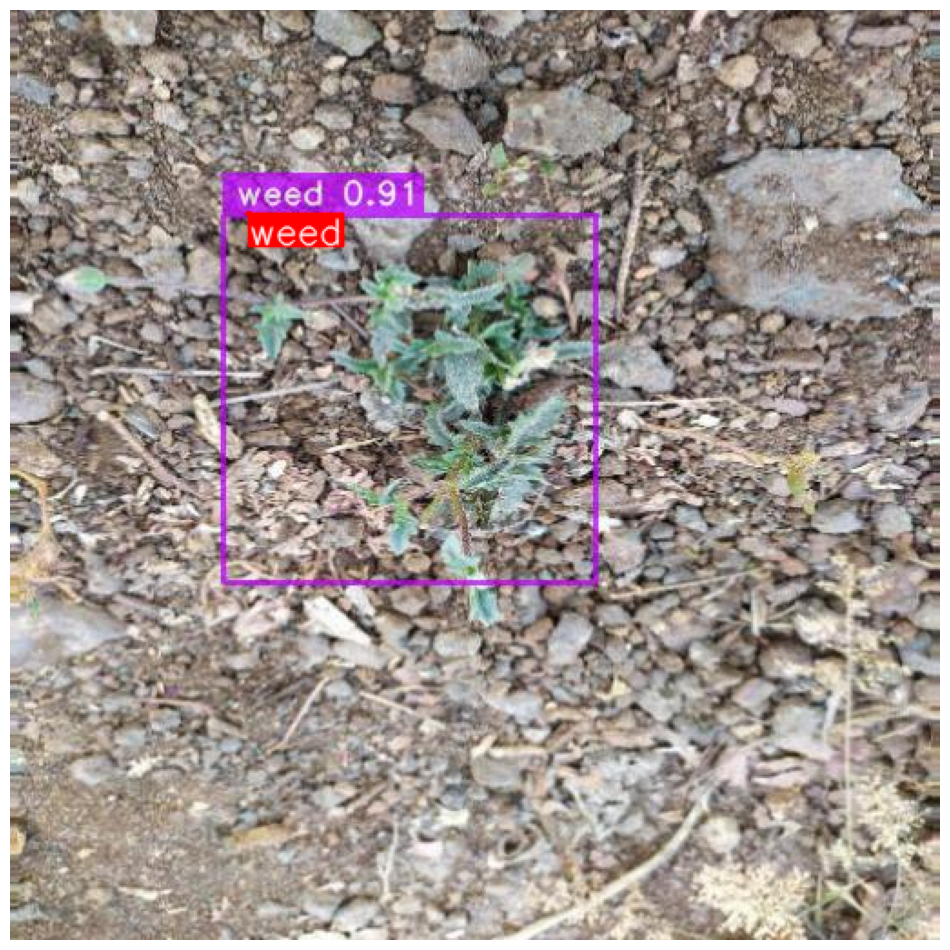

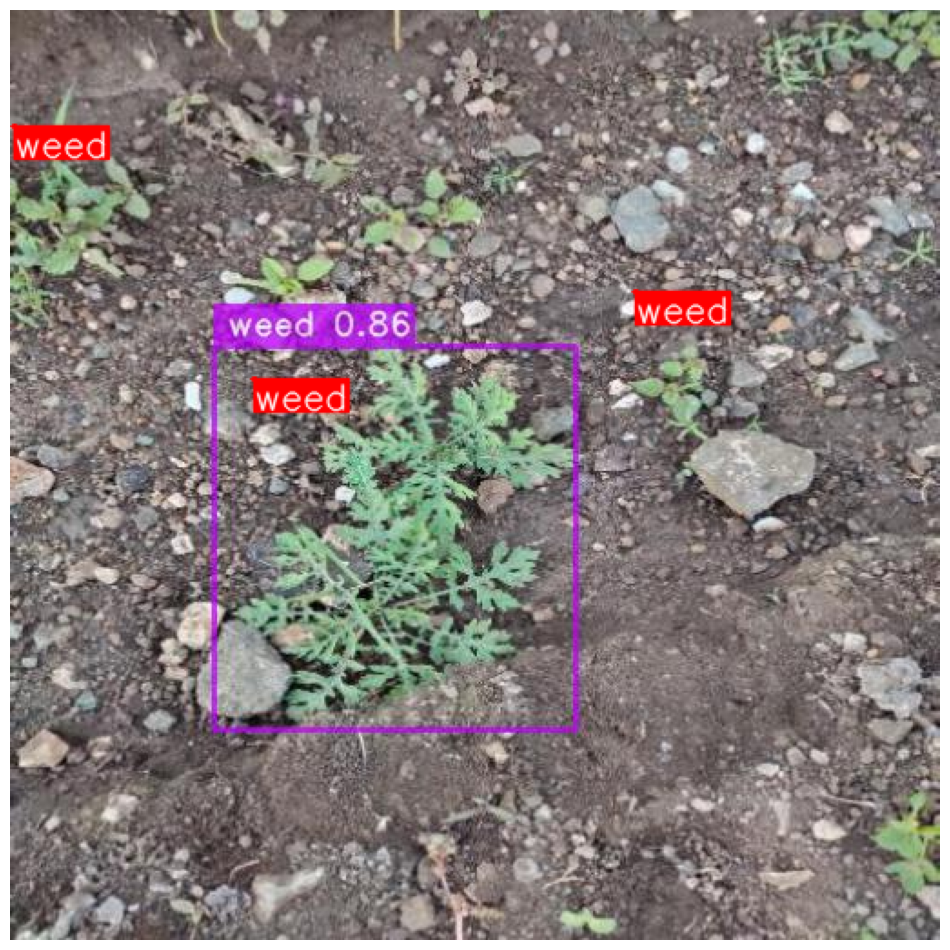

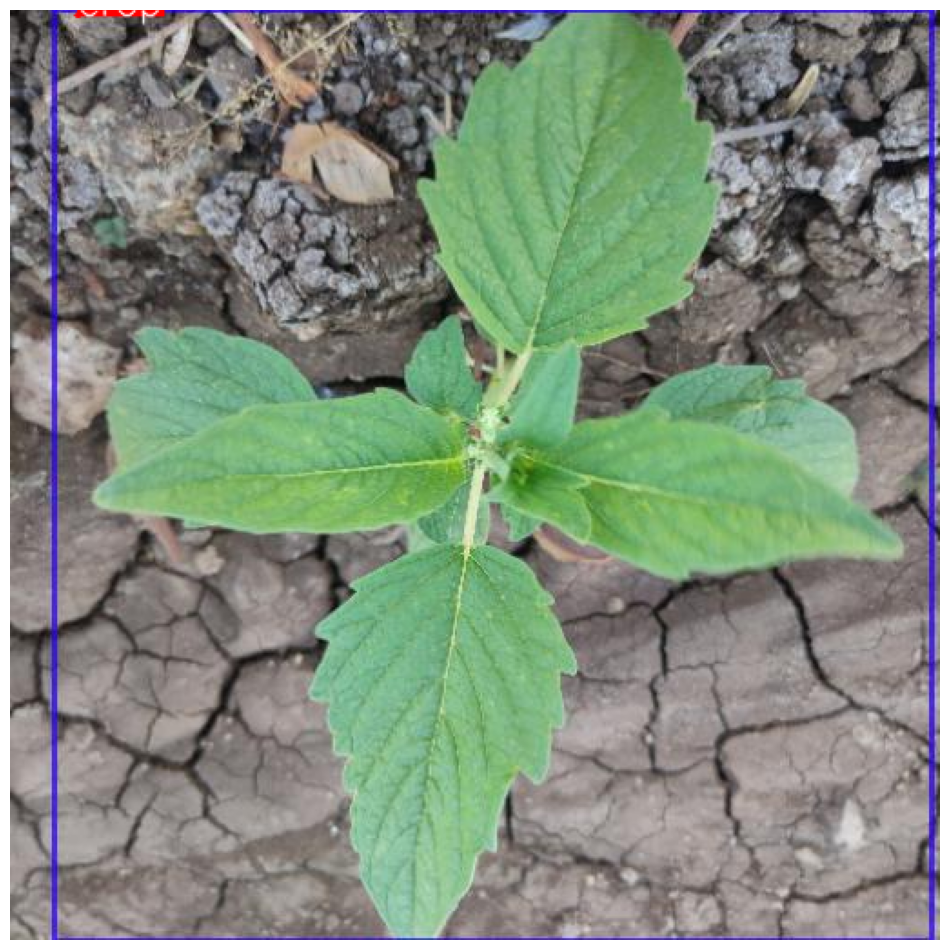

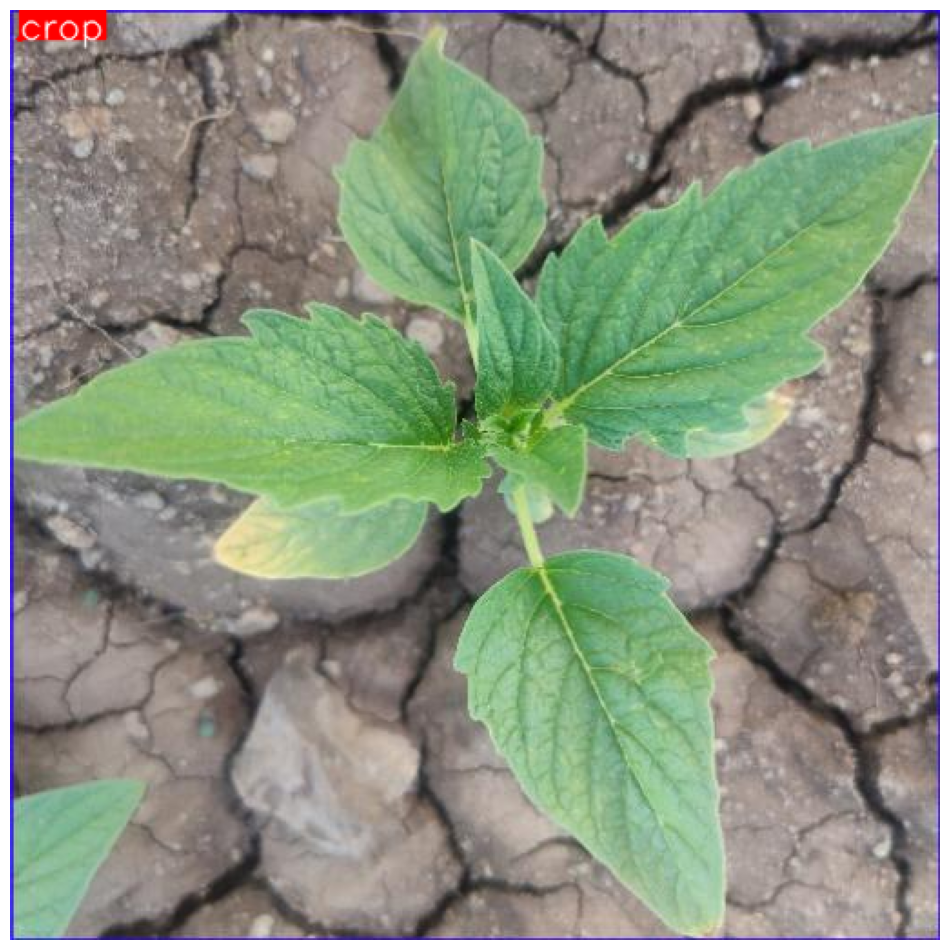

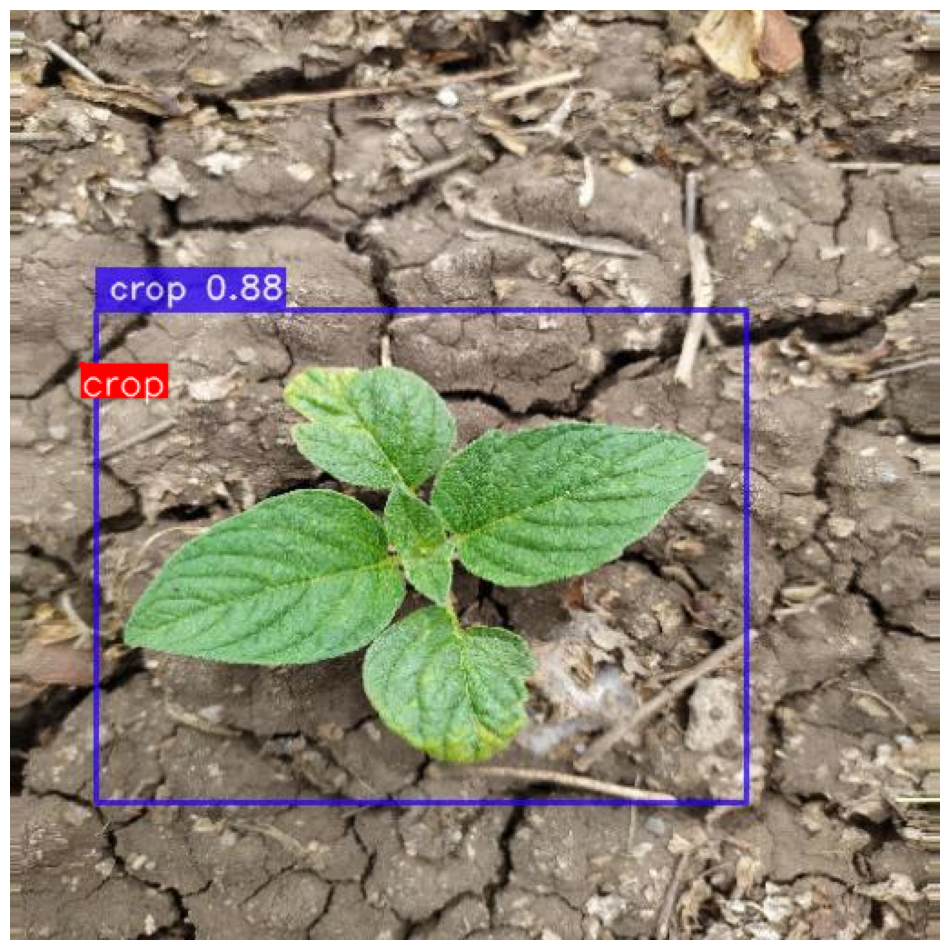

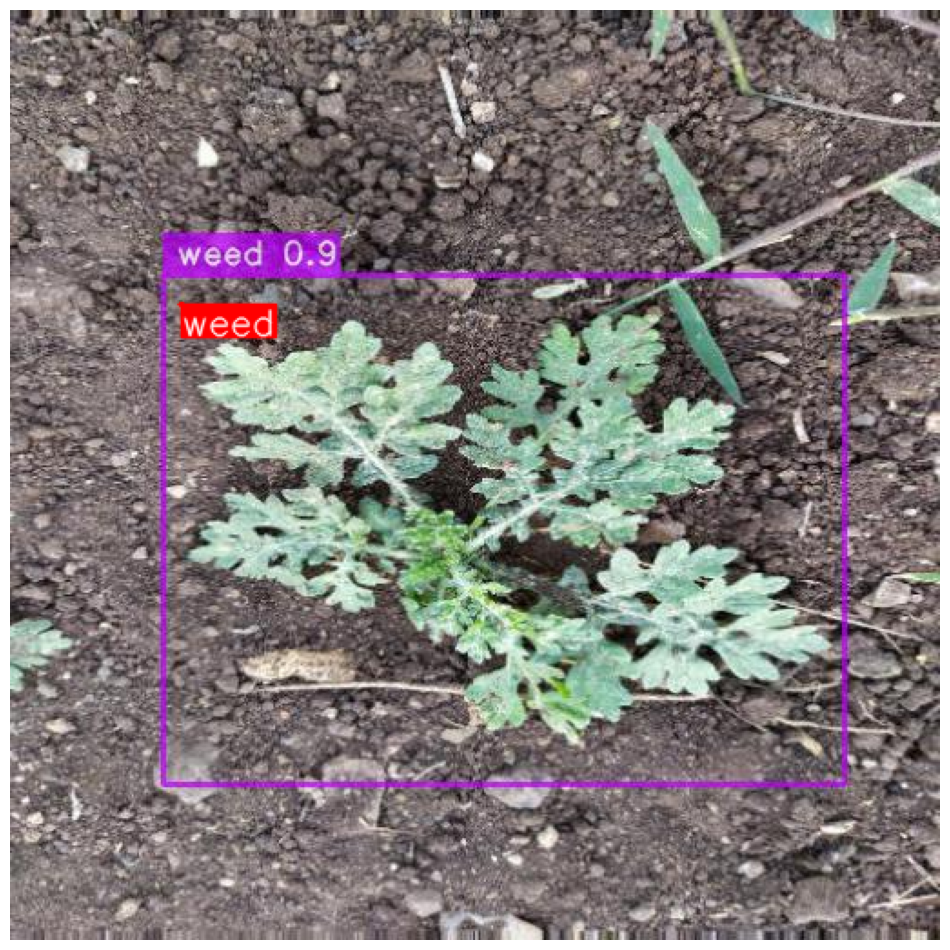

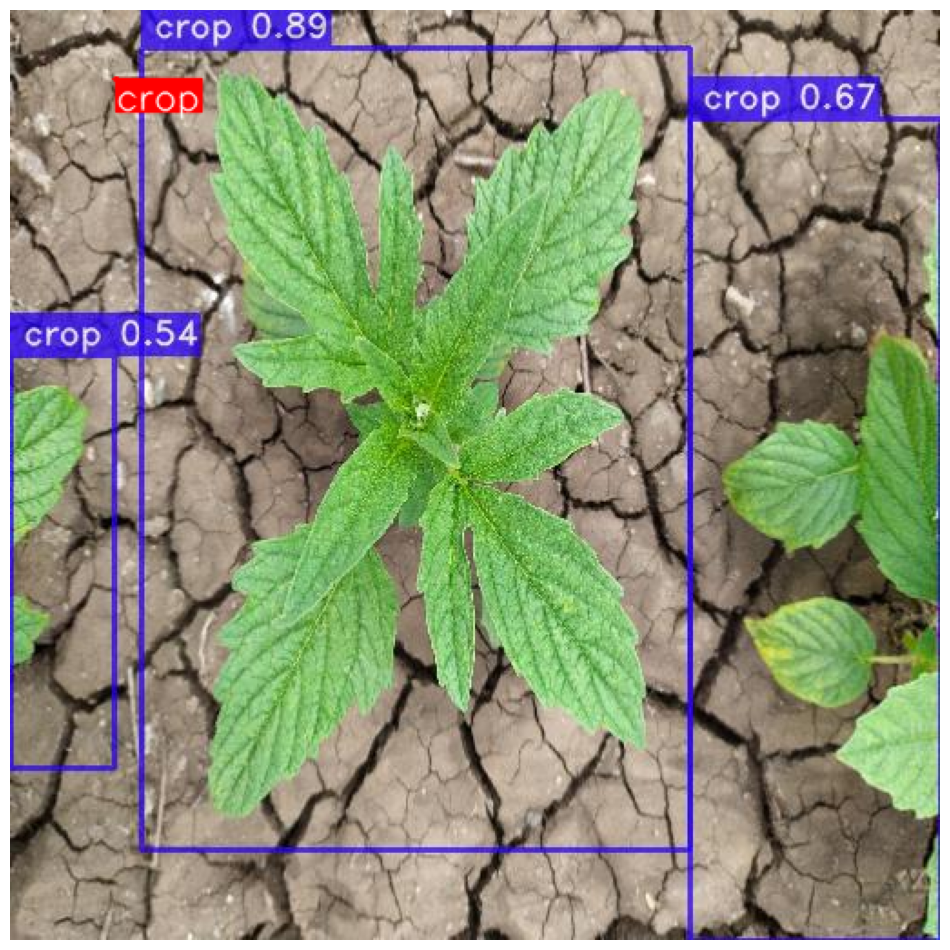

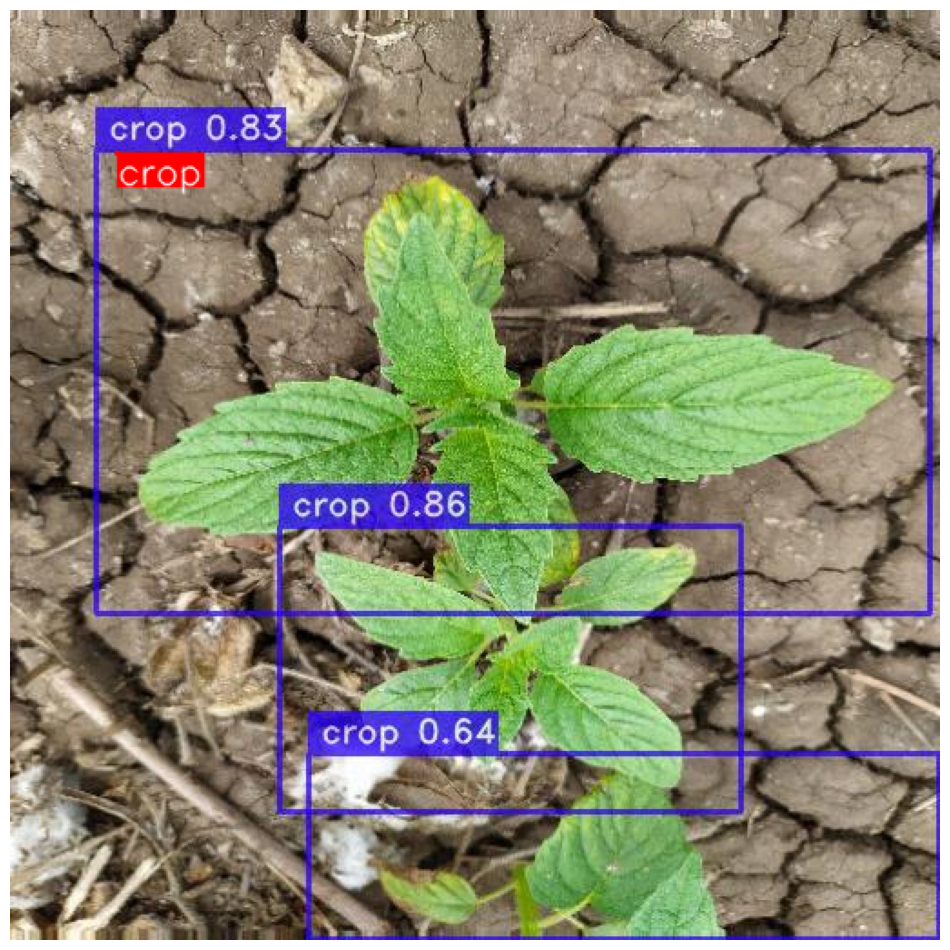

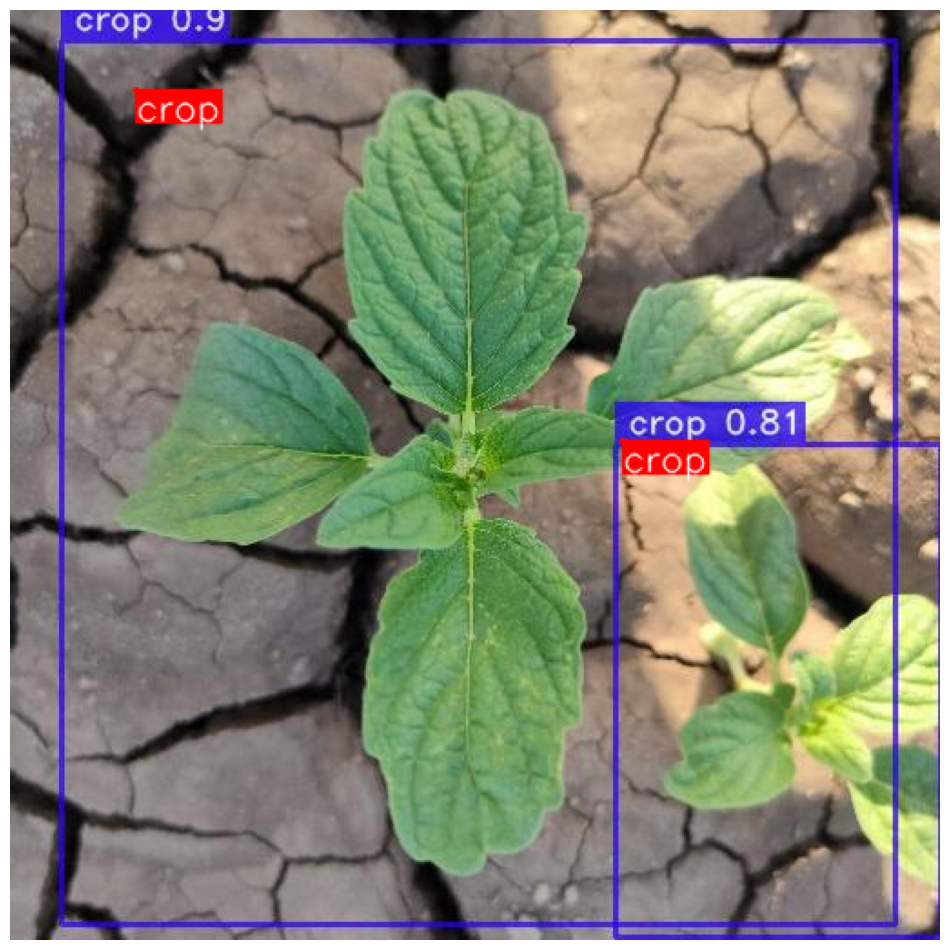

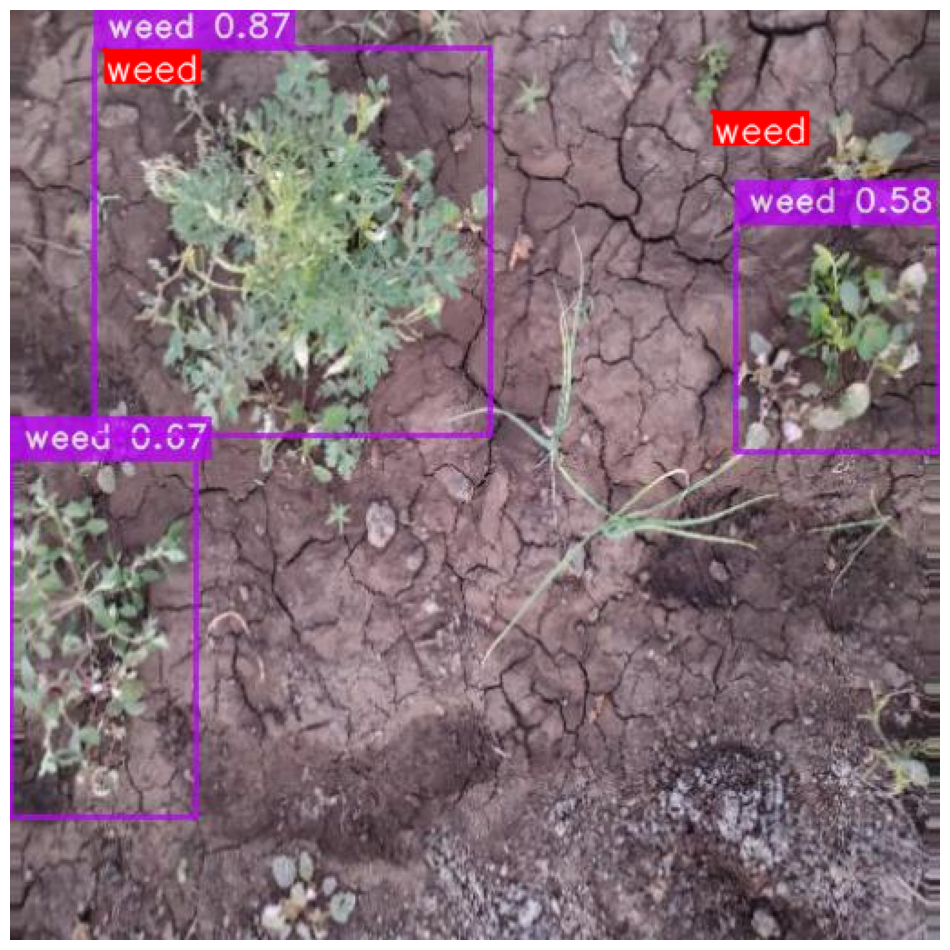

In [47]:
# Visualize a few training images.
plot(
    image_path='inference_results/images/', 
    label_path='/kaggle/input/weed-detection/Weed Detection/labels/test',
    num_samples=10,
)

## Evaluating the best model on Test Set 

In [52]:
test_data = coco_detection_yolo_format_val(
    dataset_params={
        'data_dir': dataset_params['data_dir'],
        'images_dir': dataset_params['test_images_dir'],
        'labels_dir': dataset_params['test_labels_dir'],
        'classes': dataset_params['classes']
    },
    dataloader_params={
        'batch_size':16,
        'num_workers':8
    }
)

Caching annotations: 100%|██████████| 195/195 [00:00<00:00, 545.48it/s]


In [54]:
trainer.test(model=models,
            test_loader=test_data,
            test_metrics_list=DetectionMetrics_050(score_thres=0.1, 
                                                   top_k_predictions=300, 
                                                   num_cls=len(dataset_params['classes']), 
                                                   normalize_targets=True, 
                                                   post_prediction_callback=PPYoloEPostPredictionCallback(score_threshold=0.01, 
                                                                                                          nms_top_k=1000, 
                                                                                                          max_predictions=300,                                                                              
                                                                                                          nms_threshold=0.7)
                                                  ))

Testing:  92%|█████████▏| 12/13 [00:09<00:00,  2.27it/s]

{'PPYoloELoss/loss_cls': 0.82231784,
 'PPYoloELoss/loss_iou': 0.19933346,
 'PPYoloELoss/loss_dfl': 1.355705,
 'PPYoloELoss/loss': 1.9985038,
 'Precision@0.50': 0.07848482578992844,
 'Recall@0.50': 0.9776852130889893,
 'mAP@0.50': 0.8623596429824829,
 'F1@0.50': 0.14488297700881958}

Testing: 100%|██████████| 13/13 [00:10<00:00,  1.21it/s]


[2023-08-12 20:14:52] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


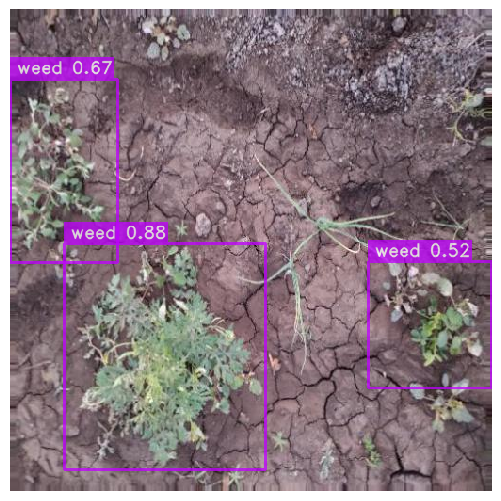

In [60]:
test_image = '/kaggle/input/weed-detection/Weed Detection/images/test/agri_0_1692.jpeg'
models.predict(test_image).show()

[2023-08-12 20:14:42] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


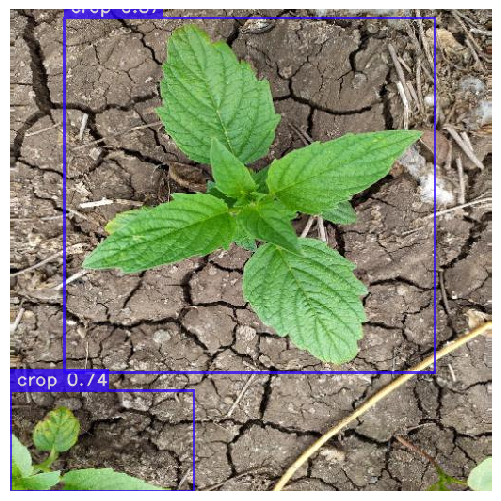

In [59]:
test_image = '/kaggle/input/weed-detection/Weed Detection/images/test/agri_0_1693.jpeg'
models.predict(test_image).show()

[2023-08-12 20:21:24] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


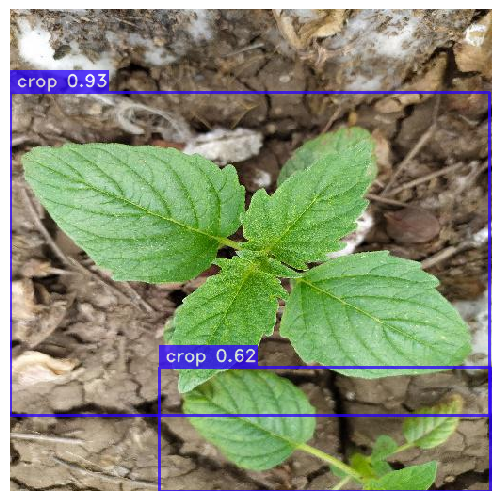

In [67]:
test_image = '/kaggle/input/weed-detection/Weed Detection/images/test/agri_0_1771.jpeg'
models.predict(test_image).show()